# **ADVANCED MACHINE LEARNING PROJECT**

# **RAMSES MORENO DE LA CRUZ - MMU ID: 23624012**

# **1. SET UP ENVIRONMENT / CONFIGURATIONS**

In [ ]:
# Install a package to download data from Kaggle
!pip install -q opendatasets
import opendatasets as od

#Manage the data
import numpy as np
!pip install pandas
import pandas as pd

#Visualisation
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

#Visualisation (Set Configuration for Seaborn Plots)
sns.set(
    { "figure.figsize": (6, 4) },
    style='ticks',
    color_codes=True,
    font_scale=0.8
)
%config InlineBackend.figure_format = 'retina'

import sys

!"{sys.executable}" -m pip install phik
import phik

from phik import resources
from phik.binning import bin_data
from phik.report import plot_correlation_matrix


!pip install ppscore
import ppscore as pps

In [ ]:
# latest version of scikit-learn: might need a kernel resta§rt
#!pip install --upgrade scikit-learn

import sklearn
# this makes is easier for getting dataframes by default as input/output of
# sklearn pipelines
sklearn.set_config(transform_output="pandas")

%config InlineBackend.figure_format = 'retina'
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(
    { "figure.figsize": (6, 4) }, style='ticks', color_codes=True, font_scale=0.8
)

from sklearn.model_selection import train_test_split, cross_validate
from sklearn.model_selection import GridSearchCV, ParameterGrid, RandomizedSearchCV
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder, StandardScaler, PolynomialFeatures
from sklearn.preprocessing import MinMaxScaler

from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor, HistGradientBoostingRegressor
from sklearn.ensemble import VotingRegressor

from sklearn.linear_model import LinearRegression

!pip install category_encoders
from category_encoders import TargetEncoder

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.9/81.9 kB 3.1 MB/s eta 0:00:00


In [ ]:
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import PredictionErrorDisplay
from sklearn.linear_model import ElasticNet

# **2. LOADING THE DATA**

In [ ]:
od.download('https://www.kaggle.com/datasets/ramsesmdlc/adverts-complete-file') # insert ypu kaggle username and key

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: ramsesmdlc
Your Kaggle Key: ··········
Dataset URL: https://www.kaggle.com/datasets/ramsesmdlc/adverts-complete-file


 67%|██████▋   | 5.00M/7.50M [00:00<00:00, 33.4MB/s]

100%|██████████| 7.50M/7.50M [00:00<00:00, 41.8MB/s]


In [ ]:
whole_data = pd.read_csv("/content/adverts-complete-file/adverts.csv")

In [ ]:
whole_data.head(1)

,public_reference,mileage,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,price,body_type,crossover_car_and_van,fuel_type
0,202006039777689,0.0,NaN,Grey,Volvo,XC90,NEW,NaN,73970,SUV,False,Petrol Plug-in Hybrid


# **3. EXPLORATORY DATA ANALYSIS (EDA)**

## **3.1. WHOLE DATASET**

### **3.1.1. METRIC AND NON-METRIC VARIABLES (GENERAL INFORMATION)**

In [ ]:
def EDA_0(whole_data):
  #"shape" of the whole dataset
  print("\n" +'\033[1m','\033[33m',"Shape of the dataset:",'\033[0m', whole_data.shape, "\n")

  #"head" of the whole dataset
  print("\n",'\033[1m','\033[33m',"Head of the dataset:",'\033[0m', "\n")
  print(whole_data.head(1))

  #"tail" of the whole dataset
  print("\n", '\033[1m','\033[33m',"Tail of the dataset:",'\033[0m', "\n")
  print(whole_data.tail(1))

  #"sample" of the whole dataset
  print("\n", '\033[1m','\033[33m',"Sample of the dataset:",'\033[0m', "\n")
  print(whole_data.sample(n=1))

  #"general information" of the whole dataset
  print("\n", '\033[1m','\033[33m',"General information of the dataset:",'\033[0m', "\n")
  whole_data.info()

  #"number and percentage" of missing values of the whole dataset
  print("\n" +'\033[1m','\033[33m', "Number and percentage of missing values per column of the dataset:", '\033[0m' + "\n")
  missing = whole_data.isnull().sum()
  percentage = missing / whole_data.shape[0] * 100
  print(pd.concat([missing, round(percentage,2)], axis=1, keys=["Missing", "Percentage %"]))

  #"summary statistics" of metric variables of the dataset
    #Price
        #mean: 1.734197e+04 = £ 17,341.97
        #std: 4.643746e+04 =  £ 46,437.46
        #min: 1.200000e+02 =  £ 120
        #25%: 7.495000e+03 =  £ 7,495
        #50%: 1.260000e+04 =  £ 12,600
        #75%: 2.000000e+04 =  £ 20,000
        #max: 9.999999e+06 =  £ 9,999,999

  print("\n" +'\033[1m','\033[33m', "Summary statistics of metric variables of the dataset:", '\033[0m' + "\n")
  print(whole_data.describe())

  #"summary statistics" of non-metric variables of the dataset
  print("\n" +'\033[1m','\033[33m', "Summary statistics of non-metric variables of the dataset:", '\033[0m' + "\n")
  whole_data_non_metric = whole_data.drop(columns=['price',"mileage", "public_reference", "year_of_registration"])
  print(whole_data_non_metric.describe())

# Call the function
EDA_0(whole_data)


  Shape of the dataset:  (402005, 12) 


   Head of the dataset:  

   public_reference  mileage reg_code standard_colour standard_make  \
0   202006039777689      0.0      NaN            Grey         Volvo   

  standard_model vehicle_condition  year_of_registration  price body_type  \
0           XC90               NEW                   NaN  73970       SUV   

   crossover_car_and_van              fuel_type  
0                  False  Petrol Plug-in Hybrid  

   Tail of the dataset:  

        public_reference  mileage reg_code standard_colour standard_make  \
402004   201512149444029  14000.0       14          Silver          Audi   

       standard_model vehicle_condition  year_of_registration  price  \
402004       A4 Avant              USED                2014.0  20520   

       body_type  crossover_car_and_van fuel_type  
402004    Estate                  False    Diesel  

   Sample of the dataset:  

        public_reference  mileage reg_code standard_colour standard_make 

### **3.1.2. STRATIFIED SPLITTING**

The following proportions are going to be used in the project:
* training set (60 %) = 241204 instances
* test set (20 %) = 80401 instances
* validation set (20 %) = 80400 instances

---
---


* First, the whole dataset provided (402005 instances) is split in a stratified manner into "training set" and "test set" without distorting the proportions shown above:

training instances (80%) | test instances (20%)  | whole instances (100%)
-------------------------|-----------------------|-----------------
321604                   | 80401                 | 402005

---
---



* Then, the complete "training set" (321604 instances) is split in a stratified manner into "training set" and "validation set" without distorting the proportions shown above:

training instances (75%) | validation instances (25%)  |
-------------------------|-----------------------------|
241204                   | 80400                       |


In [ ]:
#First, the whole dataset provided (402005 instances) is split in a stratified manner into "training set" and "test set".

#Step 1: Defining the dataset that is going to be split
  #whole_data

#Step 2: Defining the variable that is going to be used as a guide to perform the stratified splitting.
  #Target variable: "price"

#Step 3: The stratified splitting will be done through the discretization of the target variable "Price" into several bins.
   #Defining the values that represent the beginning and end of every bin.
   #In other words, there will be 6 bins: 0-20000, 20000-40000, 40000-70000, 70000-100000, 100000-400000, 400000-10000000
strata_price = [0,20000,40000,70000,100000,400000,10000000]

#Step 4: Building a series based on the target variable "Price" and in the bins "strata_price" created in Step 3.
column_for_bin = pd.cut(whole_data['price'], bins=strata_price, labels=["Strata N°1", "Strata N°2", "Strata N°3", "Strata N°4", "Strata N°5", "Strata N°6"])

#Step 5: Rename the series created in the Step 4
column_for_bin.rename('strata_price_bin', inplace=True)

#Step 6: Concatenation ("whole dataset" [from Step 1]) & the serie ("column_for_bin" [from Step 5])
new_whole_data = pd.concat([whole_data, column_for_bin], axis=1)

#Step 7: Building the "Test Set"
    #Sampling of the 20% of the dataframe built in Step 6.
    #In essence "GroupBy" by strata_price (built in the Steps 3,4,5) was applied and a sample from 20% was taken from every strata.
TestSet = new_whole_data.groupby('strata_price_bin').sample(frac=0.2, random_state=42)
TestSet.drop('strata_price_bin', axis=1, inplace=True)
print("\n" +'\033[1m','\033[33m',"Shape of the test set:",'\033[0m', TestSet.shape, "\n")

    #Test Set (X dataset and Y dataset)
X_Test_1 = TestSet.drop(['price'], axis=1)
Y_Test_1 = TestSet['price']

#Step 8: Building the "Training Set"
    #Dropping specific rows of the original dataset (set in Step 6) based the index of the "Test Set" (created in Step 7).
index_values_to_drop = TestSet.index
TrainSet = new_whole_data.drop(index_values_to_drop)
TrainSet.drop('strata_price_bin', axis=1, inplace=True)
print("\n" +'\033[1m','\033[33m',"Shape of the training set:",'\033[0m', TrainSet.shape, "\n")


  Shape of the test set:  (80401, 12) 


  Shape of the training set:  (321604, 12) 



In [ ]:
#Then, the complete "training set" (321604 instances) is split in a stratified manner into "training set" and "validation set":

#Step 1: Defining the dataset that is going to be split
  #TrainSet

#Step 2: Defining the variable that is going to be used as a guide to perform the stratified splitting.
  #Target variable: "price"

#Step 3: The stratified splitting will be done through the discretization of the target variable "Price" into several bins.
   #Defining the values that represent the beginning and end of every bin.
   #In other words, there will be 6 bins: 0-20000, 20000-40000, 40000-70000, 70000-100000, 100000-400000, 400000-10000000
strata_price_2 = [0,20000,40000,70000,100000,400000,10000000]

#Step 4: Building a series based on the target variable "Price" and in the bins "strata_price" created in Step 3.
column_for_bin_2 = pd.cut(TrainSet['price'], bins=strata_price_2, labels=["Strata N°1", "Strata N°2", "Strata N°3", "Strata N°4", "Strata N°5", "Strata N°6"])

#Step 5: Rename the series created in the Step 4
column_for_bin_2.rename('strata_price_bin_2', inplace=True)

#Step 6: Concatenation ("whole dataset" [from Step 1]) & the serie ("column_for_bin" [from Step 5])
new_TrainSet = pd.concat([TrainSet, column_for_bin_2], axis=1)

#Step 7: Building the "Validation Set"
    #Sampling of the 25% of the dataframe built in Step 6.
    #In essence "GroupBy" by strata_price (built in the Steps 3,4,5) was applied and a sample from 25% was taken from every strata.
ValSet = new_TrainSet.groupby('strata_price_bin_2').sample(frac=0.25, random_state=43)
ValSet.drop('strata_price_bin_2', axis=1, inplace=True)
print("\n" +'\033[1m','\033[33m',"Shape of the validation set:",'\033[0m', ValSet.shape, "\n")

#Validation Set (X dataset and Y dataset)
X_Val_1 = ValSet.drop(['price'], axis=1)
Y_Val_1 = ValSet['price']

#Step 8: Building the "Training Set"
#Dropping specific rows of the original dataset (set in Step 6) based the index of the "Test Set" (created in Step 7).
index_values_to_drop_val = ValSet.index
data = new_TrainSet.drop(index_values_to_drop_val)
data.drop('strata_price_bin_2', axis=1, inplace=True)
print("\n" +'\033[1m','\033[33m',"Shape of the training set:",'\033[0m', data.shape, "\n")

#Training Set (X dataset and Y dataset)
X_Training_1 = data.drop(['price'], axis=1)
Y_Training_1 = data['price']


  Shape of the validation set:  (80400, 12) 


  Shape of the training set:  (241204, 12) 



## **3.2. TRAINING DATASET**

### **3.2.1. METRIC AND NON-METRIC VARIABLES (GENERAL INFORMATION)**

In [ ]:
def EDA_1(data):
  #"shape" of the training dataset
  print("\n" +'\033[1m','\033[33m',"Shape of the training dataset:",'\033[0m', data.shape, "\n")

  #"head" of the training dataset
  print('\033[1m','\033[33m',"Head of the training dataset:",'\033[0m', "\n")
  print(data.head(1))

  #"tail" of the training dataset
  print('\033[1m','\033[33m',"Tail of the training dataset:",'\033[0m', "\n")
  print(data.tail(1))

  #"sample" of the training dataset
  print('\033[1m','\033[33m',"Sample of the training dataset:",'\033[0m', "\n")
  print(data.sample(n=1))

  #"general information" of the training dataset
  print("\n", '\033[1m','\033[33m',"General information of the training dataset:",'\033[0m', "\n")
  data.info()

  #"number and percentage" of missing values of the training dataset
  print("\n" +'\033[1m','\033[33m', "Number and percentage of missing values per column of the training dataset:", '\033[0m' + "\n")
  missing = data.isnull().sum()
  percentage = missing / data.shape[0] * 100
  print(pd.concat([missing, round(percentage,2)], axis=1, keys=["Missing", "Percentage %"]))

  #"summary statistics" of metric variables of the dataset
    #Price
        #mean: 1.737612e+04 = £ 17,376.12
        #std: 5.145449e+04 =  £ 51,454.49
        #min: 1.220000e+02 =  £ 122
        #25%: 7.495000e+03 =  £ 7,495
        #50%: 1.259900e+04 =  £ 12,599
        #75%: 2.000000e+04 =  £ 20,000
        #max: 9.999999e+06 =  £ 9,999,999

  print("\n" +'\033[1m','\033[33m', "Summary statistics of metric variables of the training dataset:", '\033[0m' + "\n")
  print(data.describe())

  #"summary statistics" of non-metric variables of the dataset
  print("\n" +'\033[1m','\033[33m', "Summary statistics of non-metric variables of the training dataset:", '\033[0m' + "\n")
  data_non_metric = data.drop(columns=['price',"mileage", "public_reference", "year_of_registration"])
  print(data_non_metric.describe())

# Call the function
EDA_1(data)


  Shape of the training dataset:  (241204, 12) 

  Head of the training dataset:  

   public_reference  mileage reg_code standard_colour standard_make  \
2   202007020778474   7800.0       17            Grey         SKODA   

  standard_model vehicle_condition  year_of_registration  price body_type  \
2           Yeti              USED                2017.0  14000       SUV   

   crossover_car_and_van fuel_type  
2                  False    Petrol  
  Tail of the training dataset:  

        public_reference  mileage reg_code standard_colour standard_make  \
402003   202011015662436  10250.0       65             Red        Abarth   

       standard_model vehicle_condition  year_of_registration  price  \
402003            595              USED                2015.0  11490   

        body_type  crossover_car_and_van fuel_type  
402003  Hatchback                  False    Petrol  
  Sample of the training dataset:  

       public_reference  mileage reg_code standard_colour standard_

### **3.2.2. NON-METRIC VARIABLES (UNIVARIATE ANALYSIS)**

* Barplots



  Table - Top 5 most frequent elements of the variable standard_colour is concentrated in: 

        standard_colour  Percentage %
Black             51895         21.51
White             42436         17.59
Grey              40623         16.84
Blue              36029         14.94
Silver            29547         12.25




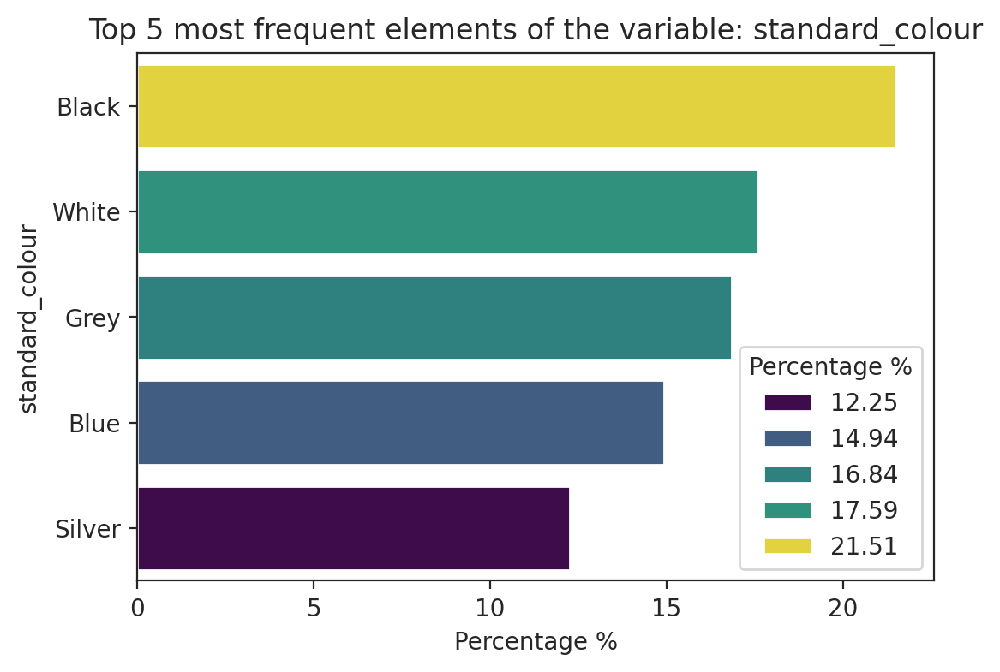


  Table - Top 5 of the variable standard_make is concentrated in: 

               standard_make  Percentage %
BMW                    22424          9.30
Audi                   21162          8.77
Volkswagen             20677          8.57
Vauxhall               20089          8.33
Mercedes-Benz          19035          7.89

  Top 5 of the variable standard_make 



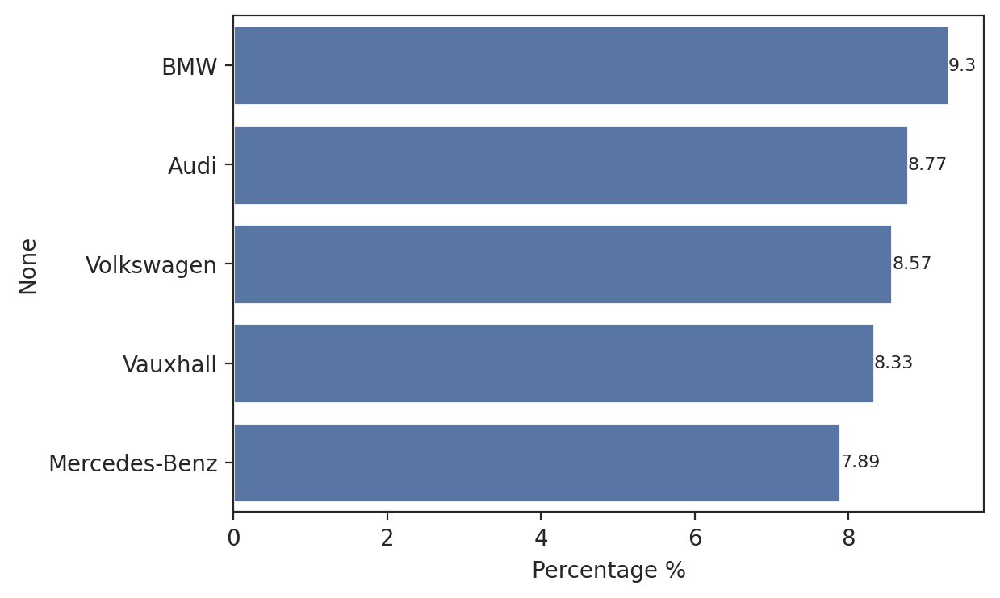


  Table - vehicle_condition 

      vehicle_condition  Percentage %
USED             222510         92.25
NEW               18694          7.75

  Barplot - vehicle_condition 



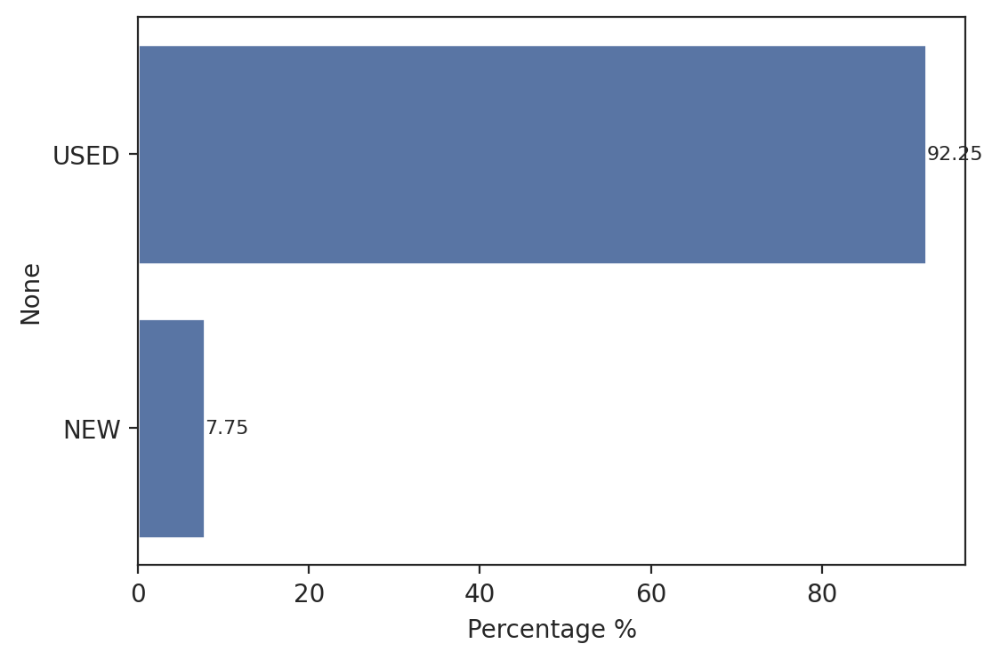


  Table - Top 5 of the variable body_type is concentrated in: 

           body_type  Percentage %
Hatchback     100602         41.71
SUV            69328         28.74
Saloon         22061          9.15
Estate         14805          6.14
Coupe          13956          5.79

  Barplot - Top 5 of the variable body_type 



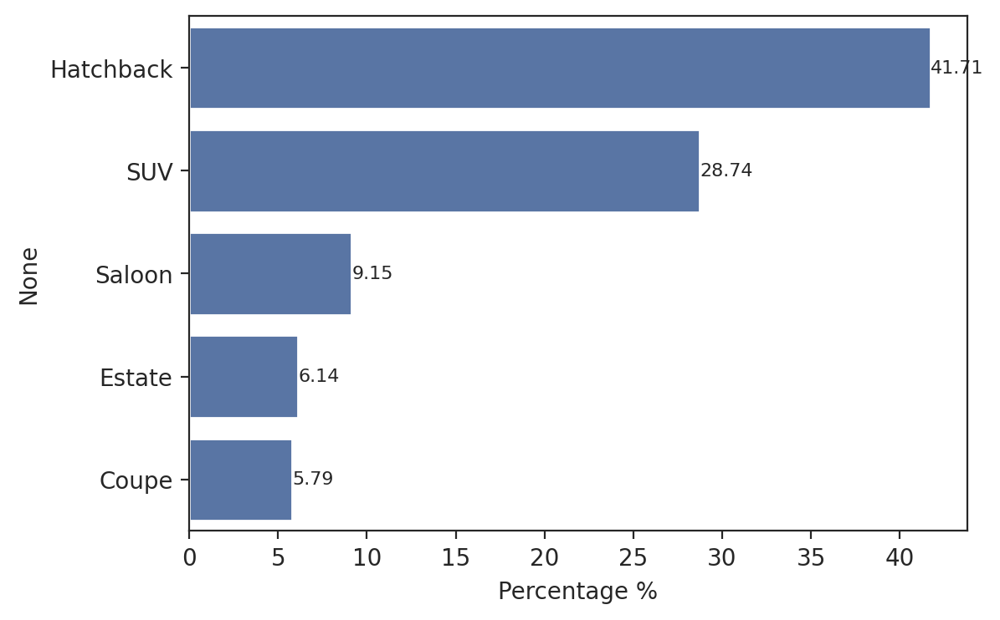


  Table - Top 5 of the variable fuel_type is concentrated in: 

                       fuel_type  Percentage %
Petrol                    130364         54.05
Diesel                     94652         39.24
Petrol Hybrid               8206          3.40
Petrol Plug-in Hybrid       3695          1.53
Electric                    2862          1.19

  Barplot - Top 5 of the variable fuel_type 



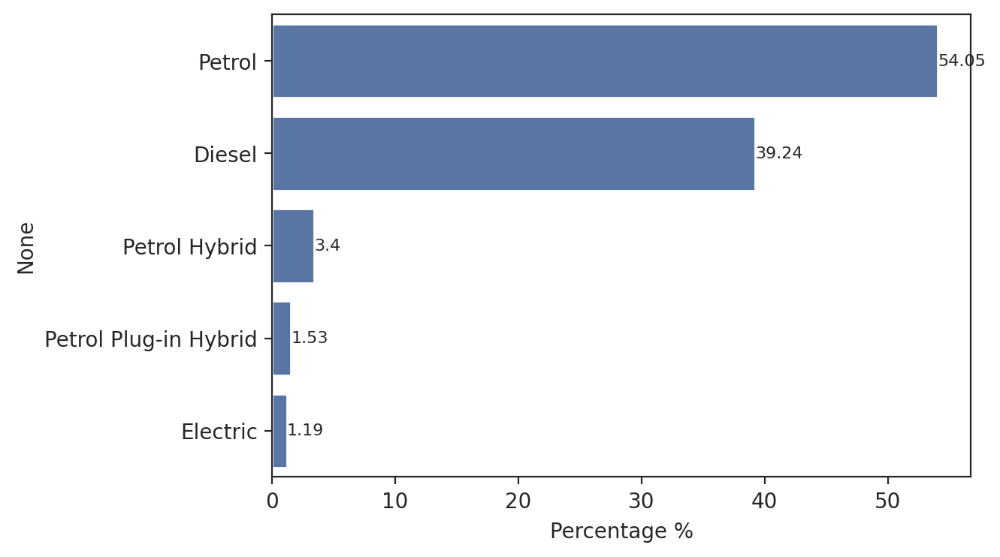


  Table - Top 5 of the variable standard_model is concentrated in: 

          standard_model  Percentage %
Golf                7092          2.94
Corsa               6324          2.62
C Class             5118          2.12
3 Series            4995          2.07
Polo                4656          1.93

  Barplot - Top 5 of the variable standard_model 



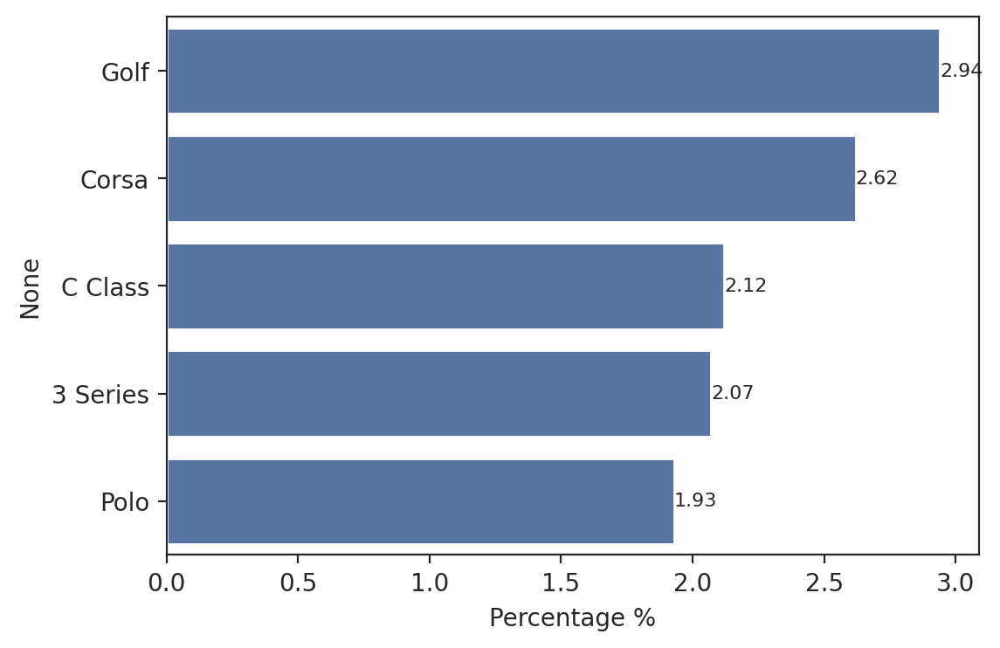

In [ ]:
#Some of the most relevant "non-metric variables" to graph and inspect are the followings:
    #standard_colour
    #standard_make
    #vehicle_condition
    #body_type
    #fuel_type
    #standard_model

#Important Note: For visualization purposes, the graphs only show subsets of the "training data" that contain interesting values.

def EDA_Graph_1(data):

  #standard_colour
  standard_colour_count = data['standard_colour'].value_counts()
  percentage = standard_colour_count / data.shape[0] * 100
  df1 = pd.concat([standard_colour_count, round(percentage,2)], axis=1, keys=["standard_colour", "Percentage %"])
  print("\n" +'\033[1m','\033[33m', "Table - Top 5 most frequent elements of the variable standard_colour is concentrated in:", '\033[0m' + "\n")
  print(df1.head(5))
  print("\n")

  df11 = df1.head(5)
  ax1 = sns.barplot(x='Percentage %',y=df11.index, data=df11, palette="viridis", hue="Percentage %")
  ax1.set(xlabel='Percentage %', ylabel='standard_colour', title='Top 5 most frequent elements of the variable: standard_colour')
  plt.show()

  ##########################################################################################################################

  #standard_make
  standard_make_count = data['standard_make'].value_counts()
  percentage = standard_make_count / data.shape[0] * 100
  df2 = pd.concat([standard_make_count, round(percentage,2)], axis=1, keys=["standard_make", "Percentage %"])
  print("\n" +'\033[1m','\033[33m', "Table - Top 5 of the variable standard_make is concentrated in:", '\033[0m' + "\n")
  print(df2.head(5))

  df21 = df2.head(5)
  print("\n" +'\033[1m','\033[33m', "Top 5 of the variable standard_make", '\033[0m' + "\n")
  ax2 = sns.barplot(x='Percentage %',y=df21.index, data=df21)
  ax2.bar_label(ax2.containers[0], fontsize=8)
  plt.show()

  ##########################################################################################################################

  #vehicle_condition
  vehicle_condition_count = data['vehicle_condition'].value_counts()
  percentage = vehicle_condition_count / data.shape[0] * 100
  df3 = pd.concat([vehicle_condition_count, round(percentage,2)], axis=1, keys=["vehicle_condition", "Percentage %"])
  print("\n" +'\033[1m','\033[33m', "Table - vehicle_condition", '\033[0m' + "\n")
  print(df3)

  df31 = df3.head()
  print("\n" +'\033[1m','\033[33m', "Barplot - vehicle_condition", '\033[0m' + "\n")
  ax3 = sns.barplot(x='Percentage %',y=df31.index, data=df31)
  ax3.bar_label(ax3.containers[0], fontsize=8)
  plt.show()

  ##########################################################################################################################

  #body_type
  body_type_count = data['body_type'].value_counts()
  percentage = body_type_count / data.shape[0] * 100
  df4 = pd.concat([body_type_count, round(percentage,2)], axis=1, keys=["body_type", "Percentage %"])
  print("\n" +'\033[1m','\033[33m', "Table - Top 5 of the variable body_type is concentrated in:", '\033[0m' + "\n")
  print(df4.head(5))

  df41 = df4.head(5)
  print("\n" +'\033[1m','\033[33m', "Barplot - Top 5 of the variable body_type", '\033[0m' + "\n")
  ax4 = sns.barplot(x='Percentage %', y=df41.index, data=df41)
  ax4.bar_label(ax4.containers[0], fontsize=8)
  plt.show()

  ##########################################################################################################################

  #fuel_type
  fuel_type_count = data['fuel_type'].value_counts()
  percentage = fuel_type_count / data.shape[0] * 100
  df6 = pd.concat([fuel_type_count, round(percentage,2)], axis=1, keys=["fuel_type", "Percentage %"])
  print("\n" +'\033[1m','\033[33m', "Table - Top 5 of the variable fuel_type is concentrated in:", '\033[0m' + "\n")
  print(df6.head(5))

  df61 = df6.head(5)
  print("\n" +'\033[1m','\033[33m', "Barplot - Top 5 of the variable fuel_type", '\033[0m' + "\n")
  ax6 = sns.barplot(x='Percentage %', y=df61.index, data=df61)
  ax6.bar_label(ax6.containers[0], fontsize=8)
  plt.show()

  ##########################################################################################################################

  #standard_model
  standard_model_count = data['standard_model'].value_counts()
  percentage = standard_model_count / data.shape[0] * 100
  df777 = pd.concat([standard_model_count, round(percentage,2)], axis=1, keys=["standard_model", "Percentage %"])
  print("\n" +'\033[1m','\033[33m', "Table - Top 5 of the variable standard_model is concentrated in:", '\033[0m' + "\n")
  print(df777.head(5))

  df888 = df777.head(5)
  print("\n" +'\033[1m','\033[33m', "Barplot - Top 5 of the variable standard_model", '\033[0m' + "\n")
  ax888 = sns.barplot(x='Percentage %', y=df888.index, data=df888)
  ax888.bar_label(ax888.containers[0], fontsize=8)
  plt.show()

# Call the function
EDA_Graph_1(data)

### **3.2.3. METRIC VARIABLES (UNIVARIATE ANALYSIS)**

* Histograms


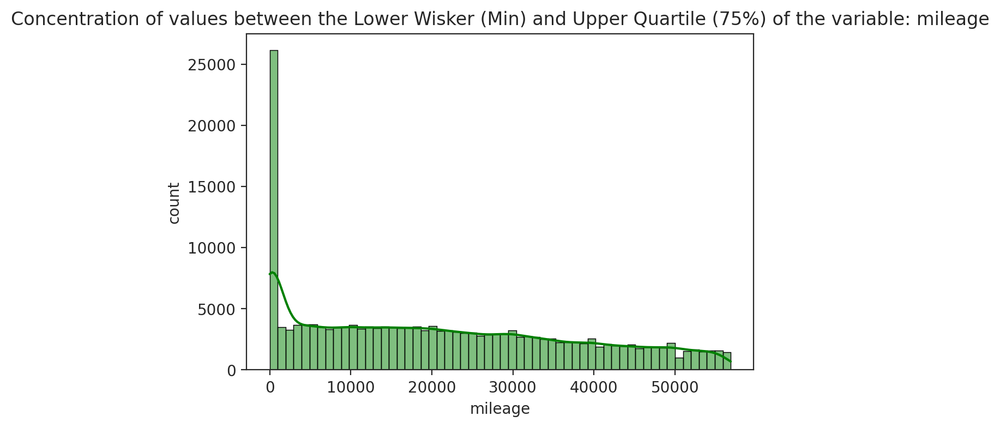


  Histogram - Year_of_registration (1950 - 2000) 



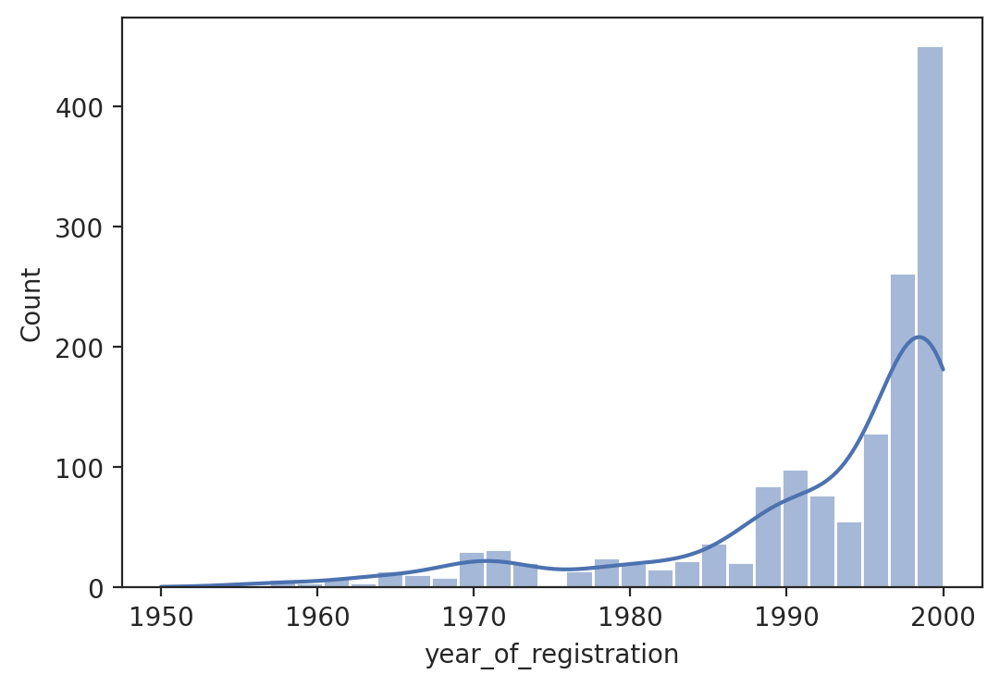


  Histogram - Year_of_registration (2000 - 2020) 



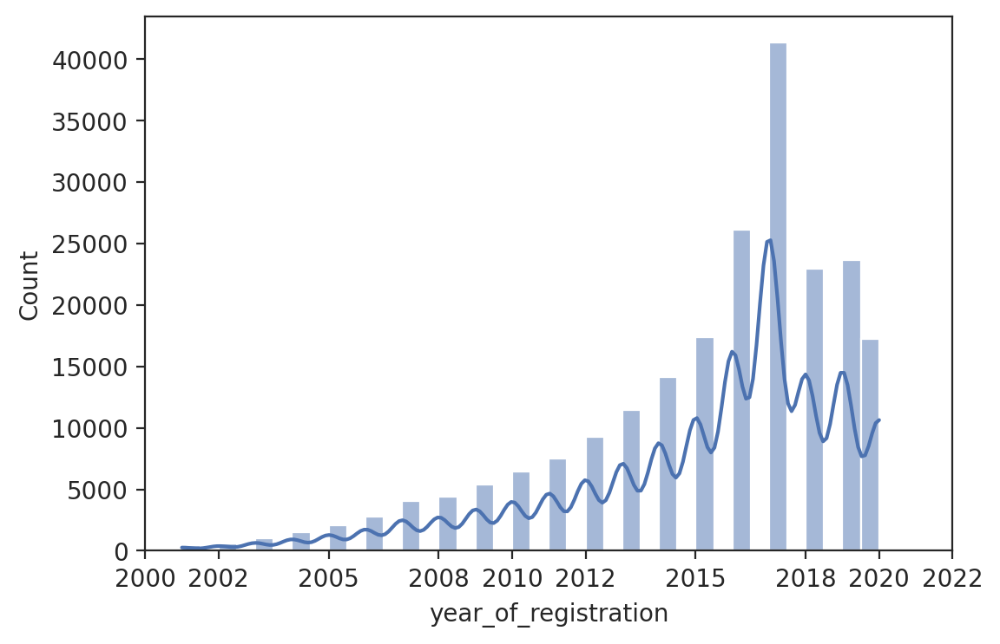


  Histogram - Concentration of values between the 0 Percentile and 75 Percentile of the variable price 



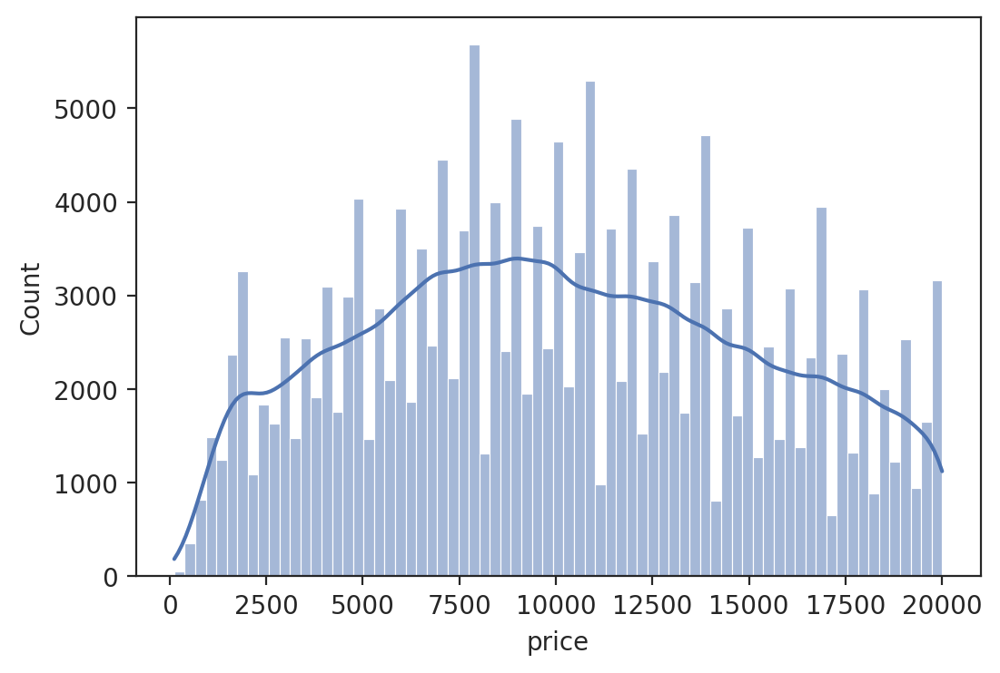


  Histogram - Concentration of values between the 75 Percentile and £100,000 of the variable price 



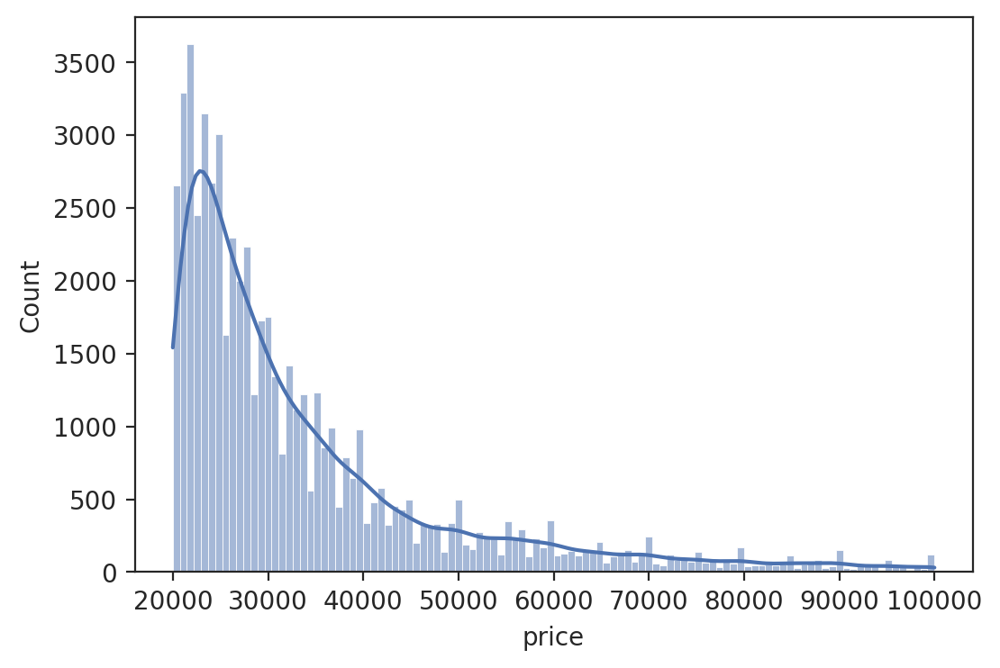


  Histogram - Concentration of values between £100,000 and £1,000,000 of the variable price 



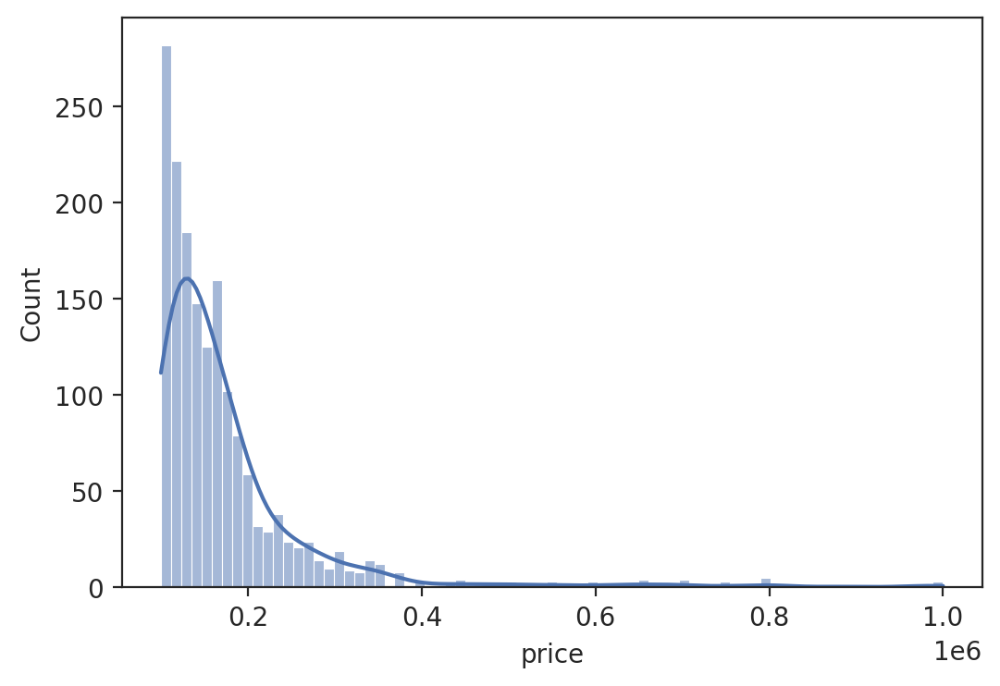


  Histogram - Concentration of values between between £1,000,000 and £10,000,000 of the variable price 



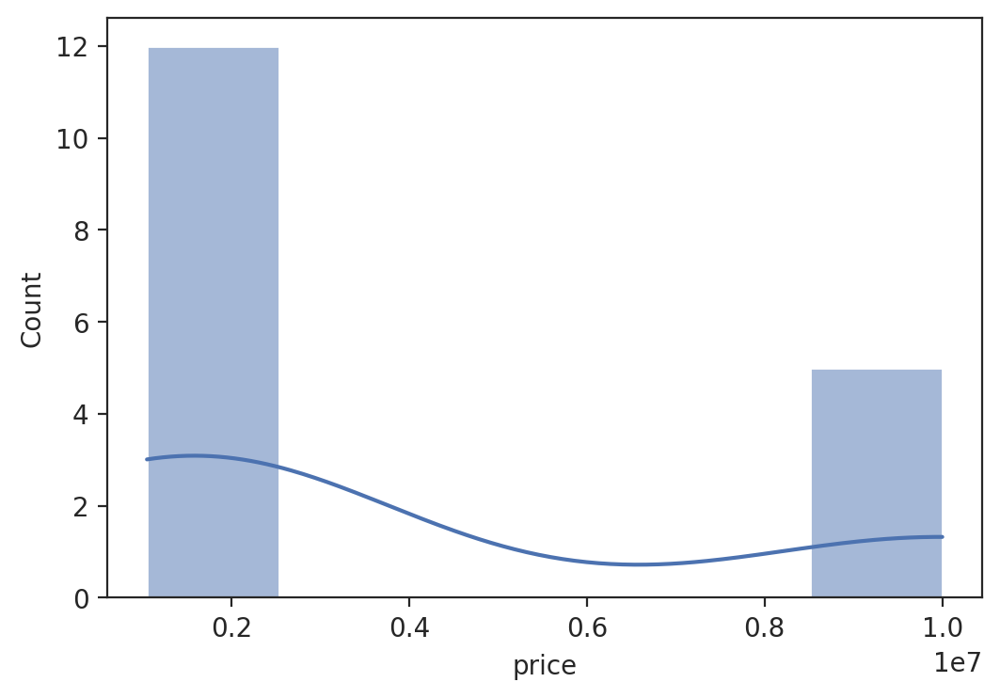


  Histogram - Concentration of values between 0 Percentile and 98 Percentile of the variable mileage 



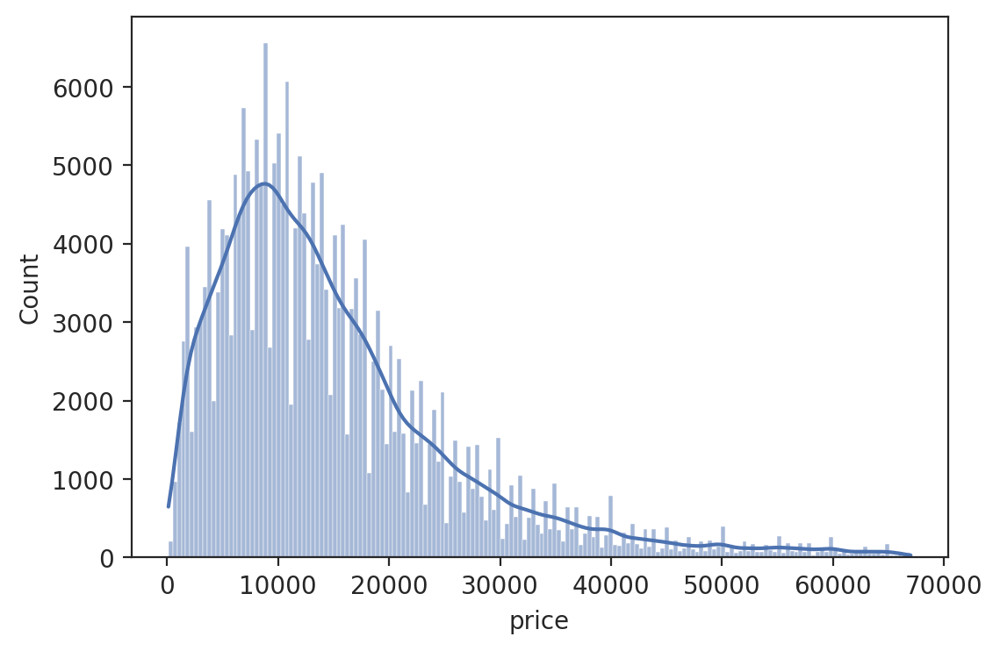

In [ ]:
#Some of the most relevant "metric variables" to graph and inspect are the followings:
    #mileage
    #year_of_registration
    #price


  #     #standard_colour
  # standard_colour_count = data['standard_colour'].value_counts()
  # percentage = standard_colour_count / data.shape[0] * 100
  # df1 = pd.concat([standard_colour_count, round(percentage,2)], axis=1, keys=["standard_colour", "Percentage %"])
  # print("\n" +'\033[1m','\033[33m', "Table - Top 5 most frequent elements of the variable standard_colour is concentrated in:", '\033[0m' + "\n")
  # print(df1.head(5))
  # print("\n")

  # df11 = df1.head(5)
  # ax1 = sns.barplot(x='Percentage %',y=df11.index, data=df11, palette="viridis", hue="Percentage %")
  # ax1.set(xlabel='Percentage %', ylabel='standard_colour', title='Top 5 most frequent elements of the variable: standard_colour')
  # plt.show()

#Important Note: For visualization purposes, the graphs only show subsets of the "training data" that contain interesting values.

def EDA_Graph_2(data):

  #mileage
  df7 = data[(data['mileage'] >= data['mileage'].quantile(0)) & (data['mileage'] <= data['mileage'].quantile(0.75))]
  sns.histplot(data=df7, x='mileage', kde=True, color='green', edgecolor='black')
  plt.xlabel('mileage')
  plt.ylabel('count')
  plt.title('Concentration of values between the Lower Wisker (Min) and Upper Quartile (75%) of the variable: mileage')
  plt.show()

  ##########################################################################################################################

  #year_of_registration (from 1950 - 2000)
  print("\n" +'\033[1m','\033[33m', "Histogram - Year_of_registration (1950 - 2000)", '\033[0m' + "\n")
  df10 = data.query("1950<=year_of_registration<=2000")
  sns.histplot(data=df10, x='year_of_registration', kde=True)
  plt.show()

  ##########################################################################################################################

  #year_of_registration (from 2000 - 2020)
  print("\n" +'\033[1m','\033[33m', "Histogram - Year_of_registration (2000 - 2020)", '\033[0m' + "\n")
  df11 = data.query("2000<year_of_registration<=2020")
  ax7 = sns.histplot(data=df11, x='year_of_registration', kde=True, binwidth=0.5)
  ax7.set_xticks(np.round(ax7.get_xticks(), 0))
  plt.show()

  ##########################################################################################################################

  #price (between the 0 Percentile and 75 Percentile)
  print("\n" +'\033[1m','\033[33m', "Histogram - Concentration of values between the 0 Percentile and 75 Percentile of the variable price", '\033[0m' + "\n")
  df8 = data[(data['price'] >= data['price'].quantile(0)) & (data['price'] <= data['price'].quantile(0.75))]
  sns.histplot(data=df8, x='price', kde=True)
  plt.show()

  ##########################################################################################################################

  #price (between the 75 Percentile and £100,000)
  print("\n" +'\033[1m','\033[33m', "Histogram - Concentration of values between the 75 Percentile and £100,000 of the variable price", '\033[0m' + "\n")
  df9 = data[(data['price'] >= data['price'].quantile(0.75)) & (data['price'] <= 100000)]
  sns.histplot(data=df9, x='price', kde=True)
  plt.show()

  ##########################################################################################################################

  #price (between £100,000 and £1,000,000)
  print("\n" +'\033[1m','\033[33m', "Histogram - Concentration of values between £100,000 and £1,000,000 of the variable price", '\033[0m' + "\n")
  df99 = data[(data['price'] >= 100000) & (data['price'] <= 1000000)]
  sns.histplot(data=df99, x='price', kde=True)
  plt.show()

  ##########################################################################################################################

  #price (between £1,000,000 and £10,000,000)
  print("\n" +'\033[1m','\033[33m', "Histogram - Concentration of values between between £1,000,000 and £10,000,000 of the variable price", '\033[0m' + "\n")
  df999 = data[(data['price'] >= 1000000) & (data['price'] <= 10000000)]
  sns.histplot(data=df999, x='price', kde=True)
  plt.show()

  ##########################################################################################################################

  #price (between 0 Percentile and 98 Percentile)
  print("\n" +'\033[1m','\033[33m', "Histogram - Concentration of values between 0 Percentile and 98 Percentile of the variable mileage", '\033[0m' + "\n")
  df9999 = data[(data['price'] >= data['price'].quantile(0)) & (data['price'] <= data['price'].quantile(0.98))]
  sns.histplot(data=df9999, x='price', kde=True)
  plt.show()

# Call the function
EDA_Graph_2(data)

### **3.2.4. NON-METRIC VARIABLES (BIVARIATE ANALYSIS)**

* Categorical Plots
* Phi-K Correlation Coefficient

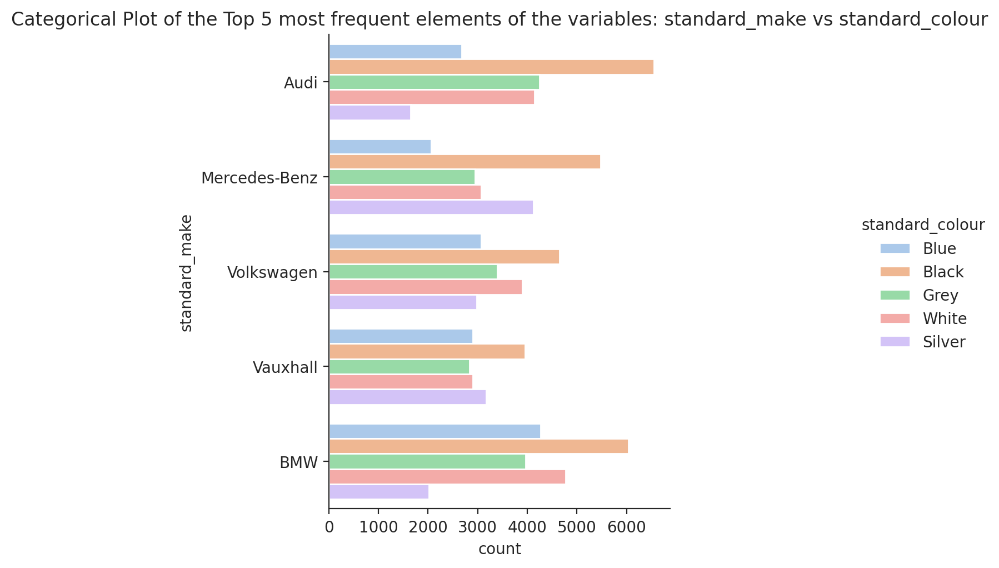


  Catplot [standard_make vs standard_model] 



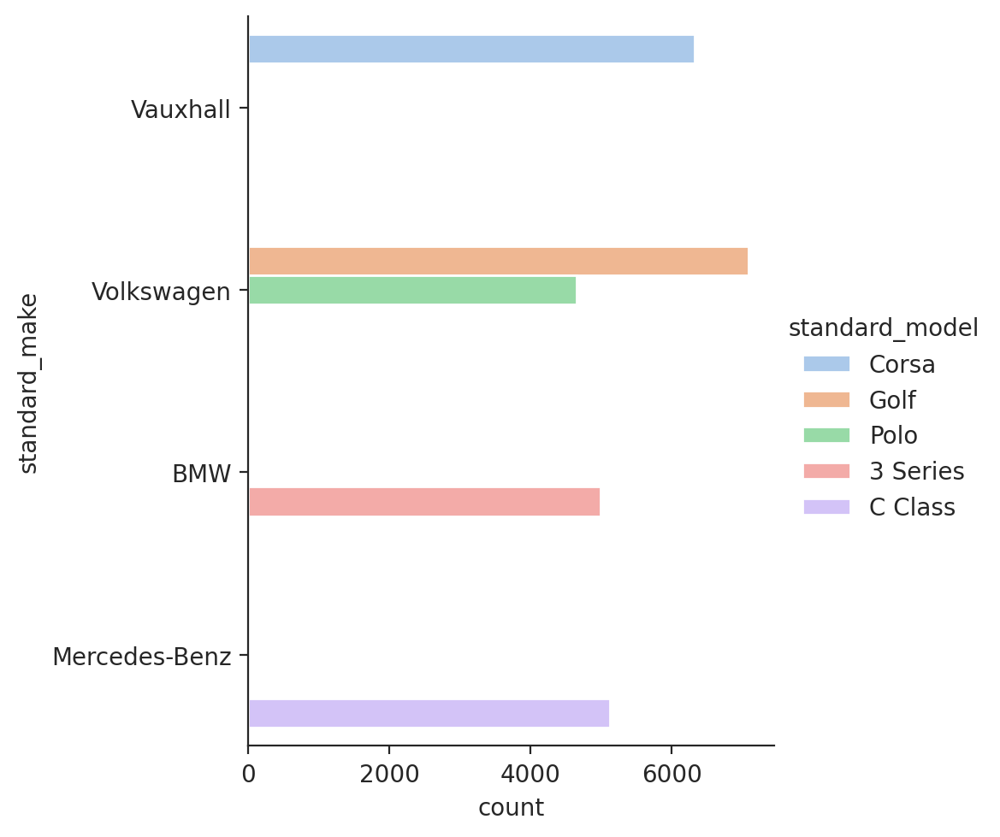


  Catplot [standard_make vs fuel_type] 



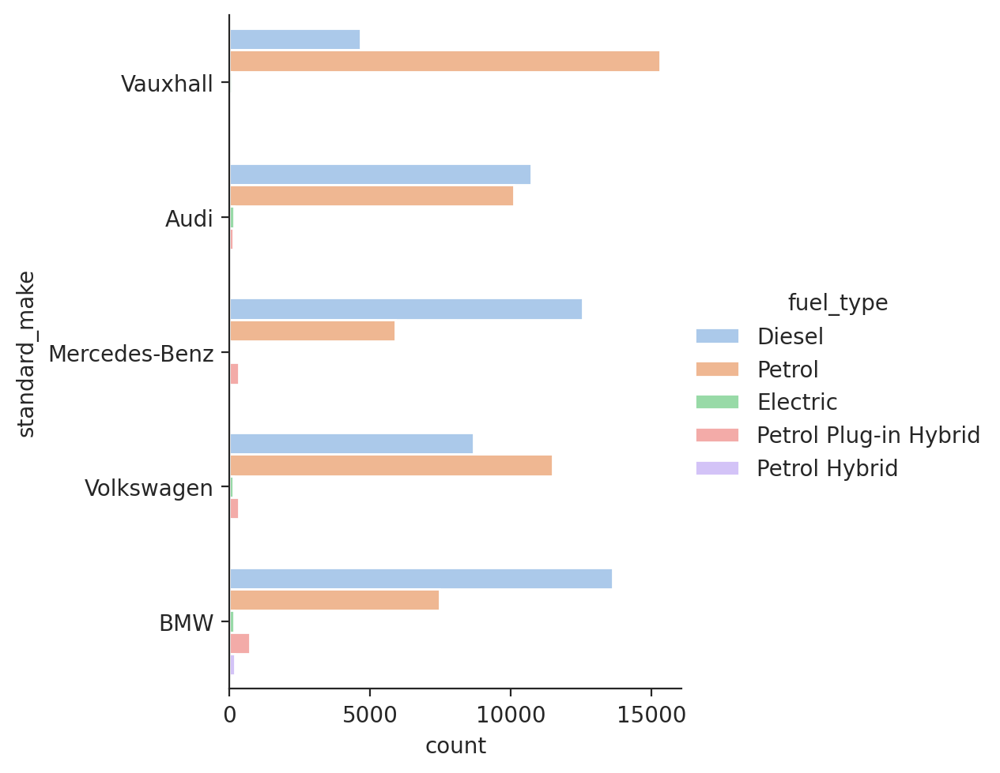


  Catplot [standard_model vs fuel_type] 



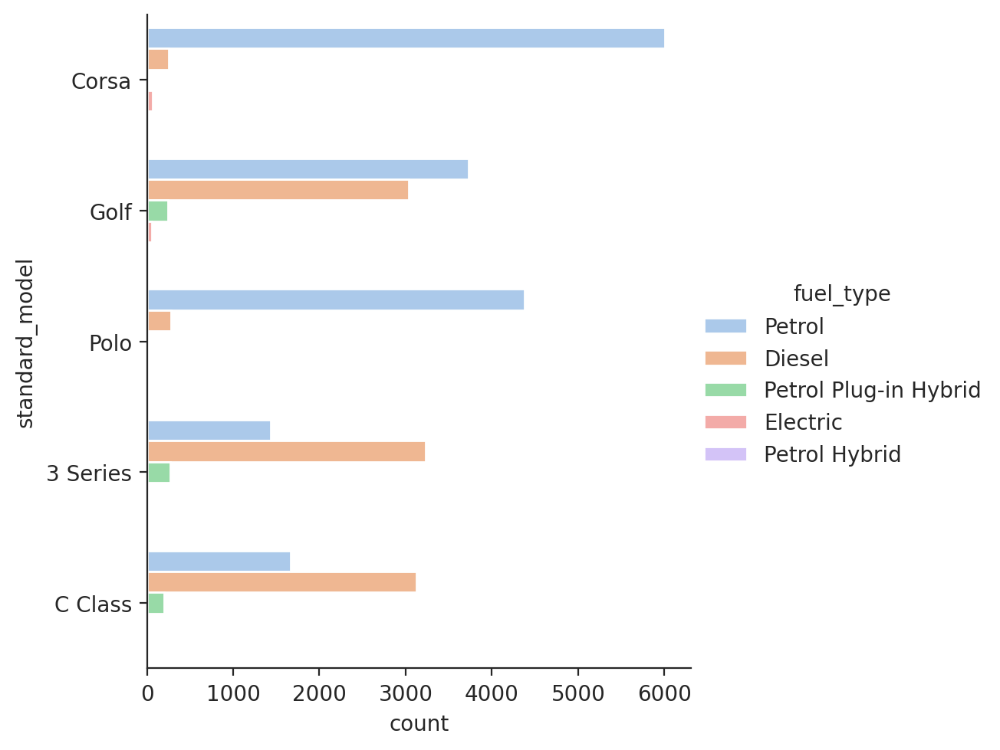


  Catplot [standard_make vs body_type] 



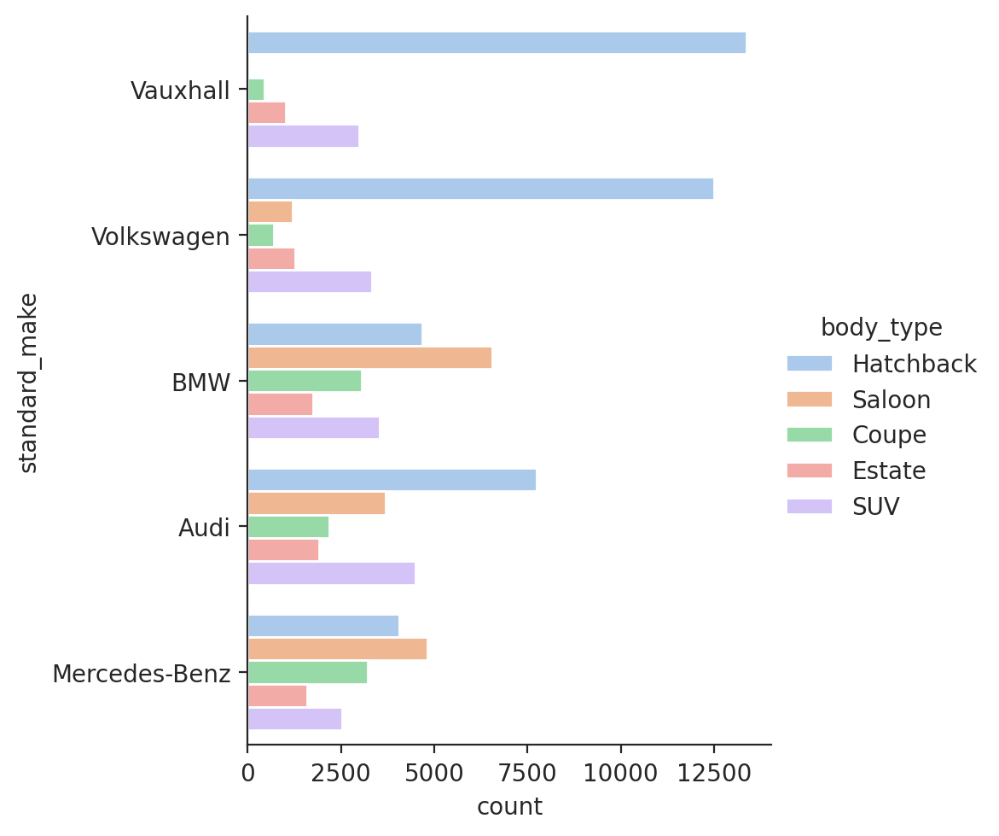

In [ ]:
#Some of the most relevant "non-metric variables" to graph and inspect are the followings:
    #standard_colour
    #standard_make
    #body_type
    #fuel_type
    #standard_model

#Important Note: For visualization purposes, the graphs only show subsets of the data that contain interesting values (Top 5 values).

#Function for Categorical Plots
def EDA_Graph_Extra1(data):

    #Step 0: Choose a "non-metric" feature.
    #Step 1: Create a "serie" (for counting values) based on a specific "non-metric" feature.
    #Step 2: Get the Top 5 values of the "serie" created in the Step 1.
    #Step 3: Transform the  "serie" created in the Step 2 into a dataframe.
    #Step 4: Transpose the dataframe created in the Step 3.
    #Step 5: Get the name of the columns of the transposed dataframe of Step 4.
    #Step 6 - 7: Create a subset in the main dataset (training data) based on the name of the columns of Step 5.

    #Step 8: Repeat Step 0 to Step 5 but for another "non-metric" feature.
    #Step 9 - 10: Create a subset in the dataset (dataset obtained in step 6 - 7) based on the name of the columns of the new "non-metric" feature.
    #Step 11: Plot the "CatPlot" considering the "non-metric", "non-metric" and "dataframe created in Step 9-10"

  #standard_colour vs standard_make
      #standard_colour
  serie_101 = data['standard_colour'].value_counts()
  serie_102 = serie_101.head(5)
  df150 = pd.DataFrame(serie_102)
  transposed_df150 = df150.transpose()
  column_names_df150 = transposed_df150.columns.tolist()
  mask_df150 = data['standard_colour'].isin(column_names_df150)
  #Apply the mask to get the subset of the DataFrame
  df151 = data[mask_df150]

      #standard_make
  serie_103 = data['standard_make'].value_counts()
  serie_104 = serie_103.head(5)
  df152 = pd.DataFrame(serie_104)
  transposed_df152 = df152.transpose()
  column_names_df152 = transposed_df152.columns.tolist()
  mask_df152 = df151['standard_make'].isin(column_names_df152)
  #Apply the mask to get the subset of the DataFrame
  df153 = df151[mask_df152]

  #CatPlot
  sns.catplot(data=df153, y="standard_make", hue="standard_colour", kind="count",palette="pastel")
  plt.xlabel('count')
  plt.ylabel('standard_make')
  plt.title('Categorical Plot of the Top 5 most frequent elements of the variables: standard_make vs standard_colour')
  plt.show()

  ##########################################################################################################################
  #standard_model vs standard_make

      #standard_model
  serie_105 = data['standard_model'].value_counts()
  serie_106 = serie_105.head(5)
  df154 = pd.DataFrame(serie_106)
  transposed_df154 = df154.transpose()
  column_names_df154 = transposed_df154.columns.tolist()
  mask_df154= data['standard_model'].isin(column_names_df154)
  #Apply the mask to get the subset of the DataFrame
  df155 = data[mask_df154]

      #standard_make
  serie_107 = data['standard_make'].value_counts()
  serie_108 = serie_107.head(5)
  df156 = pd.DataFrame(serie_108)
  transposed_df156 = df156.transpose()
  column_names_df156 = transposed_df156.columns.tolist()
  mask_df156 = df155['standard_make'].isin(column_names_df156)
  #Apply the mask to get the subset of the DataFrame
  df157 = df155[mask_df156]

  #CatPlot
  print("\n" +'\033[1m','\033[46m', "Catplot [standard_make vs standard_model]", '\033[0m' + "\n")
  sns.catplot(data=df157, y="standard_make", hue="standard_model", kind="count",palette="pastel")
  plt.show()

   ##########################################################################################################################
  #fuel_type vs standard_make

      #fuel_type
  serie_109 = data['fuel_type'].value_counts()
  serie_110 = serie_109.head(5)
  df158 = pd.DataFrame(serie_110)
  transposed_df158 = df158.transpose()
  column_names_df158 = transposed_df158.columns.tolist()
  mask_df158 = data['fuel_type'].isin(column_names_df158)
  #Apply the mask to get the subset of the DataFrame
  df159 = data[mask_df158]

      #standard_make
  serie_111 = data['standard_make'].value_counts()
  serie_112 = serie_111.head(5)
  df160 = pd.DataFrame(serie_112)
  transposed_df160 = df160.transpose()
  column_names_df160 = transposed_df160.columns.tolist()
  mask_df160 = df159['standard_make'].isin(column_names_df160)
  #Apply the mask to get the subset of the DataFrame
  df161 = df159[mask_df160]

  #CatPlot
  print("\n" +'\033[1m','\033[46m', "Catplot [standard_make vs fuel_type]", '\033[0m' + "\n")
  sns.catplot(data=df161, y="standard_make", hue="fuel_type", kind="count",palette="pastel")
  plt.show()

   ##########################################################################################################################
  #fuel_type vs standard_model

      #fuel_type
  serie_113 = data['fuel_type'].value_counts()
  serie_114 = serie_113.head(5)
  df162 = pd.DataFrame(serie_114)
  transposed_df162 = df162.transpose()
  column_names_df162 = transposed_df162.columns.tolist()
  mask_df162 = data['fuel_type'].isin(column_names_df162)
  #Apply the mask to get the subset of the DataFrame
  df163 = data[mask_df162]

      #standard_model
  serie_115 = data['standard_model'].value_counts()
  serie_116 = serie_115.head(5)
  df164 = pd.DataFrame(serie_116)
  transposed_df164 = df164.transpose()
  column_names_df164 = transposed_df164.columns.tolist()
  mask_df164 = df163['standard_model'].isin(column_names_df164)
  #Apply the mask to get the subset of the DataFrame
  df165 = df163[mask_df164]

  #CatPlot
  print("\n" +'\033[1m','\033[46m', "Catplot [standard_model vs fuel_type]", '\033[0m' + "\n")
  sns.catplot(data=df165, y="standard_model", hue="fuel_type", kind="count",palette="pastel")
  plt.show()

   ##########################################################################################################################
   #body_type vs standard_make

      #body_type
  serie_117 = data['body_type'].value_counts()
  serie_118 = serie_117.head(5)
  df166 = pd.DataFrame(serie_118)
  transposed_df166 = df166.transpose()
  column_names_df166 = transposed_df166.columns.tolist()
  mask_df166 = data['body_type'].isin(column_names_df166)
  #Apply the mask to get the subset of the DataFrame
  df167 = data[mask_df166]

     #standard_make
  serie_119 = data['standard_make'].value_counts()
  serie_120 = serie_119.head(5)
  df168 = pd.DataFrame(serie_120)
  transposed_df168 = df168.transpose()
  column_names_df168 = transposed_df168.columns.tolist()
  mask_df168 = df167['standard_make'].isin(column_names_df168)
  #Apply the mask to get the subset of the DataFrame
  df169 = df167[mask_df168]

  #CatPlot
  print("\n" +'\033[1m','\033[46m', "Catplot [standard_make vs body_type]", '\033[0m' + "\n")
  sns.catplot(data=df169, y="standard_make", hue="body_type", kind="count",palette="pastel")
  plt.show()

EDA_Graph_Extra1(data)

/usr/local/lib/python3.10/dist-packages/phik/data_quality.py:59: UserWarning: The number of unique values of variable standard_model is large: 1084. Are you sure this is not an interval variable? Analysis for pairs of variables including standard_model can be slow.
  warnings.warn(


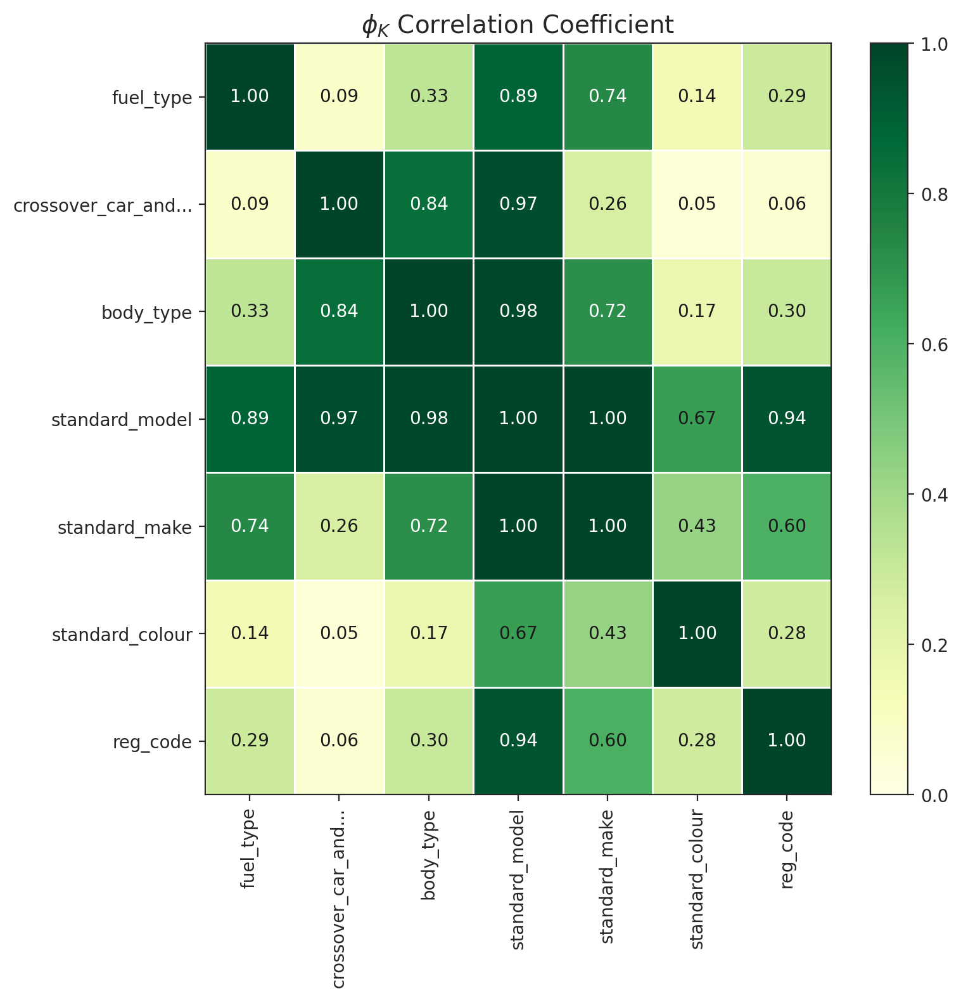

In [ ]:
#Some of the most relevant "non-metric variables" to graph and inspect are the followings:
    #reg_code
    #standard_colour
    #standard_make
    #body_type
    #fuel_type
    #standard_model
    #crossover_car_and_van

#Function for Phi-k Matrix (computation and plot)
def EDA_phimatrix(data):

  #Computing the "Phi-k Matrix" using only non-metric variables
  non_metrix_matrix = data[["reg_code",'standard_colour', 'standard_make', "standard_model","body_type","crossover_car_and_van","fuel_type"]]
  matrix_phik = non_metrix_matrix.phik_matrix()

  #Plotting the "Phi-k Matrix" using only non-metric variables
  plot_correlation_matrix(matrix_phik.values, x_labels=matrix_phik.columns, y_labels=matrix_phik.index,
                        vmin=0, vmax=1, color_map='YlGn', title=r'$\phi_K$ Correlation Coefficient', fontsize_factor=1,
                        figsize=(8,8))
  plt.tight_layout()

EDA_phimatrix(data)

### **3.2.5. METRIC VARIABLES (BIVARIATE ANALYSIS)**

* Pairplot
* JointPlot
* Scatterplots
* Pearson Correlation Coefficient
* Spearman Correlation Coefficient

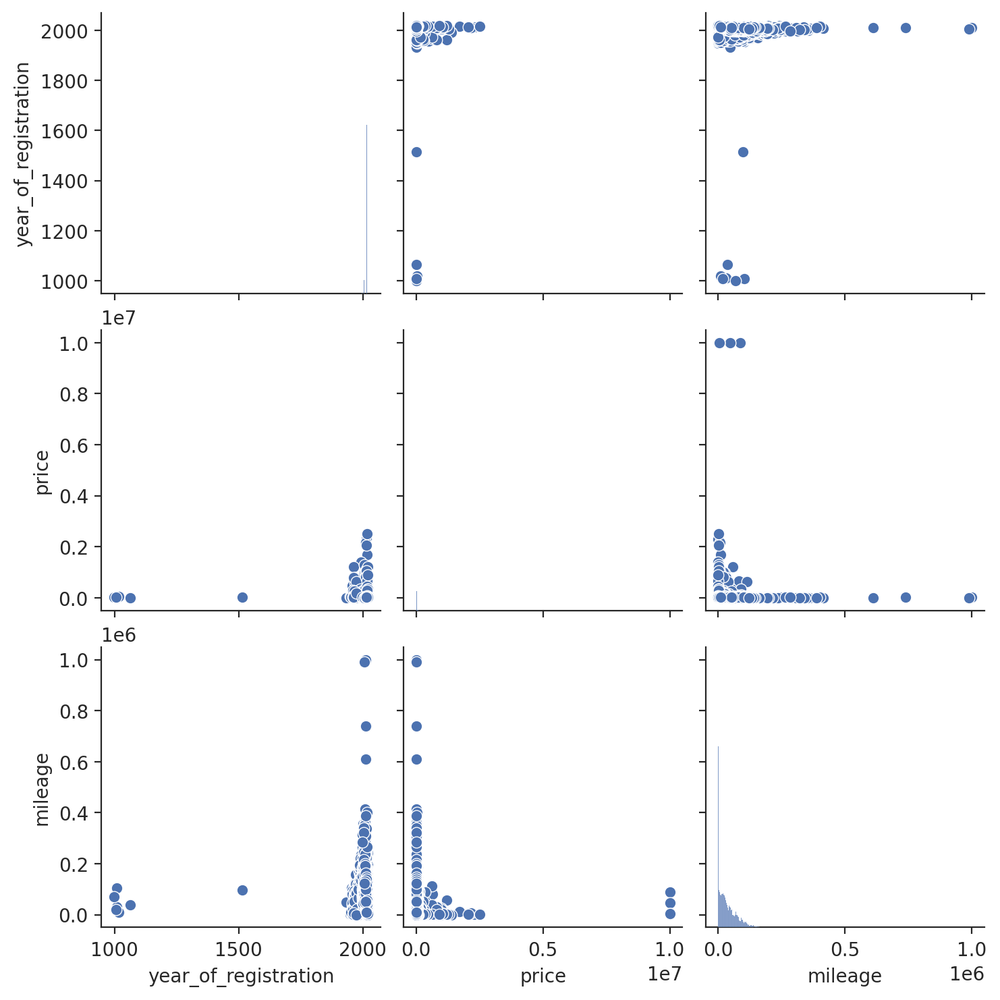

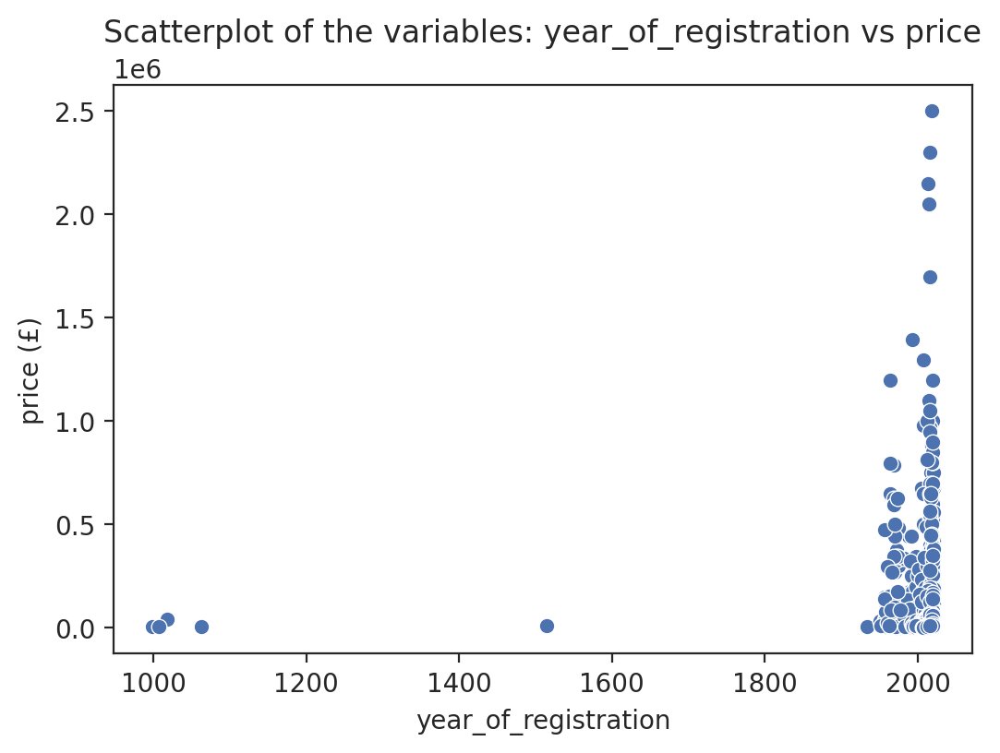


  Scatterplot [mileage vs price] 



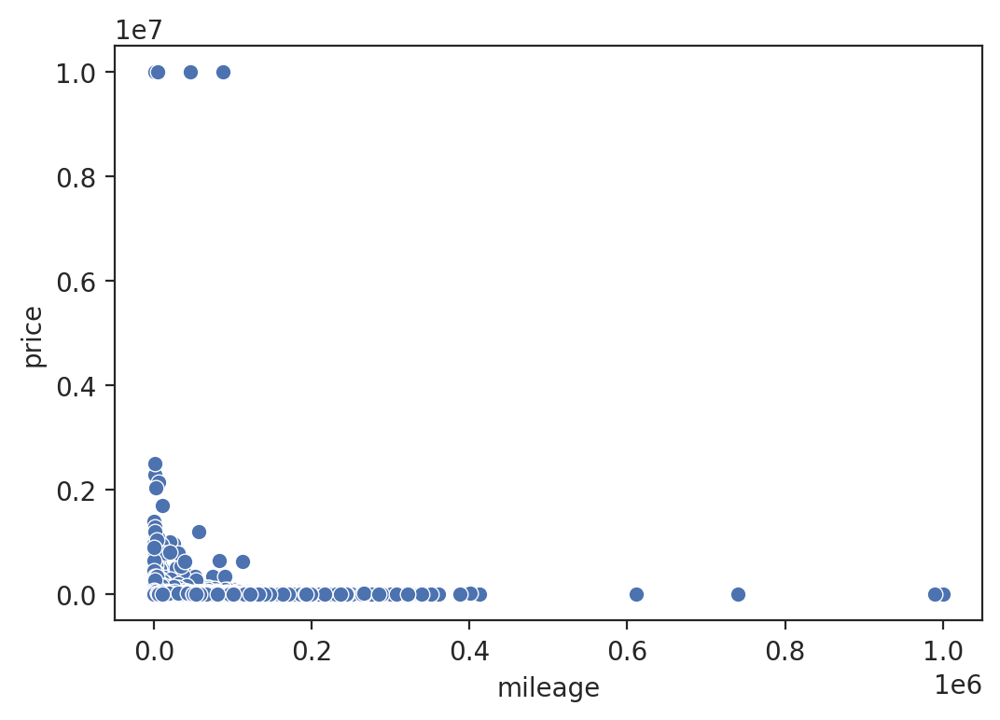


  Scatterplot [public_reference vs price] 



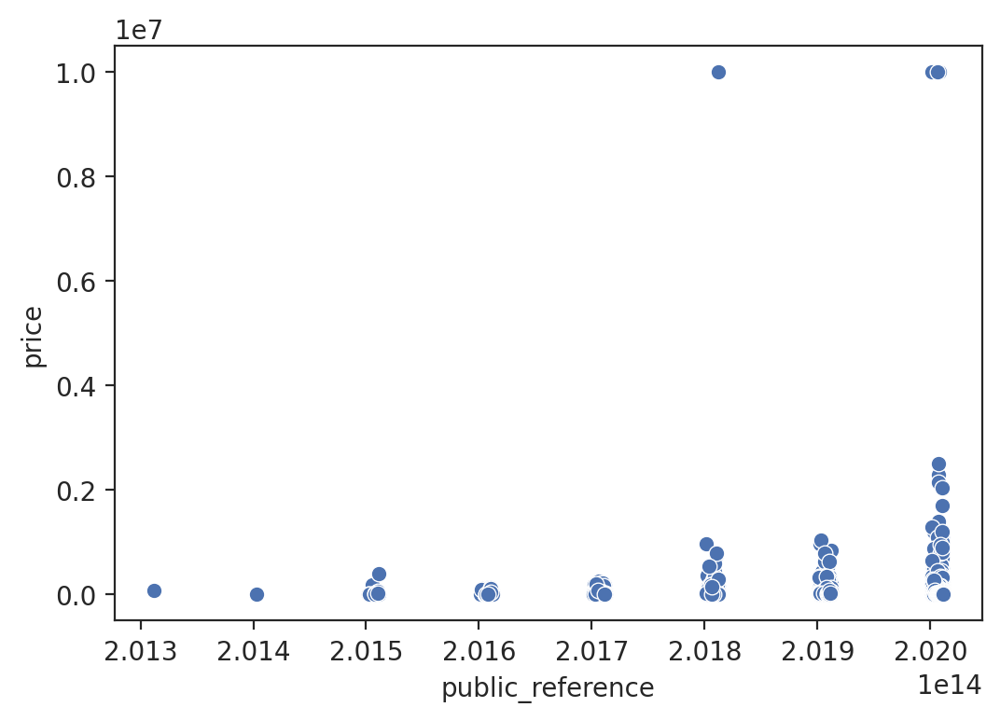


  Scatterplot [year_of_registration vs mileage] 



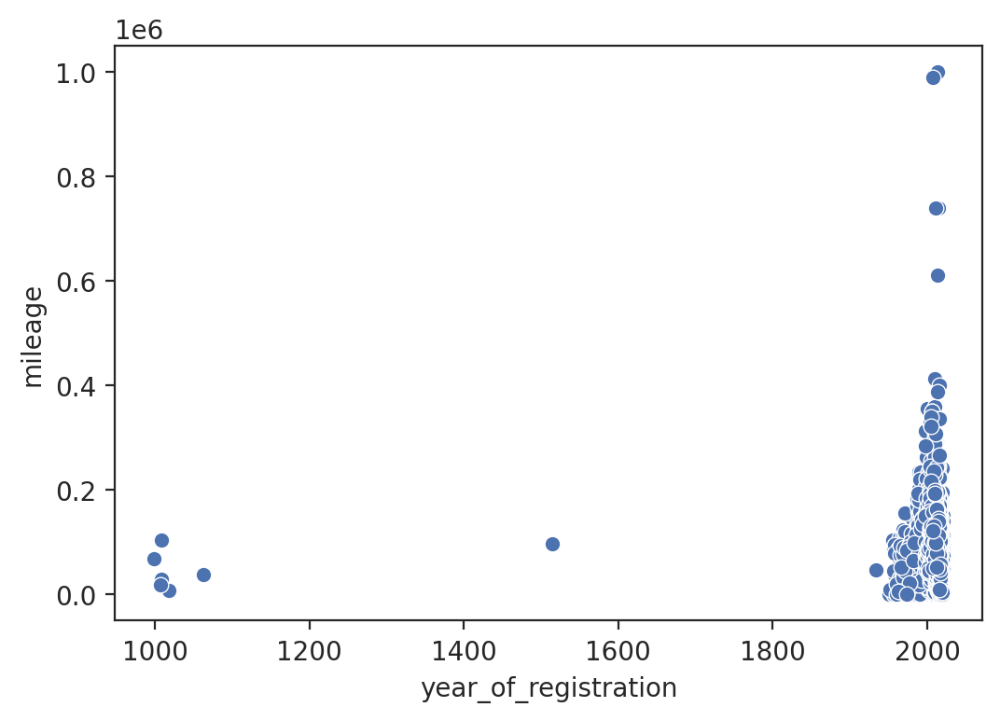


  Scatterplot [year_of_registration vs price (Subset 25% - 75% Percentile)] 



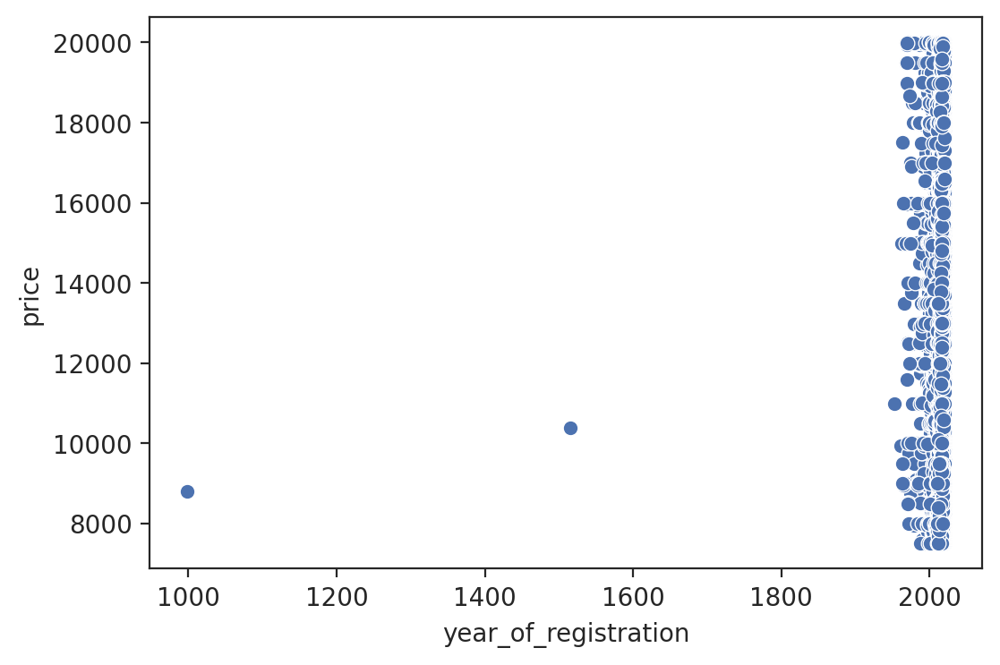


  Scatterplot [year_of_registration (Subset 25% - 75% Percentile) vs price] 



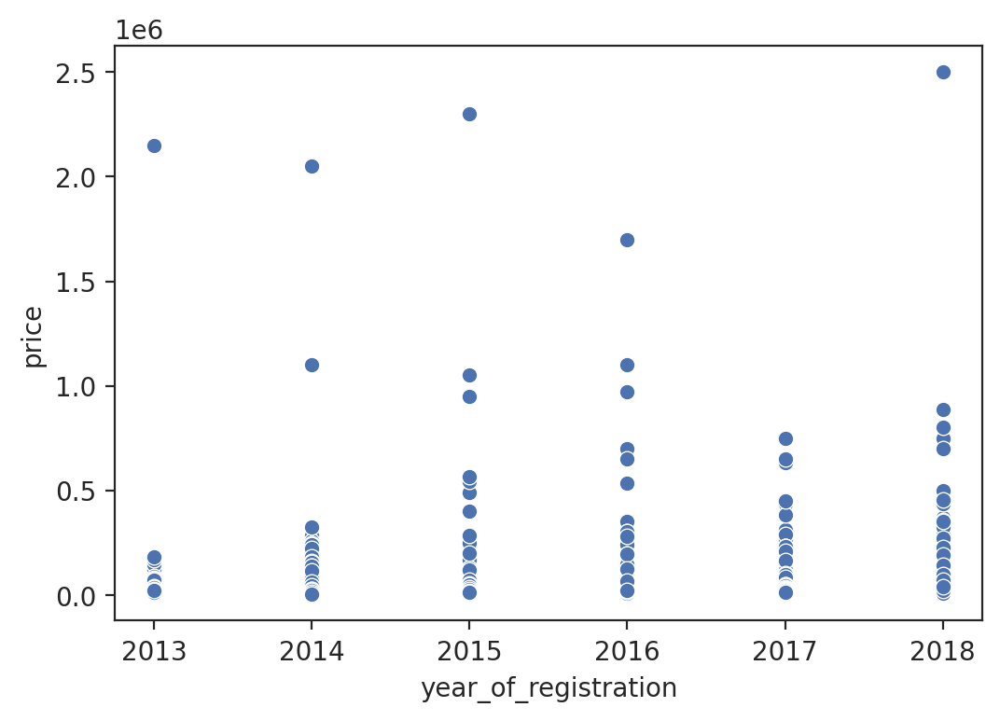


  Scatterplot [mileage vs price (Subset 25% - 75% Percentile)] 



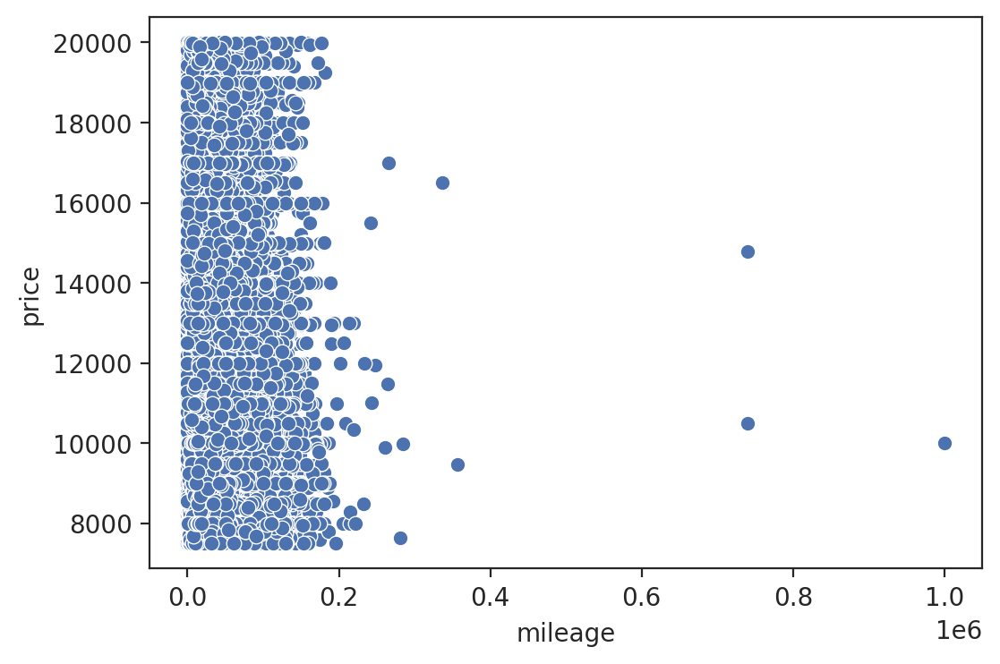

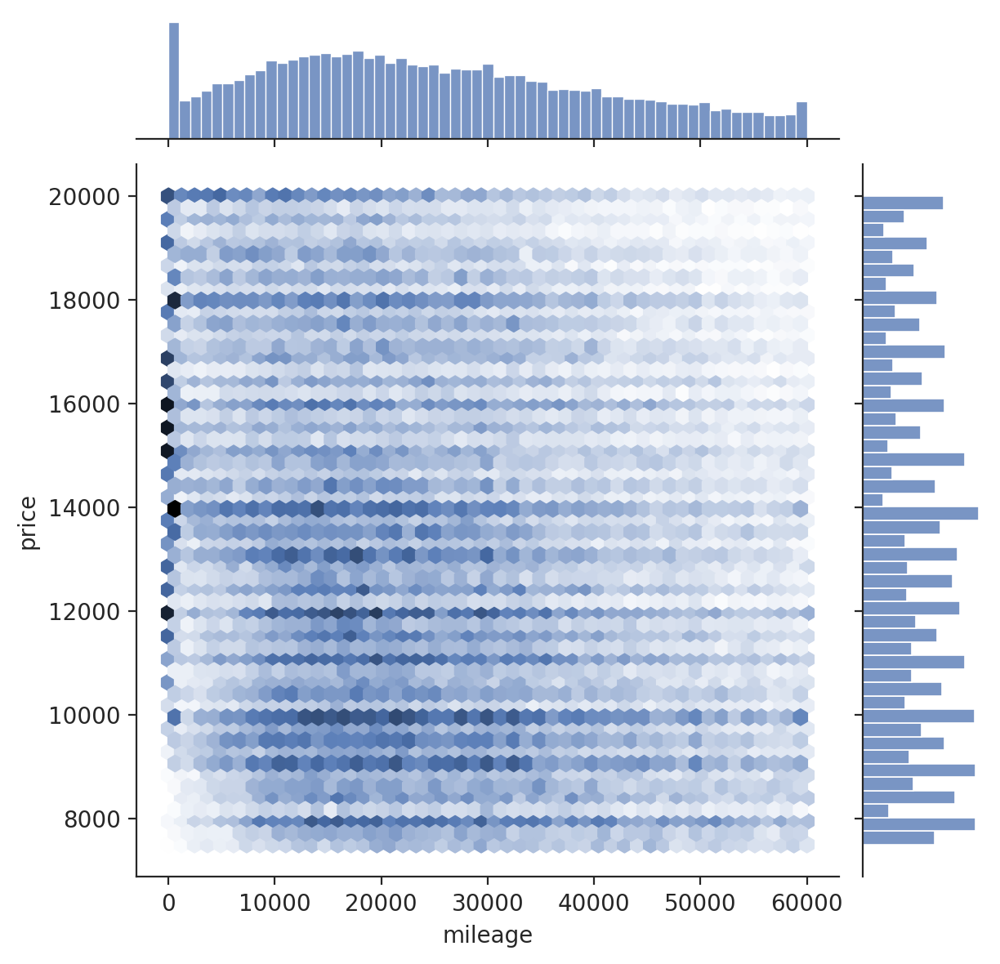

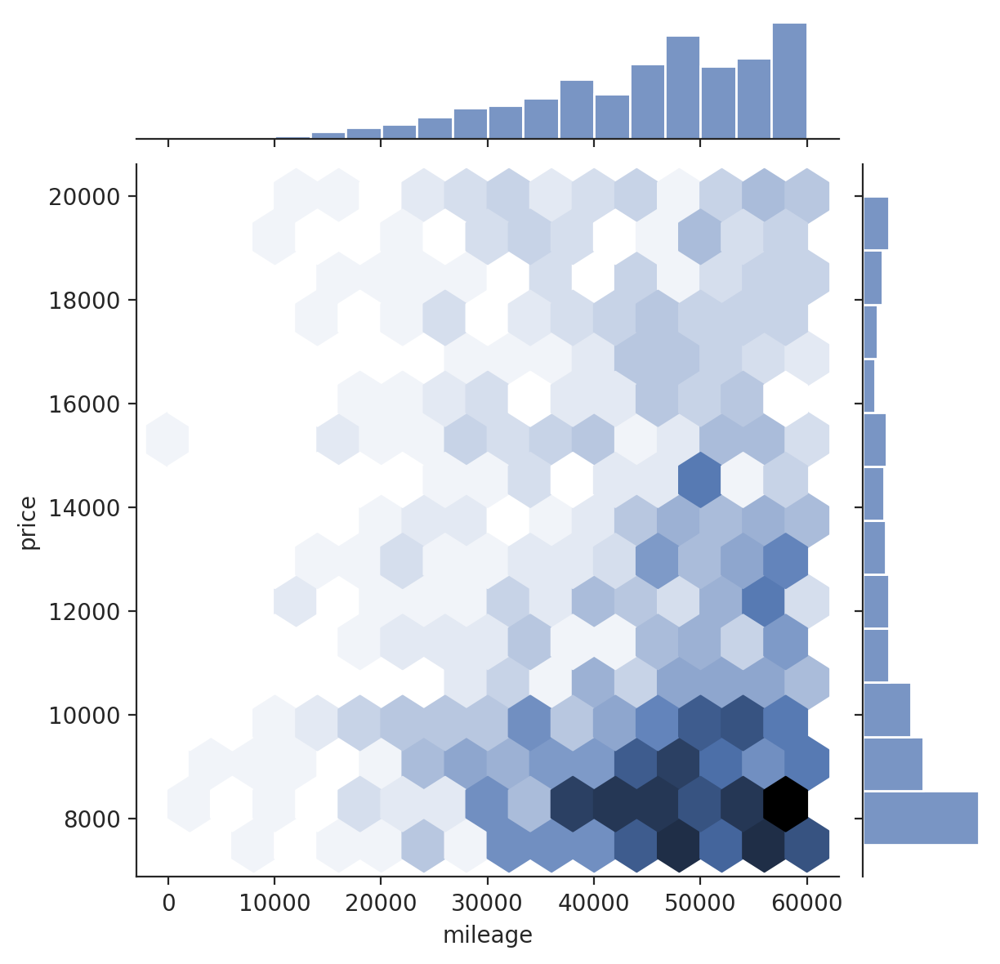

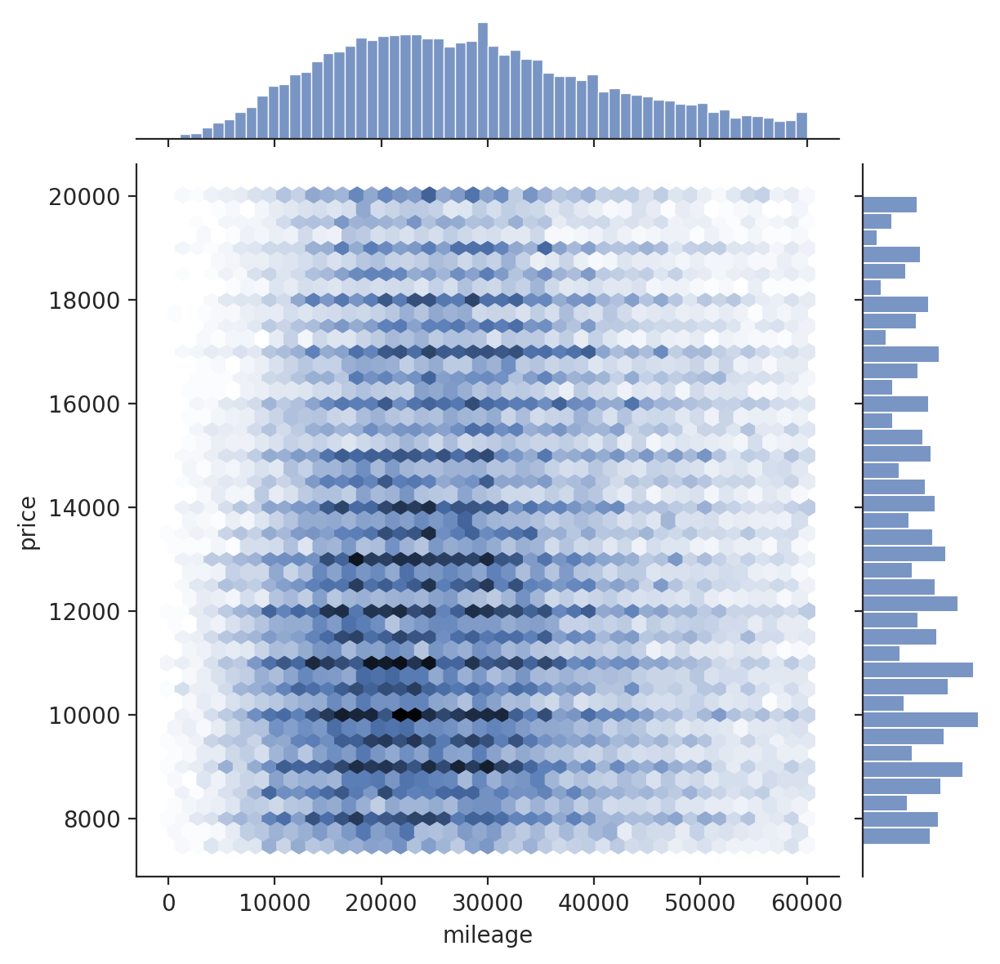

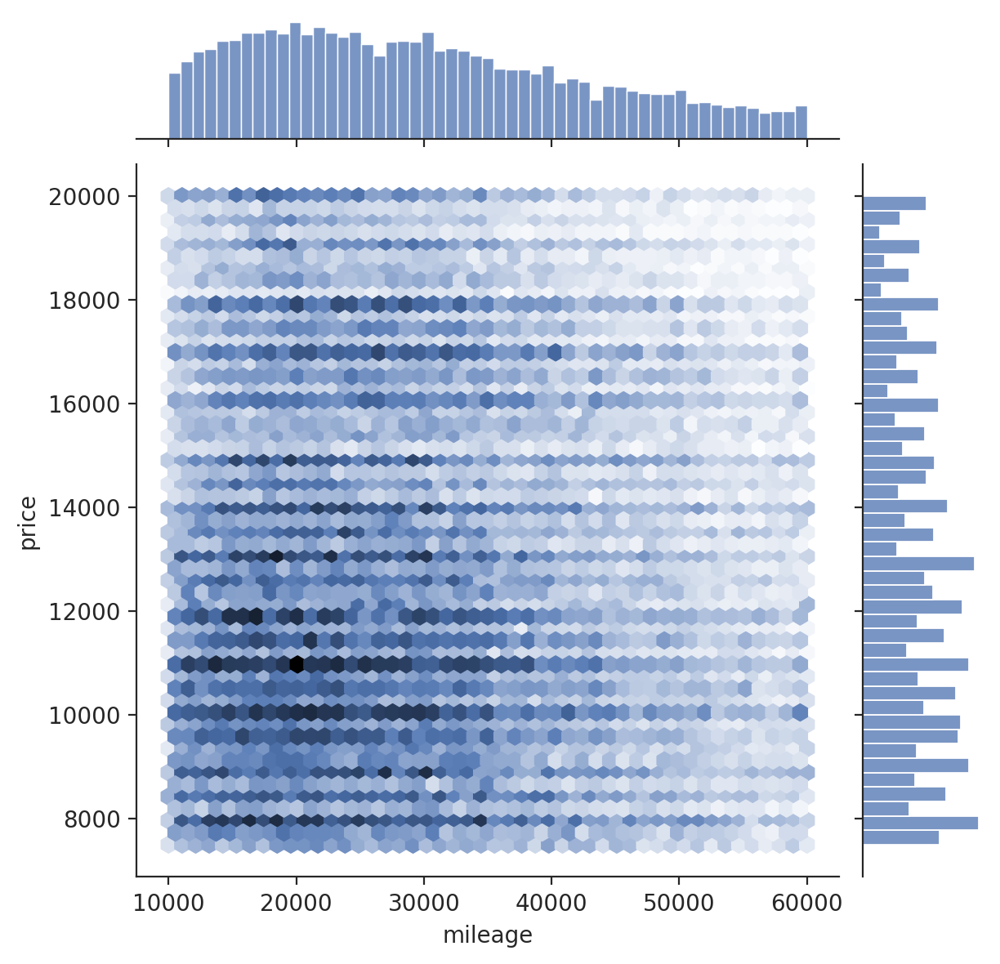

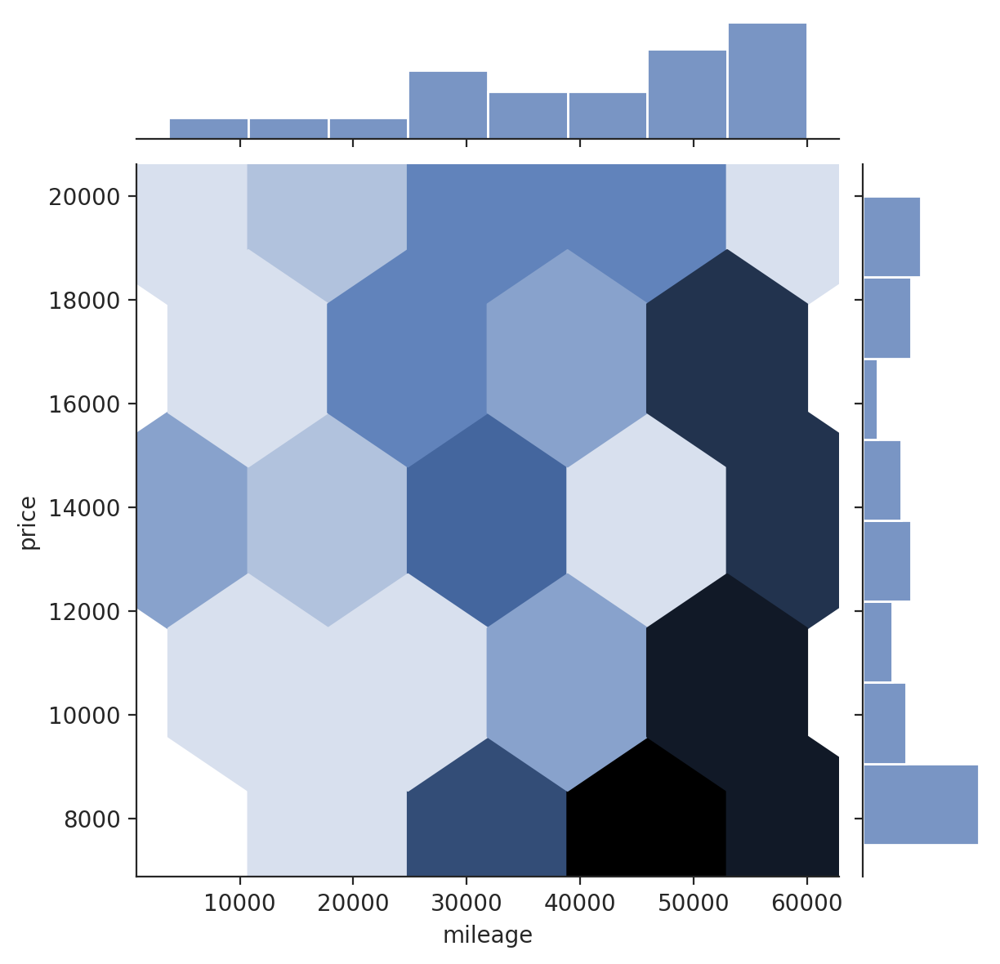

In [ ]:
#Function for Scatterplots
def EDA_Graph_Extra3(data):

  #Pairplot
  data_pairplot = data[['year_of_registration', 'price',"mileage"]]
  sns.pairplot(data_pairplot)
  plt.show()

  #year_of_registration vs price
  sns.scatterplot(x='year_of_registration', y='price', data=data)
  plt.xlabel('year_of_registration')
  plt.ylabel('price (£)')
  plt.title('Scatterplot of the variables: year_of_registration vs price')
  plt.show()

      ##########################################################################################################################

  #mileage vs price
  print("\n" +'\033[1m','\033[46m', "Scatterplot [mileage vs price]", '\033[0m' + "\n")
  sns.scatterplot(x='mileage', y='price', data=data)
  plt.show()

      ##########################################################################################################################

  #public_reference vs price
  print("\n" +'\033[1m','\033[46m', "Scatterplot [public_reference vs price]", '\033[0m' + "\n")
  sns.scatterplot(x='public_reference', y='price', data=data)
  plt.xlabel('public_reference')
  plt.ylabel('price')
  plt.show()

      ##########################################################################################################################

  #year_of_registration vs mileage
  print("\n" +'\033[1m','\033[46m', "Scatterplot [year_of_registration vs mileage]", '\033[0m' + "\n")
  sns.scatterplot(x='year_of_registration', y='mileage', data=data)
  plt.show()

      ##########################################################################################################################

  #year_of_registration vs price (Subset 25% - 75% Percentile)
  print("\n" +'\033[1m','\033[46m', "Scatterplot [year_of_registration vs price (Subset 25% - 75% Percentile)]", '\033[0m' + "\n")
  df9999 = data[(data['price'] >= data['price'].quantile(0.25)) & (data['price'] <= data['price'].quantile(0.75))]
  sns.scatterplot(x='year_of_registration', y='price', data=df9999)
  # Add labels and title
  plt.show()

      ##########################################################################################################################

  #year_of_registration (Subset 25% - 75% Percentile) vs price
  print("\n" +'\033[1m','\033[46m', "Scatterplot [year_of_registration (Subset 25% - 75% Percentile) vs price]", '\033[0m' + "\n")
  df1000 = data.query("2013<=year_of_registration<=2018")
  sns.scatterplot(x='year_of_registration', y='price', data=df1000)
  # Add labels and title
  plt.show()

      ##########################################################################################################################

  #mileage vs price (Subset 25% - 75% Percentile)
  print("\n" +'\033[1m','\033[46m', "Scatterplot [mileage vs price (Subset 25% - 75% Percentile)]", '\033[0m' + "\n")
  df9999 = data[(data['price'] >= data['price'].quantile(0.25)) & (data['price'] <= data['price'].quantile(0.75))]
  sns.scatterplot(x='mileage', y='price', data=df9999)
  # Add labels and title
  plt.show()

      ##########################################################################################################################

  #NEW: price (between the 0.25 Percentile and 075 Percentile)
  df89581 = data[(data['price'] >= data['price'].quantile(0.25)) & (data['price'] <= data['price'].quantile(0.75))]
  df119581 = df89581.query("2010<year_of_registration<=2020")
  df11950101 = df119581.query("0<mileage<=60000")

  sns.jointplot(data=df11950101, x="mileage", y="price",kind="hex")
  plt.show()

        ##########################################################################################################################

  #NEW: price (between the 0.25 Percentile and 075 Percentile)
  df89582 = data[(data['price'] >= data['price'].quantile(0.25)) & (data['price'] <= data['price'].quantile(0.75))]
  df119582 = df89582.query("2000<year_of_registration<=2010")
  df11952102 = df119582.query("0<mileage<=60000")

  sns.jointplot(data=df11952102, x="mileage", y="price",kind="hex")
  plt.show()

          ##########################################################################################################################

  #NEW: price (between the 0.25 Percentile and 075 Percentile)
  df89583 = data[(data['price'] >= data['price'].quantile(0.25)) & (data['price'] <= data['price'].quantile(0.75))]
  df119583 = df89583.query("2015<year_of_registration<=2017")
  df11950103 = df119583.query("0<mileage<=60000")

  sns.jointplot(data=df11950103, x="mileage", y="price",kind="hex")
  plt.show()

            ##########################################################################################################################

  #NEW: price (between the 0.25 Percentile and 075 Percentile)
  df89584 = data[(data['price'] >= data['price'].quantile(0.25)) & (data['price'] <= data['price'].quantile(0.75))]
  df119584 = df89584.query("2013<year_of_registration<=2018")
  df11950104 = df119584.query("10000<mileage<=60000")

  sns.jointplot(data=df11950104, x="mileage", y="price",kind="hex")
  plt.show()

              ##########################################################################################################################

  #NEW: price (between the 0.25 Percentile and 075 Percentile)
  df89584 = data[(data['price'] >= data['price'].quantile(0.25)) & (data['price'] <= data['price'].quantile(0.75))]
  df119584 = df89584.query("1990<year_of_registration<=2000")
  df11950104 = df119584.query("0<mileage<=60000")

  sns.jointplot(data=df11950104, x="mileage", y="price",kind="hex")
  plt.show()

EDA_Graph_Extra3(data)

In [ ]:
#Choosing the metric variables of the training dataset
df_qq_271 = data.select_dtypes(include=["number"])

#"Pearson's Correlation Coefficient of the metric variables" of the training dataset
corr_Pearson_matrix_df_qq_271 = df_qq_271.corr()

#Sorting values (useful for Section 2.6.3)
corr_Pearson_serie_df_qq_271 = corr_Pearson_matrix_df_qq_271["price"].sort_values(ascending=False)

print("\n" +'\033[1m','\033[46m', "Correlation Matrix (Pearson Coefficient)", '\033[0m' + "\n")
corr_Pearson_matrix_df_qq_271


  Correlation Matrix (Pearson Coefficient) 



,public_reference,mileage,year_of_registration,price
public_reference,1.000000,0.039017,0.021518,-0.052097
mileage,0.039017,1.000000,-0.435530,-0.144140
year_of_registration,0.021518,-0.435530,1.000000,0.125117
price,-0.052097,-0.144140,0.125117,1.000000


In [ ]:
#"Spearman's Rank Correlation Coefficient of the metric variables" of the training dataset
corr_Spearman_matrix_df_qq_271 = df_qq_271.corr(method="spearman")

#Sorting values (useful for Section 2.6.3)
corr_Spearman_serie_df_qq_271 = corr_Spearman_matrix_df_qq_271["price"].sort_values(ascending=False)

print("\n" +'\033[1m','\033[46m', "Correlation Matrix (Spearman Coefficient)", '\033[0m' + "\n")
corr_Spearman_matrix_df_qq_271


  Correlation Matrix (Spearman Coefficient) 



,public_reference,mileage,year_of_registration,price
public_reference,1.000000,0.156967,-0.109770,-0.109984
mileage,0.156967,1.000000,-0.825295,-0.645950
year_of_registration,-0.109770,-0.825295,1.000000,0.677175
price,-0.109984,-0.645950,0.677175,1.000000


In [ ]:
#Transforming the series of correlation with the variable price (from Section 2.6.1. and 2.6.2.) into dataframes
corr_Pearson_df_1 = pd.DataFrame(corr_Pearson_serie_df_qq_271)
corr_Spearman_df_1 = pd.DataFrame(corr_Spearman_serie_df_qq_271)

#Reseting the indexes of the newly created dataframes
corr_Pearson_df_1.reset_index(inplace=True)
corr_Spearman_df_1.reset_index(inplace=True)

#Renaming columns of the newly created dataframes
corr_Pearson_df_1 = corr_Pearson_df_1.rename(columns = {"index":"Metric Variable","price":"Pearson Correlation"})
corr_Spearman_df_1 = corr_Spearman_df_1.rename(columns = {"index":"Metric Variable","price":"Spearman Correlation"})

#Concatenating the newly created dataframes (Pearson and Spearman Correlation Coefficient of each feature with the target variable "Price")
print("\n" +'\033[1m','\033[46m', "Compare and Contrast Table  - Pearson Coefficient and Spearman Correlation Coefficient", '\033[0m' + "\n")
corr_compare_df_1 = pd.concat([corr_Pearson_df_1, corr_Spearman_df_1], axis=1)
corr_compare_df_1


  Compare and Contrast Table  - Pearson Coefficient and Spearman Correlation Coefficient 



,Metric Variable,Pearson Correlation,Metric Variable,Spearman Correlation
0,price,1.000000,price,1.000000
1,year_of_registration,0.125117,year_of_registration,0.677175
2,public_reference,-0.052097,public_reference,-0.109984
3,mileage,-0.144140,mileage,-0.645950


### **3.2.6. NON-METRIC VARIABLES & METRIC VARIABLES (BIVARIATE ANALYSIS)**

* Boxplots
* PointPlot
* JointPlot
* Predictive Power Score (PPS)

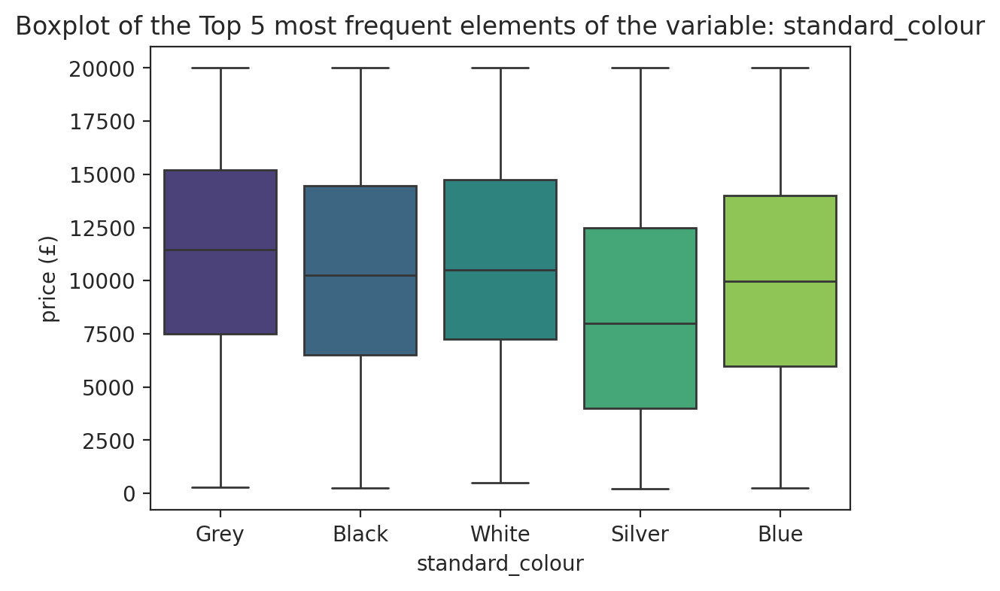


  Boxplot [standard_make vs price] 



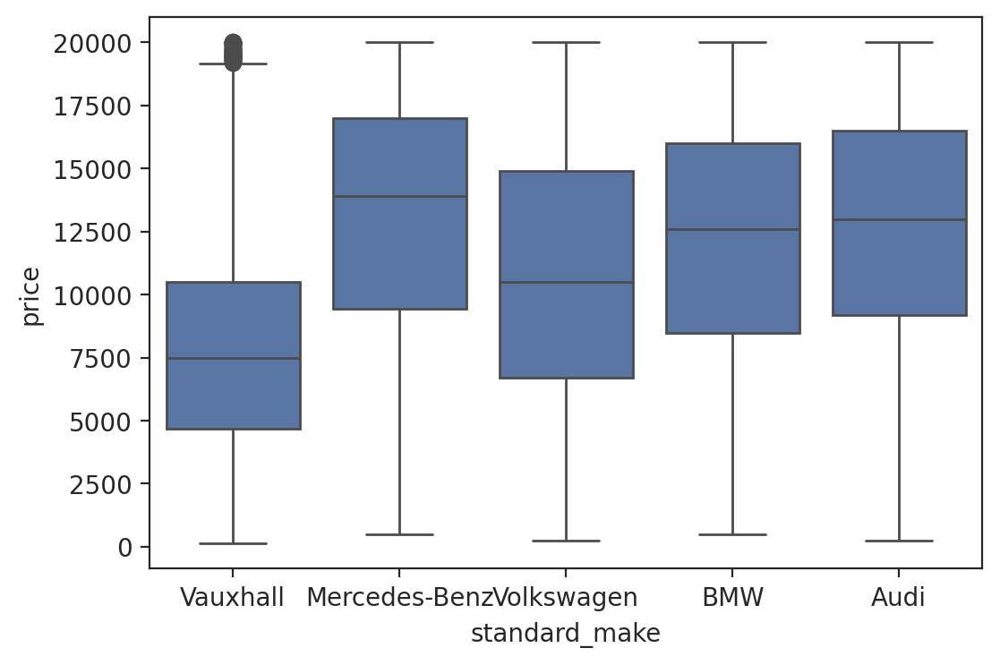


  Boxplot [body_type vs price] 



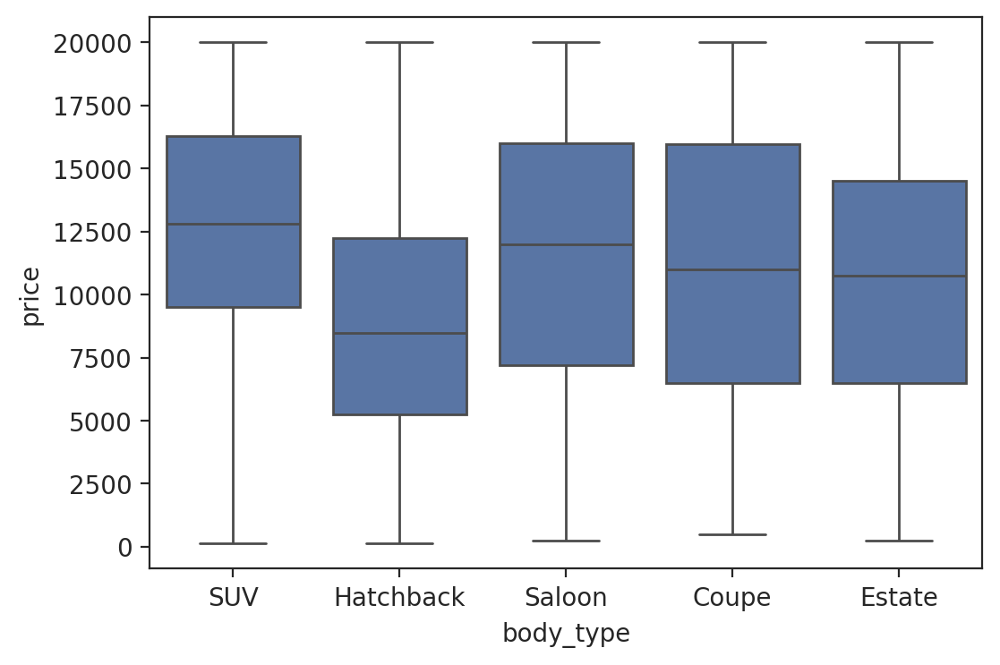


  Boxplot [fuel_type vs price] 



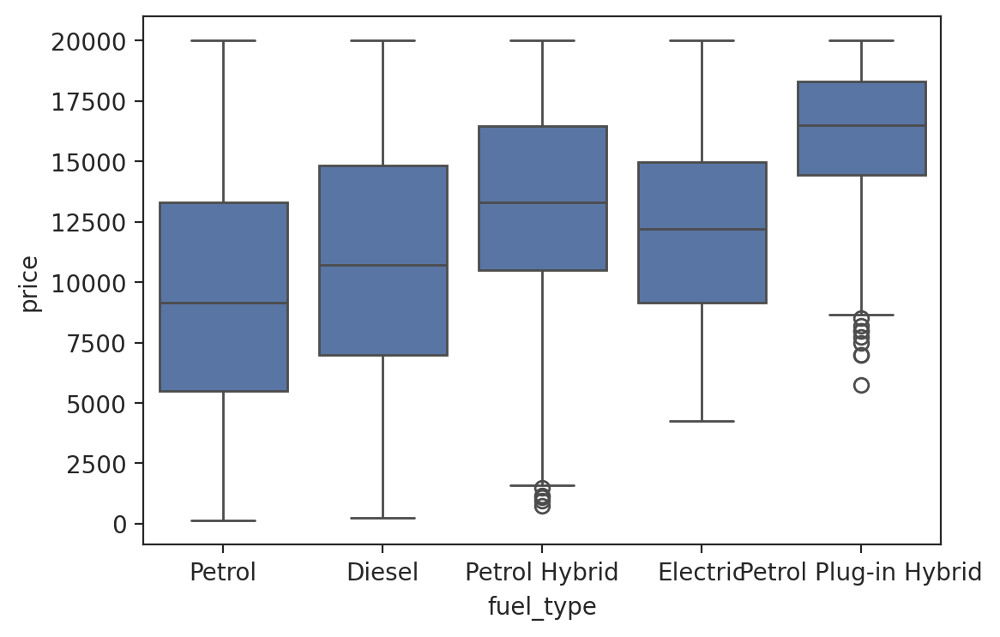


  Boxplot [standard_model vs price] 



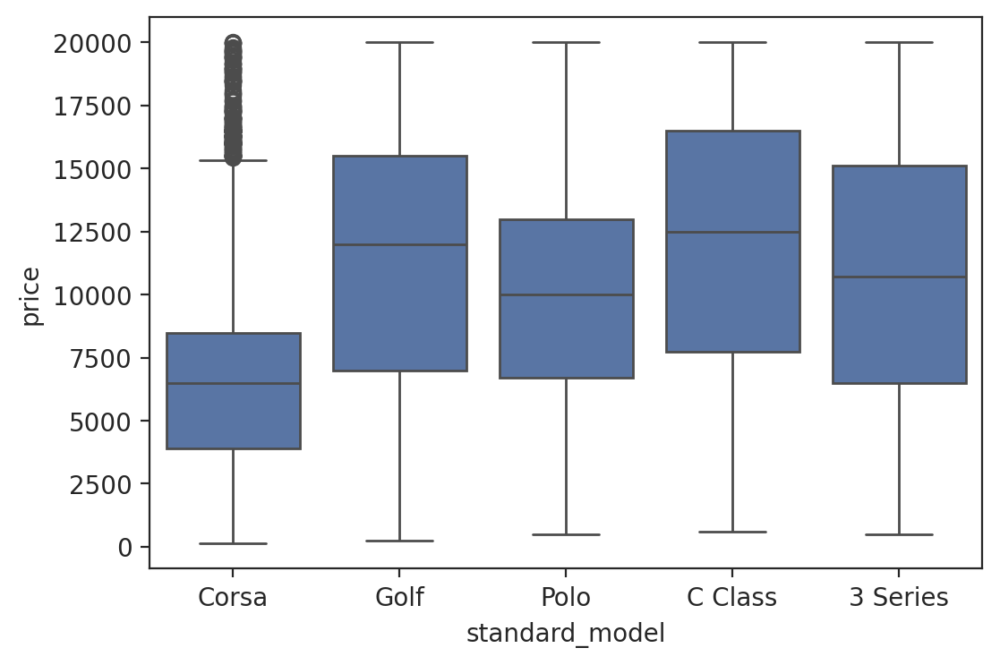


  Boxplot [vehicle_condition vs price] 



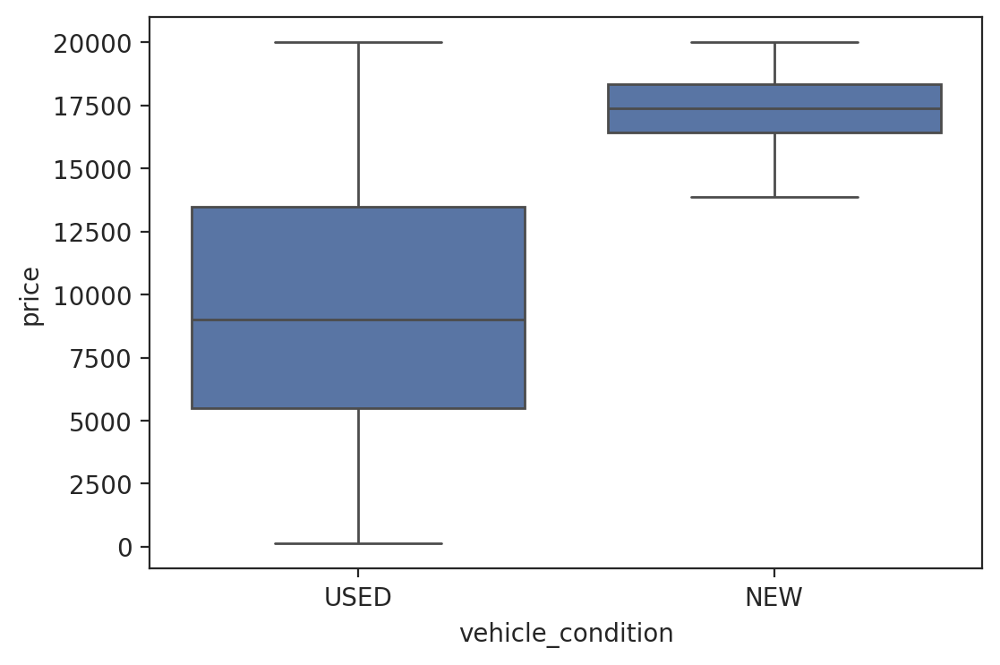


  Boxplot [standard_model vs year_of_registration] 



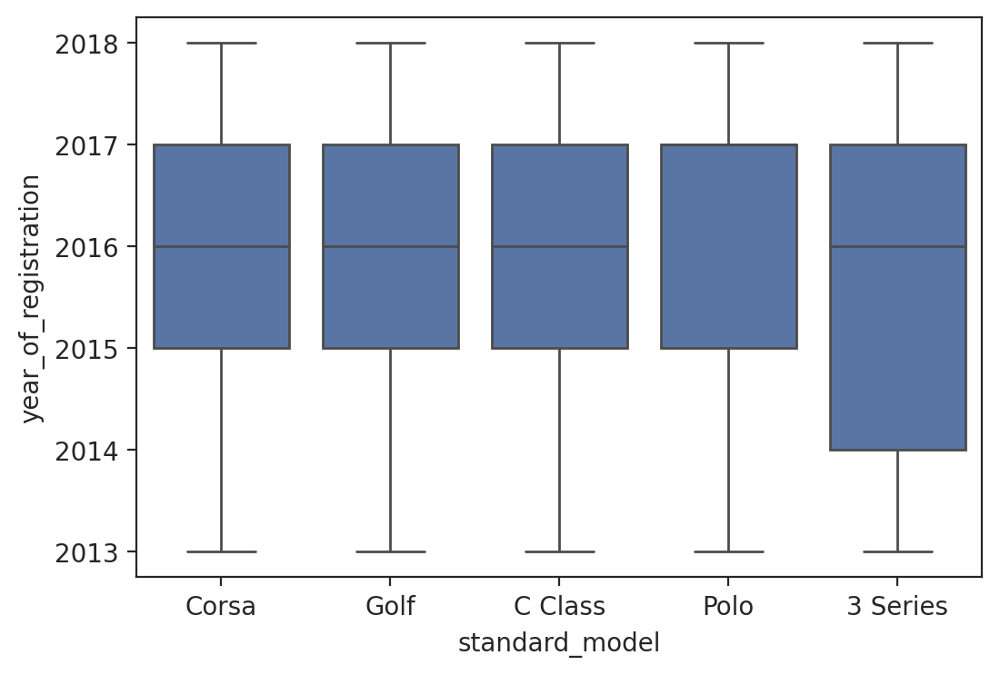


  Boxplot [standard_make vs year_of_registration] 



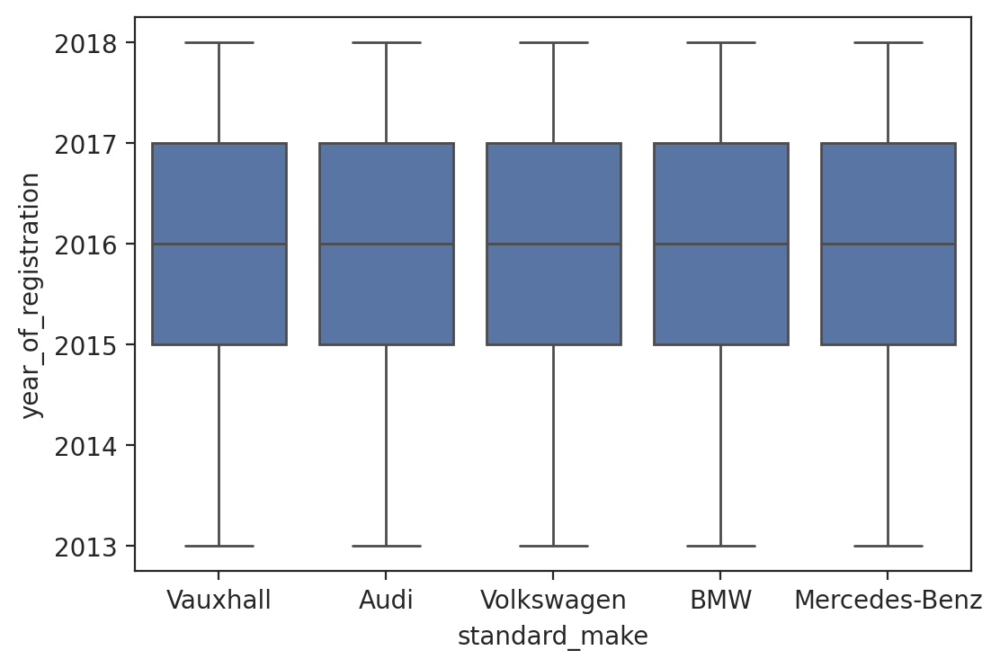


  Boxplot [standard_model vs mileage] 



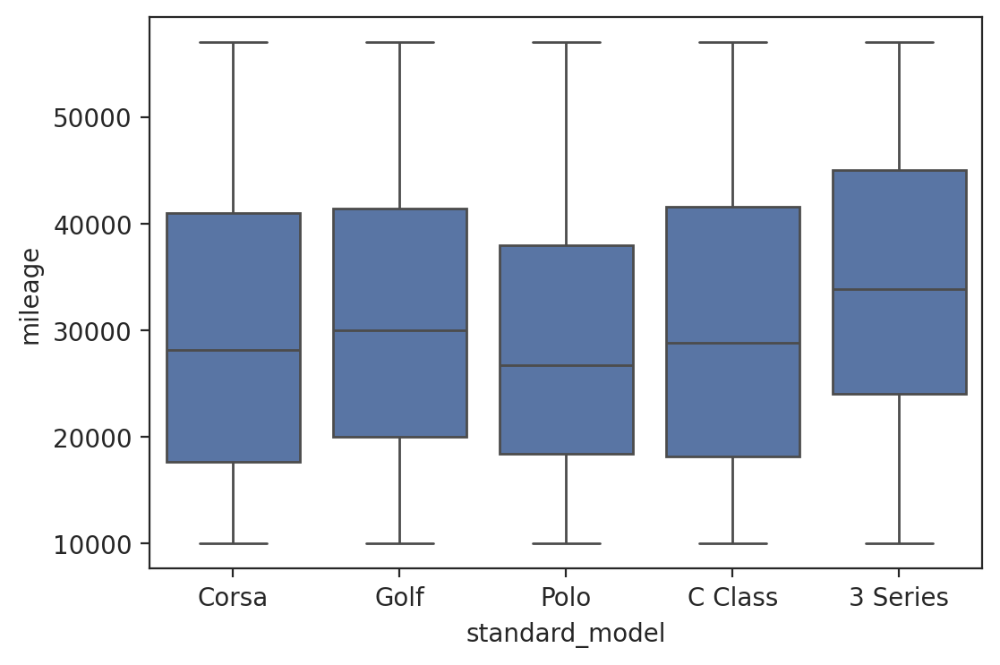


  Boxplot [standard_make vs mileage] 



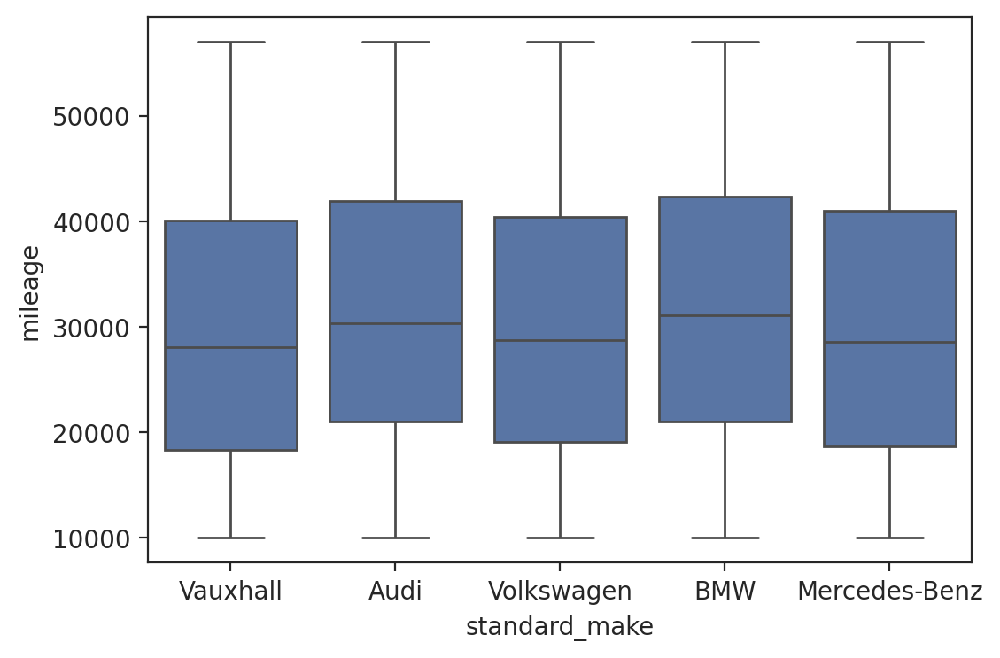

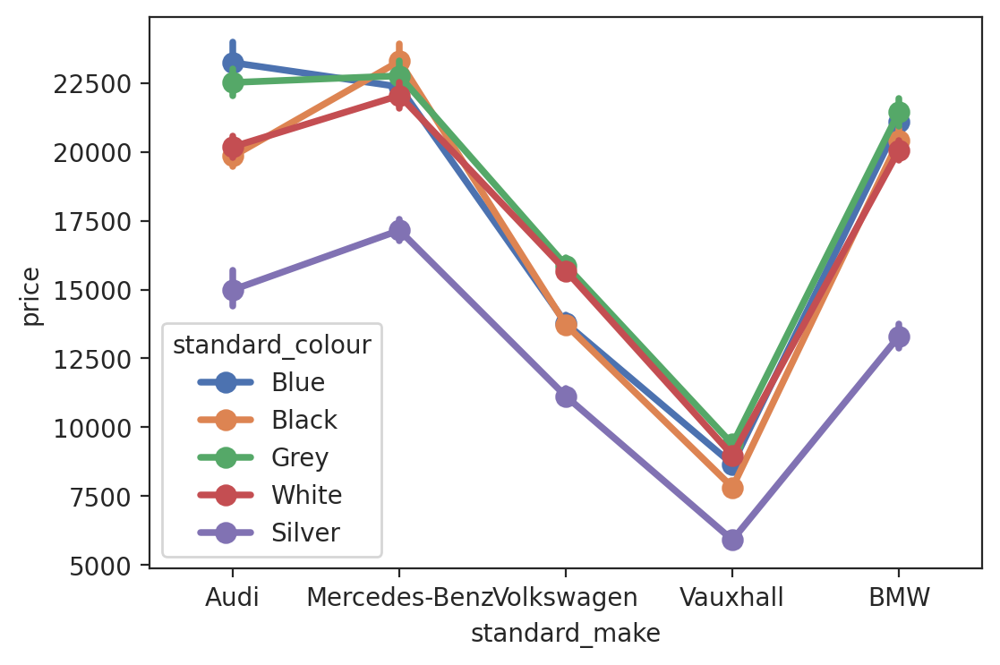

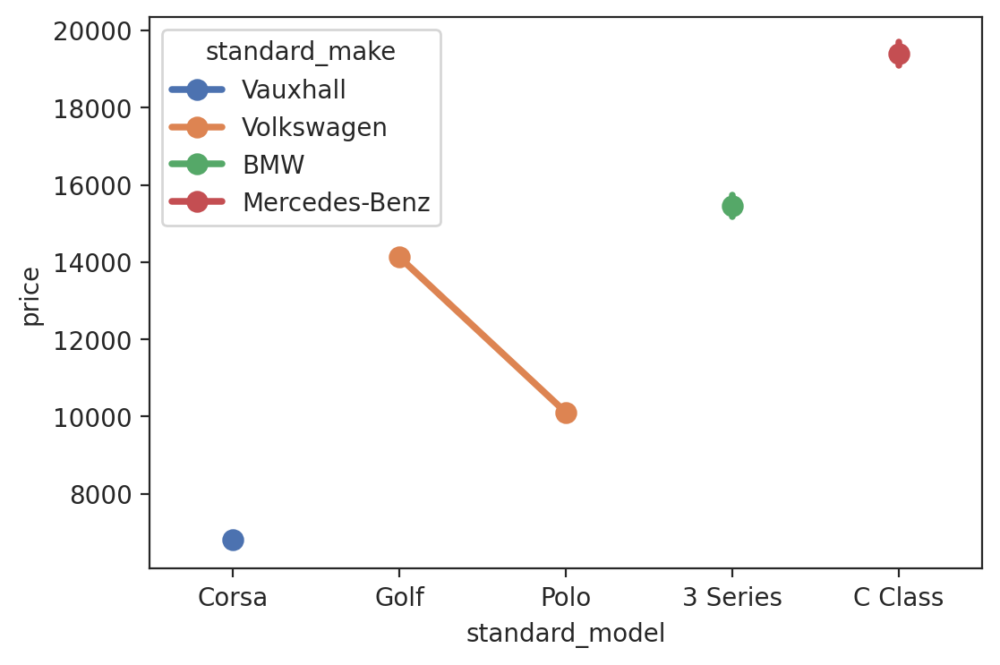

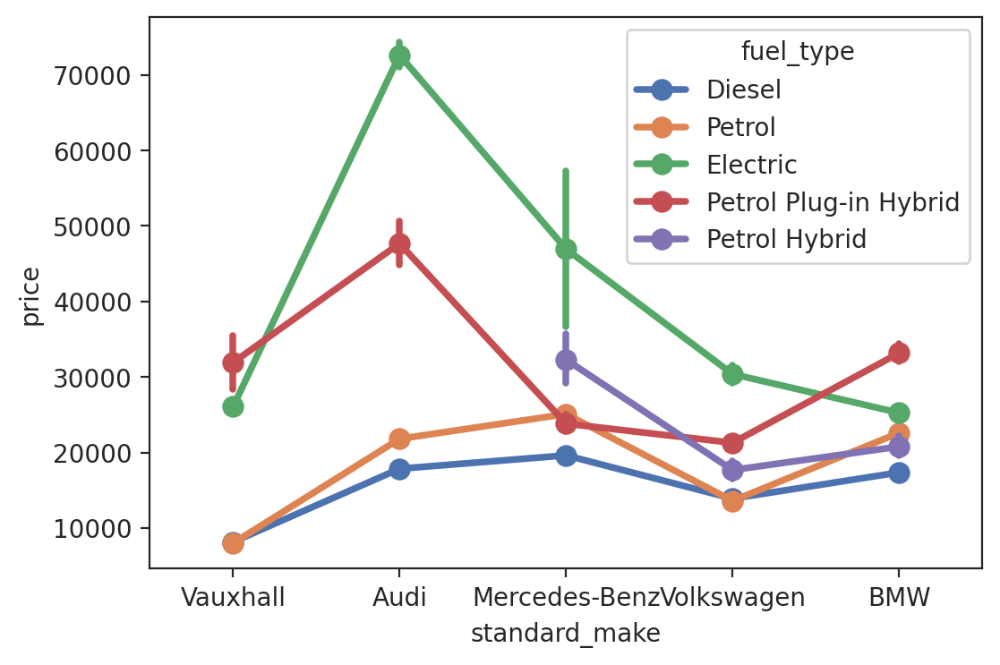

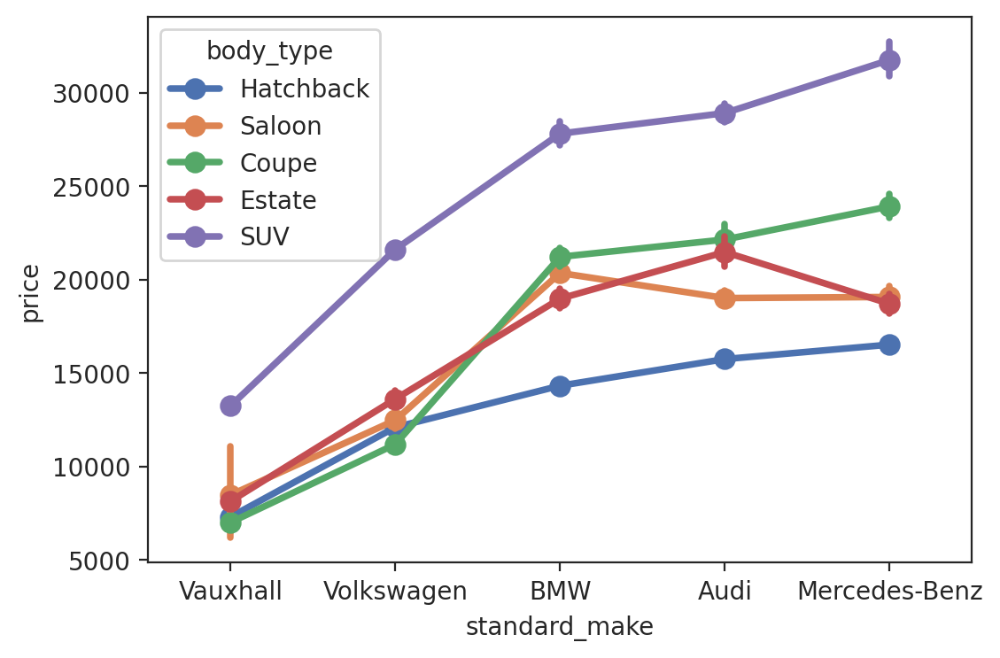

...

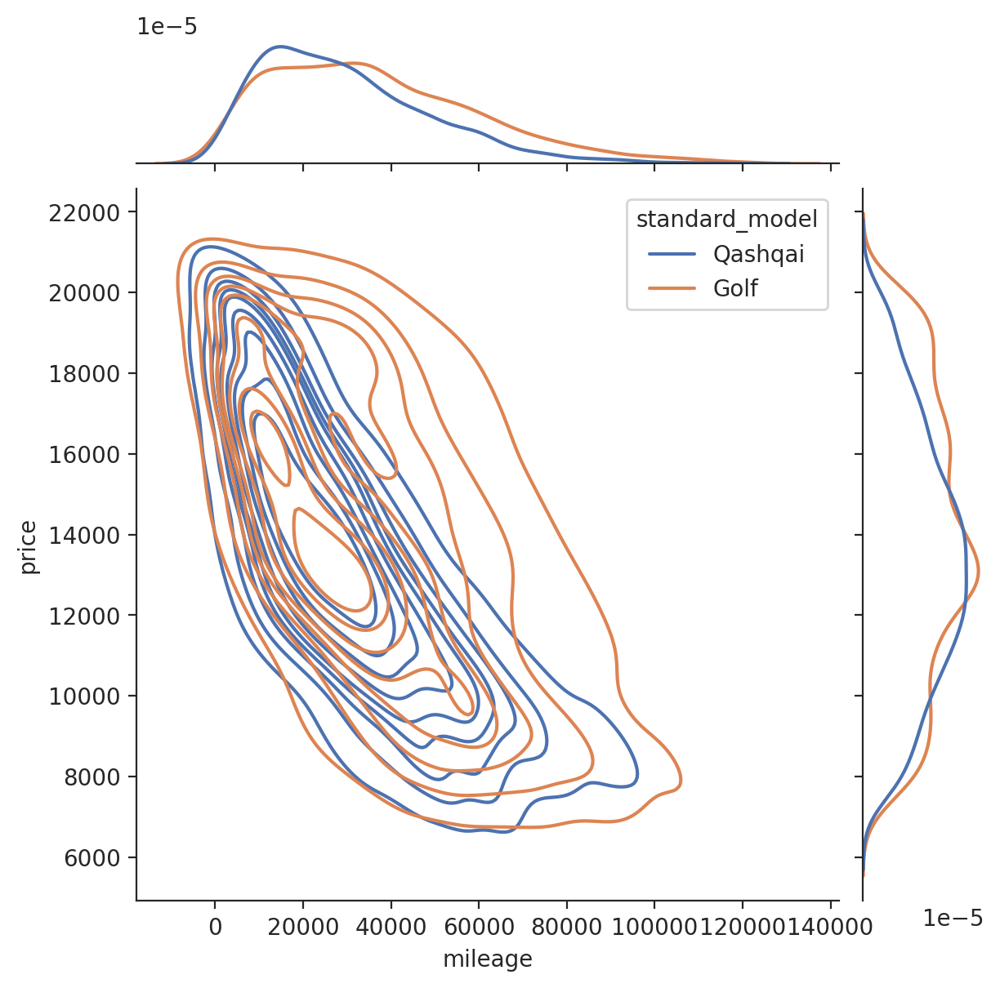

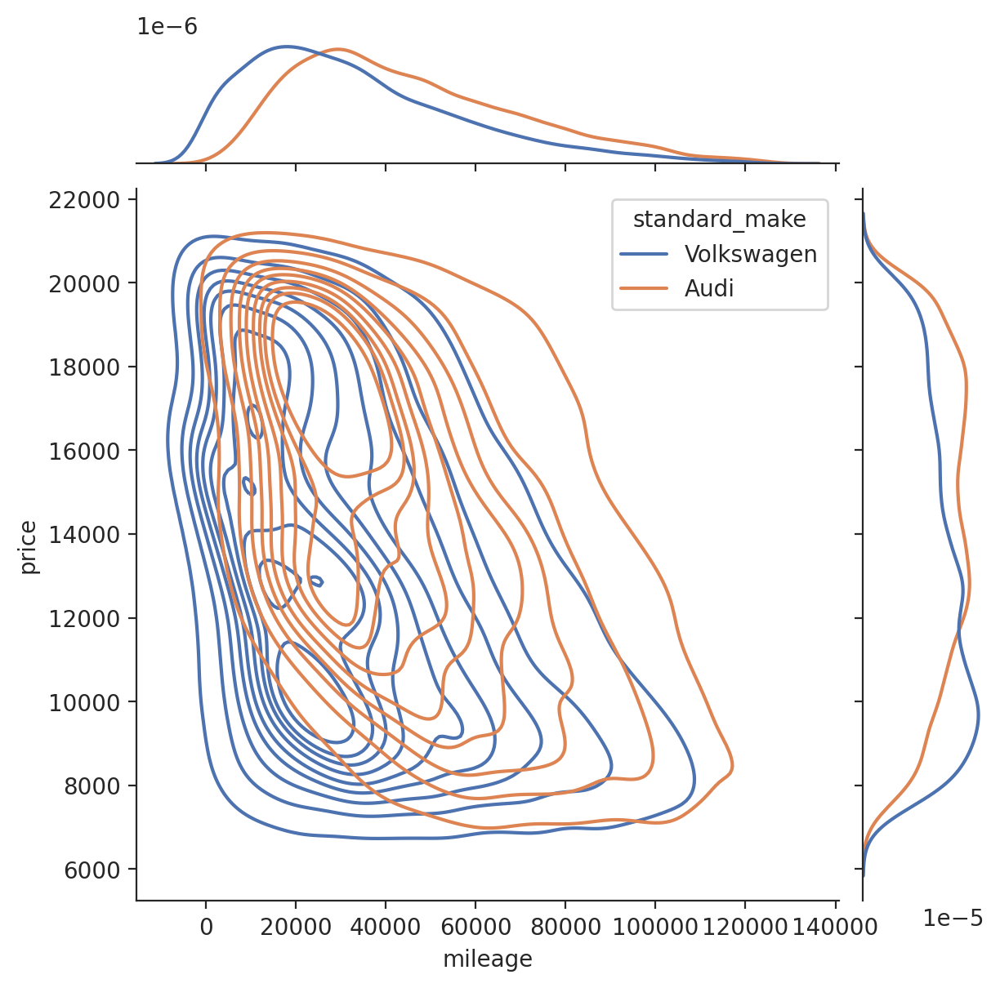

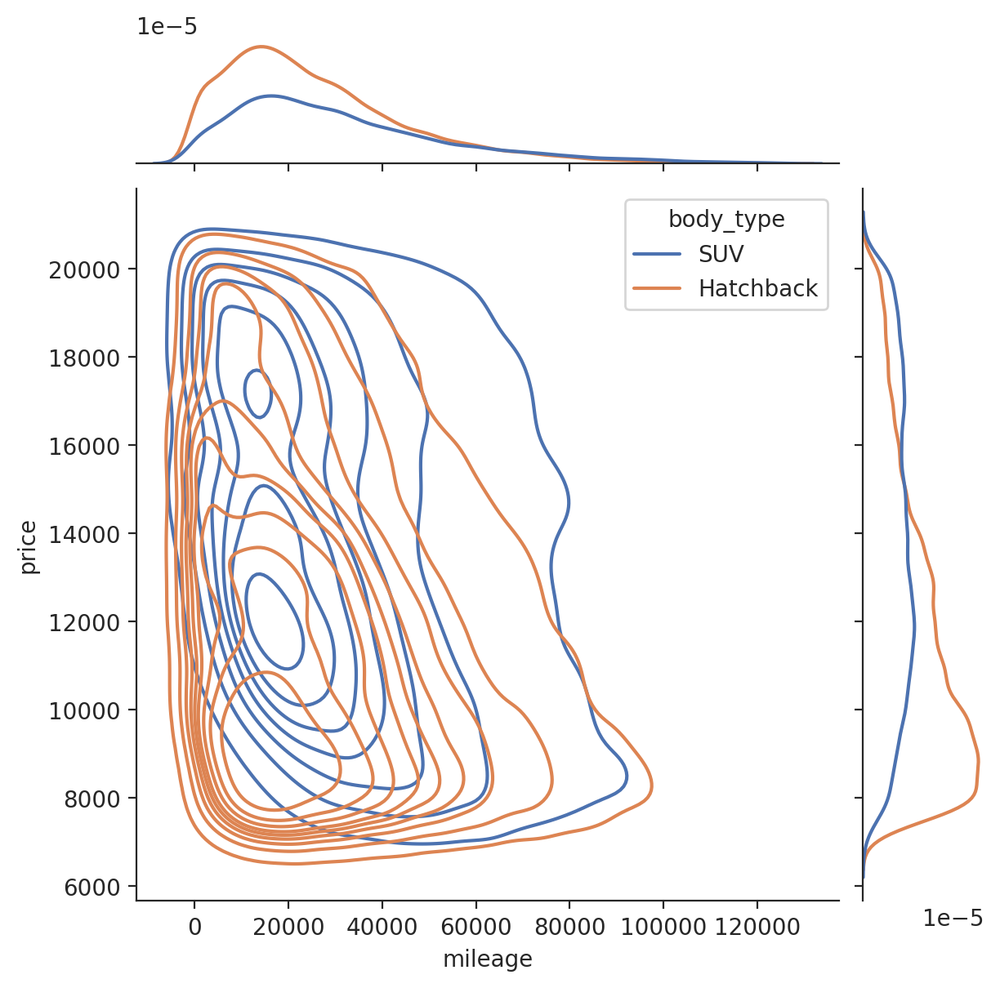

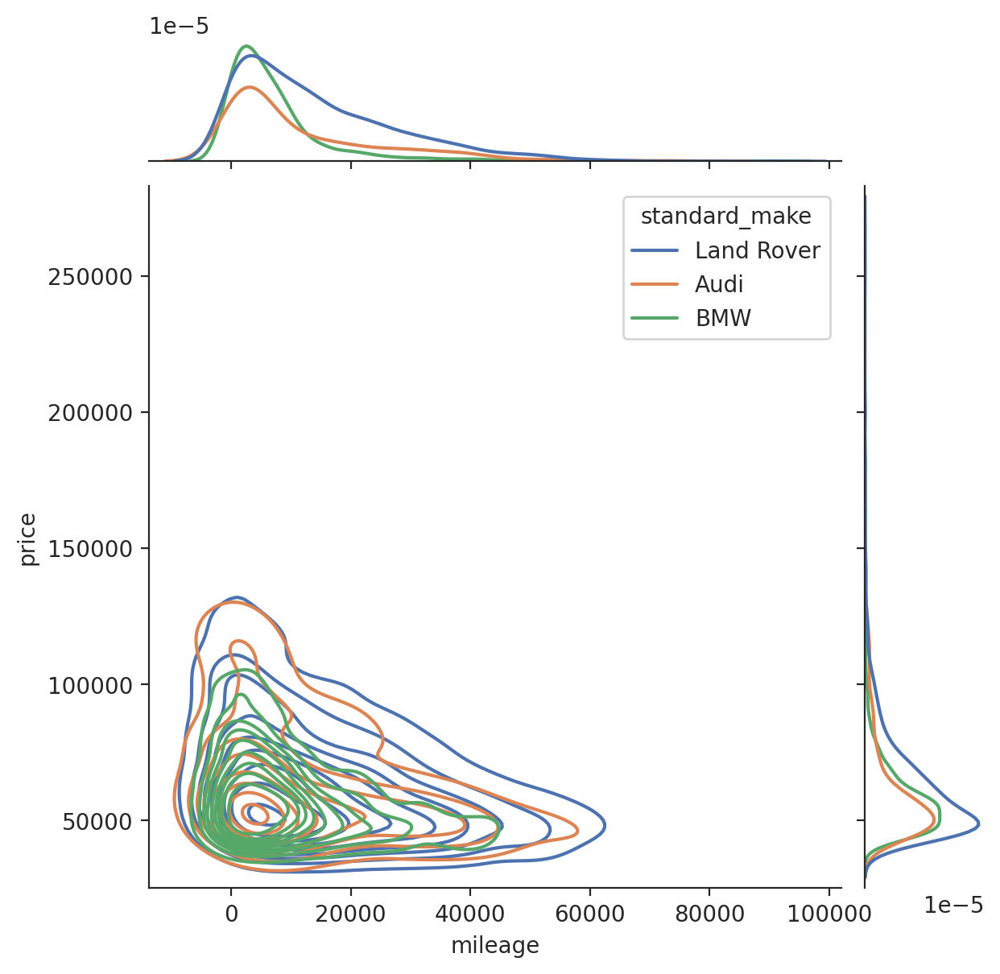

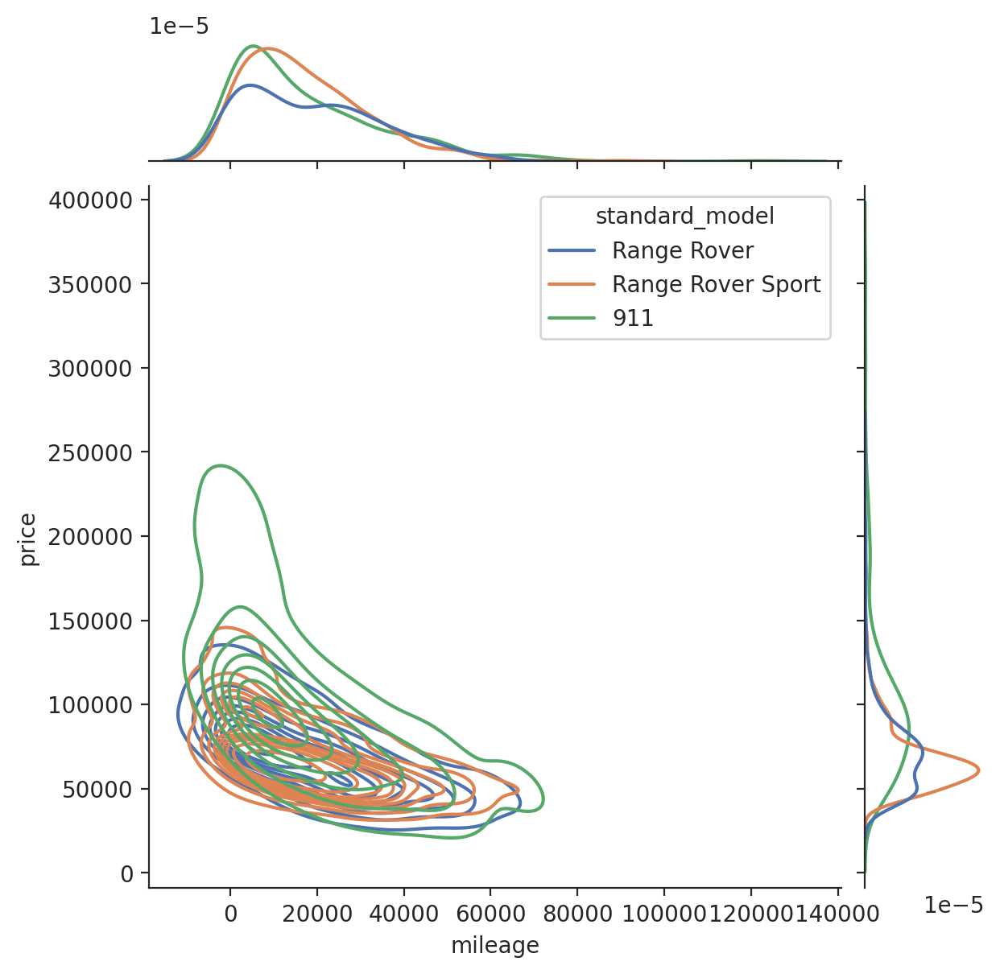

In [ ]:
#Some of the most relevant "non-metric variables" and "metric" to graph and inspect are the followings:

    #"non-metric variables"
        #standard_colour
        #standard_make
        #body_type
        #fuel_type
        #standard_model
        #vehicle_condition
        #crossover_car_and_van vs price

    #"metric variables"
        #price
        #year_of_registration
        #metric__mileage

#Important Note: For visualization purposes, the graphs only show subsets of the data that contain interesting values....
#...(Top 5 values for caegorical values) and specific ranges (where the bulf of the data is located) for...
#...the metric variables "price", "year_of_registration" and "mileage".

#Function for BoxPlot
def EDA_Graph_Extra2(data):

  #standard_colour vs price
    #Step 0: Choose a "non-metric" feature.
    #Step 1: Create a "serie" (for counting values) based on a specific "non-metric" feature.
    #Step 2: Get the Top 5 values of the "serie" created in the Step 1.
    #Step 3: Transform the  "serie" created in the Step 2 into a dataframe.
    #Step 4: Transpose the dataframe created in the Step 3.
    #Step 5: Get the name of the columns of the transposed dataframe of Step 4.
    #Step 6 - 7: Create a subset in the main dataset (training data) based on the name of the columns of Step 5.
    #Step 8: Plot the "BoxPlot" considering the "metric", "non-metric" and "dataframe created in Step 6-7"

      #standard_colour
  serie_101 = data['standard_colour'].value_counts()
  serie_102 = serie_101.head(5)
  df150 = pd.DataFrame(serie_102)
  transposed_df150 = df150.transpose()
  column_names_df150 = transposed_df150.columns.tolist()
  mask_df150 = data['standard_colour'].isin(column_names_df150)
  #Apply the mask to get the subset of the DataFrame
  df151 = data[mask_df150]
  df151a =  df151[(df151['price'] >= 0.0) & (df151['price'] <= 20000)]

  #BoxPlot
  sns.boxplot(x='standard_colour', y='price', data=df151a, palette="viridis", hue="standard_colour")
  plt.xlabel('standard_colour')
  plt.ylabel('price (£)')
  plt.title('Boxplot of the Top 5 most frequent elements of the variable: standard_colour')
  plt.show()

  ##########################################################################################################################
  #standard_make vs price
  serie_121 = data['standard_make'].value_counts()
  serie_122 = serie_121.head(5)
  df170 = pd.DataFrame(serie_122)
  transposed_df170 = df170.transpose()
  column_names_df170 = transposed_df170.columns.tolist()
  mask_df170 = data['standard_make'].isin(column_names_df170)
  #Apply the mask to get the subset of the DataFrame
  df171 = data[mask_df170]
  df171a =  df171[(df171['price'] >= 0.0) & (df171['price'] <= 20000)]

  #BoxPlot
  print("\n" +'\033[1m','\033[46m', "Boxplot [standard_make vs price]", '\033[0m' + "\n")
  sns.boxplot(x='standard_make', y='price', data=df171a)
  plt.show()

  ##########################################################################################################################
  #body_type vs price

  serie_117 = data['body_type'].value_counts()
  serie_118 = serie_117.head(5)
  df166 = pd.DataFrame(serie_118)
  transposed_df166 = df166.transpose()
  column_names_df166 = transposed_df166.columns.tolist()
  mask_df166 = data['body_type'].isin(column_names_df166)
  #Apply the mask to get the subset of the DataFrame
  df167 = data[mask_df166]
  df167a =  df167[(df167['price'] >= 0.0) & (df167['price'] <= 20000)]

  #BoxPlot
  print("\n" +'\033[1m','\033[46m', "Boxplot [body_type vs price]", '\033[0m' + "\n")
  sns.boxplot(x='body_type', y='price', data=df167a)
  plt.show()

  ##########################################################################################################################
  #fuel_type vs price

  serie_113 = data['fuel_type'].value_counts()
  serie_114 = serie_113.head(5)
  df162 = pd.DataFrame(serie_114)
  transposed_df162 = df162.transpose()
  column_names_df162 = transposed_df162.columns.tolist()
  mask_df162 = data['fuel_type'].isin(column_names_df162)
  #Apply the mask to get the subset of the DataFrame
  df163 = data[mask_df162]
  df163a =  df163[(df163['price'] >= 0.0) & (df163['price'] <= 20000)]

  #BoxPlot
  print("\n" +'\033[1m','\033[46m', "Boxplot [fuel_type vs price]", '\033[0m' + "\n")
  sns.boxplot(x='fuel_type', y='price', data=df163a)
  plt.show()

  ##########################################################################################################################
  #standard_model vs price

  serie_105 = data['standard_model'].value_counts()
  serie_106 = serie_105.head(5)
  df154 = pd.DataFrame(serie_106)
  transposed_df154 = df154.transpose()
  column_names_df154 = transposed_df154.columns.tolist()
  mask_df154= data['standard_model'].isin(column_names_df154)
  #Apply the mask to get the subset of the DataFrame
  df155 = data[mask_df154]
  df155a =  df155[(df155['price'] >= 0.0) & (df155['price'] <= 20000)]

  #BoxPlot
  print("\n" +'\033[1m','\033[46m', "Boxplot [standard_model vs price]", '\033[0m' + "\n")
  sns.boxplot(x='standard_model', y='price', data=df155a)
  plt.show()

   ##########################################################################################################################
   #vehicle_condition vs price

  df156a =  df155[(df155['price'] >= 0.0) & (df155['price'] <= 20000)]

  print("\n" +'\033[1m','\033[46m', "Boxplot [vehicle_condition vs price]", '\033[0m' + "\n")
  sns.boxplot(x='vehicle_condition', y='price', data=df156a)
  plt.show()

   ##########################################################################################################################
   #standard_model vs year_of_registration

  serie_105 = data['standard_model'].value_counts()
  serie_106 = serie_105.head(5)
  df154 = pd.DataFrame(serie_106)
  transposed_df154 = df154.transpose()
  column_names_df154 = transposed_df154.columns.tolist()
  mask_df154= data['standard_model'].isin(column_names_df154)
  #Apply the mask to get the subset of the DataFrame
  df155 = data[mask_df154]
  df155b =  df155[(df155['year_of_registration'] >= 2013) & (df155['year_of_registration'] <= 2018)]

  #BoxPlot
  print("\n" +'\033[1m','\033[46m', "Boxplot [standard_model vs year_of_registration]", '\033[0m' + "\n")
  sns.boxplot(x='standard_model', y='year_of_registration', data=df155b)
  plt.show()

   ##########################################################################################################################
   #standard_make vs year_of_registration

  serie_121 = data['standard_make'].value_counts()
  serie_122 = serie_121.head(5)
  df170 = pd.DataFrame(serie_122)
  transposed_df170 = df170.transpose()
  column_names_df170 = transposed_df170.columns.tolist()
  mask_df170 = data['standard_make'].isin(column_names_df170)
  #Apply the mask to get the subset of the DataFrame
  df171 = data[mask_df170]
  df171b =  df171[(df171['year_of_registration'] >= 2013) & (df171['year_of_registration'] <= 2018)]

  #BoxPlot
  print("\n" +'\033[1m','\033[46m', "Boxplot [standard_make vs year_of_registration]", '\033[0m' + "\n")
  sns.boxplot(x='standard_make', y='year_of_registration', data=df171b)
  plt.show()

   ##########################################################################################################################
   #standard_model vs mileage

  serie_105 = data['standard_model'].value_counts()
  serie_106 = serie_105.head(5)
  df154 = pd.DataFrame(serie_106)
  transposed_df154 = df154.transpose()
  column_names_df154 = transposed_df154.columns.tolist()
  mask_df154= data['standard_model'].isin(column_names_df154)
  #Apply the mask to get the subset of the DataFrame
  df155 = data[mask_df154]
  df155c =  df155[(df155['mileage'] >= 10000) & (df155['mileage'] <= 57000)]

  #BoxPlot
  print("\n" +'\033[1m','\033[46m', "Boxplot [standard_model vs mileage]", '\033[0m' + "\n")
  sns.boxplot(x='standard_model', y='mileage', data=df155c)
  plt.show()

   ##########################################################################################################################
   #standard_make vs mileage

  serie_121 = data['standard_make'].value_counts()
  serie_122 = serie_121.head(5)
  df170 = pd.DataFrame(serie_122)
  transposed_df170 = df170.transpose()
  column_names_df170 = transposed_df170.columns.tolist()
  mask_df170 = data['standard_make'].isin(column_names_df170)
  #Apply the mask to get the subset of the DataFrame
  df171 = data[mask_df170]
  df171c =  df171[(df171['mileage'] >= 10000) & (df171['mileage'] <= 57000)]

  #BoxPlot
  print("\n" +'\033[1m','\033[46m', "Boxplot [standard_make vs mileage]", '\033[0m' + "\n")
  sns.boxplot(x='standard_make', y='mileage', data=df171c)
  plt.show()

  ##########################################################################################################################
  #NEW: standard_colour vs standard_make
      #standard_colour
  serie_101 = data['standard_colour'].value_counts()
  serie_102 = serie_101.head(5)
  df150 = pd.DataFrame(serie_102)
  transposed_df150 = df150.transpose()
  column_names_df150 = transposed_df150.columns.tolist()
  mask_df150 = data['standard_colour'].isin(column_names_df150)
  #Apply the mask to get the subset of the DataFrame
  df151 = data[mask_df150]

      #standard_make
  serie_103 = data['standard_make'].value_counts()
  serie_104 = serie_103.head(5)
  df152 = pd.DataFrame(serie_104)
  transposed_df152 = df152.transpose()
  column_names_df152 = transposed_df152.columns.tolist()
  mask_df152 = df151['standard_make'].isin(column_names_df152)
  #Apply the mask to get the subset of the DataFrame
  df153 = df151[mask_df152]

  #https://seaborn.pydata.org/generated/seaborn.jointplot.html
  #https://seaborn.pydata.org/generated/seaborn.pairplot.html
  #http://seaborn.pydata.org/generated/seaborn.pointplot.html#seaborn.pointplot
  sns.pointplot(data=df153, x="standard_make", y="price", hue="standard_colour")
  plt.show()


  ############################################################################################################################

   #NEW: standard_model
  serie_105 = data['standard_model'].value_counts()
  serie_106 = serie_105.head(5)
  df154 = pd.DataFrame(serie_106)
  transposed_df154 = df154.transpose()
  column_names_df154 = transposed_df154.columns.tolist()
  mask_df154= data['standard_model'].isin(column_names_df154)
  #Apply the mask to get the subset of the DataFrame
  df155 = data[mask_df154]

      #standard_make
  serie_107 = data['standard_make'].value_counts()
  serie_108 = serie_107.head(5)
  df156 = pd.DataFrame(serie_108)
  transposed_df156 = df156.transpose()
  column_names_df156 = transposed_df156.columns.tolist()
  mask_df156 = df155['standard_make'].isin(column_names_df156)
  #Apply the mask to get the subset of the DataFrame
  df157 = df155[mask_df156]

  sns.pointplot(data=df157, x="standard_model", y="price", hue="standard_make")
  #sns.pointplot(data=df157, x="standard_make", y="price", hue="standard_model")

  plt.show()

  #############################################################################################################################

    #NEW: fuel_type
  serie_109 = data['fuel_type'].value_counts()
  serie_110 = serie_109.head(5)
  df158 = pd.DataFrame(serie_110)
  transposed_df158 = df158.transpose()
  column_names_df158 = transposed_df158.columns.tolist()
  mask_df158 = data['fuel_type'].isin(column_names_df158)
  #Apply the mask to get the subset of the DataFrame
  df159 = data[mask_df158]

      #standard_make
  serie_111 = data['standard_make'].value_counts()
  serie_112 = serie_111.head(5)
  df160 = pd.DataFrame(serie_112)
  transposed_df160 = df160.transpose()
  column_names_df160 = transposed_df160.columns.tolist()
  mask_df160 = df159['standard_make'].isin(column_names_df160)
  #Apply the mask to get the subset of the DataFrame
  df161 = df159[mask_df160]

  sns.pointplot(data=df161, x="standard_make", y="price", hue="fuel_type")
  plt.show()

  #############################################################################################################################

  #NEW: body_type
  serie_117 = data['body_type'].value_counts()
  serie_118 = serie_117.head(5)
  df166 = pd.DataFrame(serie_118)
  transposed_df166 = df166.transpose()
  column_names_df166 = transposed_df166.columns.tolist()
  mask_df166 = data['body_type'].isin(column_names_df166)
  #Apply the mask to get the subset of the DataFrame
  df167 = data[mask_df166]

     #standard_make
  serie_119 = data['standard_make'].value_counts()
  serie_120 = serie_119.head(5)
  df168 = pd.DataFrame(serie_120)
  transposed_df168 = df168.transpose()
  column_names_df168 = transposed_df168.columns.tolist()
  mask_df168 = df167['standard_make'].isin(column_names_df168)
  #Apply the mask to get the subset of the DataFrame
  df169 = df167[mask_df168]

  sns.pointplot(data=df169, x="standard_make", y="price", hue="body_type")
  plt.show()
  ###############################################################################################################################

     #NEW: fuel_type
  serie_113 = data['fuel_type'].value_counts()
  serie_114 = serie_113.head(5)
  df162 = pd.DataFrame(serie_114)
  transposed_df162 = df162.transpose()
  column_names_df162 = transposed_df162.columns.tolist()
  mask_df162 = data['fuel_type'].isin(column_names_df162)
  #Apply the mask to get the subset of the DataFrame
  df163 = data[mask_df162]

      #standard_model
  serie_115 = data['standard_model'].value_counts()
  serie_116 = serie_115.head(5)
  df164 = pd.DataFrame(serie_116)
  transposed_df164 = df164.transpose()
  column_names_df164 = transposed_df164.columns.tolist()
  mask_df164 = df163['standard_model'].isin(column_names_df164)
  #Apply the mask to get the subset of the DataFrame
  df165 = df163[mask_df164]

  sns.pointplot(data=df165, x="fuel_type", y="price", hue="standard_model")
  #sns.pointplot(data=df165, x="standard_model", y="price", hue="fuel_type")
  plt.show()

  #############################################################################################################################

  #NEW: price (between the 0 Percentile and 75 Percentile)
  df891 = data[(data['price'] >= data['price'].quantile(0.25)) & (data['price'] <= data['price'].quantile(0.75))]

  serie_10591 = df891['standard_model'].value_counts()
  serie_10691 = serie_10591.head(2)
  df15491 = pd.DataFrame(serie_10691)
  transposed_df15491 = df15491.transpose()
  column_names_df15491 = transposed_df15491.columns.tolist()
  mask_df15491= df891['standard_model'].isin(column_names_df15491)
  #Apply the mask to get the subset of the DataFrame
  df15591 = df891[mask_df15491]

  df1191 = df15591.query("2010<year_of_registration<=2020")
  df119101 = df1191.query("0<mileage<=125000")

  sns.jointplot(data=df119101, x="mileage", y="price", hue="standard_model",kind="kde")
  plt.show()

  #############################################################################################################################

  #NEW: price (between the 25 Percentile and 75 Percentile)
  df892 = data[(data['price'] >= data['price'].quantile(0.25)) & (data['price'] <= data['price'].quantile(0.75))]

  serie_10592 = df892['standard_make'].value_counts()
  serie_10692 = serie_10592.head(2)
  df15492 = pd.DataFrame(serie_10692)
  transposed_df15492 = df15492.transpose()
  column_names_df15492 = transposed_df15492.columns.tolist()
  mask_df15492= df892['standard_make'].isin(column_names_df15492)
  #Apply the mask to get the subset of the DataFrame
  df15592 = df892[mask_df15492]

  df1192 = df15592.query("2010<year_of_registration<=2020")
  df119201 = df1192.query("0<mileage<=125000")

  sns.jointplot(data=df119201, x="mileage", y="price", hue="standard_make",kind="kde")
  plt.show()

  #############################################################################################################################

  #NEW: price (between the 25 Percentile and 75 Percentile)
  df893 = data[(data['price'] >= data['price'].quantile(0.25)) & (data['price'] <= data['price'].quantile(0.75))]

  serie_10593 = df893['body_type'].value_counts()
  serie_10693 = serie_10593.head(2)
  df15493 = pd.DataFrame(serie_10693)
  transposed_df15493 = df15493.transpose()
  column_names_df15493 = transposed_df15493.columns.tolist()
  mask_df15493= df893['body_type'].isin(column_names_df15493)
  #Apply the mask to get the subset of the DataFrame
  df15593 = df893[mask_df15493]

  df1193 = df15593.query("2010<year_of_registration<=2020")
  df119301 = df1193.query("0<mileage<=125000")

  sns.jointplot(data=df119301, x="mileage", y="price", hue="body_type",kind="kde")
  plt.show()


  #############################################################################################################################

  #NEW: price (between the 0.95 Percentile and 1 Percentile)
  df894 = data[(data['price'] >= data['price'].quantile(0.95)) & (data['price'] <= data['price'].quantile(1))]

  serie_10594 = df894['standard_make'].value_counts()
  serie_10694 = serie_10594.head(3)
  df15494 = pd.DataFrame(serie_10694)
  transposed_df15494 = df15494.transpose()
  column_names_df15494 = transposed_df15494.columns.tolist()
  mask_df15494= df894['standard_make'].isin(column_names_df15494)
  #Apply the mask to get the subset of the DataFrame
  df15594 = df894[mask_df15494]

  df1194 = df15594.query("2010<year_of_registration<=2020")
  df119401 = df1194.query("0<mileage<=125000")

  sns.jointplot(data=df119401, x="mileage", y="price", hue="standard_make",kind="kde")
  plt.show()


  #############################################################################################################################

  #NEW: price (between the 0.95 Percentile and 1 Percentile)
  df895 = data[(data['price'] >= data['price'].quantile(0.95)) & (data['price'] <= data['price'].quantile(1))]

  serie_10595 = df895['standard_model'].value_counts()
  serie_10695 = serie_10595.head(3)
  df15495 = pd.DataFrame(serie_10695)
  transposed_df15495 = df15495.transpose()
  column_names_df15495 = transposed_df15495.columns.tolist()
  mask_df15495= df895['standard_model'].isin(column_names_df15495)
  #Apply the mask to get the subset of the DataFrame
  df15595 = df895[mask_df15495]

  df1195 = df15595.query("2010<year_of_registration<=2020")
  df119501 = df1195.query("0<mileage<=125000")

  sns.jointplot(data=df119501, x="mileage", y="price", hue="standard_model",kind="kde")
  plt.show()


  #############################################################################################################################


EDA_Graph_Extra2(data)

In [ ]:
#Python implementation of the Predictive Power Score (PPS)
  #Max sample=5000
  #seed for reproducibility
  #https://pypi.org/project/ppscore/

  #Only applied in metric variables because I got error using the non-metric variables (the module/library) does not recognize non-metric variables.
random_data_training = data.sample(n=5000, random_state=123)
random_data_training = random_data_training[["year_of_registration","public_reference","mileage","price"]]
pps.predictors(random_data_training, "price")

,x,y,ppscore,case,is_valid_score,metric,baseline_score,model_score,model
0,year_of_registration,price,0.135994,regression,True,mean absolute error,8754.375925,7563.834019,DecisionTreeRegressor()
1,public_reference,price,0.000000,regression,True,mean absolute error,9737.902200,10887.808741,DecisionTreeRegressor()
2,mileage,price,0.000000,regression,True,mean absolute error,9740.158263,11055.232007,DecisionTreeRegressor()


# **4. DATA PROCESSING**

* Metric and non-metric variables
  * Unique values
  * Fixing datatypes
  * Fixing errors
* Deriving new features (based on domain knowledge)

## **4.1. NON-METRIC VARIABLES (UNIQUE VALUES)**




In [ ]:
#Some of the most relevant "non-metric variables" in which the "unique" values are going to be checked are the following:
    #reg_code
    #standard_colour
    #standard_make
    #standard_model
    #vehicle_condition
    #body_type
    #fuel_type

def EDA_2(data):

    #reg_code
    print("\n" +'\033[1m','\033[46m', "Unique values - reg_code", '\033[0m' + "\n")
    df12 = unique_values = data["reg_code"].unique()
    print(df12)

    #standard_colour
    print("\n" +'\033[1m','\033[46m', "Unique values - standard_colour:", '\033[0m' + "\n")
    df13 = unique_values = data["standard_colour"].unique()
    print(df13)

    #standard_make
    print("\n" +'\033[1m','\033[46m', "Unique values - standard_make:", '\033[0m' + "\n")
    df14 = unique_values = data["standard_make"].unique()
    print(df14)

    #standard_model
    print("\n" +'\033[1m','\033[46m', "Unique values - standard_model:", '\033[0m' + "\n")
    df15 = unique_values = data["standard_model"].unique()
    print(df15)

    #vehicle_condition
    print("\n" +'\033[1m','\033[46m', "Unique values - vehicle_condition:", '\033[0m' + "\n")
    df16 = unique_values = data["vehicle_condition"].unique()
    print(df16)

    #body_type
    print("\n" +'\033[1m','\033[46m', "Unique values - body_type:", '\033[0m' + "\n")
    df17 = unique_values = data["body_type"].unique()
    print(df17)

    #fuel_type
    print("\n" +'\033[1m','\033[46m', "Unique values - fuel_type:", '\033[0m' + "\n")
    df18 = unique_values = data["fuel_type"].unique()
    print(df18)

# Call the function
EDA_2(data)


  Unique values - reg_code 

['17' '16' '64' '08' '60' nan '18' '65' '12' '19' '61' '69' '10' '14' '66'
 '67' '63' '09' '68' '56' '20' '15' '03' '62' '13' '70' '11' '58' '59' 'W'
 '02' '06' '52' '04' 'J' '07' '05' '55' '57' '53' 'X' '51' '54' 'D' 'M'
 'H' 'T' 'K' 'Y' 'S' 'P' 'G' 'L' 'V' 'E' 'R' 'N' 'C' '94' 'B' 'A' 'F' '85'
 'FW' '723xuu' '95' 's' '38' '37']

  Unique values - standard_colour: 

['Grey' 'Brown' 'Blue' 'Red' 'Black' nan 'White' 'Silver' 'Purple' 'Green'
 'Yellow' 'Turquoise' 'Gold' 'Orange' 'Multicolour' 'Bronze' 'Beige'
 'Pink' 'Maroon' 'Burgundy' 'Navy' 'Magenta' 'Indigo']

  Unique values - standard_make: 

['SKODA' 'Vauxhall' 'Land Rover' 'Audi' 'Mercedes-Benz' 'Volkswagen'
 'Nissan' 'Citroen' 'Toyota' 'Volvo' 'Renault' 'BMW' 'Honda' 'Fiat'
 'DS AUTOMOBILES' 'Kia' 'Hyundai' 'MINI' 'Peugeot' 'SEAT' 'Smart'
 'Alfa Romeo' 'Abarth' 'Porsche' 'Jaguar' 'Mazda' 'Mitsubishi' 'Suzuki'
 'MG' 'Dacia' 'Subaru' 'SsangYong' 'Maserati' 'Saab' 'Lexus' 'Ferrari'
 'Bentley' 'Jeep' '

## **4.2. METRIC VARIABLES (UNIQUE VALUES)**


In [ ]:
#Some of the most relevant "metric variables" in which the "unique" values are going to be checked are the following:
    #mileage
    #year_of_registration
    #price

def EDA_3(data):

    #mileage
    print("\n" +'\033[1m','\033[46m', "Unique values - mileage:", '\033[0m' + "\n")
    df19 = unique_values = data["mileage"].unique()
    print(df19)

    #year_of_registration
    print("\n" +'\033[1m','\033[46m', "Unique values - year_of_registration:", '\033[0m' + "\n")
    df20 = unique_values = data["year_of_registration"].unique()
    df20.sort()
    print(df20)

    #price
    print("\n" +'\033[1m','\033[46m', "Unique values - price:", '\033[0m' + "\n")
    df21 = unique_values = data["price"].unique()
    print(df21)

# Call the function
EDA_3(data)


  Unique values - mileage: 

[  7800.  45000.  64000. ... 102289.  42377.   8437.]

  Unique values - year_of_registration: 

[ 999. 1007. 1008. 1009. 1018. 1063. 1515. 1934. 1950. 1952. 1954. 1955.
 1956. 1957. 1958. 1959. 1960. 1961. 1962. 1963. 1964. 1965. 1966. 1967.
 1968. 1969. 1970. 1971. 1972. 1973. 1974. 1975. 1976. 1977. 1978. 1979.
 1980. 1981. 1982. 1983. 1984. 1985. 1986. 1987. 1988. 1989. 1990. 1991.
 1992. 1993. 1994. 1995. 1996. 1997. 1998. 1999. 2000. 2001. 2002. 2003.
 2004. 2005. 2006. 2007. 2008. 2009. 2010. 2011. 2012. 2013. 2014. 2015.
 2016. 2017. 2018. 2019. 2020.   nan]

  Unique values - price: 

[14000  7995 26995 ... 47910 35023 58987]


## **4.3. NON-METRIC VARIABLES (FIXING DATATYPE)**

* Transforming the variable "crossover_car_and_van" from "boolean" to "strings"

In [ ]:
#The output of the Section "1.1. Metric and Non-metric Variables (General Information)" shows that the
#variable "crossover_car_and_van" is boolean.

#For convenience and simplicity of the following steps the column of the variable "crossover_car_and_van", which is is boolean,
#will be transformed into "strings".

#This transformation will be useful for looking correlations in further stages between Non-metric ("crossover_car_and_van")
#and a Metric Variable such as "price".

#To transform the "boolean" values (True & False) into "strings", the followings steps are going to be developed:
    #Step 1: copy of original dataframe
data_c1 = data.copy()

    #Step 2: Convert boolean to string
data_c1['crossover_car_and_van'] = data_c1['crossover_car_and_van'].astype(str)

    #Step 3: Printing the information of the dataframe to be sure that the datatype of the column 'crossover_car_and_van'
    #is "object" instead of "bool"
print("\n", '\033[1m','\033[46m',"General information of the dataset (boolean transformed to string):",'\033[0m', "\n")
data_c1.info()


   General information of the dataset (boolean transformed to string):  

<class 'pandas.core.frame.DataFrame'>
Int64Index: 241204 entries, 2 to 402003
Data columns (total 12 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   public_reference       241204 non-null  int64  
 1   mileage                241132 non-null  float64
 2   reg_code               222161 non-null  object 
 3   standard_colour        237947 non-null  object 
 4   standard_make          241204 non-null  object 
 5   standard_model         241204 non-null  object 
 6   vehicle_condition      241204 non-null  object 
 7   year_of_registration   221271 non-null  float64
 8   price                  241204 non-null  int64  
 9   body_type              240702 non-null  object 
 10  crossover_car_and_van  241204 non-null  object 
 11  fuel_type              240839 non-null  object 
dtypes: float64(2), int64(2), object(8)
memory usage: 23.9+ MB


## **4.4. METRIC VARIABLES (FIXING ERRORS / UNIQUE VALUES)**

* Updating some rows of the variable "year_of_registration"


In [ ]:
#The output of the Section "2.2. Metric Variables (unique values)" shows that the variable "year_of_registration" has
#the following errors: 999, 1006, 1007, 1008, 1009, 1010, 1015, 1016, 1017, 1018, 1063, 1515.
#In other words, the column "year_of_registration" has values that do not make sense in the context of the whole dataset.

#To fix the "Errors / Noisy Data", the followings steps based on convenience and simplicity are going to be developed:
    #Step 1: copy of original dataframe
        #It is used the same copy made in the previous section "2.3. Non-metric Variables (Fixing "Data Types")"
data_c1

    #Step 2: All the rows of the column "year_of_registration" less than 1900 will be increased by 1000
        #1900 is the chosen value based on the fact that some of the oldest vehicle models in the dataset belong to this decade.
data_c1.loc[data_c1['year_of_registration'] < 1900, 'year_of_registration'] = data_c1.loc[data['year_of_registration'] < 1900, 'year_of_registration'] + 1000

    #Step 3: If there is any row of the column "year_of_registration" that is greater than 2020 (after the "increased by 1000"),...
    #...then that cell will transformed to 2020.
        #2020 is the chosen value based on the fact that it is the maximum value in the dataset for the column "year_of_registration".
data_c1.loc[data_c1['year_of_registration'] > 2020, 'year_of_registration'] = 2020

    #Step 4: Printing unique values of the column "year_of_registration" to be sure that there is no more "errors / noisy data"
#year_of_registration
print("\n" +'\033[1m','\033[46m', "Unique values (Errors / noisy data fixed) - year_of_registration:", '\033[0m' + "\n")
df22 = unique_values = data_c1["year_of_registration"].unique()
df22.sort()
print(df22)


  Unique values (Errors / noisy data fixed) - year_of_registration: 

[1934. 1950. 1952. 1954. 1955. 1956. 1957. 1958. 1959. 1960. 1961. 1962.
 1963. 1964. 1965. 1966. 1967. 1968. 1969. 1970. 1971. 1972. 1973. 1974.
 1975. 1976. 1977. 1978. 1979. 1980. 1981. 1982. 1983. 1984. 1985. 1986.
 1987. 1988. 1989. 1990. 1991. 1992. 1993. 1994. 1995. 1996. 1997. 1998.
 1999. 2000. 2001. 2002. 2003. 2004. 2005. 2006. 2007. 2008. 2009. 2010.
 2011. 2012. 2013. 2014. 2015. 2016. 2017. 2018. 2019. 2020.   nan]


## **4.5. METRIC AND NON-METRIC VARIABLES (FIXING ERRORS)**

* Transforming some rows of the variable "vehicle_condition" based on the variable "mileage"


In [ ]:
#Dealing with Noise

  #mileage vs vehicle_condition

  #After checking the training set, the following issues that do not make sense will be fixed:
    #Vehicles that have "mileage > 0" but are decribed as "vehicle_condition = NEW"
    #Vehicles that have "mileage = 0" but are decribed as "vehicle_condition = USED"

  #Filtering the training dataset using "mileage = 0"
data_c2 = data_c1.copy()
car_mileage_0 = data_c2[data_c2['mileage'] == 0]
print(car_mileage_0.shape)

  #Vehicles that have "mileage = 0" but are decribed as "vehicle_condition = USED"
car_mileage_0_used = car_mileage_0.query('vehicle_condition == "USED"')
print(car_mileage_0_used.shape)

  #Filtering the training dataset using "mileage > 0"
car_mileage_x = data_c2[data_c2['mileage'] > 0]
print(car_mileage_x.shape)

  #Vehicles that have "mileage > 0" but are decribed as "vehicle_condition = NEW"
car_mileage_x_new = car_mileage_x.query('vehicle_condition == "NEW"')
print(car_mileage_x_new.shape)

(9687, 12)
(215, 12)
(231445, 12)
(9222, 12)


In [ ]:
data_c2.loc[(data_c2["mileage"]==0) & (data_c2["vehicle_condition"]=='USED'),"vehicle_condition"] = "NEW"

  #Filtering the training dataset using "mileage = 0"
car_mileage_0 = data_c2[data_c2['mileage'] == 0]
print(car_mileage_0.shape)

  #Vehicles that have "mileage = 0" but are decribed as "vehicle_condition = USED"
car_mileage_0_used = car_mileage_0.query('vehicle_condition == "USED"')
print(car_mileage_0_used.shape)

data_c2.loc[(data_c2["mileage"]>0) & (data_c2["vehicle_condition"]=='NEW'),"vehicle_condition"] = "USED"

  #Filtering the training dataset using "mileage > 0"
car_mileage_x = data_c2[data_c2['mileage'] > 0]
print(car_mileage_x.shape)

  #Vehicles that have "mileage > 0" but are decribed as "vehicle_condition = NEW"
car_mileage_x_new = car_mileage_x.query('vehicle_condition == "NEW"')
print(car_mileage_x_new.shape)

(9687, 12)
(0, 12)
(231445, 12)
(0, 12)


## **4.6. DERIVING FEATURES**

* New Features:
  * number of seats (*based on the variables "body_type" & domain knowledge*)
  * number of doors (*based on the variables "body_type" & domain knowledge*)
  * mileage/year_registration

In [ ]:
#Copying the dataframe
data_c3 = data_c2.copy()

#Information of the dataframe (before adding the new features)
data_c3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 241204 entries, 2 to 402003
Data columns (total 12 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   public_reference       241204 non-null  int64  
 1   mileage                241132 non-null  float64
 2   reg_code               222161 non-null  object 
 3   standard_colour        237947 non-null  object 
 4   standard_make          241204 non-null  object 
 5   standard_model         241204 non-null  object 
 6   vehicle_condition      241204 non-null  object 
 7   year_of_registration   221271 non-null  float64
 8   price                  241204 non-null  int64  
 9   body_type              240702 non-null  object 
 10  crossover_car_and_van  241204 non-null  object 
 11  fuel_type              240839 non-null  object 
dtypes: float64(2), int64(2), object(8)
memory usage: 23.9+ MB


In [ ]:
# Getting the list of the unique values of the variables "body_type"
data_c3_uni_body_type = data_c3[['body_type']].drop_duplicates()
print(data_c3_uni_body_type)
print(data_c3_uni_body_type.shape)

              body_type
2                   SUV
3             Hatchback
5           Convertible
8             Limousine
10               Saloon
24                Coupe
26                  MPV
52               Estate
625                 NaN
1338             Pickup
2094          Panel Van
2850            Minibus
3962          Combi Van
11317        Window Van
16619            Camper
24209   Car Derived Van
204241      Chassis Cab
(17, 1)


In [ ]:
#Based on the variables "body_type" & domain knowledge, the dataframe is the following:

car_knowledge = [['SUV', 5, 5],
        ['Hatchback', 5, 5],
        ['Convertible', 2, 4],
        ['Limousine', 6, 10],
        ['Saloon', 4, 5],
        ['Coupe', 2, 4],
        ['MPV', 5, 6],
        ['Estate', 5, 5],
        ['Pickup', 4, 5],
        ['Panel Van', 5, 5],
        ['Minibus', 5, 8],
        ['Combi Van', 5, 5],
        ['Window Van', 4, 12],
        ['Camper', 4, 5],
        ['Car Derived Van', 4, 2],
        [None, 4, 5], #this special item is for the instances that ar NaN in the variable "body_type"
        ['Chassis Cab', 2, 2]]

# Create the pandas DataFrame
car_knowledge_df = pd.DataFrame(car_knowledge, columns=['body_type', 'doors', "seats"])
car_knowledge_df
print(car_knowledge_df)
print(car_knowledge_df.shape)

          body_type  doors  seats
0               SUV      5      5
1         Hatchback      5      5
2       Convertible      2      4
3         Limousine      6     10
4            Saloon      4      5
5             Coupe      2      4
6               MPV      5      6
7            Estate      5      5
8            Pickup      4      5
9         Panel Van      5      5
10          Minibus      5      8
11        Combi Van      5      5
12       Window Van      4     12
13           Camper      4      5
14  Car Derived Van      4      2
15             None      4      5
16      Chassis Cab      2      2
(17, 3)


In [ ]:
#Merging the "training set" & "domain knowledge dataframe"
data_c4 = pd.merge(data_c3, car_knowledge_df, on="body_type")
print(data_c4.shape)
data_c4.sample(1)

(241204, 14)


,public_reference,mileage,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,price,body_type,crossover_car_and_van,fuel_type,doors,seats
192526,202010104837957,10.0,NaN,Black,BMW,3 Series,USED,NaN,38000,Saloon,False,Petrol Plug-in Hybrid,4,5


In [ ]:
data_c4["mileage_year"] = data_c4["mileage"] / data_c4["year_of_registration"]
print(data_c4.shape)
data_c4.head(1)

(241204, 15)


,public_reference,mileage,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,price,body_type,crossover_car_and_van,fuel_type,doors,seats,mileage_year
0,202007020778474,7800.0,17,Grey,SKODA,Yeti,USED,2017.0,14000,SUV,False,Petrol,5,5,3.867129


In [ ]:
#Information of the dataframe (after adding the new features)
data_c4.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 241204 entries, 0 to 241203
Data columns (total 15 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   public_reference       241204 non-null  int64  
 1   mileage                241132 non-null  float64
 2   reg_code               222161 non-null  object 
 3   standard_colour        237947 non-null  object 
 4   standard_make          241204 non-null  object 
 5   standard_model         241204 non-null  object 
 6   vehicle_condition      241204 non-null  object 
 7   year_of_registration   221271 non-null  float64
 8   price                  241204 non-null  int64  
 9   body_type              240702 non-null  object 
 10  crossover_car_and_van  241204 non-null  object 
 11  fuel_type              240839 non-null  object 
 12  doors                  241204 non-null  int64  
 13  seats                  241204 non-null  int64  
 14  mileage_year           221210 non-nu

# **5. FEATURE ENGINEERING**

*  Produce polynomial and interaction features.

In [ ]:
#Data
data_c5 = data_c4.copy()
data_c5.info()

#Training Set
  # X
x_training_bpf = data_c5.drop(['price'], axis=1)

  # Y
y_training_bpf = data_c5['price']

<class 'pandas.core.frame.DataFrame'>
Int64Index: 241204 entries, 0 to 241203
Data columns (total 15 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   public_reference       241204 non-null  int64  
 1   mileage                241132 non-null  float64
 2   reg_code               222161 non-null  object 
 3   standard_colour        237947 non-null  object 
 4   standard_make          241204 non-null  object 
 5   standard_model         241204 non-null  object 
 6   vehicle_condition      241204 non-null  object 
 7   year_of_registration   221271 non-null  float64
 8   price                  241204 non-null  int64  
 9   body_type              240702 non-null  object 
 10  crossover_car_and_van  241204 non-null  object 
 11  fuel_type              240839 non-null  object 
 12  doors                  241204 non-null  int64  
 13  seats                  241204 non-null  int64  
 14  mileage_year           221210 non-nu

In [ ]:
#Function that define the "pipeline" for feature transformation
def transformer_pipeline(X, lin_model=False, poly_lin_model= False):

    #metric features transformations (valid for: Linear Model, Random Forest, Boosted Tree)
    metric_features = X.select_dtypes(exclude='object').columns.tolist()
    metric_transformer = Pipeline(
        steps=[
            ("imputer", SimpleImputer(strategy="median")),
        ]
    )

    #non-metric features transformations (valid for: Linear Model, Random Forest, Boosted Tree)
    non_metric_features = X.select_dtypes(include='object').columns.tolist()
    non_metric_transformer = Pipeline(
        steps=[
            ("imputer", SimpleImputer(strategy="most_frequent")),
            ("encoder", TargetEncoder())
        ]
    )

    #Preprocessor (valid for: Linear Model, Random Forest, Boosted Tree)
    transformer_features = ColumnTransformer(
        transformers=[
            ("metric", metric_transformer, metric_features),
            ("non_metric", non_metric_transformer, non_metric_features),
        ],
        remainder='passthrough',
        verbose_feature_names_out=False
    )

    #Preprocessor (valid for: Linear model. More transformations: scaling)
    if lin_model:
        metric_transformer.steps.extend([
            ("scaler", MinMaxScaler()),
        ])
        non_metric_transformer.steps.extend([
            ("scaler", MinMaxScaler())
        ])

    #Preprocessor (valid for: Polynomial Linear model. More transformations: scaling + polynomial features)
    if poly_lin_model:
        metric_transformer.steps.extend([
            ("scaler", MinMaxScaler()),
            ('poly', PolynomialFeatures(2, include_bias=False))
        ])
        non_metric_transformer.steps.extend([
            ("scaler", MinMaxScaler()),
            ('poly', PolynomialFeatures(2, include_bias=False))
        ])

    #Output: Pipeline ({transformation/preprocessing of the data})
    return transformer_features

In [ ]:
#Function that define the "pipeline" for models (of course this pipeline has inside the pipeline of feature transformation)
def regression_pipeline(estimator_model, X, lin_model=False, poly_lin_model= False):

    reg_pipeline = Pipeline(
        steps=[
            ("transformations", transformer_pipeline(X, lin_model, poly_lin_model)),
            ("regressor", estimator_model)
        ]
    )

    #Output: Pipeline ({transformation/preprocessing of the data} + {model})
    return reg_pipeline

In [ ]:
#Phase 1

#Pipeline exclusive for the model: Linear Regression (without polynomial)
lr = regression_pipeline(LinearRegression(), x_training_bpf, lin_model=True, poly_lin_model= False)

#Fitting the data to the pipeline exclusive for the model: Linear Regression (without polynomial)
lr.fit(x_training_bpf, y_training_bpf)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['public_reference',
                                                   'mileage',
                                                   'year_of_registration',
                                                   'doors', 'seats',
                                                   'mileage_year']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['reg_code',
                                                   'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type',
                                                   'crossover_car_and_van',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('regressor', LinearRegression())])

In [ ]:
#Getting the prediction: Linear Regression (without polynomial)
y_pred_lr = lr.predict(x_training_bpf)
print(y_pred_lr)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(lr.score(x_training_bpf, y_training_bpf))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_lr = mean_absolute_error(y_training_bpf, y_pred_lr)
print(mae_lr)

#Coefficients (also called "weights")
  #Coefficients values
coefficients_lr = lr.named_steps['regressor'].coef_
print("Coefficients:", coefficients_lr)
  #Coefficients Shape
print("Coefficients:", coefficients_lr.shape)

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_lr = lr['transformations'].get_feature_names_out()
print("Features:", features_lr)
  #Features Shape
print("Features:", features_lr.shape)

[-2767.0958853  61122.65753463 18540.66331071 ... -4581.2640642
 22784.97820634 26184.29066899]
0.4131471798507338
10569.889774332856
Coefficients: [-1.06450609e+04 -1.44466217e+05 -1.21347981e+04 -2.52642804e+04
  4.27397723e+03  8.00503692e+04  2.31822032e+04 -4.53841129e+03
 -2.02145524e+05  3.60519928e+06 -7.90965075e+02 -6.25995657e+04
 -1.52698525e+04 -1.11341366e+04]
Coefficients: (14,)
Features: ['public_reference' 'mileage' 'year_of_registration' 'doors' 'seats'
 'mileage_year' 'reg_code' 'standard_colour' 'standard_make'
 'standard_model' 'vehicle_condition' 'body_type' 'crossover_car_and_van'
 'fuel_type']
Features: (14,)


In [ ]:
#Dataframe of "Feature and Coefficients"
pd.DataFrame(
    dict(
        features_lr = lr['transformations'].get_feature_names_out(),
        coefficients_lr = lr.named_steps['regressor'].coef_
    ),
)

,features_lr,coefficients_lr
0,public_reference,-1.064506e+04
1,mileage,-1.444662e+05
2,year_of_registration,-1.213480e+04
3,doors,-2.526428e+04
4,seats,4.273977e+03
5,mileage_year,8.005037e+04
6,reg_code,2.318220e+04
7,standard_colour,-4.538411e+03
8,standard_make,-2.021455e+05
9,standard_model,3.605199e+06


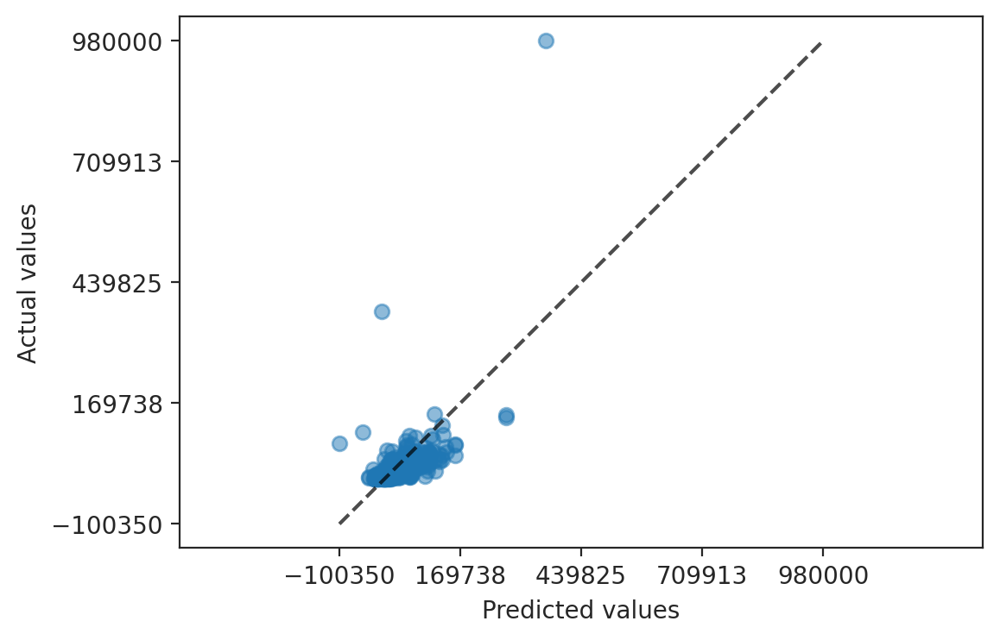

In [ ]:
PredictionErrorDisplay.from_estimator(
    lr, x_training_bpf, y_training_bpf, kind="actual_vs_predicted", scatter_kwargs=dict(alpha=0.5), subsample = 1000,random_state = 457
);

In [ ]:
#Dataframe after the transformation of the data.
lr['transformations'].transform(x_training_bpf).head()

,public_reference,mileage,year_of_registration,doors,seats,mileage_year,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,body_type,crossover_car_and_van,fuel_type
0,0.994270,0.007800,0.965116,0.75,0.3,0.007785,0.245302,0.636059,0.037568,0.007230,0.0,0.252565,0.0,0.079607
1,0.994471,0.064000,0.941860,0.75,0.3,0.063937,0.083941,0.636059,0.116493,0.031304,0.0,0.252565,0.0,0.067300
2,0.856945,0.000005,0.953488,0.75,0.3,0.031776,0.245302,0.586227,0.029164,0.011278,0.0,0.252565,0.0,0.067300
3,0.998553,0.047299,0.953488,0.75,0.3,0.047229,0.108840,0.586227,0.029164,0.008799,0.0,0.252565,0.0,0.067300
4,0.993139,0.011961,0.988372,0.75,0.3,0.011925,0.229512,0.348772,0.077974,0.020939,0.0,0.252565,0.0,1.000000


In [ ]:
#Model: Linear Regression (with polynomial)
lr_poly = regression_pipeline(LinearRegression(), x_training_bpf, lin_model=False, poly_lin_model=True)

lr_poly.fit(x_training_bpf, y_training_bpf)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   MinMaxScaler()),
                                                                  ('poly',
                                                                   PolynomialFeatures(include_bias=False))]),
                                                  ['public_reference',
                                                   'mileage',
                                                   'year_of_registration',
                                                   'doors', 'seats',
                                                   'mileage_year']),
                                                 ('non_metric',
                                                  Pipeline(ste...r',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder()),
                                                                  ('scaler',
                                                                   MinMaxScaler()),
                                                                  ('poly',
                                                                   PolynomialFeatures(include_bias=False))]),
                                                  ['reg_code',
                                                   'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type',
                                                   'crossover_car_and_van',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('regressor', LinearRegression())])

In [ ]:
#Getting the prediction: Linear Regression (with polynomial)
y_pred_lr_poly = lr_poly.predict(x_training_bpf)
print(y_pred_lr_poly)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(lr_poly.score(x_training_bpf, y_training_bpf))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_lr_poly = mean_absolute_error(y_training_bpf, y_pred_lr_poly)
print(mae_lr_poly)

#Coefficients (also called "weights")
  #Coefficients values
coefficients_lr_poly = lr_poly.named_steps['regressor'].coef_
print("Coefficients:", coefficients_lr_poly)
  #Coefficients Shape
print("Coefficients:", coefficients_lr_poly.shape)

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_lr_poly = lr_poly['transformations'].get_feature_names_out()
print("Features:", features_lr_poly)
  #Features Shape
print("Features:", features_lr_poly.shape)

[ 15079.71173756  24029.47926237  26461.85138625 ...   3945.72394125
  -1818.51214064 -11585.75694213]
0.7823424806773063
4519.032311075536
Coefficients: [-3.08046866e+05  7.74362919e+07 -7.55195848e+05 -5.71031880e+04
 -6.12072645e+04 -7.79353718e+07  3.67316819e+03 -5.78492035e+05
  2.74016337e+05  2.59601898e+03  2.03267982e+04  1.17707483e+06
  6.33479722e+06 -7.89831373e+07  3.14360955e+05 -1.96355228e+06
 -5.70546993e+07  2.62405434e+05  5.33113516e+04  1.23137670e+05
  7.87411271e+07  4.29353659e+03 -4.56448735e+04 -1.36269300e+05
 -2.71493111e+04  1.79242163e+06  5.07821357e+07 -4.00376214e+04
  2.88002481e+03  1.84102140e+05 -9.06619751e+05  7.86081257e+02
  1.23555591e+04  5.07745640e+03  1.72317676e+04 -1.21403138e+03
  9.77703591e+03  2.31867825e+04  4.89657042e+06 -4.00075116e+04
 -4.26126646e+04 -4.08653532e+04  1.84661501e+04 -1.68642057e+02
  4.16083615e+03 -3.79353977e+05  2.01934351e+02  8.47977618e+03
  1.32482398e+04  8.60196530e+03 -1.40435018e+05  1.03115301e+06
 

In [ ]:
#Dataframe of "Feature and Coefficients"
polynomial_degree = pd.DataFrame(
    dict(
        features_lr_poly = lr_poly['transformations'].get_feature_names_out(),
        coefficients_lr_poly = lr_poly.named_steps['regressor'].coef_
    ),
)
polynomial_degree

,features_lr_poly,coefficients_lr_poly
0,public_reference,-3.080469e+05
1,mileage,7.743629e+07
2,year_of_registration,-7.551958e+05
3,doors,-5.710319e+04
4,seats,-6.120726e+04
...,...,...
66,body_type crossover_car_and_van,-5.638459e+04
67,body_type fuel_type,9.379996e+03
68,crossover_car_and_van^2,5.077456e+03
69,crossover_car_and_van fuel_type,-9.482240e+02


In [ ]:
# Measunring performance to figure out if it is worthwhile or not use polynomial in...
#...both "numerical (original)" and "categorical transformed into numerical"

# Polynomial (2) in both "numerical (original)" and "categorical transformed into numerical":
  #score = 0.7823424806773064, MAE = 4519.032311075758, number of features = 71

# Polynomial (2) in "numerical (original)" only despite the fact that "categorical were transformed into numerical":
  #score = 0.4155319705388514, MAE = 10631.223298722109, , number of features = 34

# Transforming categorical nominal features into polynomial features is not a common practice because polynomial features are typically applied to numerical features to capture nonlinear relationships between features and target variables.

# However, if you have converted categorical nominal features into numerical features using techniques like one-hot encoding, and you suspect that there might be nonlinear relationships between these features and the target variable, you could consider applying polynomial features to see if it improves the performance of your model.

# Here are some steps you can follow to determine if applying polynomial features is necessary:

#     Visual Inspection: Plot the relationship between each numerical feature and the target variable to see if there are any nonlinear patterns. You can use scatter plots, box plots, or any other visualization technique suitable for your data.

#     Correlation Analysis: Calculate the correlation coefficients between numerical features and the target variable. If the correlation coefficients are low but you suspect nonlinear relationships, polynomial features might help capture these relationships.

#     Model Performance: Train a model (e.g., linear regression, decision tree, etc.) using only the original numerical features and evaluate its performance. Then, train another model using both the original numerical features and polynomial features and compare their performance. If adding polynomial features improves the model's performance, it indicates that nonlinear relationships exist and polynomial features are beneficial.

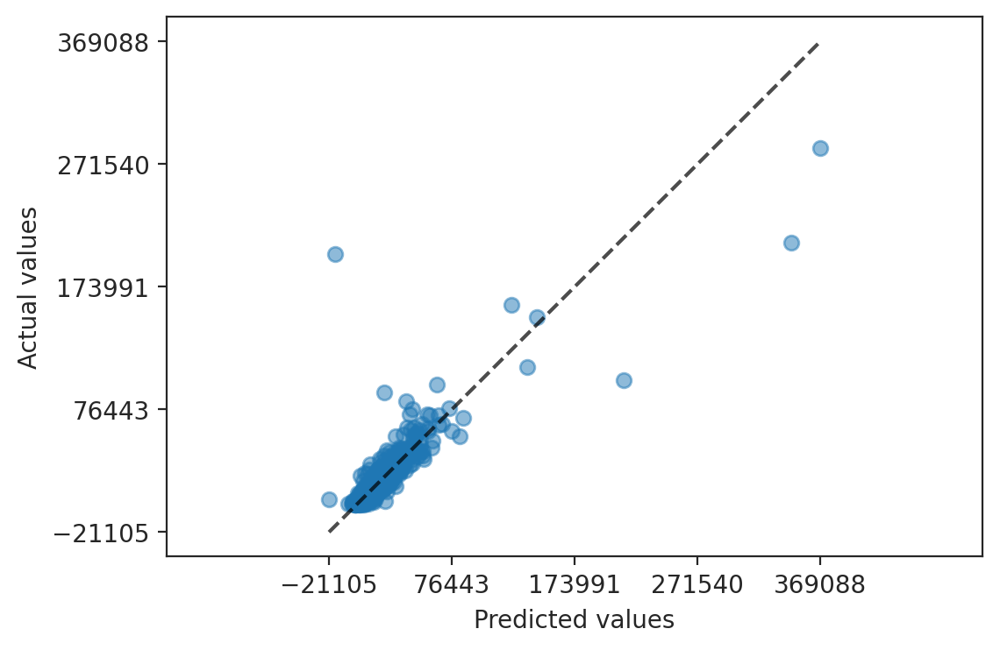

In [ ]:
PredictionErrorDisplay.from_estimator(
    lr_poly, x_training_bpf, y_training_bpf, kind="actual_vs_predicted", scatter_kwargs=dict(alpha=0.5), subsample = 1000, random_state = 45
);

In [ ]:
#Dataframe after the transformation of the data.
complete_lr_poly_df = lr_poly['transformations'].transform(x_training_bpf).head()
complete_lr_poly_df

,public_reference,mileage,year_of_registration,doors,seats,mileage_year,public_reference^2,public_reference mileage,public_reference year_of_registration,public_reference doors,...,vehicle_condition^2,vehicle_condition body_type,vehicle_condition crossover_car_and_van,vehicle_condition fuel_type,body_type^2,body_type crossover_car_and_van,body_type fuel_type,crossover_car_and_van^2,crossover_car_and_van fuel_type,fuel_type^2
0,0.994270,0.007800,0.965116,0.75,0.3,0.007785,0.988572,0.007755,0.959586,0.745702,...,0.0,0.0,0.0,0.0,0.063789,0.0,0.020106,0.0,0.0,0.006337
1,0.994471,0.064000,0.941860,0.75,0.3,0.063937,0.988972,0.063646,0.936653,0.745853,...,0.0,0.0,0.0,0.0,0.063789,0.0,0.016998,0.0,0.0,0.004529
2,0.856945,0.000005,0.953488,0.75,0.3,0.031776,0.734355,0.000004,0.817087,0.642709,...,0.0,0.0,0.0,0.0,0.063789,0.0,0.016998,0.0,0.0,0.004529
3,0.998553,0.047299,0.953488,0.75,0.3,0.047229,0.997108,0.047231,0.952109,0.748915,...,0.0,0.0,0.0,0.0,0.063789,0.0,0.016998,0.0,0.0,0.004529
4,0.993139,0.011961,0.988372,0.75,0.3,0.011925,0.986325,0.011879,0.981591,0.744854,...,0.0,0.0,0.0,0.0,0.063789,0.0,0.252565,0.0,0.0,1.000000


In [ ]:
#all (alone - metric)
# 4 , score = 0.43157688754705814, MAE = 10641.963368144807, 217 features from 14.

# 3 , score = 0.42277813373347917, MAE = 10613.375946228554, 91 features from 14.

# 2 , score = 0.4155319705388514, MAE = 10631.223298722109, 34 features from 14.

#all (both - metric & nonmetric)
# 4 , score = 0.9603281564210222, MAE = 3668.6811187314474, 703 features from 14.

# 3 , score = 0.888311357230431, MAE = 4489.212989373321, 247 features from 14.

# 2 , score = 0.7823424806773064, MAE = 4519.032311075758, 71 features from 14.

    # Key Difference: R-squared measures the proportion of variance in the dependent variable that is explained by the independent variables in the model.
    # Pros:
    #     Provides insight into goodness-of-fit: R-squared indicates how well the model fits the data compared to a baseline model (usually the mean of the target variable).
    #     Intuitive interpretation: R-squared values range from 0 to 1, where higher values indicate better model performance.
    # Cons:
    #     Can be misleading: R-squared increases as more predictors are added to the model, even if they are not truly associated with the target variable, which can lead to overfitting.
    #     Doesn't account for scale: R-squared is scale-dependent and may not be directly comparable between different datasets or models.

    # Mean Absolute Error (MAE):

    # Key Difference: MAE measures the average magnitude of errors between predicted and actual values, without considering the direction of the errors.
    # Pros:
    #     Easy to interpret: MAE is expressed in the same units as the target variable, making it intuitive to understand.
    #     Robust to outliers: MAE is less sensitive to outliers compared to other metrics like Mean Squared Error (MSE).
    # Cons:
    #     Ignores direction of errors: MAE treats all errors equally regardless of their direction, which may not accurately reflect the model's performance.
    #     Less informative: MAE doesn't provide information about the variability explained by the model or how well the predictions fit the data.

 # **6. FEATURE SELECTION AND DIMENSIONALITY REDUCTION**

 * Principal Component Analysis (PCA)
 * Manual Selection (based on EDA, PCA & domain knowledge)
 * Select K-best
 * Recursive Feature Elimination with Cross Validation (RFECV)
 * Sequential Feature Selector (SFS)
 * Summary of the "Feature Selection Process" (according to the "model" and according to the "feature selection technique")

## **6.1. PRINCIPAL COMPONENT ANALYSIS (PCA)**

* **Goal of using PCA in this project**: Spot positive or negative linear correlations among the features because:

  * This information and the insights gained during the Exploratory Data Analysis (EDA) will be used during the process of "Manual Selection of Features".

  * "Shapley Values" can be sensitive to "correlated features", as it becomes difficult to disentangle the "individual contributions" of each feature to the output of the model.
  
  * "Partial Dependency Plots" (PDP) assumes that the features are independent when visualizing the marginal effect of a single feature; therefore, if this assumption is violated, the PDP's method may not represent the true "feature's change" effects.

* **Important**: This method does not work properly as an "automatic feature selector" because its main goal is to reduce the dimensionality of the feature space creating new variables called "principal components", explaining the maximum amount of variance (mainly in the first one principal components). The following step were developed in PCA:

  * Step 1: Transforming the training dataset
  * Step 2: Performing Principal Component Analysis (PCA)
  * Step 2.1: Computing: Eigenvalues, Eigenvectors, Proportion of variance explained and Cumulative Proportion of variance explained.
  * Step 2.2: Scree Plot
  * Step 2.3: Loading Plot
  * Step 2.4: Cumulative Explained Variance Plot

In [ ]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

In [ ]:
#Function that define the "pipeline" for feature transformation in the exclusive case of Principal Component Analysis (PCA)
def pca_transformer_pipeline(X):

    #metric features transformations (valid for transforming the data that is going to be used in PCA)
    metric_features = X.select_dtypes(exclude='object').columns.tolist()
    metric_transformer = Pipeline(
        steps=[
            ("imputer", SimpleImputer(strategy="median")),
            ("scaler", StandardScaler())
        ]
    )

    #non-metric features transformations (valid for transforming the data that is going to be used in PCA)
    non_metric_features = X.select_dtypes(include='object').columns.tolist()
    non_metric_transformer = Pipeline(
        steps=[
            ("imputer", SimpleImputer(strategy="most_frequent")),
            ("encoder", TargetEncoder()),
            ("scaler", StandardScaler())
        ]
    )

    #Preprocessor (valid for transforming the data that is going to be used in PCA)
    pca_transformer_features = ColumnTransformer(
        transformers=[
            ("metric", metric_transformer, metric_features),
            ("non_metric", non_metric_transformer, non_metric_features),
        ],
        remainder='passthrough',
        verbose_feature_names_out=False
    )

    #Output: Pipeline ({transformation/preprocessing of the data})
    return pca_transformer_features

In [ ]:
#Function that define the "pipeline" for PCA (of course this pipeline has inside the pipeline called "pca_transformer_features")
def pca_pipeline(X):

    pca_pipeline = Pipeline(
        steps=[
            ("transformations", pca_transformer_pipeline(X)),
        ]
    )

    #Output: Pipeline ({transformation/preprocessing of the data})
    return pca_pipeline

In [ ]:
#Pipeline exclusive for transforming the training data that is going to be used in PCA (i.e., standardization is a key point in this process)
pca_scaling = pca_pipeline(x_training_bpf)

#Fitting the data to the pipeline called "pca_pipeline" exclusive for PCA
pca_scaling.fit(x_training_bpf, y_training_bpf)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['public_reference',
                                                   'mileage',
                                                   'year_of_registration',
                                                   'doors', 'seats',
                                                   'mileage_year']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder()),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['reg_code',
                                                   'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type',
                                                   'crossover_car_and_van',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False))])

In [ ]:
#Transfomed Features that belong to the training dataset
X_scaled = pca_scaling.transform(x_training_bpf)
X_scaled

,public_reference,mileage,year_of_registration,doors,seats,mileage_year,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,body_type,crossover_car_and_van,fuel_type
0,-0.004281,-0.857635,0.446291,0.427243,0.138419,-0.975784,0.970738,1.151699,-0.223092,-0.400720,-0.204552,0.687363,-0.068025,-0.174675
1,0.004159,0.753364,-0.033297,0.427243,0.138419,0.714476,-0.714072,1.151699,1.127742,1.671488,-0.204552,0.687363,-0.068025,-0.274179
2,-5.768164,-1.081082,0.206497,0.427243,0.138419,-0.253615,0.970738,0.795709,-0.366942,-0.052229,-0.204552,0.687363,-0.068025,-0.274179
3,0.175504,0.274622,0.206497,0.427243,0.138419,0.211544,-0.454088,0.795709,-0.366942,-0.265616,-0.204552,0.687363,-0.068025,-0.274179
4,-0.051745,-0.738358,0.925880,0.427243,0.138419,-0.851136,0.805871,-0.900602,0.468470,0.779329,-0.204552,0.687363,-0.068025,7.266593
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
241199,0.122008,-1.078072,1.165674,-0.674465,0.138419,-1.206811,2.004911,0.795709,-0.207656,4.134571,-0.204552,2.001178,14.700521,-0.274179
241200,0.190577,1.700671,-1.951651,-0.674465,0.138419,1.719888,0.970738,-0.210041,-0.269940,-0.171415,-0.204552,2.001178,-0.068025,-0.274179
241201,0.185152,4.451208,-0.512886,-0.674465,-7.529731,4.599488,-1.006100,-0.210041,-0.311084,-0.078960,-0.204552,-0.192549,14.700521,-0.274179
241202,-0.048129,1.871317,-0.752680,-0.674465,-7.529731,1.891890,0.970738,-0.210041,-0.368730,-0.054495,-0.204552,-0.192549,-0.068025,-0.274179


In [ ]:
#Performing PCA
pca = PCA()
pca.fit(X_scaled)

PCA()

In [ ]:
#Computing: Eigenvalues

  #It represents the amount of variance each principal "component explains".
  #It is important to highlight that the first components (i.e., components N° 1, 2 or 3) explain more variance...
  #...that the last components (i.e., components N° 12, 13 and 14 as we can see in:
    #The printed "eigenvalues"
    #The "Scree Plot"
    #The "Cumulative Explained Variance Plot"
  #In addition, it determines the number of "principal components" to retain (where the "eigenvalues" start to level off).
      #The goal is to retain the minimum number of "components" that explain a good amount of the "total variance" (between 80-90% of the "total variance")

eigenvalues = pca.explained_variance_
print(eigenvalues)

[3.31633572 2.82883974 1.32140283 1.07254936 1.00585933 0.98494073
 0.95864228 0.8791947  0.50107048 0.36806577 0.30696415 0.25935824
 0.18034004 0.01649468]


In [ ]:
#Computing: Eigenvectors

  #They are the directions of the "principal components", (i.e., the "eigenvectors" are a linear combination of the original features)

eigenvectors = pca.components_
print(eigenvectors)

[[ 0.01691978  0.51189576 -0.45719004 -0.11603419 -0.06860013  0.50108398
  -0.46449377 -0.08527044 -0.00110355 -0.07706708 -0.12329973  0.02553192
   0.01579467 -0.11970134]
 [-0.07024947 -0.05047173 -0.02267854 -0.48921286 -0.45299717 -0.0472377
   0.04173197  0.06531445  0.38752187  0.39040134  0.01310658  0.48533678
  -0.02219285  0.02064473]
 [-0.2157237   0.09046155 -0.08528176  0.30809831  0.39602364  0.12337983
  -0.0164528   0.09121026  0.49031723  0.51720875  0.13614843 -0.15164511
   0.27191963  0.19760144]
 [-0.03557405 -0.03251136  0.14324028  0.02378184  0.09075234 -0.16530782
  -0.02791817 -0.1215409   0.17091684  0.08857667 -0.70350113 -0.04336392
   0.25058452 -0.57344103]
 [-0.68002167 -0.08209463 -0.07608254 -0.10571122 -0.0570114  -0.05079718
   0.03208648 -0.56659924 -0.1391982  -0.14577932  0.17793083  0.03680125
   0.33503948  0.00893176]
 [-0.13716731 -0.02374042 -0.01668128  0.11963161  0.01369093 -0.0556445
  -0.05723751 -0.46662633  0.21042105  0.13601498 -0.

In [ ]:
#Computing: Proportion of variance explained

  #It is the proportion of the "total variance" in the data that that a specific "component" has.
  #It determines how much of the original data's information is preserved per "component".

proportion = pca.explained_variance_ratio_
print(proportion)

[0.23688014 0.20205914 0.09438552 0.07661035 0.0718468  0.07035262
 0.06847416 0.06279936 0.0357906  0.0262903  0.02192592 0.01852551
 0.01288138 0.00117819]


In [ ]:
#Computing: Cumulative Proportion of variance explained

  #It is the "cumulative sum" of the "variance explained" for each "component".

cumulative_proportion = np.cumsum (proportion)
print(cumulative_proportion)

[0.23688014 0.43893928 0.53332481 0.60993516 0.68178196 0.75213457
 0.82060874 0.8834081  0.9191987  0.945489   0.96741492 0.98594044
 0.99882181 1.        ]


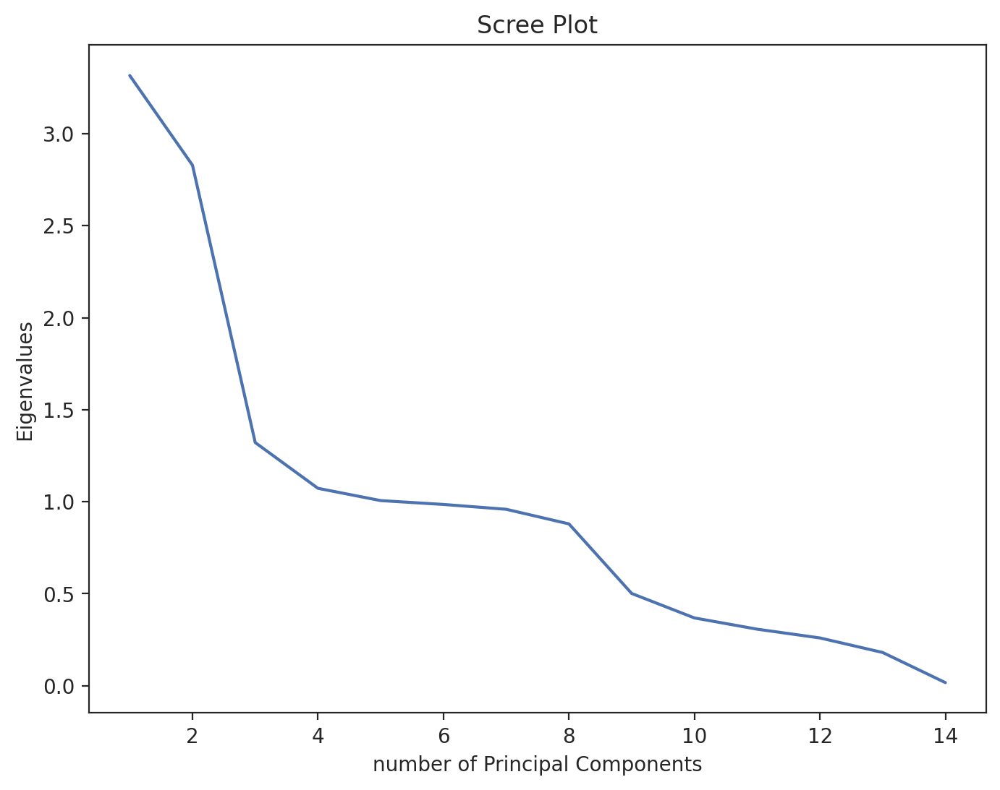

In [ ]:
##Scree Plot

  #Graphical representation that displays the "eigenvalues" vs "principal components" in descending order.
  #It determines the number of "principal components" to retain by identifying the "elbow" in the plot (where the "eigenvalues" start to level off).
    #The goal is to retain the minimum number of "components" that explain a satisfactory amount of the "total variance", often 80-90%.

plt.figure(figsize=(8, 6))
plt.plot(range(1, len(eigenvalues)+1),eigenvalues)
plt.xlabel('number of Principal Components')
plt.ylabel('Eigenvalues')
plt.title('Scree Plot')
plt.show()

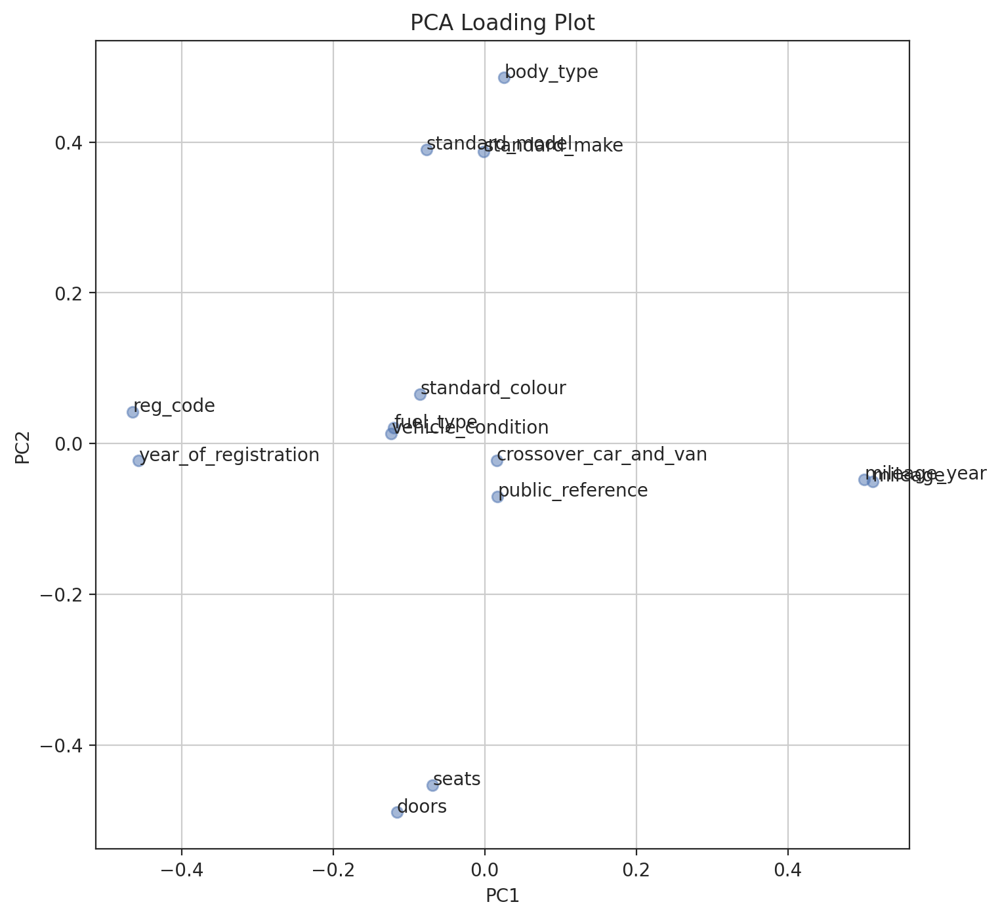

In [ ]:
#Loading Plot
  #It shows the loadings of each variable for the first two principal components.
  #Loadings: coefficients that indicate the relative weight or importance of each "feature" in the "principal components".
    #This information (i.e. the "loadings" come from the "eigenvectors").
  #Variables with high "loading" (close to -1 or 1) have a strong influence on a specific "principal components".
  #To make easier the visualization only the first two "principal components" (that explain the vast majority of the "total variance") were shown.

  #PCA (through the "Loading Plot") is useful to spot "correlations" among the original variables.
    #Variables with similar loadings are positively correlated
    #Variables with opposite loadings are negatively correlated: opposite in sign (one positive, one negative) on the same principal component.

#Loadings = Transpose of eigenvectors
loadings = pca.components_.T

#Building the Loading Plot
plt.figure(figsize=(8, 8))
plt.scatter(loadings[:,0], loadings[:,1], alpha=0.5)

#Add feature labels in the graph
for i, feature in enumerate(X_scaled.columns):
  plt.annotate(feature, (loadings[i,0], loadings[i,1]))

plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('PCA Loading Plot')
plt.grid()
plt.show()

In [ ]:
pca14 = PCA(n_components=14)
# fit PCA model to beast cancer data
pca14.fit(X_scaled)
# transform data onto the first two principal components
pca_features14 = pca14.transform(X_scaled)
print("Original shape: {}".format(str(X_scaled.shape)))
print("Reduced shape: {}".format(str(pca_features14.shape)))

Original shape: (241204, 14)
Reduced shape: (241204, 14)


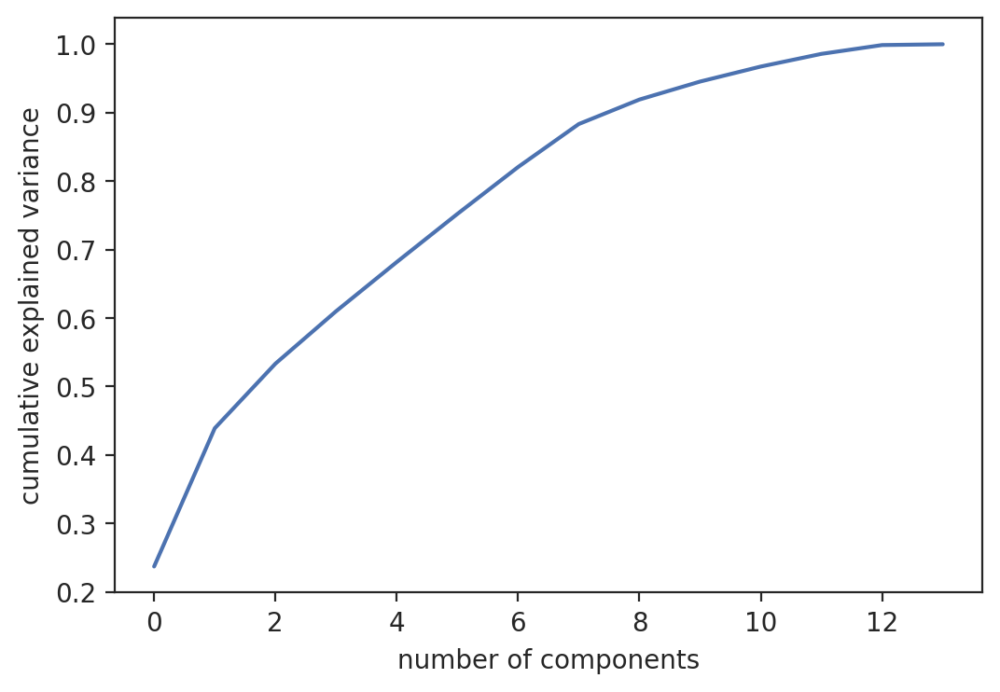

In [ ]:
plt.plot(np.cumsum(pca14.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance');

## **6.2. MANUAL (BASED ON EDA, PCA, & DOMAIN KNOWLEDGE)**

In [ ]:
#Function that define the "pipeline" for models (of course this pipeline has inside the pipeline of feature transformation)
def regression_pipeline_m(estimator_model, X, lin_model=False, poly_lin_model= False):

    reg_pipeline = Pipeline(
        steps=[
            ("transformations", transformer_pipeline(X, lin_model, poly_lin_model)),
            ("regressor", estimator_model)
        ]
    )

    #Output: Pipeline ({transformation/preprocessing of the data} + {model})
    return reg_pipeline

In [ ]:
#Phase 1 - Manual - Linear

#Pipeline exclusive for the model: Linear Regression (without polynomial)
lr_m = regression_pipeline_m(LinearRegression(), x_training_bpf, lin_model=True, poly_lin_model= False)

#Fitting the data to the pipeline exclusive for the model: Linear Regression (without polynomial)
lr_m.fit(x_training_bpf, y_training_bpf)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['public_reference',
                                                   'mileage',
                                                   'year_of_registration',
                                                   'doors', 'seats',
                                                   'mileage_year']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['reg_code',
                                                   'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type',
                                                   'crossover_car_and_van',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('regressor', LinearRegression())])

In [ ]:
#Getting the prediction: Linear Regression (without polynomial)
y_pred_lr_m = lr_m.predict(x_training_bpf)
print(y_pred_lr_m)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(lr_m.score(x_training_bpf, y_training_bpf))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_lr_m = mean_absolute_error(y_training_bpf, y_pred_lr_m)
print(mae_lr_m)

#Coefficients (also called "weights")
  #Coefficients values
coefficients_lr_m = lr_m.named_steps['regressor'].coef_
print("Coefficients:", coefficients_lr_m)
  #Coefficients Shape
print("Coefficients:", coefficients_lr_m.shape)

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_lr_m = lr_m['transformations'].get_feature_names_out()
print("Features:", features_lr_m)
  #Features Shape
print("Features:", features_lr_m.shape)

[-2767.0958853  61122.65753463 18540.66331071 ... -4581.2640642
 22784.97820634 26184.29066899]
0.4131471798507338
10569.889774332856
Coefficients: [-1.06450609e+04 -1.44466217e+05 -1.21347981e+04 -2.52642804e+04
  4.27397723e+03  8.00503692e+04  2.31822032e+04 -4.53841129e+03
 -2.02145524e+05  3.60519928e+06 -7.90965075e+02 -6.25995657e+04
 -1.52698525e+04 -1.11341366e+04]
Coefficients: (14,)
Features: ['public_reference' 'mileage' 'year_of_registration' 'doors' 'seats'
 'mileage_year' 'reg_code' 'standard_colour' 'standard_make'
 'standard_model' 'vehicle_condition' 'body_type' 'crossover_car_and_van'
 'fuel_type']
Features: (14,)


In [ ]:
#Dataframe of "Feature and Coefficients"
features_lr_m_df1 = pd.DataFrame(
    dict(
        features_lr_m = lr_m['transformations'].get_feature_names_out(),
        coefficients_lr_m = lr_m.named_steps['regressor'].coef_
    ),
)
features_lr_m_df1

,features_lr_m,coefficients_lr_m
0,public_reference,-1.064506e+04
1,mileage,-1.444662e+05
2,year_of_registration,-1.213480e+04
3,doors,-2.526428e+04
4,seats,4.273977e+03
5,mileage_year,8.005037e+04
6,reg_code,2.318220e+04
7,standard_colour,-4.538411e+03
8,standard_make,-2.021455e+05
9,standard_model,3.605199e+06


In [ ]:
#Dataframe after the transformation of the data.
lr_m['transformations'].transform(x_training_bpf).head()

,public_reference,mileage,year_of_registration,doors,seats,mileage_year,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,body_type,crossover_car_and_van,fuel_type
0,0.994270,0.007800,0.965116,0.75,0.3,0.007785,0.245302,0.636059,0.037568,0.007230,0.0,0.252565,0.0,0.079607
1,0.994471,0.064000,0.941860,0.75,0.3,0.063937,0.083941,0.636059,0.116493,0.031304,0.0,0.252565,0.0,0.067300
2,0.856945,0.000005,0.953488,0.75,0.3,0.031776,0.245302,0.586227,0.029164,0.011278,0.0,0.252565,0.0,0.067300
3,0.998553,0.047299,0.953488,0.75,0.3,0.047229,0.108840,0.586227,0.029164,0.008799,0.0,0.252565,0.0,0.067300
4,0.993139,0.011961,0.988372,0.75,0.3,0.011925,0.229512,0.348772,0.077974,0.020939,0.0,0.252565,0.0,1.000000


In [ ]:
#Phase 2 - Manual - Polynomial

In [ ]:
#Model: Linear Regression (with polynomial)
lr_poly_m = regression_pipeline_m(LinearRegression(), x_training_bpf, lin_model=False, poly_lin_model=True)

lr_poly_m.fit(x_training_bpf, y_training_bpf)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   MinMaxScaler()),
                                                                  ('poly',
                                                                   PolynomialFeatures(include_bias=False))]),
                                                  ['public_reference',
                                                   'mileage',
                                                   'year_of_registration',
                                                   'doors', 'seats',
                                                   'mileage_year']),
                                                 ('non_metric',
                                                  Pipeline(ste...r',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder()),
                                                                  ('scaler',
                                                                   MinMaxScaler()),
                                                                  ('poly',
                                                                   PolynomialFeatures(include_bias=False))]),
                                                  ['reg_code',
                                                   'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type',
                                                   'crossover_car_and_van',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('regressor', LinearRegression())])

In [ ]:
#Getting the prediction: Linear Regression (with polynomial)
y_pred_lr_poly_m = lr_poly_m.predict(x_training_bpf)
print(y_pred_lr_poly_m)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(lr_poly_m.score(x_training_bpf, y_training_bpf))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_lr_poly_m = mean_absolute_error(y_training_bpf, y_pred_lr_poly_m)
print(mae_lr_poly_m)

#Coefficients (also called "weights")
  #Coefficients values
coefficients_lr_poly_m = lr_poly_m.named_steps['regressor'].coef_
print("Coefficients:", coefficients_lr_poly_m)
  #Coefficients Shape
print("Coefficients:", coefficients_lr_poly_m.shape)

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_lr_poly_m = lr_poly_m['transformations'].get_feature_names_out()
print("Features:", features_lr_poly_m)
  #Features Shape
print("Features:", features_lr_poly_m.shape)

[ 15079.71173756  24029.47926237  26461.85138625 ...   3945.72394125
  -1818.51214064 -11585.75694213]
0.7823424806773063
4519.032311075536
Coefficients: [-3.08046866e+05  7.74362919e+07 -7.55195848e+05 -5.71031880e+04
 -6.12072645e+04 -7.79353718e+07  3.67316819e+03 -5.78492035e+05
  2.74016337e+05  2.59601898e+03  2.03267982e+04  1.17707483e+06
  6.33479722e+06 -7.89831373e+07  3.14360955e+05 -1.96355228e+06
 -5.70546993e+07  2.62405434e+05  5.33113516e+04  1.23137670e+05
  7.87411271e+07  4.29353659e+03 -4.56448735e+04 -1.36269300e+05
 -2.71493111e+04  1.79242163e+06  5.07821357e+07 -4.00376214e+04
  2.88002481e+03  1.84102140e+05 -9.06619751e+05  7.86081257e+02
  1.23555591e+04  5.07745640e+03  1.72317676e+04 -1.21403138e+03
  9.77703591e+03  2.31867825e+04  4.89657042e+06 -4.00075116e+04
 -4.26126646e+04 -4.08653532e+04  1.84661501e+04 -1.68642057e+02
  4.16083615e+03 -3.79353977e+05  2.01934351e+02  8.47977618e+03
  1.32482398e+04  8.60196530e+03 -1.40435018e+05  1.03115301e+06
 

In [ ]:
#Dataframe of "Feature and Coefficients"
features_lr_poly_m_df1 = pd.DataFrame(
    dict(
        features_lr_poly_m = lr_poly_m['transformations'].get_feature_names_out(),
        coefficients_lr_poly_m = lr_poly_m.named_steps['regressor'].coef_
    ),
)
features_lr_poly_m_df1

,features_lr_poly_m,coefficients_lr_poly_m
0,public_reference,-3.080469e+05
1,mileage,7.743629e+07
2,year_of_registration,-7.551958e+05
3,doors,-5.710319e+04
4,seats,-6.120726e+04
...,...,...
66,body_type crossover_car_and_van,-5.638459e+04
67,body_type fuel_type,9.379996e+03
68,crossover_car_and_van^2,5.077456e+03
69,crossover_car_and_van fuel_type,-9.482240e+02


In [ ]:
#Dataframe after the transformation of the data.
lr_poly_m['transformations'].transform(x_training_bpf).head()

,public_reference,mileage,year_of_registration,doors,seats,mileage_year,public_reference^2,public_reference mileage,public_reference year_of_registration,public_reference doors,...,vehicle_condition^2,vehicle_condition body_type,vehicle_condition crossover_car_and_van,vehicle_condition fuel_type,body_type^2,body_type crossover_car_and_van,body_type fuel_type,crossover_car_and_van^2,crossover_car_and_van fuel_type,fuel_type^2
0,0.994270,0.007800,0.965116,0.75,0.3,0.007785,0.988572,0.007755,0.959586,0.745702,...,0.0,0.0,0.0,0.0,0.063789,0.0,0.020106,0.0,0.0,0.006337
1,0.994471,0.064000,0.941860,0.75,0.3,0.063937,0.988972,0.063646,0.936653,0.745853,...,0.0,0.0,0.0,0.0,0.063789,0.0,0.016998,0.0,0.0,0.004529
2,0.856945,0.000005,0.953488,0.75,0.3,0.031776,0.734355,0.000004,0.817087,0.642709,...,0.0,0.0,0.0,0.0,0.063789,0.0,0.016998,0.0,0.0,0.004529
3,0.998553,0.047299,0.953488,0.75,0.3,0.047229,0.997108,0.047231,0.952109,0.748915,...,0.0,0.0,0.0,0.0,0.063789,0.0,0.016998,0.0,0.0,0.004529
4,0.993139,0.011961,0.988372,0.75,0.3,0.011925,0.986325,0.011879,0.981591,0.744854,...,0.0,0.0,0.0,0.0,0.063789,0.0,0.252565,0.0,0.0,1.000000


In [ ]:
#Phase 3 - Manual - RandomForest

In [ ]:
#Pipeline exclusive for the model: Linear Regression (with polynomial)
rf_m = regression_pipeline_m(RandomForestRegressor(max_depth=2, random_state=21), x_training_bpf,lin_model=False, poly_lin_model= False)

#Fitting the data to the pipeline exclusive for the model: Linear Regression (without polynomial)
rf_m.fit(x_training_bpf, y_training_bpf)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median'))]),
                                                  ['public_reference',
                                                   'mileage',
                                                   'year_of_registration',
                                                   'doors', 'seats',
                                                   'mileage_year']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder())]),
                                                  ['reg_code',
                                                   'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type',
                                                   'crossover_car_and_van',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('regressor',
                 RandomForestRegressor(max_depth=2, random_state=21))])

In [ ]:
#Getting the prediction: Linear Regression (without polynomial)
y_pred_rf_m = rf_m.predict(x_training_bpf)
print(y_pred_rf_m)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(rf_m.score(x_training_bpf, y_training_bpf))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_rf_m = mean_absolute_error(y_training_bpf, y_pred_rf_m)
print(mae_rf_m)

# In scikit-learn, certain models, such as linear models (e.g., LinearRegression, Ridge, Lasso) have coefficients because they represent linear relationships between features and the target variable. These coefficients indicate the magnitude and direction of the effect of each feature on the target variable.

# RandomForestRegressor, however, is a type of ensemble model based on decision trees. Unlike linear models, decision tree-based models do not have coefficients because they don't represent linear relationships. Instead, they make predictions by partitioning the feature space into regions and assigning an average (or other aggregation) of target values to each region.

# To assess feature importance in a RandomForestRegressor model, you can use the feature_importances_ attribute, which provides a relative measure of the importance of each feature in making predictions.

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_rf_m = rf_m['transformations'].get_feature_names_out()
print("Features:", features_rf_m)
  #Features Shape
print("Features:", features_rf_m.shape)

[15352.59528135 35907.11113185 15352.59528135 ... 15352.59528135
 15352.59528135 15352.59528135]
0.804561967262874
8992.099414765045
Features: ['public_reference' 'mileage' 'year_of_registration' 'doors' 'seats'
 'mileage_year' 'reg_code' 'standard_colour' 'standard_make'
 'standard_model' 'vehicle_condition' 'body_type' 'crossover_car_and_van'
 'fuel_type']
Features: (14,)


In [ ]:
#Dataframe of "Feature and Coefficients"
features_rf_m_df1 = pd.DataFrame(
    dict(
        features_rf_m = rf_m['transformations'].get_feature_names_out(),
    ),
)
features_rf_m_df1

,features_rf_m
0,public_reference
1,mileage
2,year_of_registration
3,doors
4,seats
5,mileage_year
6,reg_code
7,standard_colour
8,standard_make
9,standard_model


In [ ]:
rf_m['transformations'].transform(
    rf_m['transformations'].transform(x_training_bpf)
).head()

,public_reference,mileage,year_of_registration,doors,seats,mileage_year,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,body_type,crossover_car_and_van,fuel_type
0,2.020070e+14,7800.0,2017.0,5.0,5.0,3.867129,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112
1,2.020072e+14,64000.0,2015.0,5.0,5.0,31.761787,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112
2,2.019110e+14,5.0,2016.0,5.0,5.0,15.785218,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112
3,2.020100e+14,47299.0,2016.0,5.0,5.0,23.461806,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112
4,2.020062e+14,11961.0,2019.0,5.0,5.0,5.924220,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112


In [ ]:
#Phase 4 - Manual - Boosted Tree

In [ ]:
#Pipeline exclusive for the model: Linear Regression (with polynomial)
bt_m = regression_pipeline_m(GradientBoostingRegressor(max_depth=2, random_state=21), x_training_bpf,lin_model=False, poly_lin_model= False)

#Fitting the data to the pipeline exclusive for the model: Linear Regression (without polynomial)
bt_m.fit(x_training_bpf, y_training_bpf)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median'))]),
                                                  ['public_reference',
                                                   'mileage',
                                                   'year_of_registration',
                                                   'doors', 'seats',
                                                   'mileage_year']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder())]),
                                                  ['reg_code',
                                                   'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type',
                                                   'crossover_car_and_van',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('regressor',
                 GradientBoostingRegressor(max_depth=2, random_state=21))])

In [ ]:
#Getting the prediction: Linear Regression (without polynomial)
y_pred_bt_m = bt_m.predict(x_training_bpf)
print(y_pred_bt_m)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(bt_m.score(x_training_bpf, y_training_bpf))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_bt_m = mean_absolute_error(y_training_bpf, y_pred_bt_m)
print(mae_bt_m)

# In scikit-learn, certain models, such as linear models (e.g., LinearRegression, Ridge, Lasso) have coefficients because they represent linear relationships between features and the target variable. These coefficients indicate the magnitude and direction of the effect of each feature on the target variable.

# RandomForestRegressor, however, is a type of ensemble model based on decision trees. Unlike linear models, decision tree-based models do not have coefficients because they don't represent linear relationships. Instead, they make predictions by partitioning the feature space into regions and assigning an average (or other aggregation) of target values to each region.

# To assess feature importance in a RandomForestRegressor model, you can use the feature_importances_ attribute, which provides a relative measure of the importance of each feature in making predictions.

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_bt_m = bt_m['transformations'].get_feature_names_out()
print("Features:", features_bt_m)
  #Features Shape
print("Features:", features_bt_m.shape)

[15264.89024122 30425.63696967 23952.36424439 ...  7314.90570119
 11322.09892264  4946.9292628 ]
0.9585344354527308
3661.4228990682345
Features: ['public_reference' 'mileage' 'year_of_registration' 'doors' 'seats'
 'mileage_year' 'reg_code' 'standard_colour' 'standard_make'
 'standard_model' 'vehicle_condition' 'body_type' 'crossover_car_and_van'
 'fuel_type']
Features: (14,)


In [ ]:
#Dataframe of "Feature and Coefficients"
features_bt_m_df1 = pd.DataFrame(
    dict(
        features_bt_m = bt_m['transformations'].get_feature_names_out(),
    ),
)
features_bt_m_df1

,features_bt_m
0,public_reference
1,mileage
2,year_of_registration
3,doors
4,seats
5,mileage_year
6,reg_code
7,standard_colour
8,standard_make
9,standard_model


In [ ]:
bt_m['transformations'].transform(
    bt_m['transformations'].transform(x_training_bpf)
).head()

,public_reference,mileage,year_of_registration,doors,seats,mileage_year,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,body_type,crossover_car_and_van,fuel_type
0,2.020070e+14,7800.0,2017.0,5.0,5.0,3.867129,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112
1,2.020072e+14,64000.0,2015.0,5.0,5.0,31.761787,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112
2,2.019110e+14,5.0,2016.0,5.0,5.0,15.785218,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112
3,2.020100e+14,47299.0,2016.0,5.0,5.0,23.461806,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112
4,2.020062e+14,11961.0,2019.0,5.0,5.0,5.924220,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112,17376.122112


## **6.3. UNIVARIATE FEATURE SELECTION: SELECT K BEST**

* **Goal**: choose features individually based on their relationship with the target variable, without considering feature interactions.

* **Important:**  the "scoring function" choosen was "f_regression" because it is suitable for "Regression", it is based on "scoring function" called "r_regression" and it is less computational expensive than the "scoring function" called "mutual_info_regression".

* **Important:** Different values of "k" were tried (e.g., 2, 4, 6, 8, 10, 12 & 14) and the model's performance was evaluated using the Mean Absolute Error (MAE) to select "k value" that provided a good balance between performance (MAE) and model complexity (number of variables).

In [ ]:
#Data
data_c5 = data_c4.copy()
data_c5.info()

#Training Set
  # X
x_training_bpf = data_c5.drop(['price'], axis=1)

  # Y
y_training_bpf = data_c5['price']

<class 'pandas.core.frame.DataFrame'>
Int64Index: 241204 entries, 0 to 241203
Data columns (total 15 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   public_reference       241204 non-null  int64  
 1   mileage                241132 non-null  float64
 2   reg_code               222161 non-null  object 
 3   standard_colour        237947 non-null  object 
 4   standard_make          241204 non-null  object 
 5   standard_model         241204 non-null  object 
 6   vehicle_condition      241204 non-null  object 
 7   year_of_registration   221271 non-null  float64
 8   price                  241204 non-null  int64  
 9   body_type              240702 non-null  object 
 10  crossover_car_and_van  241204 non-null  object 
 11  fuel_type              240839 non-null  object 
 12  doors                  241204 non-null  int64  
 13  seats                  241204 non-null  int64  
 14  mileage_year           221210 non-nu

In [ ]:
#Phase 0 - Data for deciding the Kbest
#TEST GOOD
X_sel = transformer_pipeline(x_training_bpf, lin_model=True, poly_lin_model= False)
X_sel

ColumnTransformer(remainder='passthrough',
                  transformers=[('metric',
                                 Pipeline(steps=[('imputer',
                                                  SimpleImputer(strategy='median')),
                                                 ('scaler', MinMaxScaler())]),
                                 ['public_reference', 'mileage',
                                  'year_of_registration', 'doors', 'seats',
                                  'mileage_year']),
                                ('non_metric',
                                 Pipeline(steps=[('imputer',
                                                  SimpleImputer(strategy='most_frequent')),
                                                 ('encoder', TargetEncoder()),
                                                 ('scaler', MinMaxScaler())]),
                                 ['reg_code', 'standard_colour',
                                  'standard_make', 'standard_model',
                                  'vehicle_condition', 'body_type',
                                  'crossover_car_and_van', 'fuel_type'])],
                  verbose_feature_names_out=False)

In [ ]:
#TEST GOOD

yyyyy = X_sel.fit_transform(x_training_bpf, y_training_bpf)
yyyyy

,public_reference,mileage,year_of_registration,doors,seats,mileage_year,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,body_type,crossover_car_and_van,fuel_type
0,0.994270,0.007800,0.965116,0.75,0.3,0.007785,0.245302,0.636059,0.037568,0.007230,0.0,0.252565,0.0,0.079607
1,0.994471,0.064000,0.941860,0.75,0.3,0.063937,0.083941,0.636059,0.116493,0.031304,0.0,0.252565,0.0,0.067300
2,0.856945,0.000005,0.953488,0.75,0.3,0.031776,0.245302,0.586227,0.029164,0.011278,0.0,0.252565,0.0,0.067300
3,0.998553,0.047299,0.953488,0.75,0.3,0.047229,0.108840,0.586227,0.029164,0.008799,0.0,0.252565,0.0,0.067300
4,0.993139,0.011961,0.988372,0.75,0.3,0.011925,0.229512,0.348772,0.077974,0.020939,0.0,0.252565,0.0,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
241199,0.997279,0.000110,1.000000,0.50,0.3,0.000110,0.344349,0.586227,0.038470,0.059919,0.0,0.460202,1.0,0.067300
241200,0.998912,0.097047,0.848837,0.50,0.3,0.097337,0.245302,0.445439,0.034831,0.009894,0.0,0.460202,0.0,0.067300
241201,0.998783,0.193000,0.918605,0.50,0.0,0.193000,0.055972,0.445439,0.032427,0.010968,0.0,0.113503,1.0,0.067300
241202,0.993225,0.103000,0.906977,0.50,0.0,0.103051,0.245302,0.445439,0.029059,0.011252,0.0,0.113503,0.0,0.067300


In [ ]:
print(y_training_bpf.shape)
print(y_training_bpf.dtypes)

(241204,)
int64


In [ ]:
df_join_turkish = yyyyy.join(y_training_bpf)
df_join_turkish

,public_reference,mileage,year_of_registration,doors,seats,mileage_year,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,body_type,crossover_car_and_van,fuel_type,price
0,0.994270,0.007800,0.965116,0.75,0.3,0.007785,0.245302,0.636059,0.037568,0.007230,0.0,0.252565,0.0,0.079607,14000
1,0.994471,0.064000,0.941860,0.75,0.3,0.063937,0.083941,0.636059,0.116493,0.031304,0.0,0.252565,0.0,0.067300,26995
2,0.856945,0.000005,0.953488,0.75,0.3,0.031776,0.245302,0.586227,0.029164,0.011278,0.0,0.252565,0.0,0.067300,27595
3,0.998553,0.047299,0.953488,0.75,0.3,0.047229,0.108840,0.586227,0.029164,0.008799,0.0,0.252565,0.0,0.067300,11500
4,0.993139,0.011961,0.988372,0.75,0.3,0.011925,0.229512,0.348772,0.077974,0.020939,0.0,0.252565,0.0,1.000000,32995
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
241199,0.997279,0.000110,1.000000,0.50,0.3,0.000110,0.344349,0.586227,0.038470,0.059919,0.0,0.460202,1.0,0.067300,79990
241200,0.998912,0.097047,0.848837,0.50,0.3,0.097337,0.245302,0.445439,0.034831,0.009894,0.0,0.460202,0.0,0.067300,6995
241201,0.998783,0.193000,0.918605,0.50,0.0,0.193000,0.055972,0.445439,0.032427,0.010968,0.0,0.113503,1.0,0.067300,3995
241202,0.993225,0.103000,0.906977,0.50,0.0,0.103051,0.245302,0.445439,0.029059,0.011252,0.0,0.113503,0.0,0.067300,10495


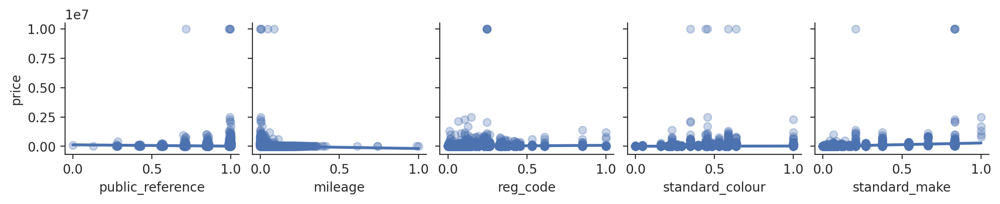

In [ ]:
#Make 14 plots
dfalbert = df_join_turkish[(df_join_turkish['price'] >= df_join_turkish['price'].quantile(0.25)) & (df_join_turkish['price'] <= df_join_turkish['price'].quantile(0.75))]

# public_reference       241204 non-null  int64
#  1   mileage                241132 non-null  float64
#  2   reg_code               222161 non-null  object
#  3   standard_colour        237947 non-null  object
#  4   standard_make          241204 non-null  object
#  5   standard_model         241204 non-null  object
#  6   vehicle_condition      241204 non-null  object
#  7   year_of_registration   221271 non-null  float64
#  8   price                  241204 non-null  int64
#  9   body_type              240702 non-null  object
#  10  crossover_car_and_van  241204 non-null  object
#  11  fuel_type              240839 non-null  object
#  12  doors                  241204 non-null  int64
#  13  seats                  241204 non-null  int64
#  14  mileage_year           221210 non-null  float64


sns.pairplot(
    data=df_join_turkish, x_vars=['public_reference','mileage', "reg_code","standard_colour","standard_make"], y_vars='price',
    kind='reg', plot_kws=dict(scatter_kws=(dict(alpha=0.3))),
    height=2.2
);

In [ ]:
#Phase 1 - KBest - Linear Regression
from sklearn.feature_selection import SelectKBest, f_regression

In [ ]:
#Function that define the "pipeline" for models (of course this pipeline has inside the pipeline of feature transformation)
  #<---The same for all models. It will make easier the evaluation
def regression_pipeline_k(estimator_model, X, lin_model=False, poly_lin_model= False):

    reg_pipeline = Pipeline(
        steps=[
            ("transformations", transformer_pipeline(X, lin_model, poly_lin_model)),
            ("feat_sel_k", SelectKBest(f_regression, k=8)),
            ("regressor", estimator_model),
        ]
    )

    #Output: Pipeline ({transformation/preprocessing of the data} + {model})
    return reg_pipeline

In [ ]:
#Pipeline exclusive for the model: Linear Regression (without polynomial)
lr_k_best = regression_pipeline_k(LinearRegression(), x_training_bpf,lin_model=True, poly_lin_model= False)

#Fitting the data to the pipeline exclusive for the model: Linear Regression (without polynomial)
lr_k_best.fit(x_training_bpf, y_training_bpf)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['public_reference',
                                                   'mileage',
                                                   'year_of_registration',
                                                   'doors', 'seats',
                                                   'mileage_year']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['reg_code',
                                                   'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type',
                                                   'crossover_car_and_van',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('feat_sel_k',
                 SelectKBest(k=8,
                             score_func=<function f_regression at 0x78a74930a5f0>)),
                ('regressor', LinearRegression())])

In [ ]:
#Getting the prediction: Linear Regression (without polynomial)
y_pred_lr_k_best = lr_k_best.predict(x_training_bpf)
print(y_pred_lr_k_best)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(lr_k_best.score(x_training_bpf, y_training_bpf))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_lr_k_best = mean_absolute_error(y_training_bpf, y_pred_lr_k_best)
print(mae_lr_k_best)

#Coefficients (also called "weights")
  #Coefficients values
coefficients_lr_k_best = lr_k_best.named_steps['regressor'].coef_
print("Coefficients:", coefficients_lr_k_best)
  #Coefficients Shape
print("Coefficients:", coefficients_lr_k_best.shape)

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_lr_k_best = lr_k_best['feat_sel_k'].get_feature_names_out()
print("Features:", features_lr_k_best)
  #Features Shape
print("Features:", features_lr_k_best.shape)

[-2359.89882891 61205.0427307  16088.52287579 ... 11216.98947001
 23095.80732296 27691.72980751]
0.411919146885541
10525.035963204555
Coefficients: [-117294.84687146  -14204.10914791  -24901.65639373   50205.35083365
   21042.89334807 -199492.82140987 3578457.44636443  -62539.94250366]
Coefficients: (8,)
Features: ['mileage' 'year_of_registration' 'doors' 'mileage_year' 'reg_code'
 'standard_make' 'standard_model' 'body_type']
Features: (8,)


In [ ]:
#Dataframe of "Feature and Coefficients"
features_lr_k_best_df1 = pd.DataFrame(
    dict(
        features_lr_k_best = lr_k_best['feat_sel_k'].get_feature_names_out(),
        coefficients_lr_k_best = lr_k_best.named_steps['regressor'].coef_
    ),
)
features_lr_k_best_df1

,features_lr_k_best,coefficients_lr_k_best
0,mileage,-1.172948e+05
1,year_of_registration,-1.420411e+04
2,doors,-2.490166e+04
3,mileage_year,5.020535e+04
4,reg_code,2.104289e+04
5,standard_make,-1.994928e+05
6,standard_model,3.578457e+06
7,body_type,-6.253994e+04


In [ ]:
lr_k_best['feat_sel_k'].transform(
    lr_k_best['transformations'].transform(x_training_bpf)
).head()

,mileage,year_of_registration,doors,mileage_year,reg_code,standard_make,standard_model,body_type
0,0.007800,0.965116,0.75,0.007785,0.245302,0.037568,0.007230,0.252565
1,0.064000,0.941860,0.75,0.063937,0.083941,0.116493,0.031304,0.252565
2,0.000005,0.953488,0.75,0.031776,0.245302,0.029164,0.011278,0.252565
3,0.047299,0.953488,0.75,0.047229,0.108840,0.029164,0.008799,0.252565
4,0.011961,0.988372,0.75,0.011925,0.229512,0.077974,0.020939,0.252565


In [ ]:
#Phase 2 - KBest - Polynomial Regression

In [ ]:
#Pipeline exclusive for the model: Linear Regression (with polynomial)
lr_poly_k_best = regression_pipeline_k(LinearRegression(), x_training_bpf,lin_model=False, poly_lin_model= True)

#Fitting the data to the pipeline exclusive for the model: Linear Regression (without polynomial)
lr_poly_k_best.fit(x_training_bpf, y_training_bpf)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   MinMaxScaler()),
                                                                  ('poly',
                                                                   PolynomialFeatures(include_bias=False))]),
                                                  ['public_reference',
                                                   'mileage',
                                                   'year_of_registration',
                                                   'doors', 'seats',
                                                   'mileage_year']),
                                                 ('non_metric',
                                                  Pipeline(ste...
                                                                   MinMaxScaler()),
                                                                  ('poly',
                                                                   PolynomialFeatures(include_bias=False))]),
                                                  ['reg_code',
                                                   'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type',
                                                   'crossover_car_and_van',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('feat_sel_k',
                 SelectKBest(k=8,
                             score_func=<function f_regression at 0x78a74930a5f0>)),
                ('regressor', LinearRegression())])

In [ ]:
#Getting the prediction: Linear Regression (without polynomial)
y_pred_lr_poly_k_best = lr_poly_k_best.predict(x_training_bpf)
print(y_pred_lr_poly_k_best)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(lr_poly_k_best.score(x_training_bpf, y_training_bpf))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_lr_poly_k_best = mean_absolute_error(y_training_bpf, y_pred_lr_poly_k_best)
print(mae_lr_poly_k_best)

#Coefficients (also called "weights")
  #Coefficients values
coefficients_lr_poly_k_best = lr_poly_k_best.named_steps['regressor'].coef_
print("Coefficients:", coefficients_lr_poly_k_best)
  #Coefficients Shape
print("Coefficients:", coefficients_lr_poly_k_best.shape)

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_lr_poly_k_best = lr_poly_k_best['feat_sel_k'].get_feature_names_out()
print("Features:", features_lr_poly_k_best)
  #Features Shape
print("Features:", features_lr_poly_k_best.shape)

[15694.01934779 24475.1263819  19779.23960739 ...  8348.37291214
 18500.14013499  6517.63580485]
0.7703376834774746
4942.3610581681
Coefficients: [  14552.758749   -468871.7521683    45309.64553553 4666459.70394595
   52197.32181686  349803.88423888 9060684.35441591  743975.99341301]
Coefficients: (8,)
Features: ['standard_make' 'standard_model' 'reg_code standard_make'
 'reg_code standard_model' 'standard_colour standard_model'
 'standard_make standard_model' 'standard_model^2'
 'standard_model body_type']
Features: (8,)


In [ ]:
#Dataframe of "Feature and Coefficients"
features_lr_poly_k_best_df1 = pd.DataFrame(
    dict(
        features_lr_poly_k_best = lr_poly_k_best['feat_sel_k'].get_feature_names_out(),
        coefficients_lr_poly_k_best = lr_poly_k_best.named_steps['regressor'].coef_
    ),
)
features_lr_poly_k_best_df1

,features_lr_poly_k_best,coefficients_lr_poly_k_best
0,standard_make,1.455276e+04
1,standard_model,-4.688718e+05
2,reg_code standard_make,4.530965e+04
3,reg_code standard_model,4.666460e+06
4,standard_colour standard_model,5.219732e+04
5,standard_make standard_model,3.498039e+05
6,standard_model^2,9.060684e+06
7,standard_model body_type,7.439760e+05


In [ ]:
lr_poly_k_best['feat_sel_k'].transform(
    lr_poly_k_best['transformations'].transform(x_training_bpf)
).head()

,standard_make,standard_model,reg_code standard_make,reg_code standard_model,standard_colour standard_model,standard_make standard_model,standard_model^2,standard_model body_type
0,0.037568,0.007230,0.009216,0.001773,0.004599,0.000272,0.000052,0.001826
1,0.116493,0.031304,0.009778,0.002628,0.019911,0.003647,0.000980,0.007906
2,0.029164,0.011278,0.007154,0.002767,0.006612,0.000329,0.000127,0.002849
3,0.029164,0.008799,0.003174,0.000958,0.005158,0.000257,0.000077,0.002222
4,0.077974,0.020939,0.017896,0.004806,0.007303,0.001633,0.000438,0.005289


In [ ]:
#Phase 3 - KBest - RandomForest

In [ ]:
#Pipeline exclusive for the model: Linear Regression (with polynomial)
rf_k_best = regression_pipeline_k(RandomForestRegressor(max_depth=2, random_state=21), x_training_bpf,lin_model=False, poly_lin_model= False)

#Fitting the data to the pipeline exclusive for the model: Linear Regression (without polynomial)
rf_k_best.fit(x_training_bpf, y_training_bpf)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median'))]),
                                                  ['public_reference',
                                                   'mileage',
                                                   'year_of_registration',
                                                   'doors', 'seats',
                                                   'mileage_year']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder())]),
                                                  ['reg_code',
                                                   'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type',
                                                   'crossover_car_and_van',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('feat_sel_k',
                 SelectKBest(k=8,
                             score_func=<function f_regression at 0x78a74930a5f0>)),
                ('regressor',
                 RandomForestRegressor(max_depth=2, random_state=21))])

In [ ]:
#Getting the prediction: Linear Regression (without polynomial)
y_pred_rf_k_best = rf_k_best.predict(x_training_bpf)
print(y_pred_rf_k_best)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(rf_k_best.score(x_training_bpf, y_training_bpf))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_rf_k_best = mean_absolute_error(y_training_bpf, y_pred_rf_k_best)
print(mae_rf_k_best)

# In scikit-learn, certain models, such as linear models (e.g., LinearRegression, Ridge, Lasso) have coefficients because they represent linear relationships between features and the target variable. These coefficients indicate the magnitude and direction of the effect of each feature on the target variable.

# RandomForestRegressor, however, is a type of ensemble model based on decision trees. Unlike linear models, decision tree-based models do not have coefficients because they don't represent linear relationships. Instead, they make predictions by partitioning the feature space into regions and assigning an average (or other aggregation) of target values to each region.

# To assess feature importance in a RandomForestRegressor model, you can use the feature_importances_ attribute, which provides a relative measure of the importance of each feature in making predictions.

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_rf_k_best = rf_k_best['feat_sel_k'].get_feature_names_out()
print("Features:", features_rf_k_best)
  #Features Shape
print("Features:", features_rf_k_best.shape)

[15352.59528135 35907.11113185 15352.59528135 ... 15352.59528135
 15352.59528135 15352.59528135]
0.8076835404066836
8989.340963174773
Features: ['mileage' 'year_of_registration' 'doors' 'mileage_year' 'reg_code'
 'standard_make' 'standard_model' 'body_type']
Features: (8,)


In [ ]:
#Dataframe of "Feature and Coefficients"
features_rf_k_best_df1 = pd.DataFrame(
    dict(
        features_rf_k_best = rf_k_best['feat_sel_k'].get_feature_names_out(),
    ),
)
features_rf_k_best_df1

,features_rf_k_best
0,mileage
1,year_of_registration
2,doors
3,mileage_year
4,reg_code
5,standard_make
6,standard_model
7,body_type


In [ ]:
rf_k_best['feat_sel_k'].transform(
    rf_k_best['transformations'].transform(x_training_bpf)
).head()

,mileage,year_of_registration,doors,mileage_year,reg_code,standard_make,standard_model,body_type
0,7800.0,2017.0,5.0,3.867129,24985.438376,13734.552871,10719.610998,22506.665734
1,64000.0,2015.0,5.0,31.761787,11765.292625,35584.701048,42376.639629,22506.665734
2,5.0,2016.0,5.0,15.785218,24985.438376,11407.733288,16043.486877,22506.665734
3,47299.0,2016.0,5.0,23.461806,13805.296486,11407.733288,12783.591704,22506.665734
4,11961.0,2019.0,5.0,5.924220,23691.779245,24920.769242,28747.164148,22506.665734


In [ ]:
#Phase 4 - KBest - Boosted Tree

In [ ]:
#Pipeline exclusive for the model: Linear Regression (with polynomial)
bt_k_best = regression_pipeline_k(GradientBoostingRegressor(max_depth=2, random_state=21), x_training_bpf,lin_model=False, poly_lin_model= False)

#Fitting the data to the pipeline exclusive for the model: Linear Regression (without polynomial)
bt_k_best.fit(x_training_bpf, y_training_bpf)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median'))]),
                                                  ['public_reference',
                                                   'mileage',
                                                   'year_of_registration',
                                                   'doors', 'seats',
                                                   'mileage_year']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder())]),
                                                  ['reg_code',
                                                   'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type',
                                                   'crossover_car_and_van',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('feat_sel_k',
                 SelectKBest(k=8,
                             score_func=<function f_regression at 0x78a74930a5f0>)),
                ('regressor',
                 GradientBoostingRegressor(max_depth=2, random_state=21))])

In [ ]:
#Getting the prediction: Linear Regression (without polynomial)
y_pred_bt_k_best = bt_k_best.predict(x_training_bpf)
print(y_pred_bt_k_best)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(bt_k_best.score(x_training_bpf, y_training_bpf))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_bt_k_best = mean_absolute_error(y_training_bpf, y_pred_bt_k_best)
print(mae_bt_k_best)

# In scikit-learn, certain models, such as linear models (e.g., LinearRegression, Ridge, Lasso) have coefficients because they represent linear relationships between features and the target variable. These coefficients indicate the magnitude and direction of the effect of each feature on the target variable.

# RandomForestRegressor, however, is a type of ensemble model based on decision trees. Unlike linear models, decision tree-based models do not have coefficients because they don't represent linear relationships. Instead, they make predictions by partitioning the feature space into regions and assigning an average (or other aggregation) of target values to each region.

# To assess feature importance in a RandomForestRegressor model, you can use the feature_importances_ attribute, which provides a relative measure of the importance of each feature in making predictions.

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_bt_k_best = bt_k_best['feat_sel_k'].get_feature_names_out()
print("Features:", features_bt_k_best)
  #Features Shape
print("Features:", features_bt_k_best.shape)

[14856.42579435 30827.61735456 23655.48395249 ...  7599.26661021
 11158.80354409  4996.18493275]
0.9579195226562432
3658.308468554082
Features: ['mileage' 'year_of_registration' 'doors' 'mileage_year' 'reg_code'
 'standard_make' 'standard_model' 'body_type']
Features: (8,)


In [ ]:
#Dataframe of "Feature and Coefficients"
features_bt_k_best_df1 = pd.DataFrame(
    dict(
        features_bt_k_best = bt_k_best['feat_sel_k'].get_feature_names_out(),
    ),
)
features_bt_k_best_df1

,features_bt_k_best
0,mileage
1,year_of_registration
2,doors
3,mileage_year
4,reg_code
5,standard_make
6,standard_model
7,body_type


In [ ]:
bt_k_best['feat_sel_k'].transform(
    bt_k_best['transformations'].transform(x_training_bpf)
).head()

,mileage,year_of_registration,doors,mileage_year,reg_code,standard_make,standard_model,body_type
0,7800.0,2017.0,5.0,3.867129,24985.438376,13734.552871,10719.610998,22506.665734
1,64000.0,2015.0,5.0,31.761787,11765.292625,35584.701048,42376.639629,22506.665734
2,5.0,2016.0,5.0,15.785218,24985.438376,11407.733288,16043.486877,22506.665734
3,47299.0,2016.0,5.0,23.461806,13805.296486,11407.733288,12783.591704,22506.665734
4,11961.0,2019.0,5.0,5.924220,23691.779245,24920.769242,28747.164148,22506.665734


In [ ]:
#Data for k-best selection
data_k_best_experiments = [[2, 11545.366603543604, 8349.650742983808, 9026.936914497375, 6302.225378714083],
                           [4, 10895.624302697275, 4846.53760233921, 9021.373888321024,  4276.73343417771],
                           [6, 10660.446757841504, 5035.021607517245, 9012.317467073657, 3721.391264751708],
                           [8, 10525.035963204555, 4942.361058168102, 8989.340963174773, 3658.308468554082],
                           [10, 10538.47248177025, 5112.617306351996, 8990.139524315844, 3660.681456696337],
                           [12, 10536.662501656401, 5102.048034789234, 8990.25101230627, 3661.4228990682354],
                           [14, 10569.889774332873, 5085.485101846191, 8992.099414765045, 3661.4228990682345]]

# Create the pandas DataFrame
data_k_best_experiments_df = pd.DataFrame(data_k_best_experiments, columns=['k value', 'Linear Model MAE (£)', "Polynomial Model MAE (£)", "Random Forest MAE (£)", "Boosted Tree MAE (£)"])

# print dataframe.
data_k_best_experiments_df

,k value,Linear Model MAE (£),Polynomial Model MAE (£),Random Forest MAE (£),Boosted Tree MAE (£)
0,2,11545.366604,8349.650743,9026.936914,6302.225379
1,4,10895.624303,4846.537602,9021.373888,4276.733434
2,6,10660.446758,5035.021608,9012.317467,3721.391265
3,8,10525.035963,4942.361058,8989.340963,3658.308469
4,10,10538.472482,5112.617306,8990.139524,3660.681457
5,12,10536.662502,5102.048035,8990.251012,3661.422899
6,14,10569.889774,5085.485102,8992.099415,3661.422899


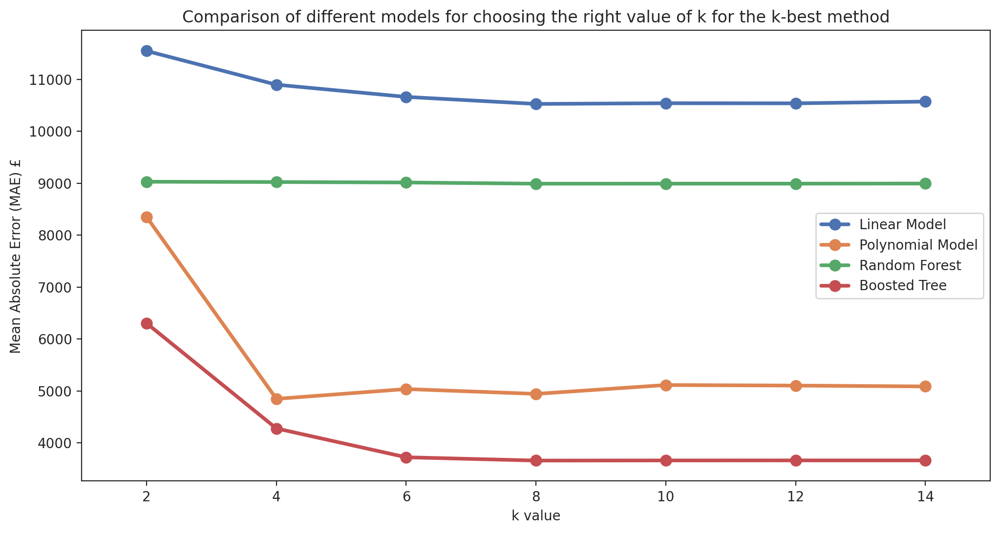

In [ ]:
# Create the point plot
plt.figure(figsize=(12, 6))
sns.pointplot(x='k value', y='Linear Model MAE (£)', data=data_k_best_experiments_df, label='Linear Model')
sns.pointplot(x='k value', y='Polynomial Model MAE (£)', data=data_k_best_experiments_df, label='Polynomial Model')
sns.pointplot(x='k value', y='Random Forest MAE (£)', data=data_k_best_experiments_df, label='Random Forest')
sns.pointplot(x='k value', y='Boosted Tree MAE (£)', data=data_k_best_experiments_df, label='Boosted Tree')

# Add labels and title
plt.xlabel('k value')
plt.ylabel('Mean Absolute Error (MAE) £')
plt.title('Comparison of different models for choosing the right value of k for the k-best method')
plt.legend()

# Display the plot
plt.show()

## **6.4. RECURSIVE FEATURE ELIMINATION WITH CROSS VALIDATION (RFECV)**

* **Goal**: Choose features using a method that starts with the full set of features and iteratively removes the least important ones. It will use a machine learning model (in this case, a "linear regression" through its "coefficients") to rank the univariate measure of importance and then remove the least important ones. Finally, it captures multivariate relationships.

In [ ]:
#Data
data_c5 = data_c4.copy()
data_c5.info()

#Training Set
  # X
x_training_bpf = data_c5.drop(['price'], axis=1)

  # Y
y_training_bpf = data_c5['price']

<class 'pandas.core.frame.DataFrame'>
Int64Index: 241204 entries, 0 to 241203
Data columns (total 15 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   public_reference       241204 non-null  int64  
 1   mileage                241132 non-null  float64
 2   reg_code               222161 non-null  object 
 3   standard_colour        237947 non-null  object 
 4   standard_make          241204 non-null  object 
 5   standard_model         241204 non-null  object 
 6   vehicle_condition      241204 non-null  object 
 7   year_of_registration   221271 non-null  float64
 8   price                  241204 non-null  int64  
 9   body_type              240702 non-null  object 
 10  crossover_car_and_van  241204 non-null  object 
 11  fuel_type              240839 non-null  object 
 12  doors                  241204 non-null  int64  
 13  seats                  241204 non-null  int64  
 14  mileage_year           221210 non-nu

In [ ]:
#Phase 1 - RFECV - Linear Regression

In [ ]:
from sklearn.feature_selection import RFECV

In [ ]:
#Function that define the "pipeline" for models (of course this pipeline has inside the pipeline of feature transformation)
  #<---The same for all models. It will make easier the evaluation
def regression_pipeline_RFECV(estimator_model, X, lin_model=False, poly_lin_model= False):

    reg_pipeline = Pipeline(
        steps=[
            ("transformations", transformer_pipeline(X, lin_model, poly_lin_model)),
            ("feat_sel_RFECV", RFECV(LinearRegression(), step=1, cv=5)),
            ("regressor", estimator_model),
        ]
    )

    #Output: Pipeline ({transformation/preprocessing of the data} + {model})
    return reg_pipeline

In [ ]:
#Pipeline exclusive for the model: Linear Regression (without polynomial)
lr_RFECV = regression_pipeline_RFECV(LinearRegression(), x_training_bpf,lin_model=True, poly_lin_model= False)

#Fitting the data to the pipeline exclusive for the model: Linear Regression (without polynomial)
lr_RFECV.fit(x_training_bpf, y_training_bpf)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['public_reference',
                                                   'mileage',
                                                   'year_of_registration',
                                                   'doors', 'seats',
                                                   'mileage_year']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['reg_code',
                                                   'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type',
                                                   'crossover_car_and_van',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('feat_sel_RFECV', RFECV(cv=5, estimator=LinearRegression())),
                ('regressor', LinearRegression())])

In [ ]:
#Getting the prediction: Linear Regression (without polynomial)
y_pred_lr_RFECV = lr_RFECV.predict(x_training_bpf)
print(y_pred_lr_RFECV)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(lr_RFECV.score(x_training_bpf, y_training_bpf))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_lr_RFECV = mean_absolute_error(y_training_bpf, y_pred_lr_RFECV)
print(mae_lr_RFECV)

#Coefficients (also called "weights")
  #Coefficients values
coefficients_lr_RFECV = lr_RFECV.named_steps['regressor'].coef_
print("Coefficients:", coefficients_lr_RFECV)
  #Coefficients Shape
print("Coefficients:", coefficients_lr_RFECV.shape)

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_lr_RFECV = lr_RFECV['feat_sel_RFECV'].get_feature_names_out()
print("Features:", features_lr_RFECV)
  #Features Shape
print("Features:", features_lr_RFECV.shape)

[-2060.92785641 61810.9964019  18581.94906972 ... -3199.50129653
 23820.97522862 27822.10190686]
0.41298858134724437
10559.60551733903
Coefficients: [ -10977.46304139 -129499.70778431  -13543.07536493  -24746.4884887
   64424.83810043   22788.95492169 -202321.24839446 3602546.15539022
  -62835.94396669  -14921.96765464  -11138.90545893]
Coefficients: (11,)
Features: ['public_reference' 'mileage' 'year_of_registration' 'doors'
 'mileage_year' 'reg_code' 'standard_make' 'standard_model' 'body_type'
 'crossover_car_and_van' 'fuel_type']
Features: (11,)


In [ ]:
#Dataframe of "Feature and Coefficients"
features_lr_RFECV_df1 = pd.DataFrame(
    dict(
        features_lr_RFECV = lr_RFECV['feat_sel_RFECV'].get_feature_names_out(),
        coefficients_lr_RFECV = lr_RFECV.named_steps['regressor'].coef_
    ),
)
features_lr_RFECV_df1

,features_lr_RFECV,coefficients_lr_RFECV
0,public_reference,-1.097746e+04
1,mileage,-1.294997e+05
2,year_of_registration,-1.354308e+04
3,doors,-2.474649e+04
4,mileage_year,6.442484e+04
5,reg_code,2.278895e+04
6,standard_make,-2.023212e+05
7,standard_model,3.602546e+06
8,body_type,-6.283594e+04
9,crossover_car_and_van,-1.492197e+04


In [ ]:
#"lr_RFECV['feat_sel_RFECV']" = piece of code that execute the Feature Selection using RFECV
#"lr_RFECV['transformations'].transform(x_training_bpf)" = it shows us the data "transformed/preprocessed" and only the features selected through RFECV

lr_RFECV['feat_sel_RFECV'].transform(
    lr_RFECV['transformations'].transform(x_training_bpf)
).head()

,public_reference,mileage,year_of_registration,doors,mileage_year,reg_code,standard_make,standard_model,body_type,crossover_car_and_van,fuel_type
0,0.994270,0.007800,0.965116,0.75,0.007785,0.245302,0.037568,0.007230,0.252565,0.0,0.079607
1,0.994471,0.064000,0.941860,0.75,0.063937,0.083941,0.116493,0.031304,0.252565,0.0,0.067300
2,0.856945,0.000005,0.953488,0.75,0.031776,0.245302,0.029164,0.011278,0.252565,0.0,0.067300
3,0.998553,0.047299,0.953488,0.75,0.047229,0.108840,0.029164,0.008799,0.252565,0.0,0.067300
4,0.993139,0.011961,0.988372,0.75,0.011925,0.229512,0.077974,0.020939,0.252565,0.0,1.000000


In [ ]:
# should match the number of features
# The size of all values in cv_results_ is equal to:
  # ceil((n_features - min_features_to_select) / step) + 1 ;where:
    #"n_features" represents the total number of features or elements we're working with.
    #"step" is the number of features removed at each iteration.
    #"ceil": This takes the ceiling of the division result, ensuring that even fractional steps are rounded up to the nearest...
    #..whole number. This means that even if the division results in a fractional step, it's counted as a full step.
    #"min_features_to_select" is 1 (by default)

#The performance of the RFE selector are evaluated using "scorer" for different number of selected features and aggregated together.
  #Finally, the "scores" are averaged across folds and the number of features selected is set to the number of features that maximize...
  #...the cross-validation score.
#mean_test_score: Mean of scores over the folds.
#std_test_scoren: Standard deviation of scores over the folds.

#Number of scores = same number of original features (before to RFECV)
n_scores = len (lr_RFECV['feat_sel_RFECV'].cv_results_['mean_test_score'])
print(n_scores)

#Scores
print(np.flip(lr_RFECV['feat_sel_RFECV'].cv_results_['mean_test_score']))

14
[-0.23978235 -0.23970972 -0.23815499 -0.23778261 -0.24681233 -0.24706838
 -0.24234092 -0.24149413 -0.24204265 -0.30417019 -0.51997183 -0.50712935
 -0.59799248 -0.29228828]


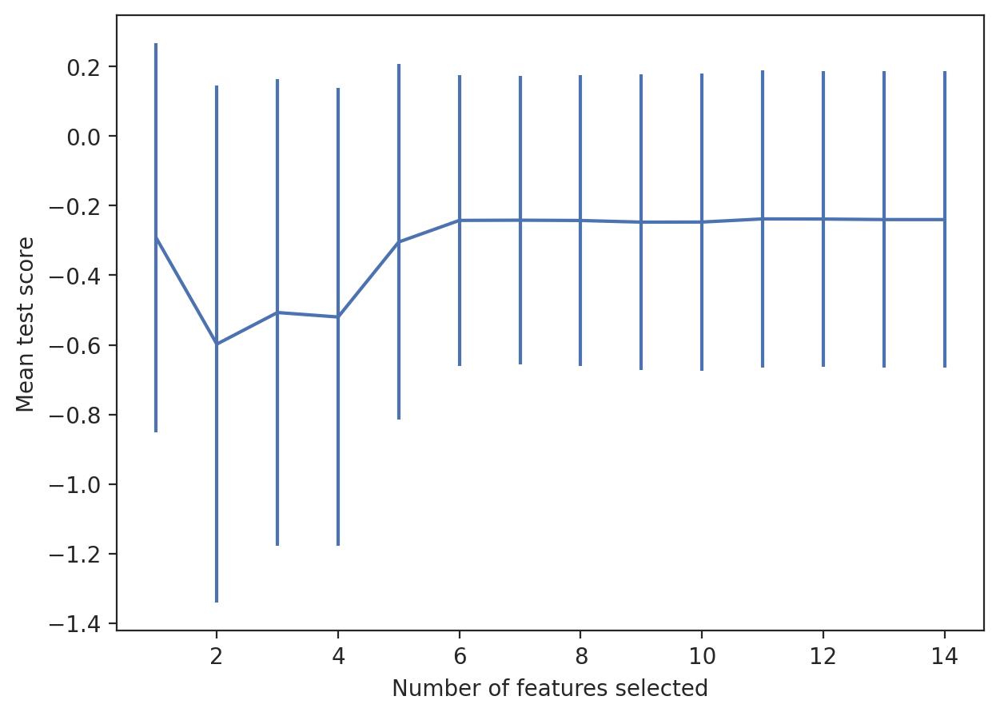

In [ ]:
fig, ax = plt.subplots(figsize=(7,5))
ax.errorbar(
    range(1, n_scores+1),
    lr_RFECV['feat_sel_RFECV'].cv_results_["mean_test_score"],
    yerr = lr_RFECV['feat_sel_RFECV'].cv_results_["std_test_score"],
)
ax.set_xlabel("Number of features selected")
ax.set_ylabel("Mean test score");

In [ ]:
#Phase 2 - RFECV - Polynomial Regression

In [ ]:
#Pipeline exclusive for the model: Linear Regression (with polynomial)
lr_poly_RFECV = regression_pipeline_RFECV(LinearRegression(), x_training_bpf,lin_model=False, poly_lin_model= True)

#Fitting the data to the pipeline exclusive for the model: Linear Regression (without polynomial)
lr_poly_RFECV.fit(x_training_bpf, y_training_bpf)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   MinMaxScaler()),
                                                                  ('poly',
                                                                   PolynomialFeatures(include_bias=False))]),
                                                  ['public_reference',
                                                   'mileage',
                                                   'year_of_registration',
                                                   'doors', 'seats',
                                                   'mileage_year']),
                                                 ('non_metric',
                                                  Pipeline(ste...
                                                                   TargetEncoder()),
                                                                  ('scaler',
                                                                   MinMaxScaler()),
                                                                  ('poly',
                                                                   PolynomialFeatures(include_bias=False))]),
                                                  ['reg_code',
                                                   'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type',
                                                   'crossover_car_and_van',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('feat_sel_RFECV', RFECV(cv=5, estimator=LinearRegression())),
                ('regressor', LinearRegression())])

In [ ]:
#Getting the prediction: Linear Regression (without polynomial)
y_pred_lr_poly_RFECV = lr_poly_RFECV.predict(x_training_bpf)
print(y_pred_lr_poly_RFECV)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(lr_poly_RFECV.score(x_training_bpf, y_training_bpf))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_lr_poly_RFECV = mean_absolute_error(y_training_bpf, y_pred_lr_poly_RFECV)
print(mae_lr_poly_RFECV)

#Coefficients (also called "weights")
  #Coefficients values
coefficients_lr_poly_RFECV = lr_poly_RFECV.named_steps['regressor'].coef_
print("Coefficients:", coefficients_lr_poly_RFECV)
  #Coefficients Shape
print("Coefficients:", coefficients_lr_poly_RFECV.shape)

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_lr_poly_RFECV = lr_poly_RFECV['feat_sel_RFECV'].get_feature_names_out()
print("Features:", features_lr_poly_RFECV)
  #Features Shape
print("Features:", features_lr_poly_RFECV.shape)

[19579.63370971 19938.14188573 30210.8708099  ... -1700.08670081
  4090.80997187   535.38836728]
0.738465234521227
6719.052302655105
Coefficients: [-50076156.69241302  49376485.48089556    513517.26628993
  52031805.72119135 -51510717.60901569  10973611.38574426]
Coefficients: (6,)
Features: ['mileage' 'mileage_year' 'mileage^2' 'mileage year_of_registration'
 'year_of_registration mileage_year' 'standard_model^2']
Features: (6,)


In [ ]:
#Dataframe of "Feature and Coefficients"
features_lr_poly_RFECV_df1 = pd.DataFrame(
    dict(
        features_lr_poly_RFECV = lr_poly_RFECV['feat_sel_RFECV'].get_feature_names_out(),
        coefficients_lr_poly_RFECV = lr_poly_RFECV.named_steps['regressor'].coef_
    ),
)
features_lr_poly_RFECV_df1

,features_lr_poly_RFECV,coefficients_lr_poly_RFECV
0,mileage,-5.007616e+07
1,mileage_year,4.937649e+07
2,mileage^2,5.135173e+05
3,mileage year_of_registration,5.203181e+07
4,year_of_registration mileage_year,-5.151072e+07
5,standard_model^2,1.097361e+07


In [ ]:
lr_poly_RFECV['feat_sel_RFECV'].transform(
    lr_poly_RFECV['transformations'].transform(x_training_bpf)
).head()

,mileage,mileage_year,mileage^2,mileage year_of_registration,year_of_registration mileage_year,standard_model^2
0,0.007800,0.007785,6.084012e-05,0.007528,0.007513,0.000052
1,0.064000,0.063937,4.096008e-03,0.060279,0.060219,0.000980
2,0.000005,0.031776,2.500005e-11,0.000005,0.030298,0.000127
3,0.047299,0.047229,2.237200e-03,0.045099,0.045032,0.000077
4,0.011961,0.011925,1.430658e-04,0.011822,0.011787,0.000438


In [ ]:
# should match the number of features
# The size of all values in cv_results_ is equal to:
  # ceil((n_features - min_features_to_select) / step) + 1 ;where:
    #"n_features" represents the total number of features or elements we're working with.
    #"step" is the number of features removed at each iteration.
    #"ceil": This takes the ceiling of the division result, ensuring that even fractional steps are rounded up to the nearest...
    #..whole number. This means that even if the division results in a fractional step, it's counted as a full step.
    #"min_features_to_select" is 1 (by default)

#The performance of the RFE selector are evaluated using "scorer" for different number of selected features and aggregated together.
  #Finally, the "scores" are averaged across folds and the number of features selected is set to the number of features that maximize...
  #...the cross-validation score.
#mean_test_score: Mean of scores over the folds.
#std_test_scoren: Standard deviation of scores over the folds.

#Number of scores = same number of original features (before to RFECV)
n_scores = len (lr_poly_RFECV['feat_sel_RFECV'].cv_results_['mean_test_score'])
print(n_scores)

#Scores
print(np.flip(lr_poly_RFECV['feat_sel_RFECV'].cv_results_['mean_test_score']))

71
[-6.04962571e+17 -1.57346923e+18 -1.22001339e+18 -3.38046813e+18
 -2.47510808e+18 -1.04407089e+18 -2.85521346e+18 -1.83405249e+17
 -1.38050157e+19 -8.12546293e+14 -3.86504499e+17 -2.30380441e+18
 -2.64775757e+18 -1.29686169e+18 -2.39052092e+18 -1.35825111e+18
 -4.22283145e+18 -1.52124843e+18 -2.06990772e+18 -1.72976571e+18
 -2.35204854e+18 -8.09393348e+16 -6.45520249e+18 -2.13703633e+18
 -1.51873406e+18 -1.90928147e+18 -1.75073028e+18 -1.28313909e+18
 -1.72306616e+18 -1.05862251e+18 -1.10383268e+18 -3.08302254e+18
 -1.99238719e+18 -1.04351745e+19 -1.97390772e+18 -3.59218266e+16
 -4.55399141e+17 -3.32968404e+17 -1.70226528e+18 -8.90449764e+17
 -6.27864027e+18 -2.21887181e+17 -3.30090496e+17 -7.92272345e+16
 -7.06730249e+17 -1.01121820e+19 -7.35442010e+18 -6.56360628e+17
 -5.46893627e+19 -1.51223466e+20 -1.14216489e+21 -4.72156092e+17
 -7.63864616e+17 -1.62255444e+19 -2.71394692e+19 -1.29178831e+19
 -5.52822772e+20 -2.30328173e+20 -2.03933389e+20 -2.28808138e+21
 -1.14964867e+20 -2.04

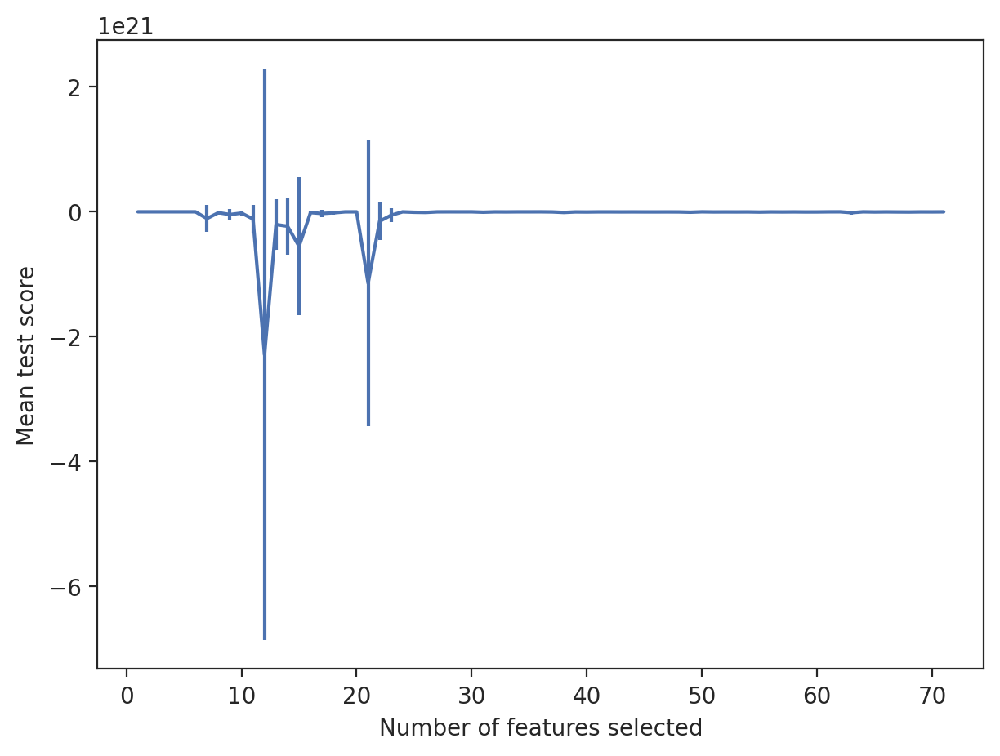

In [ ]:
fig, ax = plt.subplots(figsize=(7,5))
ax.errorbar(
    range(1, n_scores+1),
    lr_poly_RFECV['feat_sel_RFECV'].cv_results_["mean_test_score"],
    yerr = lr_poly_RFECV['feat_sel_RFECV'].cv_results_["std_test_score"],
)
ax.set_xlabel("Number of features selected")
ax.set_ylabel("Mean test score");

In [ ]:
#Phase 3 - RFECV - RandomForest

In [ ]:
#Pipeline exclusive for the model: Linear Regression (with polynomial)
rf_RFECV = regression_pipeline_RFECV(RandomForestRegressor(max_depth=2, random_state=21), x_training_bpf,lin_model=False, poly_lin_model= False)

#Fitting the data to the pipeline exclusive for the model: Linear Regression (without polynomial)
rf_RFECV.fit(x_training_bpf, y_training_bpf)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median'))]),
                                                  ['public_reference',
                                                   'mileage',
                                                   'year_of_registration',
                                                   'doors', 'seats',
                                                   'mileage_year']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder())]),
                                                  ['reg_code',
                                                   'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type',
                                                   'crossover_car_and_van',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('feat_sel_RFECV', RFECV(cv=5, estimator=LinearRegression())),
                ('regressor',
                 RandomForestRegressor(max_depth=2, random_state=21))])

In [ ]:
#Getting the prediction: Linear Regression (without polynomial)
y_pred_rf_RFECV = rf_RFECV.predict(x_training_bpf)
print(y_pred_rf_RFECV)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(rf_RFECV.score(x_training_bpf, y_training_bpf))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_rf_RFECV = mean_absolute_error(y_training_bpf, y_pred_rf_RFECV)
print(mae_rf_RFECV)

# In scikit-learn, certain models, such as linear models (e.g., LinearRegression, Ridge, Lasso) have coefficients because they represent linear relationships between features and the target variable. These coefficients indicate the magnitude and direction of the effect of each feature on the target variable.

# RandomForestRegressor, however, is a type of ensemble model based on decision trees. Unlike linear models, decision tree-based models do not have coefficients because they don't represent linear relationships. Instead, they make predictions by partitioning the feature space into regions and assigning an average (or other aggregation) of target values to each region.

# To assess feature importance in a RandomForestRegressor model, you can use the feature_importances_ attribute, which provides a relative measure of the importance of each feature in making predictions.


#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_rf_RFECV = rf_RFECV['feat_sel_RFECV'].get_feature_names_out()
print("Features:", features_rf_RFECV)
  #Features Shape
print("Features:", features_rf_RFECV.shape)

[15352.59528135 35907.11113185 15352.59528135 ... 15352.59528135
 15352.59528135 15352.59528135]
0.8093306504769662
8988.688334500843
Features: ['year_of_registration' 'doors' 'seats' 'mileage_year' 'standard_model'
 'body_type' 'crossover_car_and_van']
Features: (7,)


In [ ]:
#Dataframe of "Feature and Coefficients"
features_rf_RFECV_df1 = pd.DataFrame(
    dict(
        features_rf_RFECV = rf_RFECV['feat_sel_RFECV'].get_feature_names_out(),
    ),
)
features_rf_RFECV_df1

,features_rf_RFECV
0,year_of_registration
1,doors
2,seats
3,mileage_year
4,standard_model
5,body_type
6,crossover_car_and_van


In [ ]:
rf_RFECV['feat_sel_RFECV'].transform(
    rf_RFECV['transformations'].transform(x_training_bpf)
).head()

,year_of_registration,doors,seats,mileage_year,standard_model,body_type,crossover_car_and_van
0,2017.0,5.0,5.0,3.867129,10719.610998,22506.665734,17345.553165
1,2015.0,5.0,5.0,31.761787,42376.639629,22506.665734,17345.553165
2,2016.0,5.0,5.0,15.785218,16043.486877,22506.665734,17345.553165
3,2016.0,5.0,5.0,23.461806,12783.591704,22506.665734,17345.553165
4,2019.0,5.0,5.0,5.924220,28747.164148,22506.665734,17345.553165


In [ ]:
# should match the number of features
# The size of all values in cv_results_ is equal to:
  # ceil((n_features - min_features_to_select) / step) + 1 ;where:
    #"n_features" represents the total number of features or elements we're working with.
    #"step" is the number of features removed at each iteration.
    #"ceil": This takes the ceiling of the division result, ensuring that even fractional steps are rounded up to the nearest...
    #..whole number. This means that even if the division results in a fractional step, it's counted as a full step.
    #"min_features_to_select" is 1 (by default)

#The performance of the RFE selector are evaluated using "scorer" for different number of selected features and aggregated together.
  #Finally, the "scores" are averaged across folds and the number of features selected is set to the number of features that maximize...
  #...the cross-validation score.
#mean_test_score: Mean of scores over the folds.
#std_test_scoren: Standard deviation of scores over the folds.

#Number of scores = same number of original features (before to RFECV)
n_scores = len (rf_RFECV['feat_sel_RFECV'].cv_results_['mean_test_score'])
print(n_scores)

#Scores
print(np.flip(rf_RFECV['feat_sel_RFECV'].cv_results_['mean_test_score']))

14
[-0.23978235 -0.23976828 -0.23969736 -0.25016782 -0.25133742 -0.26193986
 -0.26288584 -0.03732682 -0.28271462 -0.29512774 -0.09857672 -0.13672895
 -0.22047746 -0.20351365]


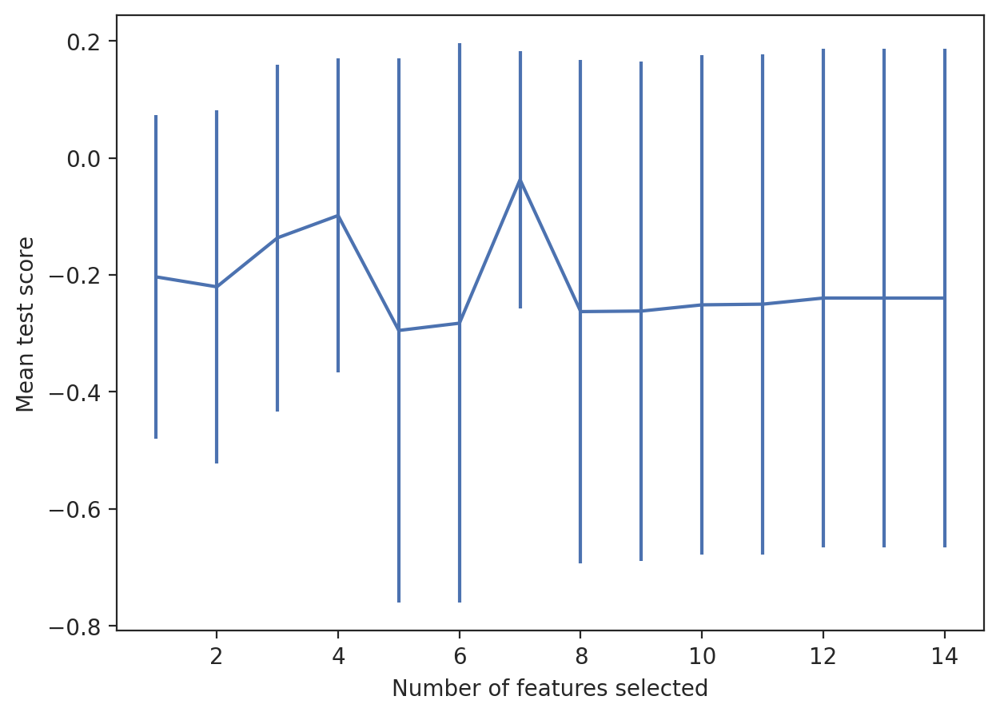

In [ ]:
fig, ax = plt.subplots(figsize=(7,5))
ax.errorbar(
    range(1, n_scores+1),
    rf_RFECV['feat_sel_RFECV'].cv_results_["mean_test_score"],
    yerr = rf_RFECV['feat_sel_RFECV'].cv_results_["std_test_score"],
)
ax.set_xlabel("Number of features selected")
ax.set_ylabel("Mean test score");

In [ ]:
#Phase 4 - RFECV - Boosted Tree

In [ ]:
#Pipeline exclusive for the model: Linear Regression (with polynomial)
bt_RFECV = regression_pipeline_RFECV(GradientBoostingRegressor(max_depth=2, random_state=21), x_training_bpf,lin_model=False, poly_lin_model= False)

#Fitting the data to the pipeline exclusive for the model: Linear Regression (without polynomial)
bt_RFECV.fit(x_training_bpf, y_training_bpf)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median'))]),
                                                  ['public_reference',
                                                   'mileage',
                                                   'year_of_registration',
                                                   'doors', 'seats',
                                                   'mileage_year']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder())]),
                                                  ['reg_code',
                                                   'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type',
                                                   'crossover_car_and_van',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('feat_sel_RFECV', RFECV(cv=5, estimator=LinearRegression())),
                ('regressor',
                 GradientBoostingRegressor(max_depth=2, random_state=21))])

In [ ]:
#Getting the prediction: Linear Regression (without polynomial)
y_pred_bt_RFECV = bt_RFECV.predict(x_training_bpf)
print(y_pred_bt_RFECV)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(bt_RFECV.score(x_training_bpf, y_training_bpf))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_bt_RFECV = mean_absolute_error(y_training_bpf, y_pred_bt_RFECV)
print(mae_bt_RFECV)

# In scikit-learn, certain models, such as linear models (e.g., LinearRegression, Ridge, Lasso) have coefficients because they represent linear relationships between features and the target variable. These coefficients indicate the magnitude and direction of the effect of each feature on the target variable.

# RandomForestRegressor, however, is a type of ensemble model based on decision trees. Unlike linear models, decision tree-based models do not have coefficients because they don't represent linear relationships. Instead, they make predictions by partitioning the feature space into regions and assigning an average (or other aggregation) of target values to each region.

# To assess feature importance in a RandomForestRegressor model, you can use the feature_importances_ attribute, which provides a relative measure of the importance of each feature in making predictions.

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_bt_RFECV = bt_RFECV['feat_sel_RFECV'].get_feature_names_out()
print("Features:", features_bt_RFECV)
  #Features Shape
print("Features:", features_bt_RFECV.shape)

[12737.90867648 28944.71141555 21539.72063789 ...  8589.37649719
  7726.47140331  5989.74965789]
0.9521897387889359
4007.6155263531614
Features: ['year_of_registration' 'doors' 'seats' 'mileage_year' 'standard_model'
 'body_type' 'crossover_car_and_van']
Features: (7,)


In [ ]:
#Dataframe of "Feature and Coefficients"
features_bt_RFECV_df1 = pd.DataFrame(
    dict(
        features_bt_RFECV = bt_RFECV['feat_sel_RFECV'].get_feature_names_out(),
    ),
)
features_bt_RFECV_df1

,features_bt_RFECV
0,year_of_registration
1,doors
2,seats
3,mileage_year
4,standard_model
5,body_type
6,crossover_car_and_van


In [ ]:
bt_RFECV['feat_sel_RFECV'].transform(
    bt_RFECV['transformations'].transform(x_training_bpf)
).head()

,year_of_registration,doors,seats,mileage_year,standard_model,body_type,crossover_car_and_van
0,2017.0,5.0,5.0,3.867129,10719.610998,22506.665734,17345.553165
1,2015.0,5.0,5.0,31.761787,42376.639629,22506.665734,17345.553165
2,2016.0,5.0,5.0,15.785218,16043.486877,22506.665734,17345.553165
3,2016.0,5.0,5.0,23.461806,12783.591704,22506.665734,17345.553165
4,2019.0,5.0,5.0,5.924220,28747.164148,22506.665734,17345.553165


In [ ]:
# should match the number of features
# The size of all values in cv_results_ is equal to:
  # ceil((n_features - min_features_to_select) / step) + 1 ;where:
    #"n_features" represents the total number of features or elements we're working with.
    #"step" is the number of features removed at each iteration.
    #"ceil": This takes the ceiling of the division result, ensuring that even fractional steps are rounded up to the nearest...
    #..whole number. This means that even if the division results in a fractional step, it's counted as a full step.
    #"min_features_to_select" is 1 (by default)

#The performance of the RFE selector are evaluated using "scorer" for different number of selected features and aggregated together.
  #Finally, the "scores" are averaged across folds and the number of features selected is set to the number of features that maximize...
  #...the cross-validation score.
#mean_test_score: Mean of scores over the folds.
#std_test_scoren: Standard deviation of scores over the folds.

#Number of scores = same number of original features (before to RFECV)
n_scores = len (bt_RFECV['feat_sel_RFECV'].cv_results_['mean_test_score'])
print(n_scores)

#Scores
print(np.flip(bt_RFECV['feat_sel_RFECV'].cv_results_['mean_test_score']))

14
[-0.23978235 -0.23976828 -0.23969736 -0.25016782 -0.25133742 -0.26193986
 -0.26288584 -0.03732682 -0.28271462 -0.29512774 -0.09857672 -0.13672895
 -0.22047746 -0.20351365]


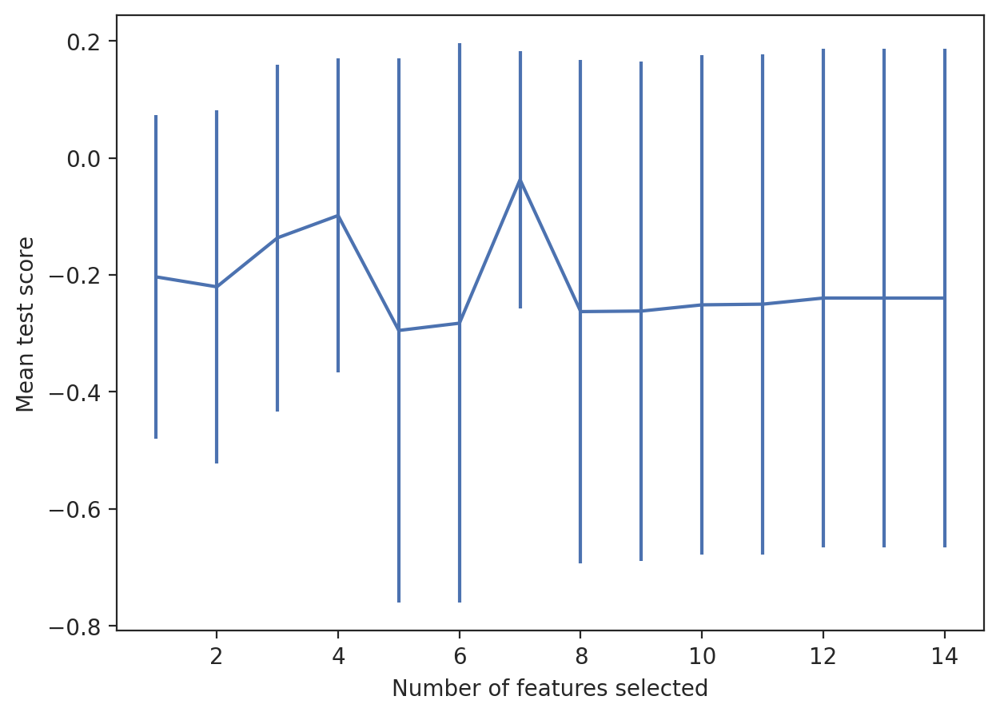

In [ ]:
fig, ax = plt.subplots(figsize=(7,5))
ax.errorbar(
    range(1, n_scores+1),
    bt_RFECV['feat_sel_RFECV'].cv_results_["mean_test_score"],
    yerr = bt_RFECV['feat_sel_RFECV'].cv_results_["std_test_score"],
)
ax.set_xlabel("Number of features selected")
ax.set_ylabel("Mean test score");

## **6.5. SEQUENTIAL FEATURE SELECTOR (SFS)**

* **Goal**: choose features using a method that starts with an empty set of features and iteratively adds or removes features (also called "forward or/and backward selection") based on the model's performance (i.e. it ranks the features based on the model's performance). Finally, it captures multivariate relationships.

In [ ]:
#Data
data_c5 = data_c4.copy()
data_c5.info()

#Training Set
  # X
x_training_bpf = data_c5.drop(['price'], axis=1)

  # Y
y_training_bpf = data_c5['price']

<class 'pandas.core.frame.DataFrame'>
Int64Index: 241204 entries, 0 to 241203
Data columns (total 15 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   public_reference       241204 non-null  int64  
 1   mileage                241132 non-null  float64
 2   reg_code               222161 non-null  object 
 3   standard_colour        237947 non-null  object 
 4   standard_make          241204 non-null  object 
 5   standard_model         241204 non-null  object 
 6   vehicle_condition      241204 non-null  object 
 7   year_of_registration   221271 non-null  float64
 8   price                  241204 non-null  int64  
 9   body_type              240702 non-null  object 
 10  crossover_car_and_van  241204 non-null  object 
 11  fuel_type              240839 non-null  object 
 12  doors                  241204 non-null  int64  
 13  seats                  241204 non-null  int64  
 14  mileage_year           221210 non-nu

In [ ]:
#Phase 1 - SFS - Linear Regression

In [ ]:
from sklearn.feature_selection import SequentialFeatureSelector

In [ ]:
#Function that define the "pipeline" for models (of course this pipeline has inside the pipeline of feature transformation)
  #<---The same for all models. It will make easier the evaluation

  #Sequential Feature Selector adds (forward selection) features to form a feature subset in a greedy fashion.
    #At each stage, this "estimator" (i.e., the model that could be "linear, random forest, boosted trees") chooses the best feature to...
    #...add or remove based on the cross-validation score of an "estimator".

    #"n_features_to_select": If "auto", the behaviour depends on the "tol" parameter.
    #tol: float; If the score is not incremented by at least "tol" between two consecutive feature additions or removals, stop adding or removing.
      #"tol" does not represent a percentage (%)
      #"tol" stands for "tolerance" and specifies the threshold for the stopping criteria during the search for the optimal subset of features.
      #If the improvement in the "scoring metric" (specified by the scoring parameter [MAE, RMSE, MSE,...]) is less than the value of "tol",...
      #... the search stops, considering that the improvement is not significant enough to continue.
      #"tol": is an absolute value that determines the minimum improvement required in the scoring metric"..
      #...(specified by the scoring parameter [MAE, RMSE, MSE,...]) to continue the feature selection process. I

def regression_pipeline_SFS(estimator_model, X, lin_model=False, poly_lin_model= False):

    reg_pipeline = Pipeline(
        steps=[
            ("transformations", transformer_pipeline(X, lin_model, poly_lin_model)),
            ("feat_sel_SFS", SequentialFeatureSelector(LinearRegression(), n_features_to_select='auto', direction="forward", tol=0.01)),
            ("regressor", estimator_model),
        ]
    )

    #Output: Pipeline ({transformation/preprocessing of the data} + {model})
    return reg_pipeline

In [ ]:
#Pipeline exclusive for the model: Linear Regression (without polynomial)
lr_SFS = regression_pipeline_SFS(LinearRegression(), x_training_bpf,lin_model=True, poly_lin_model= False)

#Fitting the data to the pipeline exclusive for the model: Linear Regression (without polynomial)
lr_SFS.fit(x_training_bpf, y_training_bpf)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['public_reference',
                                                   'mileage',
                                                   'year_of_registration',
                                                   'doors', 'seats',
                                                   'mileage_year']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_freq...
                                                                   TargetEncoder()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['reg_code',
                                                   'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type',
                                                   'crossover_car_and_van',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('feat_sel_SFS',
                 SequentialFeatureSelector(estimator=LinearRegression(),
                                           n_features_to_select='auto',
                                           tol=0.01)),
                ('regressor', LinearRegression())])

In [ ]:
#Getting the prediction: Linear Regression (without polynomial)
y_pred_lr_SFS = lr_SFS.predict(x_training_bpf)
print(y_pred_lr_SFS)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(lr_SFS.score(x_training_bpf, y_training_bpf))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_lr_SFS = mean_absolute_error(y_training_bpf, y_pred_lr_SFS)
print(mae_lr_SFS)

#Coefficients (also called "weights")
  #Coefficients values
coefficients_lr_SFS = lr_SFS.named_steps['regressor'].coef_
print("Coefficients:", coefficients_lr_SFS)
  #Coefficients Shape
print("Coefficients:", coefficients_lr_SFS.shape)

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_lr_SFS = lr_SFS['feat_sel_SFS'].get_feature_names_out()
print("Features:", features_lr_SFS)
  #Features Shape
print("Features:", features_lr_SFS.shape)

[21384.09284597 30036.77927849 28041.2338964  ... -5922.42797321
  9773.71689691 -2273.89083229]
0.13278673774812488
6272.995600357252
Coefficients: [-344010.25544067  266595.33302572   50847.38482173  270715.44177777
   13012.99555491   11787.62986417]
Coefficients: (6,)
Features: ['mileage' 'mileage_year' 'reg_code' 'standard_make' 'body_type'
 'fuel_type']
Features: (6,)


In [ ]:
#Dataframe of "Feature and Coefficients"
features_lr_SFS_df1 = pd.DataFrame(
    dict(
        features_lr_SFS = lr_SFS['feat_sel_SFS'].get_feature_names_out(),
        coefficients_lr_SFS = lr_SFS.named_steps['regressor'].coef_
    ),
)
features_lr_SFS_df1

,features_lr_SFS,coefficients_lr_SFS
0,mileage,-344010.255441
1,mileage_year,266595.333026
2,reg_code,50847.384822
3,standard_make,270715.441778
4,body_type,13012.995555
5,fuel_type,11787.629864


In [ ]:
#"lr_RFECV['feat_sel_RFECV']" = piece of code that execute the Feature Selection using RFECV
#"lr_RFECV['transformations'].transform(x_training_bpf)" = it shows us the data "transformed/preprocessed" and only the features selected through RFECV

lr_SFS['feat_sel_SFS'].transform(
    lr_SFS['transformations'].transform(x_training_bpf)
).head()

,mileage,mileage_year,reg_code,standard_make,body_type,fuel_type
0,0.007800,0.007785,0.245302,0.037568,0.252565,0.079607
1,0.064000,0.063937,0.083941,0.116493,0.252565,0.067300
2,0.000005,0.031776,0.245302,0.029164,0.252565,0.067300
3,0.047299,0.047229,0.108840,0.029164,0.252565,0.067300
4,0.011961,0.011925,0.229512,0.077974,0.252565,1.000000


In [ ]:
#Phase 2 - RFECV - Polynomial Regression

In [ ]:
#Pipeline exclusive for the model: Linear Regression (with polynomial)
lr_poly_SFS = regression_pipeline_SFS(LinearRegression(), x_training_bpf,lin_model=False, poly_lin_model= True)

#Fitting the data to the pipeline exclusive for the model: Linear Regression (without polynomial)
lr_poly_SFS.fit(x_training_bpf, y_training_bpf)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   MinMaxScaler()),
                                                                  ('poly',
                                                                   PolynomialFeatures(include_bias=False))]),
                                                  ['public_reference',
                                                   'mileage',
                                                   'year_of_registration',
                                                   'doors', 'seats',
                                                   'mileage_year']),
                                                 ('non_metric',
                                                  Pipeline(ste...
                                                                   PolynomialFeatures(include_bias=False))]),
                                                  ['reg_code',
                                                   'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type',
                                                   'crossover_car_and_van',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('feat_sel_SFS',
                 SequentialFeatureSelector(estimator=LinearRegression(),
                                           n_features_to_select='auto',
                                           tol=0.01)),
                ('regressor', LinearRegression())])

In [ ]:
#Getting the prediction: Linear Regression (without polynomial)
y_pred_lr_poly_SFS = lr_poly_SFS.predict(x_training_bpf)
print(y_pred_lr_poly_SFS)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(lr_poly_SFS.score(x_training_bpf, y_training_bpf))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_lr_poly_SFS = mean_absolute_error(y_training_bpf, y_pred_lr_poly_SFS)
print(mae_lr_poly_SFS)

#Coefficients (also called "weights")
  #Coefficients values
coefficients_lr_poly_SFS = lr_poly_SFS.named_steps['regressor'].coef_
print("Coefficients:", coefficients_lr_poly_SFS)
  #Coefficients Shape
print("Coefficients:", coefficients_lr_poly_SFS.shape)

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_lr_poly_SFS = lr_poly_SFS['feat_sel_SFS'].get_feature_names_out()
print("Features:", features_lr_poly_SFS)
  #Features Shape
print("Features:", features_lr_poly_SFS.shape)

[16570.19936787 24705.35721738 20810.35529002 ...  3080.70245322
 15995.22865309 10192.92396718]
0.7696606998806073
4446.380663018759
Coefficients: [ -92843.27575785  230125.51180564 3472485.37915236 9651004.21414952]
Coefficients: (4,)
Features: ['mileage doors' 'reg_code standard_make' 'reg_code standard_model'
 'standard_model^2']
Features: (4,)


In [ ]:
#Dataframe of "Feature and Coefficients"
features_lr_poly_SFS_df1 = pd.DataFrame(
    dict(
        features_lr_poly_SFS = lr_poly_SFS['feat_sel_SFS'].get_feature_names_out(),
        coefficients_lr_poly_SFS = lr_poly_SFS.named_steps['regressor'].coef_
    ),
)
features_lr_poly_SFS_df1

,features_lr_poly_SFS,coefficients_lr_poly_SFS
0,mileage doors,-9.284328e+04
1,reg_code standard_make,2.301255e+05
2,reg_code standard_model,3.472485e+06
3,standard_model^2,9.651004e+06


In [ ]:
special_poly_lr_df=lr_poly_SFS['feat_sel_SFS'].transform(
    lr_poly_SFS['transformations'].transform(x_training_bpf)
)
special_poly_lr_df

,mileage doors,reg_code standard_make,reg_code standard_model,standard_model^2
0,0.005850,0.009216,0.001773,0.000052
1,0.048000,0.009778,0.002628,0.000980
2,0.000004,0.007154,0.002767,0.000127
3,0.035474,0.003174,0.000958,0.000077
4,0.008971,0.017896,0.004806,0.000438
...,...,...,...,...
241199,0.000055,0.013247,0.020633,0.003590
241200,0.048524,0.008544,0.002427,0.000098
241201,0.096500,0.001815,0.000614,0.000120
241202,0.051500,0.007128,0.002760,0.000127


In [ ]:
special_poly_lr_df.drop(['mileage doors'], axis=1,inplace=True)

In [ ]:
#Phase 3 - RFECV - RandomForest

In [ ]:
#Pipeline exclusive for the model: Linear Regression (with polynomial)
rf_SFS = regression_pipeline_SFS(RandomForestRegressor(max_depth=2, random_state=21), x_training_bpf,lin_model=False, poly_lin_model= False)

#Fitting the data to the pipeline exclusive for the model: Linear Regression (without polynomial)
rf_SFS.fit(x_training_bpf, y_training_bpf)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median'))]),
                                                  ['public_reference',
                                                   'mileage',
                                                   'year_of_registration',
                                                   'doors', 'seats',
                                                   'mileage_year']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetE...())]),
                                                  ['reg_code',
                                                   'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type',
                                                   'crossover_car_and_van',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('feat_sel_SFS',
                 SequentialFeatureSelector(estimator=LinearRegression(),
                                           n_features_to_select='auto',
                                           tol=0.01)),
                ('regressor',
                 RandomForestRegressor(max_depth=2, random_state=21))])

In [ ]:
#Getting the prediction: Linear Regression (without polynomial)
y_pred_rf_SFS = rf_SFS.predict(x_training_bpf)
print(y_pred_rf_SFS)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(rf_SFS.score(x_training_bpf, y_training_bpf))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_rf_SFS = mean_absolute_error(y_training_bpf, y_pred_rf_SFS)
print(mae_rf_SFS)

# In scikit-learn, certain models, such as linear models (e.g., LinearRegression, Ridge, Lasso) have coefficients because they represent linear relationships between features and the target variable. These coefficients indicate the magnitude and direction of the effect of each feature on the target variable.

# RandomForestRegressor, however, is a type of ensemble model based on decision trees. Unlike linear models, decision tree-based models do not have coefficients because they don't represent linear relationships. Instead, they make predictions by partitioning the feature space into regions and assigning an average (or other aggregation) of target values to each region.

# To assess feature importance in a RandomForestRegressor model, you can use the feature_importances_ attribute, which provides a relative measure of the importance of each feature in making predictions.


#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_rf_SFS = rf_SFS['feat_sel_SFS'].get_feature_names_out()
print("Features:", features_rf_SFS)
  #Features Shape
print("Features:", features_rf_SFS.shape)

[26024.67194134 18721.70799282 26024.67194134 ... 13062.03225456
 13062.03225456 13062.03225456]
0.1237158765291192
8712.167492603383
Features: ['mileage' 'mileage_year' 'reg_code' 'standard_make' 'body_type'
 'fuel_type']
Features: (6,)


In [ ]:
#Dataframe of "Feature and Coefficients"
features_rf_SFS_df1 = pd.DataFrame(
    dict(
        features_rf_SFS = rf_SFS['feat_sel_SFS'].get_feature_names_out(),
    ),
)
features_rf_SFS_df1

,features_rf_SFS
0,mileage
1,mileage_year
2,reg_code
3,standard_make
4,body_type
5,fuel_type


In [ ]:
rf_SFS['feat_sel_SFS'].transform(
    rf_SFS['transformations'].transform(x_training_bpf)
).head()

,mileage,mileage_year,reg_code,standard_make,body_type,fuel_type
0,7800.0,3.867129,24985.438376,13734.552871,22506.665734,16818.492400
1,64000.0,31.761787,11765.292625,35584.701048,22506.665734,16500.810844
2,5.0,15.785218,24985.438376,11407.733288,22506.665734,16500.810844
3,47299.0,23.461806,13805.296486,11407.733288,22506.665734,16500.810844
4,11961.0,5.924220,23691.779245,24920.769242,22506.665734,40575.911084


In [ ]:
#TEST - OUTPUT (lin, rf):
#R^2=0.1237158765291192
#MAE = 8712.167492603383
#feat = 6

#TEST - OUTPUT (rf, rf):
#R^2= 0.020466201061132838
#MAE = 10188.875294049692
#feat = 1 ['body_type']



In [ ]:
#Phase 4 - RFECV - Boosted Tree

In [ ]:
#Function that define the "pipeline" for models (of course this pipeline has inside the pipeline of feature transformation)
  #<---The same for all models. It will make easier the evaluation

  #Sequential Feature Selector adds (forward selection) features to form a feature subset in a greedy fashion.
    #At each stage, this "estimator" (i.e., the model that could be "linear, random forest, boosted trees") chooses the best feature to...
    #...add or remove based on the cross-validation score of an "estimator".

    #"n_features_to_select": If "auto", the behaviour depends on the "tol" parameter.
    #tol: float; If the score is not incremented by at least "tol" between two consecutive feature additions or removals, stop adding or removing.
      #"tol" does not represent a percentage (%)
      #"tol" stands for "tolerance" and specifies the threshold for the stopping criteria during the search for the optimal subset of features.
      #If the improvement in the "scoring metric" (specified by the scoring parameter [MAE, RMSE, MSE,...]) is less than the value of "tol",...
      #... the search stops, considering that the improvement is not significant enough to continue.
      #"tol": is an absolute value that determines the minimum improvement required in the scoring metric"..
      #...(specified by the scoring parameter [MAE, RMSE, MSE,...]) to continue the feature selection process.

In [ ]:
#Pipeline exclusive for the model: Linear Regression (with polynomial)
bt_SFS = regression_pipeline_SFS(GradientBoostingRegressor(max_depth=2, random_state=21), x_training_bpf,lin_model=False, poly_lin_model= False)

#Fitting the data to the pipeline exclusive for the model: Linear Regression (without polynomial)
bt_SFS.fit(x_training_bpf, y_training_bpf)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median'))]),
                                                  ['public_reference',
                                                   'mileage',
                                                   'year_of_registration',
                                                   'doors', 'seats',
                                                   'mileage_year']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetE...),
                                                  ['reg_code',
                                                   'standard_colour',
                                                   'standard_make',
                                                   'standard_model',
                                                   'vehicle_condition',
                                                   'body_type',
                                                   'crossover_car_and_van',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('feat_sel_SFS',
                 SequentialFeatureSelector(estimator=LinearRegression(),
                                           n_features_to_select='auto',
                                           tol=0.01)),
                ('regressor',
                 GradientBoostingRegressor(max_depth=2, random_state=21))])

In [ ]:
#Getting the prediction: Linear Regression (without polynomial)
y_pred_bt_SFS = bt_SFS.predict(x_training_bpf)
print(y_pred_bt_SFS)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(bt_SFS.score(x_training_bpf, y_training_bpf))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_bt_SFS = mean_absolute_error(y_training_bpf, y_pred_bt_SFS)
print(mae_bt_SFS)

# In scikit-learn, certain models, such as linear models (e.g., LinearRegression, Ridge, Lasso) have coefficients because they represent linear relationships between features and the target variable. These coefficients indicate the magnitude and direction of the effect of each feature on the target variable.

# RandomForestRegressor, however, is a type of ensemble model based on decision trees. Unlike linear models, decision tree-based models do not have coefficients because they don't represent linear relationships. Instead, they make predictions by partitioning the feature space into regions and assigning an average (or other aggregation) of target values to each region.

# To assess feature importance in a RandomForestRegressor model, you can use the feature_importances_ attribute, which provides a relative measure of the importance of each feature in making predictions.

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_bt_SFS = bt_SFS['feat_sel_SFS'].get_feature_names_out()
print("Features:", features_bt_SFS)
  #Features Shape
print("Features:", features_bt_SFS.shape)

[21164.77159811 22074.24141172 26630.5727648  ...  3764.04320306
 10084.26291638  1847.46418868]
0.3162544627612156
4962.54108351096
Features: ['mileage' 'mileage_year' 'reg_code' 'standard_make' 'body_type'
 'fuel_type']
Features: (6,)


In [ ]:
#Dataframe of "Feature and Coefficients"
features_bt_SFS_df1 = pd.DataFrame(
    dict(
        features_bt_SFS = bt_SFS['feat_sel_SFS'].get_feature_names_out(),
    ),
)
features_bt_SFS_df1

,features_bt_SFS
0,mileage
1,mileage_year
2,reg_code
3,standard_make
4,body_type
5,fuel_type


In [ ]:
bt_SFS['feat_sel_SFS'].transform(
    bt_SFS['transformations'].transform(x_training_bpf)
).head()

,mileage,mileage_year,reg_code,standard_make,body_type,fuel_type
0,7800.0,3.867129,24985.438376,13734.552871,22506.665734,16818.492400
1,64000.0,31.761787,11765.292625,35584.701048,22506.665734,16500.810844
2,5.0,15.785218,24985.438376,11407.733288,22506.665734,16500.810844
3,47299.0,23.461806,13805.296486,11407.733288,22506.665734,16500.810844
4,11961.0,5.924220,23691.779245,24920.769242,22506.665734,40575.911084


## **6.6. MAIN SUMMARY OF FEATURE SELECTION**

In [ ]:
#MOST IMPORTANT FEATURES PER MODEL
#MANUAL
#Linear Regression
features_lr_m_df2 = pd.DataFrame(
    dict(
        features_lr_m = lr_m['transformations'].get_feature_names_out(),
    ),
)
features_lr_m_df2.rename(columns = {'features_lr_m':'features'}, inplace = True)

# #Polynomial
features_lr_poly_m_df2 = pd.DataFrame(
    dict(
        features_lr_poly_m = lr_poly_m['transformations'].get_feature_names_out(),
    ),
)
features_lr_poly_m_df2.rename(columns = {'features_lr_poly_m':'features'}, inplace = True)

#Random Forest
features_rf_m_df2 = pd.DataFrame(
    dict(
        features_rf_m = rf_m['transformations'].get_feature_names_out(),
    ),
)
features_rf_m_df2.rename(columns = {'features_rf_m':'features'}, inplace = True)

#Boosted Tree
features_bt_m_df2 = pd.DataFrame(
    dict(
        features_bt_m = bt_m['transformations'].get_feature_names_out(),
    ),
)
features_bt_m_df2.rename(columns = {'features_bt_m':'features'}, inplace = True)

# ##################################################################################################
#KBEST
#Linear Regression
features_lr_k_best_df2 = pd.DataFrame(
    dict(
        features_lr_k_best = lr_k_best['feat_sel_k'].get_feature_names_out(),
    ),
)
features_lr_k_best_df2.rename(columns = {'features_lr_k_best':'features'}, inplace = True)

#Polynomial
features_lr_poly_k_best_df2 = pd.DataFrame(
    dict(
        features_lr_poly_k_best = lr_poly_k_best['feat_sel_k'].get_feature_names_out(),
    ),
)
features_lr_poly_k_best_df2.rename(columns = {'features_lr_poly_k_best':'features'}, inplace = True)

#Random Forest
features_rf_k_best_df2 = pd.DataFrame(
    dict(
        features_rf_k_best = rf_k_best['feat_sel_k'].get_feature_names_out(),
    ),
)
features_rf_k_best_df2.rename(columns = {'features_rf_k_best':'features'}, inplace = True)

#Boosted Tree
features_bt_k_best_df2 = pd.DataFrame(
    dict(
        features_bt_k_best = bt_k_best['feat_sel_k'].get_feature_names_out(),
    ),
)
features_bt_k_best_df2.rename(columns = {'features_bt_k_best':'features'}, inplace = True)

# ###################################################################################################
#RFECV
#Linear Regression
features_lr_RFECV_df2 = pd.DataFrame(
    dict(
        features_lr_RFECV = lr_RFECV['feat_sel_RFECV'].get_feature_names_out(),
    ),
)
features_lr_RFECV_df2.rename(columns = {'features_lr_RFECV':'features'}, inplace = True)

#Polynomial
features_lr_poly_RFECV_df2 = pd.DataFrame(
    dict(
        features_lr_poly_RFECV = lr_poly_RFECV['feat_sel_RFECV'].get_feature_names_out(),
    ),
)
features_lr_poly_RFECV_df2.rename(columns = {'features_lr_poly_RFECV':'features'}, inplace = True)

#Random Forest
features_rf_RFECV_df2 = pd.DataFrame(
    dict(
        features_rf_RFECV = rf_RFECV['feat_sel_RFECV'].get_feature_names_out(),
    ),
)
features_rf_RFECV_df2.rename(columns = {'features_rf_RFECV':'features'}, inplace = True)

#Boosted Tree
features_bt_RFECV_df2 = pd.DataFrame(
    dict(
        features_bt_RFECV = bt_RFECV['feat_sel_RFECV'].get_feature_names_out(),
    ),
)
features_bt_RFECV_df2.rename(columns = {'features_bt_RFECV':'features'}, inplace = True)

# ###################################################################################################
# #SFS
#Linear Regression
features_lr_SFS_df2 = pd.DataFrame(
    dict(
        features_lr_SFS = lr_SFS['feat_sel_SFS'].get_feature_names_out(),
    ),
)
features_lr_SFS_df2.rename(columns = {'features_lr_SFS':'features'}, inplace = True)

#Polynomial
features_lr_poly_SFS_df2 = pd.DataFrame(
    dict(
        features_lr_poly_SFS = lr_poly_SFS['feat_sel_SFS'].get_feature_names_out(),
    ),
)
features_lr_poly_SFS_df2.rename(columns = {'features_lr_poly_SFS':'features'}, inplace = True)

#Random Forest
features_rf_SFS_df2 = pd.DataFrame(
    dict(
        features_rf_SFS = rf_SFS['feat_sel_SFS'].get_feature_names_out(),
    ),
)
features_rf_SFS_df2.rename(columns = {'features_rf_SFS':'features'}, inplace = True)

#Boosted Tree
features_bt_SFS_df2 = pd.DataFrame(
    dict(
        features_bt_SFS = bt_SFS['feat_sel_SFS'].get_feature_names_out(),
    ),
)
features_bt_SFS_df2.rename(columns = {'features_bt_SFS':'features'}, inplace = True)

In [ ]:
#ORGANIZATION PER TECHNIQUE
#DATAFRAME CONCATENATION - MANUAL
features_m_frequency = pd.concat([features_lr_m_df2,
                                  features_lr_poly_m_df2,
                                  features_rf_m_df2,
                                  features_bt_m_df2],
                                  axis=0 )

###################################################################################################
#DATAFRAME CONCATENATION - KBEST
features_k_best_frequency = pd.concat([features_lr_k_best_df2,
                                  features_lr_poly_k_best_df2,
                                  features_rf_k_best_df2,
                                  features_bt_k_best_df2],
                                  axis=0 )
###################################################################################################
#DATAFRAME CONCATENATION - RFECV
features_RFECV_frequency = pd.concat([features_lr_RFECV_df2,
                                  features_lr_poly_RFECV_df2,
                                  features_rf_RFECV_df2,
                                  features_bt_RFECV_df2],
                                  axis=0 )

###################################################################################################
#DATAFRAME CONCATENATION - SFS
features_SFS_frequency = pd.concat([features_lr_SFS_df2,
                                  features_lr_poly_SFS_df2,
                                  features_rf_SFS_df2,
                                  features_bt_SFS_df2],
                                  axis=0 )

In [ ]:
#ORGANIZATION PER TECHNIQUE - COUNT
value_counts_features_m_frequency = features_m_frequency['features'].value_counts()[0:14]

value_counts_features_k_best_frequency = features_k_best_frequency['features'].value_counts()[0:8]

value_counts_features_RFECV_frequency = features_RFECV_frequency['features'].value_counts()[0:7]

value_counts_features_SFS_frequency = features_SFS_frequency['features'].value_counts()[0:6]

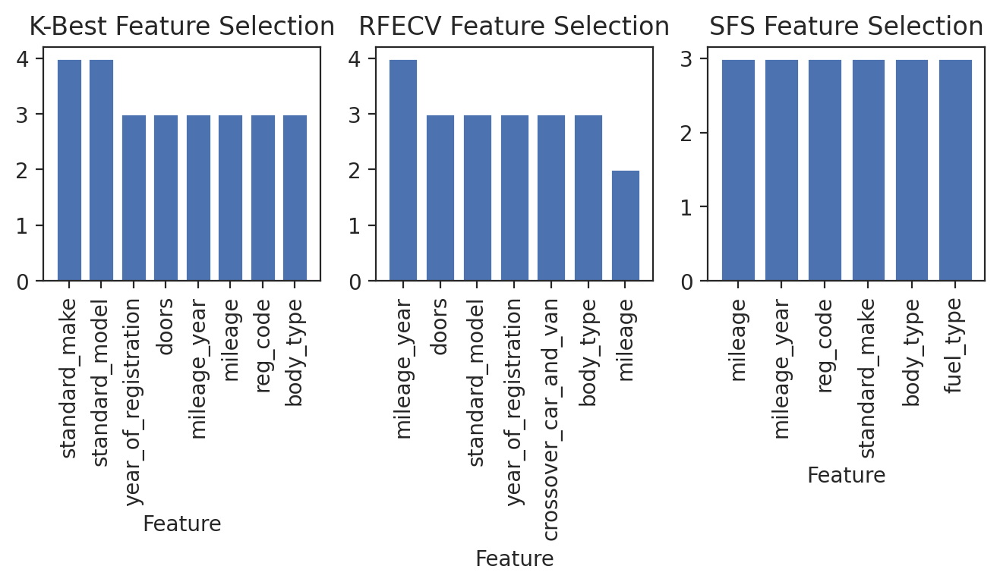

In [ ]:
# Create a figure with 3 subplots
fig, axes = plt.subplots(1, 3, figsize=(8, 2))

# Plot the second bar plot
axes[0].bar(value_counts_features_k_best_frequency.index, value_counts_features_k_best_frequency.values)
axes[0].set_title('K-Best Feature Selection')
axes[0].set_xlabel('Feature')
axes[0].tick_params(axis='x', rotation=90)

# Plot the third bar plot
axes[1].bar(value_counts_features_RFECV_frequency.index, value_counts_features_RFECV_frequency.values)
axes[1].set_title('RFECV Feature Selection')
axes[1].set_xlabel('Feature')
axes[1].tick_params(axis='x', rotation=90)

# Plot the fourth bar plot
axes[2].bar(value_counts_features_SFS_frequency.index, value_counts_features_SFS_frequency.values)
axes[2].set_title('SFS Feature Selection')
axes[2].set_xlabel('Feature')
axes[2].tick_params(axis='x', rotation=90)

# Display the plot
plt.show()

In [ ]:
#ORGANIZATION PER MODEL
#DATAFRAME CONCATENATION - LINEAR
features_lr_frequency = pd.concat([features_lr_k_best_df2,
                                  features_lr_RFECV_df2,
                                  features_lr_SFS_df2],
                                  axis=0 )

###################################################################################################
#DATAFRAME CONCATENATION - POLYNOMIAL
features_lr_poly_frequency = pd.concat([features_lr_poly_k_best_df2,
                                  features_lr_poly_RFECV_df2,
                                  features_lr_poly_SFS_df2],
                                  axis=0 )


###################################################################################################
#DATAFRAME CONCATENATION - RANDOM FOREST
features_rf_frequency = pd.concat([features_rf_k_best_df2,
                                  features_rf_RFECV_df2,
                                  features_rf_SFS_df2],
                                  axis=0 )


###################################################################################################
#DATAFRAME CONCATENATION - BOOSTED TREE
features_bt_frequency = pd.concat([features_bt_k_best_df2,
                                  features_bt_RFECV_df2,
                                  features_bt_SFS_df2],
                                  axis=0 )

In [ ]:
#ORGANIZATION PER TECHNIQUE - COUNT
value_counts_features_lr_frequency = features_lr_frequency['features'].value_counts()[0:9]

value_counts_features_lr_poly_frequency = features_lr_poly_frequency['features'].value_counts()[0:3]

value_counts_features_rf_frequency = features_rf_frequency['features'].value_counts()[0:8]

value_counts_features_bt_frequency = features_bt_frequency['features'].value_counts()[0:8]

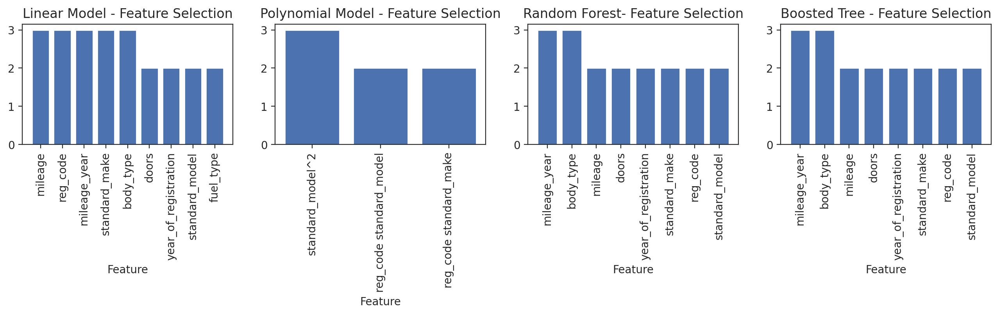

In [ ]:
# Create a figure with 3 subplots
fig, axes = plt.subplots(1, 4, figsize=(16, 2))

# Plot the second bar plot
axes[0].bar(value_counts_features_lr_frequency.index, value_counts_features_lr_frequency.values)
axes[0].set_title('Linear Model - Feature Selection')
axes[0].set_xlabel('Feature')
axes[0].tick_params(axis='x', rotation=90)

# Plot the second bar plot
axes[1].bar(value_counts_features_lr_poly_frequency.index, value_counts_features_lr_poly_frequency.values)
axes[1].set_title('Polynomial Model - Feature Selection')
axes[1].set_xlabel('Feature')
axes[1].tick_params(axis='x', rotation=90)

# Plot the third bar plot
axes[2].bar(value_counts_features_rf_frequency.index, value_counts_features_rf_frequency.values)
axes[2].set_title('Random Forest- Feature Selection')
axes[2].set_xlabel('Feature')
axes[2].tick_params(axis='x', rotation=90)

# Plot the fourth bar plot
axes[3].bar(value_counts_features_bt_frequency.index, value_counts_features_bt_frequency.values)
axes[3].set_title('Boosted Tree - Feature Selection')
axes[3].set_xlabel('Feature')
axes[3].tick_params(axis='x', rotation=90)

# Display the plot
plt.show()

# **7. MODEL BUILDING, EVALUATION, ANALYSIS (PERFORMANCE) - PART 1**

* **Training Phase** / **Validation Phase** (tune the hyperparameters and select the best model configuration) / **Test Phase** (evaluate the performance and test generalization)

  * Linear Model
  * Polynomial Model
  * Random Forest
  * Boosted Tree

Model  | Main Property | Pros | Cons |
-------|----------|-----------|------------|
**Linear**      | Capture linear relationships. |$\uparrow$ Interpretability $\downarrow$ Overfit. | Struggle with complex non-linear relationships. Perform better with smaller datasets and fewer features. |
**Polynomial**      | Capture non-linear relationships. | $\uparrow, \downarrow$ Interpretability (more flexible than linear models) | $\uparrow$ Overfit. May struggle with extrapolation. |
**Random Forest**      | Capture complex non-linear relationships. | $\downarrow$ Overfit (robust to noise). | $\downarrow$ Interpretability (harder to interpret than individual decision trees). Slower to train. |
**Boosted Tree**      | Great predictive performance. | Outperform Random Forests. | $\uparrow$ Overfit. More complex to tune and train |
**Voter Ensemble**      | Great predictive performance. | Outperform Random Forests. | $\uparrow$ Overfit. More complex to tune and train |

## **7.1. LINEAR MODEL**

* **Important:** The "Linear Model" for the "Training Phase" will be developed using the regularization method called "Elastic Net".

* **Important:** Elastic Net: model that fit the data as good as possible but at the same time it keeps the weights as small as possible (i.e., keeping a balance between "bias" produced by L1 and "variance" produced by L2).

* **Important:**  Elastic Net mixes the regularization term L1 and L2 (i.e., it mixes "penalty terms") in the "Cost Function", where:
  * L1: LASSO (Least Absolute Shrinkage and Selection Operator)
  * L2: Ridge Regression

* **L1**:
  * It shrinks the coefficients of the features towards zero (i.e., it does perform "feature selection").
  * It does struggle with "multicollinearity".
  * It has stronger bias, compared to L2.

* **L2**: It shrinks the coefficients of the features towards zero but does not set any of them exactly to zero (i.e., it does not perform "feature selection").
  * It does not struggle with "multicollinearity".
  * It has stronger variance, compared to L1.

In [ ]:
#TRAINING PHASE - DATA DEFINITION

#Data definition for the Training Phase
  #data_c4 = training dataset (before applying "polynomial" and before applying "feature selection")
  #data_c6 = Copy (back-up dataset)
data_c6 = data_c4.copy()

#Training dataset
  # Independent Features X

  #Training dataset for Linear Model
    #This dataset for the independent features X (alsco called "x_training_data_lr_after_fs") will be prepared considering...
    #...the features selected in the section 6. FEATURE SELECTION AND DIMENSIONALITY REDUCTION
x_training_data_lr_after_fs = data_c6[["mileage",
                                      "mileage_year",
                                      "reg_code",
                                      "standard_make",
                                      "body_type",
                                      "year_of_registration",
                                      "doors",
                                      "standard_model",
                                      "fuel_type"]]

  #Training dataset for Polynomial Model
    #This dataset for the independent features X (alsco called "special_poly_lr_df") was prepared considering...
    #...the features selected in the section 6. FEATURE SELECTION AND DIMENSIONALITY REDUCTION
special_poly_lr_df

  #Training dataset for Random Forest
    #This dataset for the independent features X (alsco called "x_training_data_rf_after_fs") was prepared considering...
    #...the features selected in the section 6. FEATURE SELECTION AND DIMENSIONALITY REDUCTION
x_training_data_rf_after_fs = data_c6[["mileage",
                                      "mileage_year",
                                      "reg_code",
                                      "standard_make",
                                      "body_type",
                                      "year_of_registration",
                                      "doors",
                                      "standard_model"]]

#Training dataset for Boosted Forest
    #This dataset for the independent features X (alsco called "x_training_data_bt_after_fs") was prepared considering...
    #...the features selected in the section 6. FEATURE SELECTION AND DIMENSIONALITY REDUCTION
x_training_data_bt_after_fs = data_c6[["mileage",
                                      "mileage_year",
                                      "reg_code",
                                      "standard_make",
                                      "body_type",
                                      "year_of_registration",
                                      "doors",
                                      "standard_model"]]

#Training dataset
  # Dependent Feature (also celled "Target Value") Y
  #This is the same dataset for all models (Linear Model,Polynomial Model,Random Forest,Boosted Forest) during the training phase.
y_training_data_after_fs = data_c4['price']

In [ ]:
#TRAINING PHASE - PIPELINE / TRANSFORMATION DEFINITION (PART 1)

#This apply for all models (Linear Model,Polynomial Model,Random Forest,Boosted Forest) during the training phase.

#Function that define the "pipeline" for feature transformation
def transformer_pipeline(X, lin_model=False, poly_lin_model= False):

    #metric features transformations (valid for: Linear Model, Random Forest, Boosted Tree)
    metric_features = X.select_dtypes(exclude='object').columns.tolist()
    metric_transformer = Pipeline(
        steps=[
            ("imputer", SimpleImputer(strategy="median")),
        ]
    )

    #non-metric features transformations (valid for: Linear Model, Random Forest, Boosted Tree)
    non_metric_features = X.select_dtypes(include='object').columns.tolist()
    non_metric_transformer = Pipeline(
        steps=[
            ("imputer", SimpleImputer(strategy="most_frequent")),
            ("encoder", TargetEncoder())
        ]
    )

    #Preprocessor (valid for: Linear Model, Random Forest, Boosted Tree)
    transformer_features = ColumnTransformer(
        transformers=[
            ("metric", metric_transformer, metric_features),
            ("non_metric", non_metric_transformer, non_metric_features),
        ],
        remainder='passthrough',
        verbose_feature_names_out=False
    )

    #Preprocessor (valid for: Linear model. More transformations: scaling)
    if lin_model:
        metric_transformer.steps.extend([
            ("scaler", MinMaxScaler()),
        ])
        non_metric_transformer.steps.extend([
            ("scaler", MinMaxScaler())
        ])

    #Preprocessor (valid for: Polynomial Linear model. More transformations: scaling + polynomial features)
    if poly_lin_model:
        metric_transformer.steps.extend([
            ("scaler", MinMaxScaler()),
            ('poly', PolynomialFeatures(2, include_bias=False))
        ])
        non_metric_transformer.steps.extend([
            ("scaler", MinMaxScaler()),
            ('poly', PolynomialFeatures(2, include_bias=False))
        ])

    #Output: Pipeline ({transformation/preprocessing of the data})
    return transformer_features

In [ ]:
#TRAINING PHASE - PIPELINE / TRANSFORMATION DEFINITION (PART 2)

#This apply for all models (Linear Model,Polynomial Model,Random Forest,Boosted Forest) during the training phase.

#Training Phase
#Function that define the "pipeline" for models (of course this pipeline has inside the pipeline of feature transformation)
def regression_pipeline(estimator_model, X, lin_model=False, poly_lin_model= False):

    reg_pipeline = Pipeline(
        steps=[
            ("transformations", transformer_pipeline(X, lin_model, poly_lin_model)),
            ("regressor", estimator_model)
        ]
    )

    #Output: Pipeline ({transformation/preprocessing of the data} + {model})
    return reg_pipeline

In [ ]:
#TRAINING PHASE - PIPELINE / TRANSFORMATION DEFINITION (PART 3)

#This apply for all models (Linear Model,Polynomial Model,Random Forest,Boosted Forest) during the training phase.

#Model Training
from sklearn.linear_model import ElasticNet

training_lr = regression_pipeline(ElasticNet(), x_training_data_lr_after_fs, lin_model=True, poly_lin_model= False)

#This case is special, considering that we got previously (in the Section 6. FEATURE SELECTION AND DIMENSIONALITY REDUCTION the specific features that work really well in the "Polynomial Model")
  #The features for the "Polynomial Model" have been already transformed; therefore, the arguments "lin_model=False, poly_lin_model= False" are both set to "False" avoiding scaling again those features.
training_lr_poly = regression_pipeline(LinearRegression(), special_poly_lr_df, lin_model=False, poly_lin_model= False)

training_rf = regression_pipeline(RandomForestRegressor(max_depth=5, random_state=21), x_training_data_rf_after_fs, lin_model=False, poly_lin_model= False)

training_bt = regression_pipeline(GradientBoostingRegressor(max_depth=5, random_state=21), x_training_data_bt_after_fs, lin_model=False, poly_lin_model= False)

training_models_1 = [ training_lr]
training_models_2 = [ training_lr_poly]
training_models_3 = [ training_rf]
training_models_4 = [ training_bt]

In [ ]:
#TRAINING PHASE - LINEAR REGRESSION (WITH CROSS VALIDATION)

#Model Training (Linear)
model_results_list_1 = []

for my_model_1 in training_models_1:
  eval_results = cross_validate(
      my_model_1, x_training_data_lr_after_fs, y_training_data_after_fs, cv=5,
      scoring='neg_mean_absolute_error',
      return_train_score=True
  )
model_results_list_1.append(
(eval_results['test_score'].mean(), eval_results['test_score'].std(),
eval_results['train_score'].mean(), eval_results['train_score'].std())
)

model_results_1 = pd.DataFrame(
    model_results_list_1,
    columns=['test_mae_mean', 'test_mae_std', 'train_mae_mean','train_mae_std'],index=['training_lr']
    )

model_results_1

,test_mae_mean,test_mae_std,train_mae_mean,train_mae_std
training_lr,-10929.129525,1691.7087,-10624.612699,861.99197


In [ ]:
#TRAINING PHASE - LINEAR REGRESSION (WITHOUT CROSS VALIDATION) (PART 1)

#Pipeline exclusive for the model: Linear Regression (without polynomial)
lr_train = regression_pipeline(ElasticNet(), x_training_data_lr_after_fs, lin_model=True, poly_lin_model= False)

#Fitting the data to the pipeline exclusive for the model: Linear Regression (without polynomial)
lr_train.fit(x_training_data_lr_after_fs, y_training_data_after_fs)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['mileage', 'mileage_year',
                                                   'year_of_registration',
                                                   'doors']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['reg_code', 'standard_make',
                                                   'body_type',
                                                   'standard_model',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('regressor', ElasticNet())])

In [ ]:
#TRAINING PHASE - LINEAR REGRESSION (WITHOUT CROSS VALIDATION) (PART 2)

#Getting the prediction: Linear Regression (without polynomial)
y_pred_lr_train = lr_train.predict(x_training_data_lr_after_fs)
print(y_pred_lr_train)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(lr_train.score(x_training_data_lr_after_fs, y_training_data_after_fs))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_lr_train = mean_absolute_error(y_training_data_after_fs, y_pred_lr_train)
print(mae_lr_train)

#Coefficients (also called "weights")
  #Coefficients values
coefficients_lr_train = lr_train.named_steps['regressor'].coef_
print("Coefficients:", coefficients_lr_train)
  #Coefficients Shape
print("Coefficients:", coefficients_lr_train.shape)

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_lr_train = lr_train['transformations'].get_feature_names_out()
print("Features:", features_lr_train)
  #Features Shape
print("Features:", features_lr_train.shape)

[17543.34658635 17398.73682686 17509.34333449 ... 17263.06521958
 17615.78490269 18222.76159682]
0.0063687037043286265
10729.707713473757
Coefficients: [ -507.54880863  -427.20259281   457.08653587 -2031.34124729
  1479.44056048  1893.26641864  2137.12250502   714.84213548
   761.93375411]
Coefficients: (9,)
Features: ['mileage' 'mileage_year' 'year_of_registration' 'doors' 'reg_code'
 'standard_make' 'body_type' 'standard_model' 'fuel_type']
Features: (9,)


In [ ]:
#TRAINING PHASE - LINEAR REGRESSION (WITHOUT CROSS VALIDATION) (PART 3)

#Dataframe of "Feature and Coefficients"
features_lr_train_df1 = pd.DataFrame(
    dict(
        features_lr_train = lr_train['transformations'].get_feature_names_out(),
        coefficients_lr_train = lr_train.named_steps['regressor'].coef_
    ),
)
features_lr_train_df1

,features_lr_train,coefficients_lr_train
0,mileage,-507.548809
1,mileage_year,-427.202593
2,year_of_registration,457.086536
3,doors,-2031.341247
4,reg_code,1479.440560
5,standard_make,1893.266419
6,body_type,2137.122505
7,standard_model,714.842135
8,fuel_type,761.933754


In [ ]:
#TRAINING PHASE - LINEAR REGRESSION (WITHOUT CROSS VALIDATION) (PART 4)

#Dataframe after the transformation of the data.
lr_train['transformations'].transform(x_training_data_lr_after_fs).head()

,mileage,mileage_year,year_of_registration,doors,reg_code,standard_make,body_type,standard_model,fuel_type
0,0.007800,0.007785,0.965116,0.75,0.245302,0.037568,0.252565,0.007230,0.079607
1,0.064000,0.063937,0.941860,0.75,0.083941,0.116493,0.252565,0.031304,0.067300
2,0.000005,0.031776,0.953488,0.75,0.245302,0.029164,0.252565,0.011278,0.067300
3,0.047299,0.047229,0.953488,0.75,0.108840,0.029164,0.252565,0.008799,0.067300
4,0.011961,0.011925,0.988372,0.75,0.229512,0.077974,0.252565,0.020939,1.000000


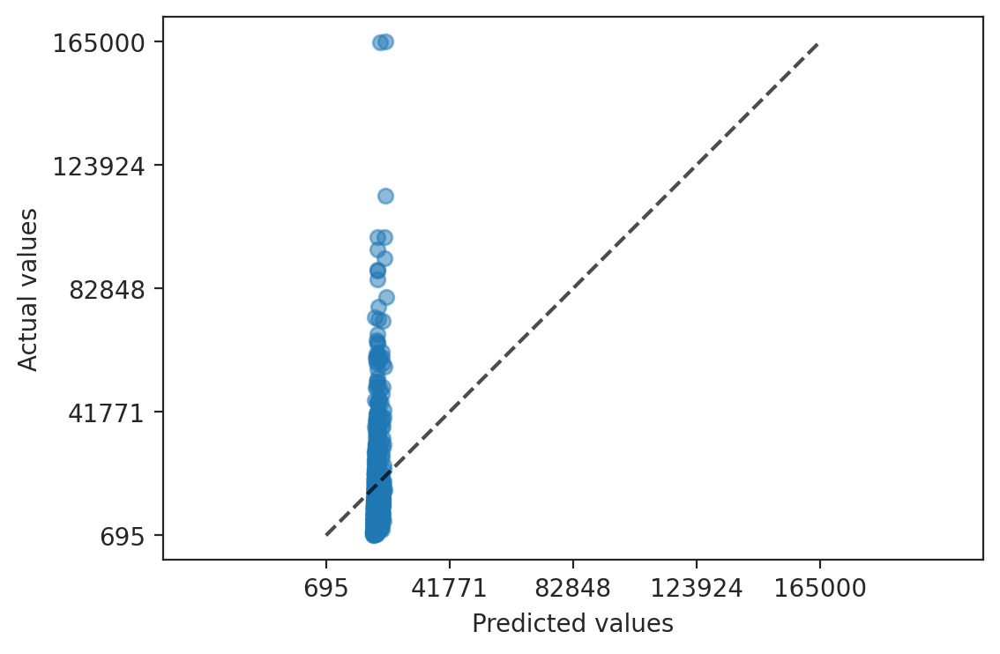

In [ ]:
#TRAINING PHASE - LINEAR REGRESSION (WITHOUT CROSS VALIDATION) (PART 5)

PredictionErrorDisplay.from_estimator(
    lr_train, x_training_data_lr_after_fs, y_training_data_after_fs, kind="actual_vs_predicted", scatter_kwargs=dict(alpha=0.5), subsample = 1000,random_state = 286
);

In [ ]:
#VALIDATION PHASE - DATA DEFINITION (PART 1)

#Data definition for the Validation Phase
  #X_Val_1, Y_Val_1 = validation dataset (original)
  #X_Val_2, Y_Val_2 = Copy (back-up dataset)

X_Val_1 = ValSet.drop(['price'], axis=1)
Y_Val_1 = ValSet['price']

X_Val_2 = X_Val_1.copy()
Y_Val_2 = Y_Val_1.copy()

In [ ]:
#VALIDATION PHASE - DATA DEFINITION (PART 2)

#Setting the index as an additional column in the same dataframe
X_Val_2['index'] = X_Val_2.index

#Deriving features based on domain knowledge according to the procedure done in the section 4. DATA PROCESSING

  # Getting the list of the unique values of the variables "body_type"
X_Val_2_uni_body_type = X_Val_2[['body_type']].drop_duplicates()

  #Based on the variables "body_type" & domain knowledge, the dataframe is the following:
car_knowledge_Val = [['SUV', 5, 5],
        ['Hatchback', 5, 5],
        ['Convertible', 2, 4],
        ['Limousine', 6, 10],
        ['Saloon', 4, 5],
        ['Coupe', 2, 4],
        ['MPV', 5, 6],
        ['Estate', 5, 5],
        ['Pickup', 4, 5],
        ['Panel Van', 5, 5],
        ['Minibus', 5, 8],
        ['Combi Van', 5, 5],
        ['Window Van', 4, 12],
        ['Camper', 4, 5],
        [None, 4, 5],#this special item is for the instances that ar NaN in the variable "body_type"
        ['Chassis Cab', 2, 2]]

  # Create pandas DataFrame for the variables derived from "body_type" & domain knowledge,
car_knowledge_Val_df = pd.DataFrame(car_knowledge_Val, columns=['body_type', 'doors', "seats"])
car_knowledge_Val_df

  #Merging the "validation set" & "domain knowledge dataframe"
X_Val_3 = pd.merge(X_Val_2, car_knowledge_Val_df, on="body_type")

In [ ]:
#VALIDATION PHASE - DATA DEFINITION (PART 3)

#Deriving features

  #Deriving a new feature
X_Val_3["mileage_year"] = X_Val_3["mileage"] / X_Val_3["year_of_registration"]

#Setting the column "index" as index of the dataframe "X_Val_3"
X_Val_3 = X_Val_3.set_index('index')

#Merging the independent (X) and dependent features (Y) based on the index
XY_Val_4 = pd.merge(X_Val_3, Y_Val_2, left_index=True, right_index=True, how='outer')

#Splitting the independent (X) and dependent feature (Y)
X_Val_4 = XY_Val_4.drop(['price'], axis=1)
Y_Val_4 = XY_Val_4['price']

In [ ]:
#VALIDATION PHASE - DATA DEFINITION (PART 4)

  # Independent Features X

  #Validation dataset for Linear Model
    #This dataset for the independent features X (alsco called "x_training_data_lr_after_fs") will be prepared considering...
    #...the features selected in the section 6. FEATURE SELECTION AND DIMENSIONALITY REDUCTION
x_validation_data_lr_after_fs = X_Val_4[["mileage",
                                      "mileage_year",
                                      "reg_code",
                                      "standard_make",
                                      "body_type",
                                      "year_of_registration",
                                      "doors",
                                      "standard_model",
                                      "fuel_type"]]

  #Validation dataset for Polynomial Model
    #This dataset for the independent features X (also called "X_transformed_poly_lr_val_df2") was prepared considering...
    #...the features selected in the section 6. FEATURE SELECTION AND DIMENSIONALITY REDUCTION
#X_transformed_poly_lr_val_df2

  #Validation dataset for Random Forest
    #This dataset for the independent features X (alsco called "x_training_data_rf_after_fs") was prepared considering...
    #...the features selected in the section 6. FEATURE SELECTION AND DIMENSIONALITY REDUCTION
x_validation_rf_after_fs = X_Val_4[["mileage",
                                      "mileage_year",
                                      "reg_code",
                                      "standard_make",
                                      "body_type",
                                      "year_of_registration",
                                      "doors",
                                      "standard_model"]]

#Validation dataset for Boosted Forest
    #This dataset for the independent features X (alsco called "x_training_data_bt_after_fs") was prepared considering...
    #...the features selected in the section 6. FEATURE SELECTION AND DIMENSIONALITY REDUCTION
x_validation_bt_after_fs = X_Val_4[["mileage",
                                      "mileage_year",
                                      "reg_code",
                                      "standard_make",
                                      "body_type",
                                      "year_of_registration",
                                      "doors",
                                      "standard_model"]]

#Validation dataset
  # Dependent Feature (also celled "Target Value") Y
  #This is the same dataset for all models (Linear Model,Polynomial Model,Random Forest,Boosted Forest) during the Validation phase.
y_validation_after_fs = Y_Val_4.copy()

In [ ]:
#VALIDATION PHASE - PIPELINE / TRANSFORMATION DEFINITION (PART 1)

#This apply for all models (Linear Model,Polynomial Model,Random Forest,Boosted Forest) during the validation phase.

#Function that define the "pipeline" for feature transformation
def transformer_pipeline(X, lin_model=False, poly_lin_model= False):

    #metric features transformations (valid for: Linear Model, Random Forest, Boosted Tree)
    metric_features = X.select_dtypes(exclude='object').columns.tolist()
    metric_transformer = Pipeline(
        steps=[
            ("imputer", SimpleImputer(strategy="median")),
        ]
    )

    #non-metric features transformations (valid for: Linear Model, Random Forest, Boosted Tree)
    non_metric_features = X.select_dtypes(include='object').columns.tolist()
    non_metric_transformer = Pipeline(
        steps=[
            ("imputer", SimpleImputer(strategy="most_frequent")),
            ("encoder", TargetEncoder())
        ]
    )

    #Preprocessor (valid for: Linear Model, Random Forest, Boosted Tree)
    transformer_features = ColumnTransformer(
        transformers=[
            ("metric", metric_transformer, metric_features),
            ("non_metric", non_metric_transformer, non_metric_features),
        ],
        remainder='passthrough',
        verbose_feature_names_out=False
    )

    #Preprocessor (valid for: Linear model. More transformations: scaling)
    if lin_model:
        metric_transformer.steps.extend([
            ("scaler", MinMaxScaler()),
        ])
        non_metric_transformer.steps.extend([
            ("scaler", MinMaxScaler())
        ])

    #Preprocessor (valid for: Polynomial Linear model. More transformations: scaling + polynomial features)
    if poly_lin_model:
        metric_transformer.steps.extend([
            ("scaler", MinMaxScaler()),
            ('poly', PolynomialFeatures(2, include_bias=False))
        ])
        non_metric_transformer.steps.extend([
            ("scaler", MinMaxScaler()),
            ('poly', PolynomialFeatures(2, include_bias=False))
        ])

    #Output: Pipeline ({transformation/preprocessing of the data})
    return transformer_features

In [ ]:
#VALIDATION PHASE - PIPELINE / TRANSFORMATION DEFINITION (PART 2)

#Function that define the "pipeline" for models (of course this pipeline has inside the pipeline of feature transformation)
def regression_pipeline_val(estimator_model, X, param_grid, lin_model=False, poly_lin_model= False):

    reg_pipeline = Pipeline(
        steps=[
            ("transformations", transformer_pipeline(X, lin_model, poly_lin_model)),
            ("regressor", estimator_model)
        ]
    )

    #Output: Pipeline ({transformation/preprocessing of the data} + {model})
    return reg_pipeline

In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 1)

lr_grid = dict(regressor__alpha=[0.1, 1, 10], regressor__l1_ratio=[0, 0.5, 1])

from sklearn.model_selection import GridSearchCV

lr_gridsearch_cv = GridSearchCV(
    regression_pipeline_val(ElasticNet(), x_validation_data_lr_after_fs, lr_grid, lin_model=True, poly_lin_model=False),
    lr_grid,
    cv=5,
    scoring='neg_mean_absolute_error',
    return_train_score=True,
    n_jobs=-1,
    error_score='raise',
)
lr_gridsearch_cv

GridSearchCV(cv=5, error_score='raise',
             estimator=Pipeline(steps=[('transformations',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('metric',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='median')),
                                                                                         ('scaler',
                                                                                          MinMaxScaler())]),
                                                                         ['mileage',
                                                                          'mileage_year',
                                                                          'year_of_registration',
                                                                          'doors']),
                                                                        ('non_metric',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImpute...ost_frequent')),
                                                                                         ('encoder',
                                                                                          TargetEncoder()),
                                                                                         ('scaler',
                                                                                          MinMaxScaler())]),
                                                                         ['reg_code',
                                                                          'standard_make',
                                                                          'body_type',
                                                                          'standard_model',
                                                                          'fuel_type'])],
                                                          verbose_feature_names_out=False)),
                                       ('regressor', ElasticNet())]),
             n_jobs=-1,
             param_grid={'regressor__alpha': [0.1, 1, 10],
                         'regressor__l1_ratio': [0, 0.5, 1]},
             return_train_score=True, scoring='neg_mean_absolute_error')

In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 2)

gs_results_lr = lr_gridsearch_cv.fit(x_validation_data_lr_after_fs, y_validation_after_fs)

gs_lr_df = pd.DataFrame(gs_results_lr.cv_results_)

gs_lr_df[ [
'param_regressor__alpha',
'param_regressor__l1_ratio', "mean_train_score",'std_train_score','mean_test_score',
 'std_test_score', 'rank_test_score'
] ].sort_values('rank_test_score')

,param_regressor__alpha,param_regressor__l1_ratio,mean_train_score,std_train_score,mean_test_score,std_test_score,rank_test_score
1,0.1,0.5,-8381.666746,211.042408,-8389.721759,243.192445,1
0,0.1,0,-9085.494190,167.266752,-9092.228643,251.875797,2
4,1,0.5,-10341.214399,111.210428,-10343.441967,268.391533,3
3,1,0,-10608.921922,102.326727,-10609.766534,268.872250,4
7,10,0.5,-10858.323949,98.494493,-10858.508430,267.189484,5
8,10,1,-10719.324726,2343.179634,-10881.286485,2063.367162,6
6,10,0,-10891.830389,98.535026,-10891.896596,266.874085,7
5,1,1,-11180.403221,2503.090142,-11344.522491,2231.525905,8
2,0.1,1,-11229.079704,2518.637895,-11394.140959,2248.039138,9


In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 3)

  #Best parameters of the Validation Phase (Cross Validation)
gs_results_lr.best_params_

{'regressor__alpha': 0.1, 'regressor__l1_ratio': 0.5}

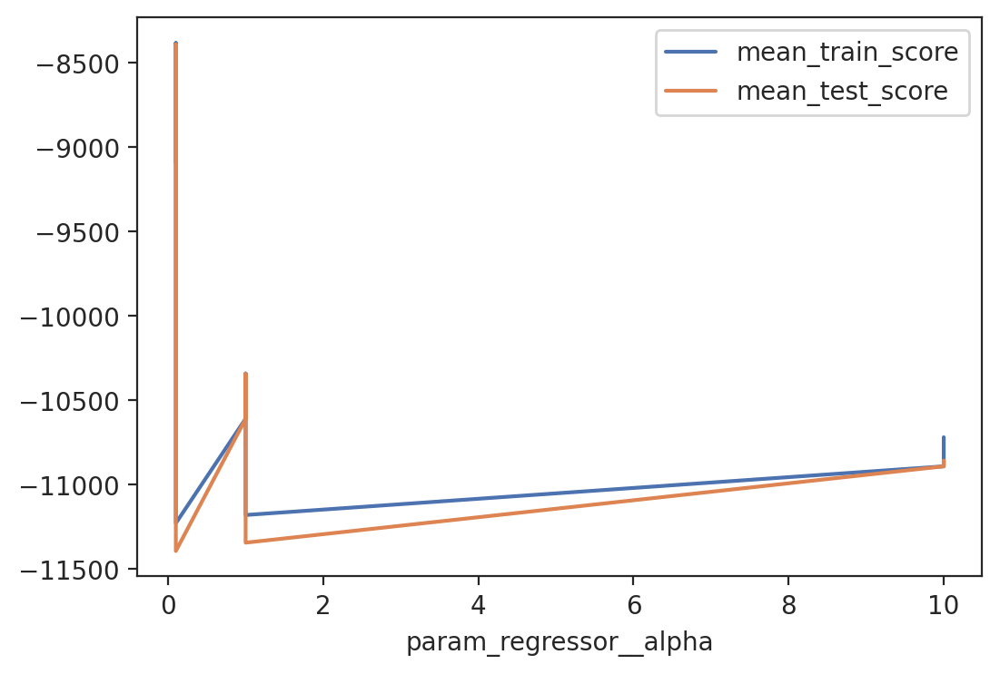

In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 4)

  #Graph of on of the best parameters of the Validation Phase (Cross Validation)
gs_lr_df.set_index('param_regressor__alpha')[['mean_train_score','mean_test_score']].plot.line();

In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 5)

  #Best Linear Model (during the Validation Phase)
best_model_lin_regression = gs_results_lr.best_estimator_
best_model_lin_regression

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['mileage', 'mileage_year',
                                                   'year_of_registration',
                                                   'doors']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['reg_code', 'standard_make',
                                                   'body_type',
                                                   'standard_model',
                                                   'fuel_type'])],
                                   verbose_feature_names_out=False)),
                ('regressor', ElasticNet(alpha=0.1))])

In [ ]:
#VALIDATION PHASE - DATA DEFINITION (PART 5)

  #This step is useful to derive the terms that are going to be used for Polynomial
# Access the "transformations steps" (called by me a as "transformations") from the "best estimator" (called "best_model_lin_regression")
transformations = best_model_lin_regression.named_steps['transformations']

# Transform the input data (i.e., the independet features) using the transformations steps
X_transformed_lr_val = transformations.transform(x_validation_data_lr_after_fs)

# Convert the transformed data to a DataFrame
X_transformed_lr_val_df = pd.DataFrame(X_transformed_lr_val, columns=x_validation_data_lr_after_fs.columns)
X_transformed_lr_val_df

,mileage,mileage_year,reg_code,standard_make,body_type,year_of_registration,doors,standard_model,fuel_type
0,0.000000,0.034323,0.582032,0.057385,0.298929,0.996082,0.75,0.028549,0.952533
7,0.106452,0.106081,0.177352,0.083830,0.298929,0.993144,0.75,0.038778,0.117315
12,0.005124,0.005091,0.648509,0.026471,0.145090,0.999021,0.75,0.008295,0.118513
13,0.019585,0.019459,0.566680,0.024889,0.000000,0.999021,0.75,0.008661,0.118513
14,0.033908,0.033723,0.582032,0.023255,0.000000,0.997062,0.75,0.007506,0.118513
...,...,...,...,...,...,...,...,...,...
401993,0.047312,0.047101,0.241307,0.395404,0.224299,0.995103,0.50,0.016127,0.118513
401994,0.019857,0.019749,0.359129,0.024268,0.298929,0.997062,0.75,0.010047,0.118513
401998,0.093632,0.093772,0.079531,0.019606,0.000000,0.983350,0.75,0.005141,0.118513
401999,0.080357,0.080237,0.029878,0.021136,0.000000,0.989226,0.75,0.006397,0.118513


In [ ]:
#VALIDATION PHASE - DATA DEFINITION (PART 6)

#Polynomial features that were gotten according to feature selection in the section 6.FEATURE SELECTION AND DIMENSIONALITY REDUCTION
  # reg_code * standard_make
  # reg_code * standard_model
  # standard_model^2
X_transformed_poly_lr_val_df = X_transformed_lr_val_df.copy()

  #Deriving new features
X_transformed_poly_lr_val_df["reg_code_standard_make"] = X_transformed_poly_lr_val_df["reg_code"] * X_transformed_poly_lr_val_df["standard_make"]
X_transformed_poly_lr_val_df["reg_code_standard_model"] = X_transformed_poly_lr_val_df["reg_code"] * X_transformed_poly_lr_val_df["standard_model"]
X_transformed_poly_lr_val_df["standard_model^2"] = X_transformed_poly_lr_val_df["standard_model"] **2

X_transformed_poly_lr_val_df2 = X_transformed_poly_lr_val_df[['reg_code_standard_make', 'reg_code_standard_model', 'standard_model^2']]

print(X_transformed_poly_lr_val_df2)
X_transformed_poly_lr_val_df2.head(1)

  #Information of the dataframe (after adding the new features)
X_transformed_poly_lr_val_df2.info()

        reg_code_standard_make  reg_code_standard_model  standard_model^2
0                     0.033400                 0.016617          0.000815
7                     0.014867                 0.006877          0.001504
12                    0.017166                 0.005380          0.000069
13                    0.014104                 0.004908          0.000075
14                    0.013535                 0.004369          0.000056
...                        ...                      ...               ...
401993                0.095414                 0.003892          0.000260
401994                0.008715                 0.003608          0.000101
401998                0.001559                 0.000409          0.000026
401999                0.000631                 0.000191          0.000041
402004                0.010713                 0.002249          0.000089

[80400 rows x 3 columns]
<class 'pandas.core.frame.DataFrame'>
Int64Index: 80400 entries, 0 to 402004
Data colu

In [ ]:
#TEST PHASE - DATA DEFINITION (PART 1)

#Data definition for the Test Phase
  #X_Test_1, Y_Test_1 = validation dataset (original)
  #X_Test_2, Y_Test_2 = Copy (back-up dataset)

    #Test Set (X dataset and Y dataset)
X_Test_1 = TestSet.drop(['price'], axis=1)
Y_Test_1 = TestSet['price']

X_Test_2 = X_Test_1.copy()
Y_Test_2 = Y_Test_1.copy()

In [ ]:
#TEST PHASE - DATA DEFINITION (PART 2)

#Setting the index as an additional column in the same dataframe
X_Test_2['index'] = X_Test_2.index

#Deriving features based on domain knowledge according to the procedure done in the section 4. DATA PROCESSING

  # Getting the list of the unique values of the variables "body_type"
X_Text_2_uni_body_type = X_Test_2[['body_type']].drop_duplicates()
X_Text_2_uni_body_type

  #Based on the variables "body_type" & domain knowledge, the dataframe is the following:
car_knowledge_Test = [['SUV', 5, 5],
        ['Hatchback', 5, 5],
        ['Convertible', 2, 4],
        ['Limousine', 6, 10],
        ['Saloon', 4, 5],
        ['Coupe', 2, 4],
        ['MPV', 5, 6],
        ['Estate', 5, 5],
        ['Pickup', 4, 5],
        ['Panel Van', 5, 5],
        ['Minibus', 5, 8],
        ['Combi Van', 5, 5],
        ['Window Van', 4, 12],
        ['Camper', 4, 5],
        [None, 4, 5]] #this special item is for the instances that ar NaN in the variable "body_type"

  # Create pandas DataFrame for the variables derived from "body_type" & domain knowledge,
car_knowledge_Test_df = pd.DataFrame(car_knowledge_Test, columns=['body_type', 'doors', "seats"])
car_knowledge_Test_df

  #Merging the "validation set" & "domain knowledge dataframe"
X_Test_3 = pd.merge(X_Test_2, car_knowledge_Test_df, on="body_type")

In [ ]:
#TEST PHASE - DATA DEFINITION (PART 3)

#Deriving features

  #Deriving a new feature
X_Test_3["mileage_year"] = X_Test_3["mileage"] / X_Test_3["year_of_registration"]

#Setting the column "index" as index of the dataframe "X_Val_3"
X_Test_3 = X_Test_3.set_index('index')

#Merging the independent (X) and dependent features (Y) based on the index
XY_Test_4 = pd.merge(X_Test_3, Y_Test_2, left_index=True, right_index=True, how='outer')

#Splitting the independent (X) and dependent feature (Y)
X_Test_4 = XY_Test_4.drop(['price'], axis=1)
Y_Test_4 = XY_Test_4['price']

In [ ]:
#TEST PHASE - DATA DEFINITION (PART 4)

  # Independent Features X

  #Test dataset for Linear Model
    #This dataset for the independent features X (alsco called "x_training_data_lr_after_fs") will be prepared considering...
    #...the features selected in the section 6. FEATURE SELECTION AND DIMENSIONALITY REDUCTION
x_test_data_lr_after_fs = X_Test_4[["mileage",
                                      "mileage_year",
                                      "reg_code",
                                      "standard_make",
                                      "body_type",
                                      "year_of_registration",
                                      "doors",
                                      "standard_model",
                                      "fuel_type"]]

  #Test dataset for Polynomial Model
    #This dataset for the independent features X (also called "X_transformed_poly_lr_test_df2") was prepared considering...
    #...the features selected in the section 6. FEATURE SELECTION AND DIMENSIONALITY REDUCTION
#X_transformed_poly_lr_test_df2

  #Test dataset for Random Forest
    #This dataset for the independent features X (alsco called "x_training_data_rf_after_fs") was prepared considering...
    #...the features selected in the section 6. FEATURE SELECTION AND DIMENSIONALITY REDUCTION
x_test_rf_after_fs = X_Test_4[["mileage",
                                      "mileage_year",
                                      "reg_code",
                                      "standard_make",
                                      "body_type",
                                      "year_of_registration",
                                      "doors",
                                      "standard_model"]]

#Training dataset for Boosted Forest
    #This dataset for the independent features X (alsco called "x_training_data_bt_after_fs") was prepared considering...
    #...the features selected in the section 6. FEATURE SELECTION AND DIMENSIONALITY REDUCTION
x_test_bt_after_fs = X_Test_4[["mileage",
                                      "mileage_year",
                                      "reg_code",
                                      "standard_make",
                                      "body_type",
                                      "year_of_registration",
                                      "doors",
                                      "standard_model"]]

#Test dataset
  # Dependent Feature (also celled "Target Value") Y
  #This is the same dataset for all models (Linear Model,Polynomial Model,Random Forest,Boosted Forest) during the test phase.
y_test_after_fs = Y_Test_4.copy()

In [ ]:
#TEST PHASE - LINEAR REGRESSION (PART 1)
#X_test_transformed = best_model_lin_regression.transform(x_test_data_lr_after_fs)

#Getting the prediction: Linear Regression (without polynomial)
y_pred_lr_test = best_model_lin_regression.predict(x_test_data_lr_after_fs)
print(y_pred_lr_test)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(best_model_lin_regression.score(x_test_data_lr_after_fs, y_test_after_fs))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_lr_test = mean_absolute_error(y_test_after_fs, y_pred_lr_test)
print(mae_lr_test)

#Coefficients (also called "weights")
  #Coefficients values
coefficients_lr_test = best_model_lin_regression.named_steps['regressor'].coef_
print("Coefficients:", coefficients_lr_test)
  #Coefficients Shape
print("Coefficients:", coefficients_lr_test.shape)

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_lr_test = best_model_lin_regression['transformations'].get_feature_names_out()
print("Features:", features_lr_test)
  #Features Shape
print("Features:", features_lr_test.shape)

[14409.33191153 21969.21129605 17740.29795654 ... 10467.79393894
 11811.80046958  7857.07602792]
0.11019590237586452
8493.634394810088
Coefficients: [-3528.44021248 -2749.97906484   186.44622349 -8505.01999461
 16801.83352362 10713.79596419 11756.66773246  5152.63841055
  6073.33339267]
Coefficients: (9,)
Features: ['mileage' 'mileage_year' 'year_of_registration' 'doors' 'reg_code'
 'standard_make' 'body_type' 'standard_model' 'fuel_type']
Features: (9,)


In [ ]:
#TEST PHASE - LINEAR REGRESSION (PART 2)

#Dataframe of "Feature and Coefficients"
features_lr_test_df1 = pd.DataFrame(
    dict(
        features_lr_test = best_model_lin_regression['transformations'].get_feature_names_out(),
        coefficients_lr_test = best_model_lin_regression.named_steps['regressor'].coef_
    ),
)
features_lr_test_df1

,features_lr_test,coefficients_lr_test
0,mileage,-3528.440212
1,mileage_year,-2749.979065
2,year_of_registration,186.446223
3,doors,-8505.019995
4,reg_code,16801.833524
5,standard_make,10713.795964
6,body_type,11756.667732
7,standard_model,5152.638411
8,fuel_type,6073.333393


In [ ]:
#TEST PHASE - LINEAR REGRESSION (PART 3)

#Dataframe after the transformation of the data.
best_model_lin_regression['transformations'].transform(x_test_data_lr_after_fs).head()

,mileage,mileage_year,year_of_registration,doors,reg_code,standard_make,body_type,standard_model,fuel_type
1,0.116376,0.116087,0.991185,0.50,0.106017,0.059892,0.224299,0.010655,0.117315
9,0.010215,0.010149,0.999021,0.75,0.566680,0.083830,0.298929,0.038778,0.117315
11,0.026330,0.026187,0.997062,0.75,0.582032,0.017575,0.000000,0.006067,0.118513
16,0.055939,0.055661,0.996082,0.75,0.302641,0.027937,0.145090,0.009449,0.117315
18,0.031720,0.031626,0.992165,0.50,0.112731,0.048231,0.224299,0.013483,0.118513


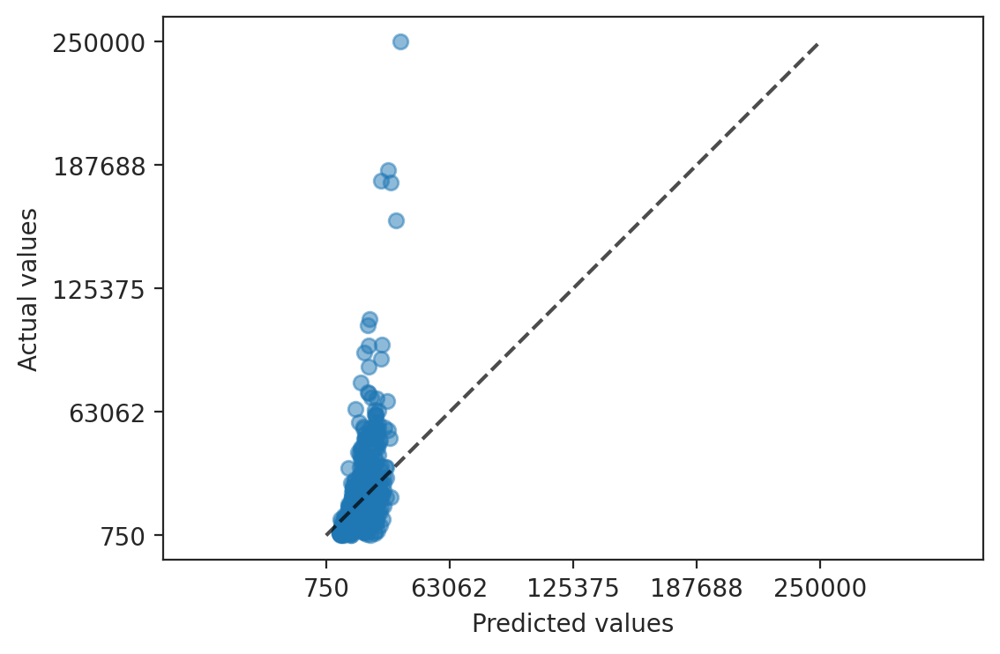

In [ ]:
#TEST PHASE - LINEAR REGRESSION (PART 4)

PredictionErrorDisplay.from_estimator(
    best_model_lin_regression, x_test_data_lr_after_fs, y_test_after_fs, kind="actual_vs_predicted", scatter_kwargs=dict(alpha=0.5), subsample = 1000,random_state = 286
);

In [ ]:
#TEST PHASE - DATA DEFINITION (PART 5)

  #This step is useful to derive the terms that are going to be used for Polynomial
# Access the "transformations steps" (called by me a as "transformations") from the "best estimator" (called "best_model_lin_regression")
transformations2 = best_model_lin_regression.named_steps['transformations']

# Transform the input data (i.e., the independet features) using the transformations steps
X_transformed_lr_test = transformations2.transform(x_test_data_lr_after_fs)

# Convert the transformed data to a DataFrame
X_transformed_lr_test_df = pd.DataFrame(X_transformed_lr_test, columns=x_test_data_lr_after_fs.columns)
X_transformed_lr_test_df

,mileage,mileage_year,reg_code,standard_make,body_type,year_of_registration,doors,standard_model,fuel_type
1,0.116376,0.116087,0.106017,0.059892,0.224299,0.991185,0.50,0.010655,0.117315
9,0.010215,0.010149,0.566680,0.083830,0.298929,0.999021,0.75,0.038778,0.117315
11,0.026330,0.026187,0.582032,0.017575,0.000000,0.997062,0.75,0.006067,0.118513
16,0.055939,0.055661,0.302641,0.027937,0.145090,0.996082,0.75,0.009449,0.117315
18,0.031720,0.031626,0.112731,0.048231,0.224299,0.992165,0.50,0.013483,0.118513
...,...,...,...,...,...,...,...,...,...
401983,0.047312,0.047194,0.106017,0.025731,0.000000,0.991185,0.75,0.005017,0.118513
401986,0.002510,0.002494,0.648509,0.083830,0.298929,0.999021,0.75,0.036736,0.117315
401995,0.057484,0.057369,0.054971,0.024889,0.145090,0.990206,0.75,0.005271,0.118513
401996,0.048387,0.048171,0.241307,0.012570,0.000000,0.995103,0.75,0.003848,0.118513


In [ ]:
#TEST PHASE - DATA DEFINITION (PART 6)

#Polynomial features that were gotten according to feature selection in the section 6.FEATURE SELECTION AND DIMENSIONALITY REDUCTION
  # reg_code * standard_make
  # reg_code * standard_model
  # standard_model^2
X_transformed_poly_lr_test_df = X_transformed_lr_test_df.copy()

  #Deriving new features
X_transformed_poly_lr_test_df["reg_code_standard_make"] = X_transformed_poly_lr_test_df["reg_code"] * X_transformed_poly_lr_test_df["standard_make"]
X_transformed_poly_lr_test_df["reg_code_standard_model"] = X_transformed_poly_lr_test_df["reg_code"] * X_transformed_poly_lr_test_df["standard_model"]
X_transformed_poly_lr_test_df["standard_model^2"] = X_transformed_poly_lr_test_df["standard_model"] **2

X_transformed_poly_lr_test_df2 = X_transformed_poly_lr_test_df[['reg_code_standard_make', 'reg_code_standard_model', 'standard_model^2']]

print(X_transformed_poly_lr_test_df2)
X_transformed_poly_lr_test_df2.head(1)

  #Information of the dataframe (after adding the new features)
X_transformed_poly_lr_test_df2.info()

        reg_code_standard_make  reg_code_standard_model  standard_model^2
1                     0.006350                 0.001130      1.135289e-04
9                     0.047505                 0.021975      1.503710e-03
11                    0.010229                 0.003531      3.680628e-05
16                    0.008455                 0.002860      8.928327e-05
18                    0.005437                 0.001520      1.817960e-04
...                        ...                      ...               ...
401983                0.002728                 0.000532      2.516596e-05
401986                0.054365                 0.023824      1.349532e-03
401995                0.001368                 0.000290      2.778354e-05
401996                0.003033                 0.000929      1.480902e-05
402001                0.000525                 0.000023      5.750865e-07

[80401 rows x 3 columns]
<class 'pandas.core.frame.DataFrame'>
Int64Index: 80401 entries, 1 to 402001
Data colu

## **7.2. POLYNOMIAL MODEL**

In [ ]:
#TRAINING PHASE - POLYNOMIAL MODEL (WITH CROSS VALIDATION)

model_results_list_2 = []

for my_model_2 in training_models_2:
  eval_results = cross_validate(
      my_model_2, special_poly_lr_df, y_training_data_after_fs, cv=5,
      scoring='neg_mean_absolute_error',
      return_train_score=True
  )
model_results_list_2.append(
(eval_results['test_score'].mean(), eval_results['test_score'].std(),
eval_results['train_score'].mean(), eval_results['train_score'].std())
)

In [ ]:
#TRAINING PHASE - POLYNOMIAL MODEL (WITH CROSS VALIDATION) (PART 2)

model_results_2 = pd.DataFrame(
    model_results_list_2,
    columns=['test_mae_mean', 'test_mae_std', 'train_mae_mean','train_mae_std'],index=['training_poly_lr']
    )

In [ ]:
#TRAINING PHASE - POLYNOMIAL MODEL (WITH CROSS VALIDATION) (PART 3)

model_results_2

,test_mae_mean,test_mae_std,train_mae_mean,train_mae_std
training_poly_lr,-4726.426489,1300.797201,-4682.339358,398.747078


In [ ]:
#TRAINING PHASE - POLYNOMIAL MODEL (WITHOUT CROSS VALIDATION) (PART 1)

#Pipeline exclusive for the model: Polynomial
poly_lr_train = regression_pipeline(LinearRegression(), special_poly_lr_df, lin_model=False, poly_lin_model= False)

#Fitting the data to the pipeline exclusive for the model: Polynomial
poly_lr_train.fit(special_poly_lr_df, y_training_data_after_fs)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median'))]),
                                                  ['reg_code standard_make',
                                                   'reg_code standard_model',
                                                   'standard_model^2']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder())]),
                                                  [])],
                                   verbose_feature_names_out=False)),
                ('regressor', LinearRegression())])

In [ ]:
#TRAINING PHASE - POLYNOMIAL MODEL (WITHOUT CROSS VALIDATION) (PART 2)

#Getting the prediction: Polynomial
y_pred_poly_lr_train = poly_lr_train.predict(special_poly_lr_df)
print(y_pred_poly_lr_train)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(poly_lr_train.score(special_poly_lr_df, y_training_data_after_fs))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_poly_lr_train = mean_absolute_error(y_training_data_after_fs, y_pred_poly_lr_train)
print(mae_poly_lr_train)

#Coefficients (also called "weights")
  #Coefficients values
coefficients_poly_lr_train = poly_lr_train.named_steps['regressor'].coef_
print("Coefficients:", coefficients_poly_lr_train)
  #Coefficients Shape
print("Coefficients:", coefficients_poly_lr_train.shape)

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_poly_lr_train = poly_lr_train['transformations'].get_feature_names_out()
print("Features:", features_poly_lr_train)
  #Features Shape
print("Features:", features_poly_lr_train.shape)

[14837.25493446 27096.77881336 18895.25160947 ...  9347.94749507
 18858.96444984  7357.28365427]
0.7679021211801137
4698.598511644954
Coefficients: [ 227889.1454283  3839172.77470103 9542195.78161748]
Coefficients: (3,)
Features: ['reg_code standard_make' 'reg_code standard_model' 'standard_model^2']
Features: (3,)


In [ ]:
#TRAINING PHASE - POLYNOMIAL MODEL (WITHOUT CROSS VALIDATION) (PART 3)

#Dataframe of "Feature and Coefficients"
features_poly_lr_train_df1 = pd.DataFrame(
    dict(
        features_poly_lr_train = poly_lr_train['transformations'].get_feature_names_out(),
        coefficients_poly_lr_train = poly_lr_train.named_steps['regressor'].coef_
    ),
)
features_poly_lr_train_df1

,features_poly_lr_train,coefficients_poly_lr_train
0,reg_code standard_make,2.278891e+05
1,reg_code standard_model,3.839173e+06
2,standard_model^2,9.542196e+06


In [ ]:
#TRAINING PHASE - POLYNOMIAL MODEL (WITHOUT CROSS VALIDATION) (PART 4)

#Dataframe after the transformation of the data.
poly_lr_train['transformations'].transform(special_poly_lr_df).head()

,reg_code standard_make,reg_code standard_model,standard_model^2
0,0.009216,0.001773,0.000052
1,0.009778,0.002628,0.000980
2,0.007154,0.002767,0.000127
3,0.003174,0.000958,0.000077
4,0.017896,0.004806,0.000438


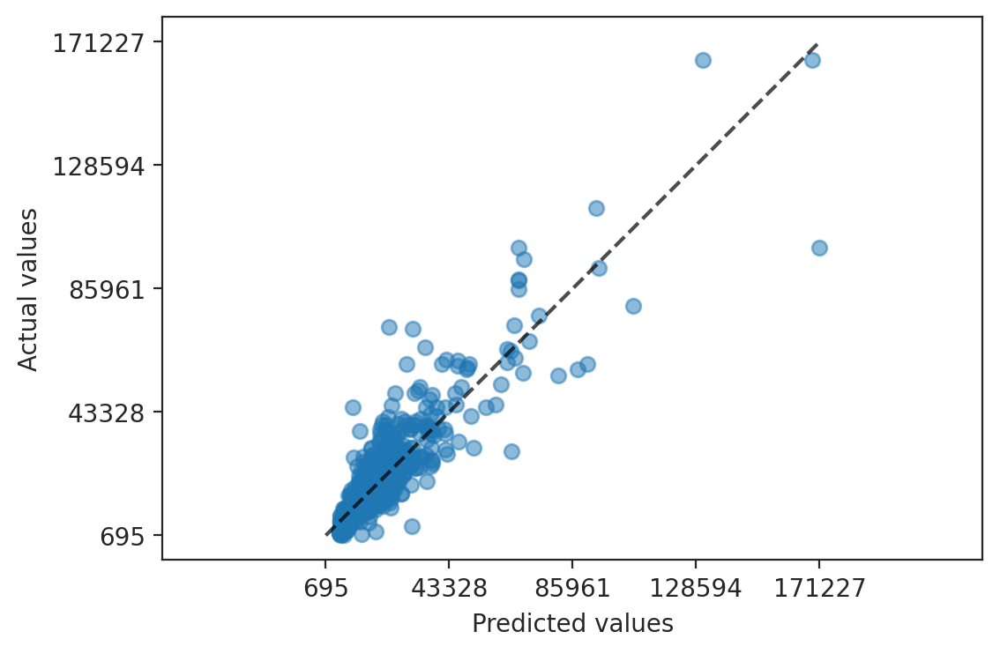

In [ ]:
#TRAINING PHASE - POLYNOMIAL MODEL (WITHOUT CROSS VALIDATION) (PART 5)

PredictionErrorDisplay.from_estimator(
    poly_lr_train, special_poly_lr_df, y_training_data_after_fs, kind="actual_vs_predicted", scatter_kwargs=dict(alpha=0.5), subsample = 1000,random_state = 286
);

In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 1)

poly_lr_grid = dict(regressor__fit_intercept=[True, False])

from sklearn.model_selection import GridSearchCV

poly_lr_gridsearch_cv = GridSearchCV(
    regression_pipeline_val(LinearRegression(), X_transformed_poly_lr_val_df2, poly_lr_grid, lin_model=False, poly_lin_model=False),
    poly_lr_grid,
    cv=5,
    scoring='neg_mean_absolute_error',
    return_train_score=True,
    n_jobs=-1,
    error_score='raise',
)
poly_lr_gridsearch_cv

GridSearchCV(cv=5, error_score='raise',
             estimator=Pipeline(steps=[('transformations',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('metric',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='median'))]),
                                                                         ['reg_code_standard_make',
                                                                          'reg_code_standard_model',
                                                                          'standard_model^2']),
                                                                        ('non_metric',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='most_frequent')),
                                                                                         ('encoder',
                                                                                          TargetEncoder())]),
                                                                         [])],
                                                          verbose_feature_names_out=False)),
                                       ('regressor', LinearRegression())]),
             n_jobs=-1, param_grid={'regressor__fit_intercept': [True, False]},
             return_train_score=True, scoring='neg_mean_absolute_error')

In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 2)

gs_results_poly_lr = poly_lr_gridsearch_cv.fit(X_transformed_poly_lr_val_df2, y_validation_after_fs)

gs_poly_lr_df = pd.DataFrame(gs_results_poly_lr.cv_results_)

gs_poly_lr_df[ [
'param_regressor__fit_intercept',"mean_train_score",'std_train_score','mean_test_score','std_test_score', 'rank_test_score'
] ].sort_values('rank_test_score')

,param_regressor__fit_intercept,mean_train_score,std_train_score,mean_test_score,std_test_score,rank_test_score
0,True,-4754.056703,244.886096,-4991.899857,766.068356,1
1,False,-5316.340699,344.607614,-5547.591879,851.464132,2


In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 3)

  #Best parameters of the Validation Phase (Cross Validation)
gs_results_poly_lr.best_params_

{'regressor__fit_intercept': True}

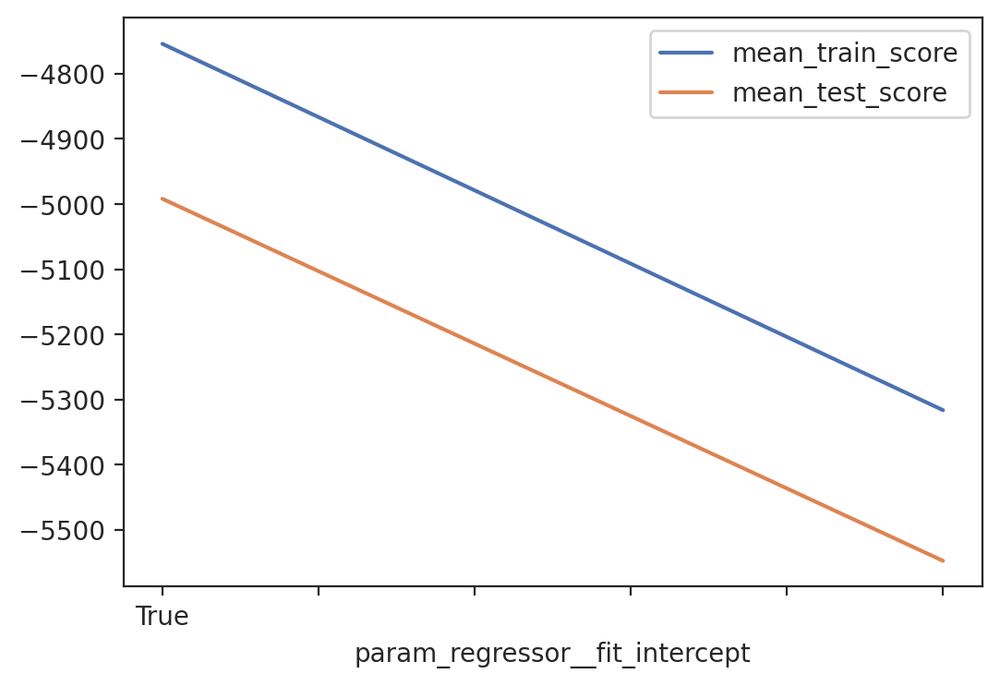

In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 4)

  #Graph of on of the best parameters of the Validation Phase (Cross Validation)
gs_poly_lr_df.set_index('param_regressor__fit_intercept')[['mean_train_score','mean_test_score']].plot.line();

In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 5)

  #Best Linear Model (during the Validation Phase)
best_model_poly_regression = gs_results_poly_lr.best_estimator_
best_model_poly_regression

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median'))]),
                                                  ['reg_code_standard_make',
                                                   'reg_code_standard_model',
                                                   'standard_model^2']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder())]),
                                                  [])],
                                   verbose_feature_names_out=False)),
                ('regressor', LinearRegression())])

In [ ]:
#TEST PHASE - POLYNOMIAL MODEL (PART 1)

#Getting the prediction: Linear Regression (without polynomial)
y_pred_poly_lr_test = best_model_poly_regression.predict(X_transformed_poly_lr_test_df2)
print(y_pred_poly_lr_test)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(best_model_poly_regression.score(X_transformed_poly_lr_test_df2, y_test_after_fs))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_poly_lr_test = mean_absolute_error(y_test_after_fs, y_pred_poly_lr_test)
print(mae_poly_lr_test)

#Coefficients (also called "weights")
  #Coefficients values
coefficients_poly_lr_test = best_model_poly_regression.named_steps['regressor'].coef_
print("Coefficients:", coefficients_poly_lr_test)
  #Coefficients Shape
print("Coefficients:", coefficients_poly_lr_test.shape)

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_poly_lr_test = best_model_poly_regression['transformations'].get_feature_names_out()
print("Features:", features_poly_lr_test)
  #Features Shape
print("Features:", features_poly_lr_test.shape)

[ 8013.68006716 71250.43522056 12707.34182971 ...  3810.13984319
  5390.88372142  2780.55869311]
0.5158517245714966
4724.03491164921
Coefficients: [ 413805.39562317 1587406.54427876 9435453.72480735]
Coefficients: (3,)
Features: ['reg_code_standard_make' 'reg_code_standard_model' 'standard_model^2']
Features: (3,)


In [ ]:
#TEST PHASE - POLYNOMIAL MODEL (PART 2)

#Dataframe of "Feature and Coefficients"
features_poly_lr_test_df1 = pd.DataFrame(
    dict(
        features_poly_lr_test = best_model_poly_regression['transformations'].get_feature_names_out(),
        coefficients_poly_lr_test = best_model_poly_regression.named_steps['regressor'].coef_
    ),
)
features_poly_lr_test_df1

,features_poly_lr_test,coefficients_poly_lr_test
0,reg_code_standard_make,4.138054e+05
1,reg_code_standard_model,1.587407e+06
2,standard_model^2,9.435454e+06


In [ ]:
#TEST PHASE - POLYNOMIAL MODEL (PART 3)

#Dataframe after the transformation of the data.
best_model_poly_regression['transformations'].transform(X_transformed_poly_lr_test_df2).head()

,reg_code_standard_make,reg_code_standard_model,standard_model^2
1,0.006350,0.001130,0.000114
9,0.047505,0.021975,0.001504
11,0.010229,0.003531,0.000037
16,0.008455,0.002860,0.000089
18,0.005437,0.001520,0.000182


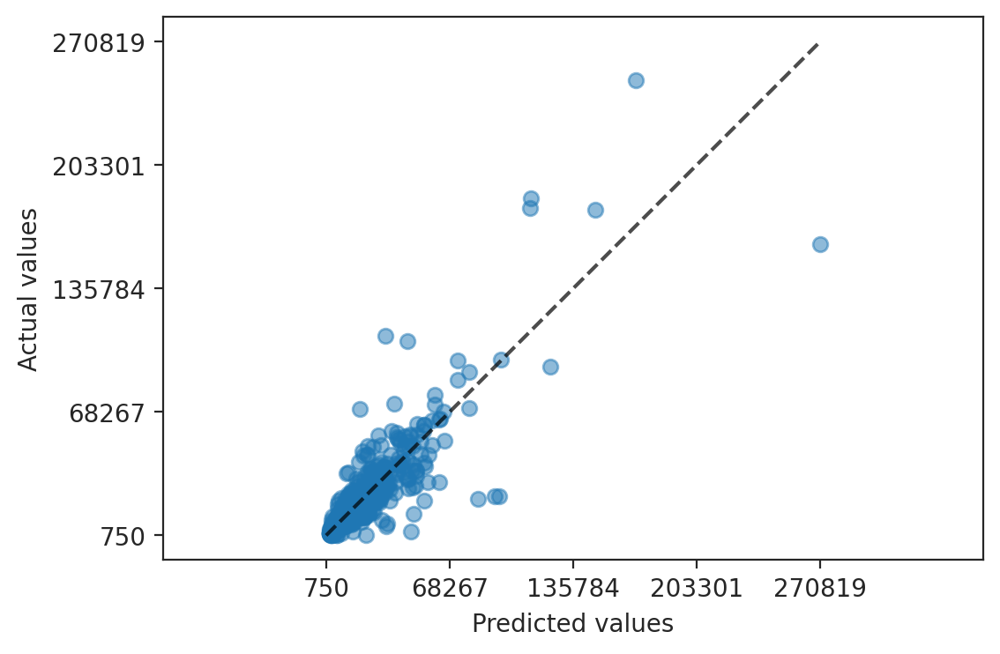

In [ ]:
#TEST PHASE - POLYNOMIAL MODEL (PART 4)

PredictionErrorDisplay.from_estimator(
    best_model_poly_regression, X_transformed_poly_lr_test_df2, y_test_after_fs, kind="actual_vs_predicted", scatter_kwargs=dict(alpha=0.5), subsample = 1000,random_state = 286
);

## **7.3. RANDOM FOREST**

In [ ]:
#TRAINING PHASE - RANDOM FOREST (WITH CROSS VALIDATION) (PART 1)

model_results_list_3 = []

for my_model_3 in training_models_3:
  eval_results = cross_validate(
      my_model_3, x_training_data_rf_after_fs, y_training_data_after_fs, cv=5,
      scoring='neg_mean_absolute_error',
      return_train_score=True,
      n_jobs = -1
  )
model_results_list_3.append(
(eval_results['test_score'].mean(), eval_results['test_score'].std(),
eval_results['train_score'].mean(), eval_results['train_score'].std())
)

In [ ]:
#TRAINING PHASE - RANDOM FOREST (WITH CROSS VALIDATION) (PART 2)

model_results_3 = pd.DataFrame(
    model_results_list_3,
    columns=['test_mae_mean', 'test_mae_std', 'train_mae_mean','train_mae_std'],index=['training_rf' ]
    )

In [ ]:
#TRAINING PHASE - RANDOM FOREST (WITH CROSS VALIDATION) (PART 3)

model_results_3

,test_mae_mean,test_mae_std,train_mae_mean,train_mae_std
training_rf,-5707.991679,1828.876397,-4733.45422,685.554207


In [ ]:
#TRAINING PHASE - RANDOM FOREST (WITHOUT CROSS VALIDATION) (PART 1)

#Pipeline exclusive for the model: Linear Regression (without polynomial)
rf_train = regression_pipeline(RandomForestRegressor(max_depth=5, random_state=21), x_training_data_rf_after_fs, lin_model=False, poly_lin_model= False)

#Fitting the data to the pipeline exclusive for the model: Linear Regression (without polynomial)
rf_train.fit(x_training_data_rf_after_fs, y_training_data_after_fs)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median'))]),
                                                  ['mileage', 'mileage_year',
                                                   'year_of_registration',
                                                   'doors']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder())]),
                                                  ['reg_code', 'standard_make',
                                                   'body_type',
                                                   'standard_model'])],
                                   verbose_feature_names_out=False)),
                ('regressor',
                 RandomForestRegressor(max_depth=5, random_state=21))])

In [ ]:
#TRAINING PHASE - RANDOM FOREST (WITHOUT CROSS VALIDATION) (PART 2)

#Getting the prediction: Linear Regression (without polynomial)
y_pred_rf_train = rf_train.predict(x_training_data_rf_after_fs)
print(y_pred_rf_train)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(rf_train.score(x_training_data_rf_after_fs, y_training_data_after_fs))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_rf_train = mean_absolute_error(y_training_data_after_fs, y_pred_rf_train)
print(mae_rf_train)

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_rf_train = rf_train['transformations'].get_feature_names_out()
print("Features:", features_rf_train)
  #Features Shape
print("Features:", features_rf_train.shape)

[12340.29631851 24168.5271798  17799.85021413 ...  6912.61242948
 10846.84599891  4934.63397857]
0.9204744510712513
4671.632330889105
Features: ['mileage' 'mileage_year' 'year_of_registration' 'doors' 'reg_code'
 'standard_make' 'body_type' 'standard_model']
Features: (8,)


In [ ]:
#TRAINING PHASE - RANDOM FOREST (WITHOUT CROSS VALIDATION) (PART 3)

#Dataframe of "Feature and Coefficients"
features_rf_train_df1 = pd.DataFrame(
    dict(
        features_rf_train = rf_train['transformations'].get_feature_names_out(),
    ),
)
features_rf_train_df1

,features_rf_train
0,mileage
1,mileage_year
2,year_of_registration
3,doors
4,reg_code
5,standard_make
6,body_type
7,standard_model


In [ ]:
#TRAINING PHASE - RANDOM FOREST (WITHOUT CROSS VALIDATION) (PART 4)

#Dataframe after the transformation of the data.
rf_train['transformations'].transform(x_training_data_rf_after_fs).head()

,mileage,mileage_year,year_of_registration,doors,reg_code,standard_make,body_type,standard_model
0,7800.0,3.867129,2017.0,5.0,24985.438376,13734.552871,22506.665734,10719.610998
1,64000.0,31.761787,2015.0,5.0,11765.292625,35584.701048,22506.665734,42376.639629
2,5.0,15.785218,2016.0,5.0,24985.438376,11407.733288,22506.665734,16043.486877
3,47299.0,23.461806,2016.0,5.0,13805.296486,11407.733288,22506.665734,12783.591704
4,11961.0,5.924220,2019.0,5.0,23691.779245,24920.769242,22506.665734,28747.164148


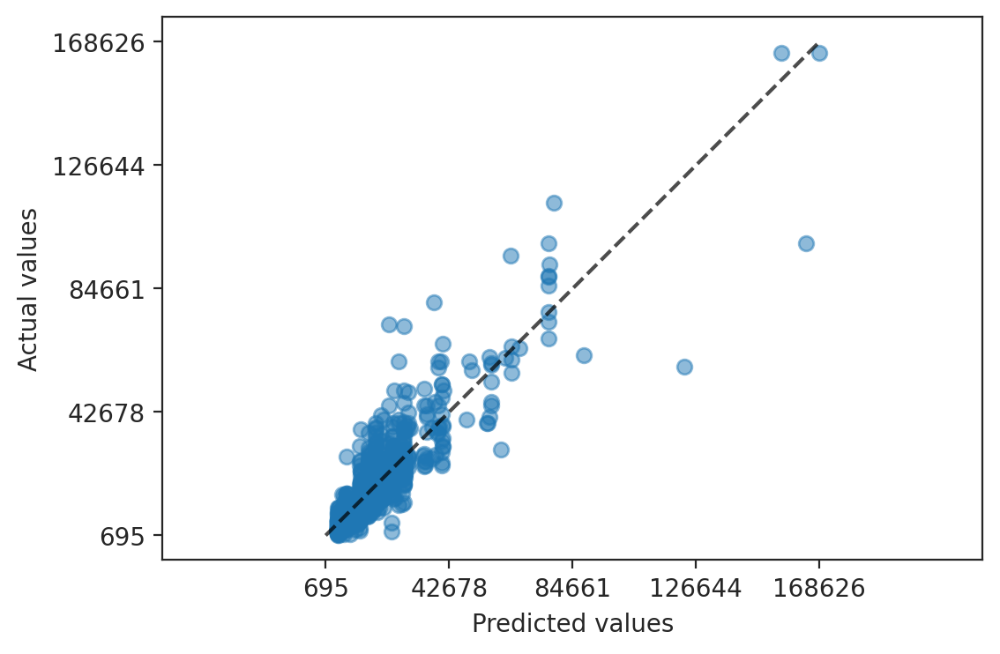

In [ ]:
#TRAINING PHASE - RANDOM FOREST (WITHOUT CROSS VALIDATION) (PART 5)

PredictionErrorDisplay.from_estimator(
    rf_train, x_training_data_rf_after_fs, y_training_data_after_fs, kind="actual_vs_predicted", scatter_kwargs=dict(alpha=0.5), subsample = 1000,random_state = 286
);

In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 1)

rf_grid = dict(regressor__n_estimators=[100, 110], regressor__max_depth=[10, 20])

from sklearn.model_selection import GridSearchCV

rf_gridsearch_cv = GridSearchCV(
    regression_pipeline_val(RandomForestRegressor(), x_validation_rf_after_fs, rf_grid, lin_model=True, poly_lin_model=False),
    rf_grid,
    cv=5,
    scoring='neg_mean_absolute_error',
    return_train_score=True,
    n_jobs=-1,
    error_score='raise',
)
rf_gridsearch_cv

GridSearchCV(cv=5, error_score='raise',
             estimator=Pipeline(steps=[('transformations',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('metric',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='median')),
                                                                                         ('scaler',
                                                                                          MinMaxScaler())]),
                                                                         ['mileage',
                                                                          'mileage_year',
                                                                          'year_of_registration',
                                                                          'doors']),
                                                                        ('non_metric',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImpute...frequent')),
                                                                                         ('encoder',
                                                                                          TargetEncoder()),
                                                                                         ('scaler',
                                                                                          MinMaxScaler())]),
                                                                         ['reg_code',
                                                                          'standard_make',
                                                                          'body_type',
                                                                          'standard_model'])],
                                                          verbose_feature_names_out=False)),
                                       ('regressor', RandomForestRegressor())]),
             n_jobs=-1,
             param_grid={'regressor__max_depth': [10, 20],
                         'regressor__n_estimators': [100, 110]},
             return_train_score=True, scoring='neg_mean_absolute_error')

In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 2)

gs_results_rf = rf_gridsearch_cv.fit(x_validation_rf_after_fs, y_validation_after_fs)

gs_rf_df = pd.DataFrame(gs_results_rf.cv_results_)

gs_rf_df[ [
'param_regressor__n_estimators',
'param_regressor__max_depth', "mean_train_score",'std_train_score','mean_test_score',
 'std_test_score', 'rank_test_score'
] ].sort_values('rank_test_score')

,param_regressor__n_estimators,param_regressor__max_depth,mean_train_score,std_train_score,mean_test_score,std_test_score,rank_test_score
3,110,20,-1333.949366,30.106352,-2618.622948,229.935498,1
2,100,20,-1338.805845,30.523528,-2619.658383,235.131581,2
0,100,10,-2842.898124,65.235366,-3299.500614,217.149707,3
1,110,10,-2852.620993,71.846108,-3311.328385,204.775002,4


In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 3)

  #Best parameters of the Validation Phase (Cross Validation)
gs_results_rf.best_params_

{'regressor__max_depth': 20, 'regressor__n_estimators': 110}

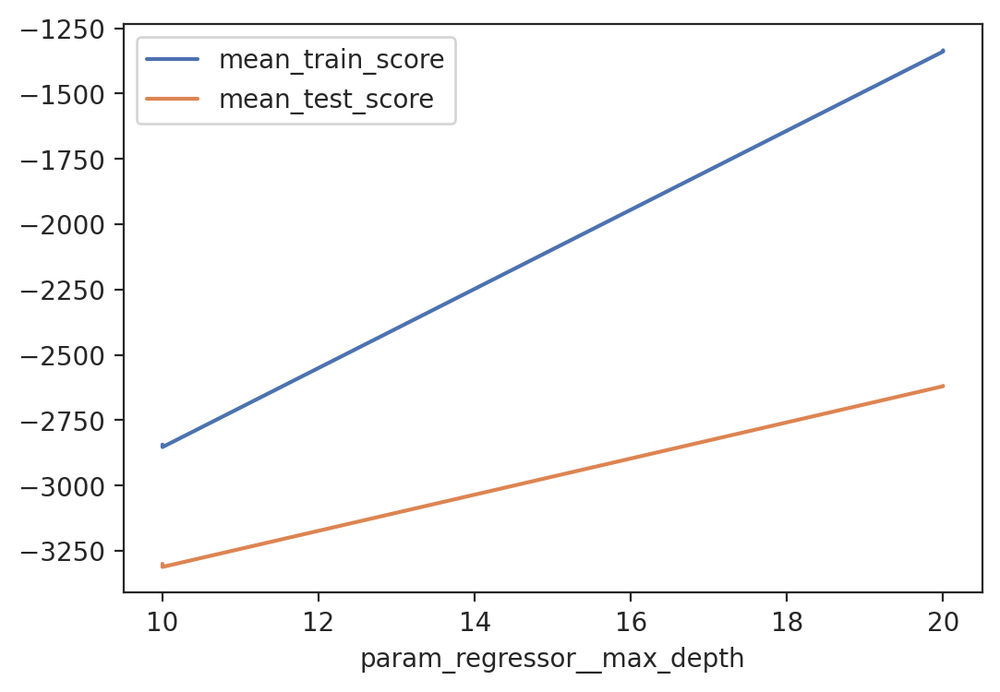

In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 4)

  #Graph of on of the best parameters of the Validation Phase (Cross Validation)
gs_rf_df.set_index('param_regressor__max_depth')[['mean_train_score','mean_test_score']].plot.line();

In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 5)

  #Best Linear Model (during the Validation Phase)
best_model_rf = gs_results_rf.best_estimator_
best_model_rf

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['mileage', 'mileage_year',
                                                   'year_of_registration',
                                                   'doors']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['reg_code', 'standard_make',
                                                   'body_type',
                                                   'standard_model'])],
                                   verbose_feature_names_out=False)),
                ('regressor',
                 RandomForestRegressor(max_depth=20, n_estimators=110))])

In [ ]:
#VALIDATION PHASE - DATA DEFINITION (PART 1)

# Access the "transformations steps" (called by me a as "transformations") from the "best estimator" (called "best_model_rf")
transformations_rf = best_model_rf.named_steps['transformations']

# Transform the input data (i.e., the independet features) using the transformations steps
X_transformed_rf_val = transformations_rf.transform(x_validation_rf_after_fs)

# Convert the transformed data to a DataFrame
X_transformed_rf_val_df = pd.DataFrame(X_transformed_rf_val, columns=x_validation_rf_after_fs.columns)
X_transformed_rf_val_df

,mileage,mileage_year,reg_code,standard_make,body_type,year_of_registration,doors,standard_model
0,0.000000,0.034323,0.582032,0.057385,0.298929,0.996082,0.75,0.028549
7,0.106452,0.106081,0.177352,0.083830,0.298929,0.993144,0.75,0.038778
12,0.005124,0.005091,0.648509,0.026471,0.145090,0.999021,0.75,0.008295
13,0.019585,0.019459,0.566680,0.024889,0.000000,0.999021,0.75,0.008661
14,0.033908,0.033723,0.582032,0.023255,0.000000,0.997062,0.75,0.007506
...,...,...,...,...,...,...,...,...
401993,0.047312,0.047101,0.241307,0.395404,0.224299,0.995103,0.50,0.016127
401994,0.019857,0.019749,0.359129,0.024268,0.298929,0.997062,0.75,0.010047
401998,0.093632,0.093772,0.079531,0.019606,0.000000,0.983350,0.75,0.005141
401999,0.080357,0.080237,0.029878,0.021136,0.000000,0.989226,0.75,0.006397


In [ ]:
#TEST PHASE - RANDOM FOREST (PART 1)

#Getting the prediction: Linear Regression (without polynomial)
y_pred_rf_test = best_model_rf.predict(x_test_rf_after_fs)
print(y_pred_rf_test)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(best_model_rf.score(x_test_rf_after_fs, y_test_after_fs))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_rf_test = mean_absolute_error(y_test_after_fs, y_pred_rf_test)
print(mae_rf_test)

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_rf_test = best_model_rf['transformations'].get_feature_names_out()
print("Features:", features_rf_test)
  #Features Shape
print("Features:", features_rf_test.shape)

[ 6875.28768292 76561.51903007  7927.58431057 ...  4986.64284858
  5799.0183725   1492.20152946]
0.7073106603786543
2406.0509033032527
Features: ['mileage' 'mileage_year' 'year_of_registration' 'doors' 'reg_code'
 'standard_make' 'body_type' 'standard_model']
Features: (8,)


In [ ]:
#TEST PHASE - RANDOM FOREST (PART 2)

#Dataframe of "Feature and Coefficients"
features_rf_test_df1 = pd.DataFrame(
    dict(
        features_rf_test = best_model_rf['transformations'].get_feature_names_out(),
    ),
)
features_rf_test_df1

,features_rf_test
0,mileage
1,mileage_year
2,year_of_registration
3,doors
4,reg_code
5,standard_make
6,body_type
7,standard_model


In [ ]:
#TEST PHASE - RANDOM FOREST (PART 3)

#Dataframe after the transformation of the data.
best_model_rf['transformations'].transform(x_test_rf_after_fs).head()

,mileage,mileage_year,year_of_registration,doors,reg_code,standard_make,body_type,standard_model
1,0.116376,0.116087,0.991185,0.50,0.106017,0.059892,0.224299,0.010655
9,0.010215,0.010149,0.999021,0.75,0.566680,0.083830,0.298929,0.038778
11,0.026330,0.026187,0.997062,0.75,0.582032,0.017575,0.000000,0.006067
16,0.055939,0.055661,0.996082,0.75,0.302641,0.027937,0.145090,0.009449
18,0.031720,0.031626,0.992165,0.50,0.112731,0.048231,0.224299,0.013483


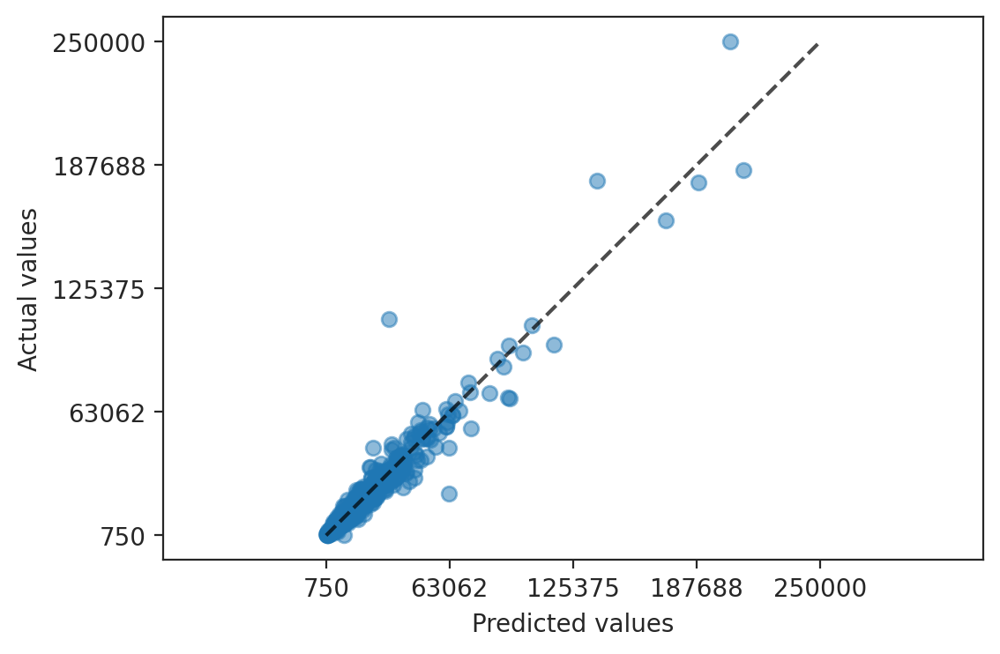

In [ ]:
#TEST PHASE - RANDOM FOREST (PART 4)

PredictionErrorDisplay.from_estimator(
    best_model_rf, x_test_rf_after_fs, y_test_after_fs, kind="actual_vs_predicted", scatter_kwargs=dict(alpha=0.5), subsample = 1000,random_state = 286
);

In [ ]:
#TEST PHASE - DATA DEFINITION (PART 1)

# Access the "transformations steps" (called by me a as "transformations") from the "best estimator" (called "best_model_rf")
transformations3 = best_model_rf.named_steps['transformations']

# Transform the input data (i.e., the independet features) using the transformations steps
X_transformed_rf_test = transformations3.transform(x_test_rf_after_fs)

# Convert the transformed data to a DataFrame
X_transformed_rf_test_df = pd.DataFrame(X_transformed_rf_test, columns=x_test_rf_after_fs.columns)
X_transformed_rf_test_df

,mileage,mileage_year,reg_code,standard_make,body_type,year_of_registration,doors,standard_model
1,0.116376,0.116087,0.106017,0.059892,0.224299,0.991185,0.50,0.010655
9,0.010215,0.010149,0.566680,0.083830,0.298929,0.999021,0.75,0.038778
11,0.026330,0.026187,0.582032,0.017575,0.000000,0.997062,0.75,0.006067
16,0.055939,0.055661,0.302641,0.027937,0.145090,0.996082,0.75,0.009449
18,0.031720,0.031626,0.112731,0.048231,0.224299,0.992165,0.50,0.013483
...,...,...,...,...,...,...,...,...
401983,0.047312,0.047194,0.106017,0.025731,0.000000,0.991185,0.75,0.005017
401986,0.002510,0.002494,0.648509,0.083830,0.298929,0.999021,0.75,0.036736
401995,0.057484,0.057369,0.054971,0.024889,0.145090,0.990206,0.75,0.005271
401996,0.048387,0.048171,0.241307,0.012570,0.000000,0.995103,0.75,0.003848


## **7.4. BOOSTED TREE**

In [ ]:
#TRAINING PHASE - BOOSTED TREE (WITH CROSS VALIDATION) (PART 1)

model_results_list_4 = []

for my_model_4 in training_models_4:
  eval_results = cross_validate(
      my_model_4, x_training_data_bt_after_fs, y_training_data_after_fs, cv=5,
      scoring='neg_mean_absolute_error',
      return_train_score=True,
      n_jobs = -1
  )
model_results_list_4.append(
(eval_results['test_score'].mean(), eval_results['test_score'].std(),
eval_results['train_score'].mean(), eval_results['train_score'].std())
)

In [ ]:
#TRAINING PHASE - BOOSTED TREE (WITH CROSS VALIDATION) (PART 2)

model_results_4 = pd.DataFrame(
    model_results_list_4,
    columns=['test_mae_mean', 'test_mae_std', 'train_mae_mean','train_mae_std'],index=['training_bt' ]
    )

In [ ]:
#TRAINING PHASE - BOOSTED TREE (WITH CROSS VALIDATION) (PART 3)

model_results_4

,test_mae_mean,test_mae_std,train_mae_mean,train_mae_std
training_bt,-4065.748632,2171.411337,-2768.373168,281.162401


In [ ]:
#TRAINING PHASE - BOOSTED TREE (WITHOUT CROSS VALIDATION) (PART 1)

#Pipeline exclusive for the model: Boosted Tree
bt_train = regression_pipeline(GradientBoostingRegressor(max_depth=5, random_state=21), x_training_data_bt_after_fs, lin_model=False, poly_lin_model= False)

#Fitting the data to the pipeline exclusive for the model: Linear Regression (without polynomial)
bt_train.fit(x_training_data_bt_after_fs, y_training_data_after_fs)

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median'))]),
                                                  ['mileage', 'mileage_year',
                                                   'year_of_registration',
                                                   'doors']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder())]),
                                                  ['reg_code', 'standard_make',
                                                   'body_type',
                                                   'standard_model'])],
                                   verbose_feature_names_out=False)),
                ('regressor',
                 GradientBoostingRegressor(max_depth=5, random_state=21))])

In [ ]:
#TRAINING PHASE - BOOSTED TREE (WITHOUT CROSS VALIDATION) (PART 2)

#Getting the prediction: Linear Regression (without polynomial)
y_pred_bt_train = bt_train.predict(x_training_data_bt_after_fs)
print(y_pred_bt_train)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(bt_train.score(x_training_data_bt_after_fs, y_training_data_after_fs))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_bt_train = mean_absolute_error(y_training_data_after_fs, y_pred_bt_train)
print(mae_bt_train)

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_bt_train = bt_train['transformations'].get_feature_names_out()
print("Features:", features_bt_train)
  #Features Shape
print("Features:", features_bt_train.shape)

[13361.67413864 28750.7588207  24188.01849221 ...  6344.10366884
 11926.61911845  2952.85840213]
0.9839652105218778
2837.119898057451
Features: ['mileage' 'mileage_year' 'year_of_registration' 'doors' 'reg_code'
 'standard_make' 'body_type' 'standard_model']
Features: (8,)


In [ ]:
#TRAINING PHASE - BOOSTED TREE (WITHOUT CROSS VALIDATION) (PART 3)

#Dataframe of "Feature and Coefficients"
features_bt_train_df1 = pd.DataFrame(
    dict(
        features_bt_train = bt_train['transformations'].get_feature_names_out(),
    ),
)
features_bt_train_df1

,features_bt_train
0,mileage
1,mileage_year
2,year_of_registration
3,doors
4,reg_code
5,standard_make
6,body_type
7,standard_model


In [ ]:
#TRAINING PHASE - BOOSTED TREE (WITHOUT CROSS VALIDATION) (PART 4)

#Dataframe after the transformation of the data.
bt_train['transformations'].transform(x_training_data_bt_after_fs).head()

,mileage,mileage_year,year_of_registration,doors,reg_code,standard_make,body_type,standard_model
0,7800.0,3.867129,2017.0,5.0,24985.438376,13734.552871,22506.665734,10719.610998
1,64000.0,31.761787,2015.0,5.0,11765.292625,35584.701048,22506.665734,42376.639629
2,5.0,15.785218,2016.0,5.0,24985.438376,11407.733288,22506.665734,16043.486877
3,47299.0,23.461806,2016.0,5.0,13805.296486,11407.733288,22506.665734,12783.591704
4,11961.0,5.924220,2019.0,5.0,23691.779245,24920.769242,22506.665734,28747.164148


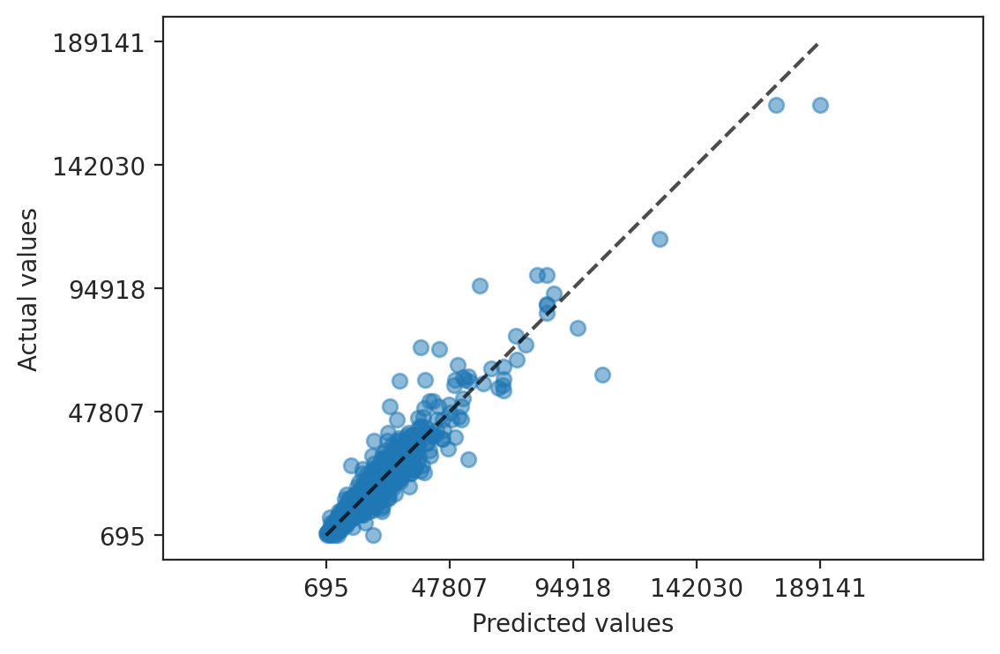

In [ ]:
#TRAINING PHASE - BOOSTED TREE (WITHOUT CROSS VALIDATION) (PART 5)

PredictionErrorDisplay.from_estimator(
    bt_train, x_training_data_bt_after_fs, y_training_data_after_fs, kind="actual_vs_predicted", scatter_kwargs=dict(alpha=0.5), subsample = 1000,random_state = 286
);

In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 1)

bt_grid = dict(regressor__n_estimators=[100, 110], regressor__max_depth=[10, 20])

from sklearn.model_selection import GridSearchCV

bt_gridsearch_cv = GridSearchCV(
    regression_pipeline_val(GradientBoostingRegressor(), x_validation_bt_after_fs, bt_grid, lin_model=True, poly_lin_model=False),
    bt_grid,
    cv=5,
    scoring='neg_mean_absolute_error',
    return_train_score=True,
    n_jobs=-1,
    error_score='raise',
)
bt_gridsearch_cv

GridSearchCV(cv=5, error_score='raise',
             estimator=Pipeline(steps=[('transformations',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('metric',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='median')),
                                                                                         ('scaler',
                                                                                          MinMaxScaler())]),
                                                                         ['mileage',
                                                                          'mileage_year',
                                                                          'year_of_registration',
                                                                          'doors']),
                                                                        ('non_metric',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImpute...uent')),
                                                                                         ('encoder',
                                                                                          TargetEncoder()),
                                                                                         ('scaler',
                                                                                          MinMaxScaler())]),
                                                                         ['reg_code',
                                                                          'standard_make',
                                                                          'body_type',
                                                                          'standard_model'])],
                                                          verbose_feature_names_out=False)),
                                       ('regressor',
                                        GradientBoostingRegressor())]),
             n_jobs=-1,
             param_grid={'regressor__max_depth': [10, 20],
                         'regressor__n_estimators': [100, 110]},
             return_train_score=True, scoring='neg_mean_absolute_error')

In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 2)

gs_results_bt = bt_gridsearch_cv.fit(x_validation_bt_after_fs, y_validation_after_fs)

gs_bt_df = pd.DataFrame(gs_results_bt.cv_results_)

gs_bt_df[ [
'param_regressor__n_estimators',
'param_regressor__max_depth', "mean_train_score",'std_train_score','mean_test_score',
 'std_test_score', 'rank_test_score'
] ].sort_values('rank_test_score')

,param_regressor__n_estimators,param_regressor__max_depth,mean_train_score,std_train_score,mean_test_score,std_test_score,rank_test_score
1,110,10,-1710.912375,45.108411,-2590.033930,221.149536,1
0,100,10,-1752.363253,50.245025,-2603.274681,217.077680,2
3,110,20,-386.804131,23.742697,-2878.127334,247.169373,3
2,100,20,-398.124477,26.352789,-2878.474700,244.989235,4


In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 3)

  #Best parameters of the Validation Phase (Cross Validation)
gs_results_bt.best_params_

{'regressor__max_depth': 10, 'regressor__n_estimators': 110}

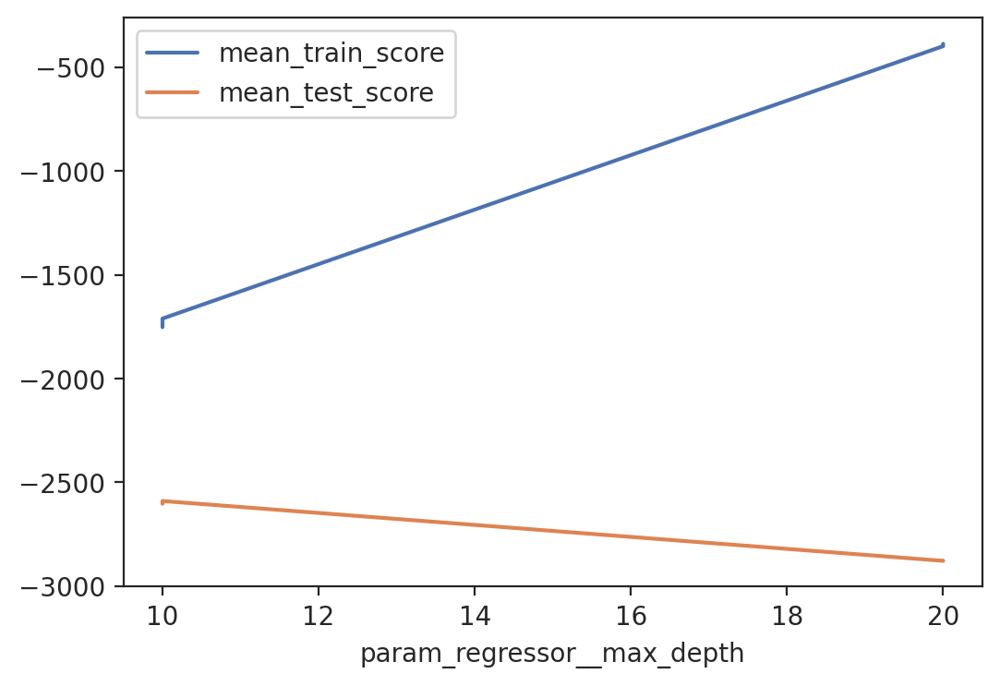

In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 4)

  #Graph of on of the best parameters of the Validation Phase (Cross Validation)
gs_bt_df.set_index('param_regressor__max_depth')[['mean_train_score','mean_test_score']].plot.line();

In [ ]:
#VALIDATION PHASE - GRID SEARCH (PART 5)

  #Best Linear Model (during the Validation Phase)
best_model_bt = gs_results_bt.best_estimator_
best_model_bt

Pipeline(steps=[('transformations',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['mileage', 'mileage_year',
                                                   'year_of_registration',
                                                   'doors']),
                                                 ('non_metric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   TargetEncoder()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  ['reg_code', 'standard_make',
                                                   'body_type',
                                                   'standard_model'])],
                                   verbose_feature_names_out=False)),
                ('regressor',
                 GradientBoostingRegressor(max_depth=10, n_estimators=110))])

In [ ]:
#VALIDATION PHASE - DATA DEFINITION (PART 1)

# Access the "transformations steps" (called by me a as "transformations") from the "best estimator" (called "best_model_bt")
transformations_bt = best_model_bt.named_steps['transformations']

# Transform the input data (i.e., the independet features) using the transformations steps
X_transformed_bt_val = transformations_bt.transform(x_validation_bt_after_fs)

# Convert the transformed data to a DataFrame
X_transformed_bt_val_df = pd.DataFrame(X_transformed_bt_val, columns=x_validation_bt_after_fs.columns)
X_transformed_bt_val_df

,mileage,mileage_year,reg_code,standard_make,body_type,year_of_registration,doors,standard_model
0,0.000000,0.034323,0.582032,0.057385,0.298929,0.996082,0.75,0.028549
7,0.106452,0.106081,0.177352,0.083830,0.298929,0.993144,0.75,0.038778
12,0.005124,0.005091,0.648509,0.026471,0.145090,0.999021,0.75,0.008295
13,0.019585,0.019459,0.566680,0.024889,0.000000,0.999021,0.75,0.008661
14,0.033908,0.033723,0.582032,0.023255,0.000000,0.997062,0.75,0.007506
...,...,...,...,...,...,...,...,...
401993,0.047312,0.047101,0.241307,0.395404,0.224299,0.995103,0.50,0.016127
401994,0.019857,0.019749,0.359129,0.024268,0.298929,0.997062,0.75,0.010047
401998,0.093632,0.093772,0.079531,0.019606,0.000000,0.983350,0.75,0.005141
401999,0.080357,0.080237,0.029878,0.021136,0.000000,0.989226,0.75,0.006397


In [ ]:
#TEST PHASE - BOOSTED TREE (PART 1)

#Getting the prediction: Linear Regression (without polynomial)
y_pred_bt_test = best_model_bt.predict(x_test_bt_after_fs)
print(y_pred_bt_test)

##Aggregate Score (also called Coefficient of Determination R^2)
  #Score: amount of variance of the target explained by the model
  #Score: Represents the proportion of the variance (i.e. variability) in the dependent variable which is explained...
  #...by the linear regression model.
print(best_model_bt.score(x_test_bt_after_fs, y_test_after_fs))

#Aggregate Loss
  #Loss: the average residual value
  #Mean Absolute Error (MAE): average absolute error between actual and predicted values (i.e. the value that come from the model).
mae_bt_test = mean_absolute_error(y_test_after_fs, y_pred_bt_test)
print(mae_bt_test)

#Features (also called "independent variables {metric and non-metric}")
  #Features values
features_bt_test = best_model_bt['transformations'].get_feature_names_out()
print("Features:", features_bt_test)
  #Features Shape
print("Features:", features_bt_test.shape)

[ 6943.56201654 82381.3332156   8805.79146258 ...  4201.74170539
  5759.60603886  1503.81915868]
0.7118980809105353
2404.6111515690345
Features: ['mileage' 'mileage_year' 'year_of_registration' 'doors' 'reg_code'
 'standard_make' 'body_type' 'standard_model']
Features: (8,)


In [ ]:
#TEST PHASE - BOOSTED TREE (PART 2)

#Dataframe of "Feature and Coefficients"
features_bt_test_df1 = pd.DataFrame(
    dict(
        features_bt_test = best_model_bt['transformations'].get_feature_names_out(),
    ),
)
features_bt_test_df1

,features_bt_test
0,mileage
1,mileage_year
2,year_of_registration
3,doors
4,reg_code
5,standard_make
6,body_type
7,standard_model


In [ ]:
#TEST PHASE - BOOSTED TREE (PART 3)

#Dataframe after the transformation of the data.
best_model_bt['transformations'].transform(x_test_bt_after_fs).head()

,mileage,mileage_year,year_of_registration,doors,reg_code,standard_make,body_type,standard_model
1,0.116376,0.116087,0.991185,0.50,0.106017,0.059892,0.224299,0.010655
9,0.010215,0.010149,0.999021,0.75,0.566680,0.083830,0.298929,0.038778
11,0.026330,0.026187,0.997062,0.75,0.582032,0.017575,0.000000,0.006067
16,0.055939,0.055661,0.996082,0.75,0.302641,0.027937,0.145090,0.009449
18,0.031720,0.031626,0.992165,0.50,0.112731,0.048231,0.224299,0.013483


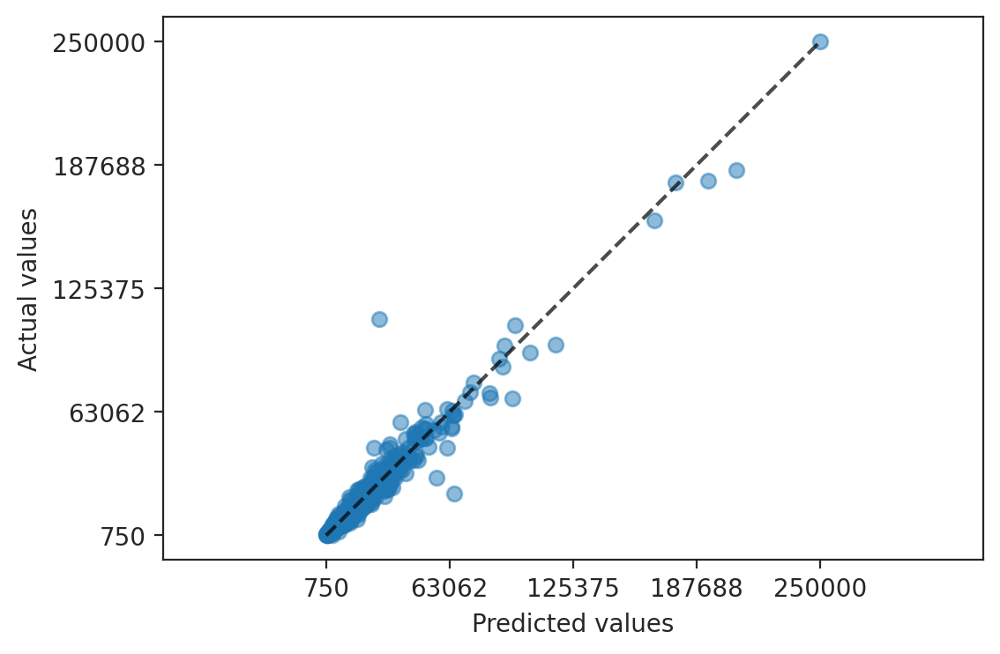

In [ ]:
#TEST PHASE - BOOSTED TREE (PART 4)

PredictionErrorDisplay.from_estimator(
    best_model_bt, x_test_bt_after_fs, y_test_after_fs, kind="actual_vs_predicted", scatter_kwargs=dict(alpha=0.5), subsample = 1000,random_state = 286
);

In [ ]:
#TEST PHASE - DATA DEFINITION (PART 1)

# Access the "transformations steps" (called by me a as "transformations") from the "best estimator" (called "best_model_bt")
transformations4 = best_model_bt.named_steps['transformations']

# Transform the input data (i.e., the independet features) using the transformations steps
X_transformed_bt_test = transformations4.transform(x_test_bt_after_fs)

# Convert the transformed data to a DataFrame
X_transformed_bt_test_df = pd.DataFrame(X_transformed_bt_test, columns=x_test_bt_after_fs.columns)
X_transformed_bt_test_df

,mileage,mileage_year,reg_code,standard_make,body_type,year_of_registration,doors,standard_model
1,0.116376,0.116087,0.106017,0.059892,0.224299,0.991185,0.50,0.010655
9,0.010215,0.010149,0.566680,0.083830,0.298929,0.999021,0.75,0.038778
11,0.026330,0.026187,0.582032,0.017575,0.000000,0.997062,0.75,0.006067
16,0.055939,0.055661,0.302641,0.027937,0.145090,0.996082,0.75,0.009449
18,0.031720,0.031626,0.112731,0.048231,0.224299,0.992165,0.50,0.013483
...,...,...,...,...,...,...,...,...
401983,0.047312,0.047194,0.106017,0.025731,0.000000,0.991185,0.75,0.005017
401986,0.002510,0.002494,0.648509,0.083830,0.298929,0.999021,0.75,0.036736
401995,0.057484,0.057369,0.054971,0.024889,0.145090,0.990206,0.75,0.005271
401996,0.048387,0.048171,0.241307,0.012570,0.000000,0.995103,0.75,0.003848


# **8. MODEL BUILDING, EVALUATION, ANALYSIS (PERFORMANCE) - PART 2**

* **Validation Phase** (tune the hyperparameters and select the best model configuration) / **Test Phase** (evaluate the performance and test generalization)

  * Voter Ensemble

In [ ]:
#VALIDATION 1
from sklearn.ensemble import VotingRegressor
from sklearn.ensemble import VotingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor

lr = best_model_lin_regression
poly = best_model_poly_regression
rf = best_model_rf
bt = best_model_bt

# weights1=[0.25, 0.25, 0.25, 0.25]
# weights2=[0.2, 0.3, 0.3, 0.2]
# weights3=[0.2, 0.2, 0.3, 0.3]
# weights4=[0.1, 0.3, 0.3, 0.3]

# Create the VotingRegressor
voting_val_model = VotingRegressor(
    estimators=[('lr', lr), ('poly', poly), ('rf', rf), ('bt', bt)],
    weights=[0.25, 0.25, 0.25, 0.25],n_jobs=-1  # Assign weights to each model
)

# Make predictions on test data
y_pred_voting_val_lr = voting_val_model.estimators[0][1].predict(x_validation_data_lr_after_fs)
y_pred_voting_val_poly = voting_val_model.estimators[1][1].predict(X_transformed_poly_lr_val_df2)
y_pred_voting_val_rf = voting_val_model.estimators[2][1].predict(x_validation_rf_after_fs)
y_pred_voting_val_bt = voting_val_model.estimators[3][1].predict(x_validation_bt_after_fs)

# Combine the predictions using the assigned weights
y_pred_voting_val1 = (0.25 * y_pred_voting_val_lr) + (0.25 * y_pred_voting_val_poly) + (0.25 * y_pred_voting_val_rf) + (0.25 * y_pred_voting_val_bt)
print(y_pred_voting_val1)
print(len(y_pred_voting_val1))

[49522.50583733 23741.54990475 19255.36262019 ...  3847.77711528
  4482.0619571  14705.4586029 ]
80400


In [ ]:
mae_ensemble_val1 = mean_absolute_error(y_validation_after_fs, y_pred_voting_val1)
print(mae_ensemble_val1)

3240.6912318690806


In [ ]:
#VALIDATION 2
from sklearn.ensemble import VotingRegressor
from sklearn.ensemble import VotingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor

lr = best_model_lin_regression
poly = best_model_poly_regression
rf = best_model_rf
bt = best_model_bt

# weights1=[0.25, 0.25, 0.25, 0.25]
# weights2=[0.2, 0.3, 0.3, 0.2]
# weights3=[0.2, 0.2, 0.3, 0.3]
# weights4=[0.1, 0.3, 0.3, 0.3]

# Create the VotingRegressor
voting_val_model = VotingRegressor(
    estimators=[('lr', lr), ('poly', poly), ('rf', rf), ('bt', bt)],
    weights=[0.2, 0.3, 0.3, 0.2],n_jobs=-1  # Assign weights to each model
)

# Make predictions on test data
y_pred_voting_val_lr = voting_val_model.estimators[0][1].predict(x_validation_data_lr_after_fs)
y_pred_voting_val_poly = voting_val_model.estimators[1][1].predict(X_transformed_poly_lr_val_df2)
y_pred_voting_val_rf = voting_val_model.estimators[2][1].predict(x_validation_rf_after_fs)
y_pred_voting_val_bt = voting_val_model.estimators[3][1].predict(x_validation_bt_after_fs)

# Combine the predictions using the assigned weights
y_pred_voting_val2 = (0.2 * y_pred_voting_val_lr) + (0.3 * y_pred_voting_val_poly) + (0.3 * y_pred_voting_val_rf) + (0.2 * y_pred_voting_val_bt)
print(y_pred_voting_val2)
print(len(y_pred_voting_val2))

[50720.51197942 24770.442271   19073.95851704 ...  3602.549203
  4211.7737443  14725.70540306]
80400


In [ ]:
mae_ensemble_val2 = mean_absolute_error(y_validation_after_fs, y_pred_voting_val2)
print(mae_ensemble_val2)

3043.467108531001


In [ ]:
#VALIDATION 3
from sklearn.ensemble import VotingRegressor
from sklearn.ensemble import VotingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor

lr = best_model_lin_regression
poly = best_model_poly_regression
rf = best_model_rf
bt = best_model_bt

# weights1=[0.25, 0.25, 0.25, 0.25]
# weights2=[0.2, 0.3, 0.3, 0.2]
# weights3=[0.2, 0.2, 0.3, 0.3]
# weights4=[0.1, 0.3, 0.3, 0.3]

# Create the VotingRegressor
voting_val_model = VotingRegressor(
    estimators=[('lr', lr), ('poly', poly), ('rf', rf), ('bt', bt)],
    weights=[0.2, 0.2, 0.3, 0.3],n_jobs=-1  # Assign weights to each model
)

# Make predictions on test data
y_pred_voting_val_lr = voting_val_model.estimators[0][1].predict(x_validation_data_lr_after_fs)
y_pred_voting_val_poly = voting_val_model.estimators[1][1].predict(X_transformed_poly_lr_val_df2)
y_pred_voting_val_rf = voting_val_model.estimators[2][1].predict(x_validation_rf_after_fs)
y_pred_voting_val_bt = voting_val_model.estimators[3][1].predict(x_validation_bt_after_fs)

# Combine the predictions using the assigned weights
y_pred_voting_val3 = (0.2 * y_pred_voting_val_lr) + (0.2 * y_pred_voting_val_poly) + (0.3 * y_pred_voting_val_rf) + (0.3 * y_pred_voting_val_bt)
print(y_pred_voting_val3)
print(len(y_pred_voting_val3))

[51692.66926101 23629.59272577 19144.69380532 ...  3321.93324896
  4214.97908895 15105.16022315]
80400


In [ ]:
mae_ensemble_val3 = mean_absolute_error(y_validation_after_fs, y_pred_voting_val3)
print(mae_ensemble_val3)

2805.862355135042


In [ ]:
#VALIDATION 4
from sklearn.ensemble import VotingRegressor
from sklearn.ensemble import VotingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor

lr = best_model_lin_regression
poly = best_model_poly_regression
rf = best_model_rf
bt = best_model_bt

# weights1=[0.25, 0.25, 0.25, 0.25]
# weights2=[0.2, 0.3, 0.3, 0.2]
# weights3=[0.2, 0.2, 0.3, 0.3]
# weights4=[0.1, 0.3, 0.3, 0.3]

# Create the VotingRegressor
voting_val_model = VotingRegressor(
    estimators=[('lr', lr), ('poly', poly), ('rf', rf), ('bt', bt)],
    weights=[0.1, 0.3, 0.3, 0.3],n_jobs=-1  # Assign weights to each model
)

# Make predictions on test data
y_pred_voting_val_lr = voting_val_model.estimators[0][1].predict(x_validation_data_lr_after_fs)
y_pred_voting_val_poly = voting_val_model.estimators[1][1].predict(X_transformed_poly_lr_val_df2)
y_pred_voting_val_rf = voting_val_model.estimators[2][1].predict(x_validation_rf_after_fs)
y_pred_voting_val_bt = voting_val_model.estimators[3][1].predict(x_validation_bt_after_fs)

# Combine the predictions using the assigned weights
y_pred_voting_val4 = (0.25 * y_pred_voting_val_lr) + (0.25 * y_pred_voting_val_poly) + (0.25 * y_pred_voting_val_rf) + (0.25 * y_pred_voting_val_bt)
print(y_pred_voting_val4)
print(len(y_pred_voting_val4))

[49522.50583733 23741.54990475 19255.36262019 ...  3847.77711528
  4482.0619571  14705.4586029 ]
80400


In [ ]:
mae_ensemble_val4 = mean_absolute_error(y_validation_after_fs, y_pred_voting_val4)
print(mae_ensemble_val4)

3240.6912318690806


In [ ]:
###########################################################################################################################

In [ ]:
#TEST
from sklearn.ensemble import VotingRegressor
from sklearn.ensemble import VotingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor

lr = best_model_lin_regression
poly = best_model_poly_regression
rf = best_model_rf
bt = best_model_bt

# Create the VotingRegressor
voting_model = VotingRegressor(
    estimators=[('lr', lr), ('poly', poly), ('rf', rf), ('bt', bt)],
    weights=[0.2, 0.2, 0.3, 0.3],n_jobs=-1  # Assign weights to each model
)

# Make predictions on test data
y_pred_voting_lr = voting_model.estimators[0][1].predict(x_test_data_lr_after_fs)
y_pred_voting_poly = voting_model.estimators[1][1].predict(X_transformed_poly_lr_test_df2)
y_pred_voting_rf = voting_model.estimators[2][1].predict(x_test_rf_after_fs)
y_pred_voting_bt = voting_model.estimators[3][1].predict(x_test_bt_after_fs)

# Combine the predictions using the assigned weights
y_pred_voting = (0.2 * y_pred_voting_lr) + (0.2 * y_pred_voting_poly) + (0.3 * y_pred_voting_rf) + (0.3 * y_pred_voting_bt)
print(y_pred_voting)
print(len(y_pred_voting))

[ 8630.25730558 66326.78497702 11109.5406892  ...  5612.10212262
  6908.12416161  3026.33315065]
80401


In [ ]:
mae_ensemble_test1 = mean_absolute_error(y_test_after_fs, y_pred_voting)
print(mae_ensemble_test1)

3163.8071706628853


In [ ]:
print(len(y_test_after_fs))
print(y_test_after_fs)
print(type(y_test_after_fs))

80401
1          7000
9         79995
11         8795
16        13500
18         9495
          ...  
401983     3995
401986    42480
401995     3795
401996     5000
402001     2000
Name: price, Length: 80401, dtype: int64
<class 'pandas.core.series.Series'>


In [ ]:
y_test_after_fs_newindex = y_test_after_fs.reset_index()
print(len(y_test_after_fs_newindex))
print(y_test_after_fs_newindex)
print(type(y_test_after_fs_newindex))
y_test_after_fs_newindex.drop(['index'], axis=1, inplace=True)
print(len(y_test_after_fs_newindex))
print(y_test_after_fs_newindex)
print(type(y_test_after_fs_newindex))

80401
        index  price
0           1   7000
1           9  79995
2          11   8795
3          16  13500
4          18   9495
...       ...    ...
80396  401983   3995
80397  401986  42480
80398  401995   3795
80399  401996   5000
80400  402001   2000

[80401 rows x 2 columns]
<class 'pandas.core.frame.DataFrame'>
80401
       price
0       7000
1      79995
2       8795
3      13500
4       9495
...      ...
80396   3995
80397  42480
80398   3795
80399   5000
80400   2000

[80401 rows x 1 columns]
<class 'pandas.core.frame.DataFrame'>


In [ ]:
print(len(y_pred_lr_test))
print(y_pred_lr_test)
print(type(y_pred_lr_test))

y_pred_lr_test_series = pd.Series(y_pred_lr_test)
print(len(y_pred_lr_test_series))
print(y_pred_lr_test_series)
print(type(y_pred_lr_test_series))

80401
[14409.33191153 21969.21129605 17740.29795654 ... 10467.79393894
 11811.80046958  7857.07602792]
<class 'numpy.ndarray'>
80401
0        14409.331912
1        21969.211296
2        17740.297957
3        14687.258929
4        14950.217304
             ...     
80396     9691.440699
80397    23381.815232
80398    10467.793939
80399    11811.800470
80400     7857.076028
Length: 80401, dtype: float64
<class 'pandas.core.series.Series'>


In [ ]:
print(len(y_pred_poly_lr_test))
print(y_pred_poly_lr_test)
print(type(y_pred_poly_lr_test))

y_pred_poly_lr_test_series = pd.Series(y_pred_poly_lr_test)
print(len(y_pred_poly_lr_test_series))
print(y_pred_poly_lr_test_series)
print(type(y_pred_poly_lr_test_series))

80401
[ 8013.68006716 71250.43522056 12707.34182971 ...  3810.13984319
  5390.88372142  2780.55869311]
<class 'numpy.ndarray'>
80401
0         8013.680067
1        71250.435221
2        12707.341830
3        11402.446676
4         8899.938577
             ...     
80396     4732.384851
80397    75569.545583
80398     3810.139843
80399     5390.883721
80400     2780.558693
Length: 80401, dtype: float64
<class 'pandas.core.series.Series'>


In [ ]:
print(len(y_pred_rf_test))
print(y_pred_rf_test)
print(type(y_pred_rf_test))

y_pred_rf_test_series = pd.Series(y_pred_rf_test)
print(len(y_pred_rf_test_series))
print(y_pred_rf_test_series)
print(type(y_pred_rf_test_series))

80401
[ 6875.28768292 76561.51903007  7927.58431057 ...  4986.64284858
  5799.0183725   1492.20152946]
<class 'numpy.ndarray'>
80401
0         6875.287683
1        76561.519030
2         7927.584311
3        13013.622051
4        15609.817995
             ...     
80396     4509.377030
80397    52377.703443
80398     4986.642849
80399     5799.018372
80400     1492.201529
Length: 80401, dtype: float64
<class 'pandas.core.series.Series'>


In [ ]:
print(len(y_pred_bt_test))
print(y_pred_bt_test)
print(type(y_pred_bt_test))

y_pred_bt_test_series = pd.Series(y_pred_bt_test)
print(len(y_pred_bt_test_series))
print(y_pred_bt_test_series)
print(type(y_pred_bt_test_series))

80401
[ 6943.56201654 82381.3332156   8805.79146258 ...  4201.74170539
  5759.60603886  1503.81915868]
<class 'numpy.ndarray'>
80401
0         6943.562017
1        82381.333216
2         8805.791463
3        13357.179456
4        21045.428012
             ...     
80396     4612.824490
80397    53074.882062
80398     4201.741705
80399     5759.606039
80400     1503.819159
Length: 80401, dtype: float64
<class 'pandas.core.series.Series'>


In [ ]:
print(len(y_pred_voting))
print(y_pred_voting)
print(type(y_pred_voting))

y_pred_voting_series = pd.Series(y_pred_voting)
print(len(y_pred_voting_series))
print(y_pred_voting_series)
print(type(y_pred_voting_series))

80401
[ 8630.25730558 66326.78497702 11109.5406892  ...  5612.10212262
  6908.12416161  3026.33315065]
<class 'numpy.ndarray'>
80401
0         8630.257306
1        66326.784977
2        11109.540689
3        13129.181573
4        15766.604978
             ...     
80396     5621.425566
80397    51426.047815
80398     5612.102123
80399     6908.124162
80400     3026.333151
Length: 80401, dtype: float64
<class 'pandas.core.series.Series'>


In [ ]:
merged_df_test = pd.concat([y_test_after_fs_newindex, y_pred_lr_test_series, y_pred_poly_lr_test_series, y_pred_rf_test_series, y_pred_bt_test_series, y_pred_voting_series], axis=1)
print(merged_df_test)

       price             0             1             2             3  \
0       7000  14409.331912   8013.680067   6875.287683   6943.562017   
1      79995  21969.211296  71250.435221  76561.519030  82381.333216   
2       8795  17740.297957  12707.341830   7927.584311   8805.791463   
3      13500  14687.258929  11402.446676  13013.622051  13357.179456   
4       9495  14950.217304   8899.938577  15609.817995  21045.428012   
...      ...           ...           ...           ...           ...   
80396   3995   9691.440699   4732.384851   4509.377030   4612.824490   
80397  42480  23381.815232  75569.545583  52377.703443  53074.882062   
80398   3795  10467.793939   3810.139843   4986.642849   4201.741705   
80399   5000  11811.800470   5390.883721   5799.018372   5759.606039   
80400   2000   7857.076028   2780.558693   1492.201529   1503.819159   

                  4  
0       8630.257306  
1      66326.784977  
2      11109.540689  
3      13129.181573  
4      15766.604978  
...

In [ ]:
# adding column name to the respective columns
merged_df_test.columns =['True_Data', 'Linear', 'Polynomial', 'Random_Forest', "Boosted_Tree", "Voting_Ensemble"]

# displaying the DataFrame
print(merged_df_test)

       True_Data        Linear    Polynomial  Random_Forest  Boosted_Tree  \
0           7000  14409.331912   8013.680067    6875.287683   6943.562017   
1          79995  21969.211296  71250.435221   76561.519030  82381.333216   
2           8795  17740.297957  12707.341830    7927.584311   8805.791463   
3          13500  14687.258929  11402.446676   13013.622051  13357.179456   
4           9495  14950.217304   8899.938577   15609.817995  21045.428012   
...          ...           ...           ...            ...           ...   
80396       3995   9691.440699   4732.384851    4509.377030   4612.824490   
80397      42480  23381.815232  75569.545583   52377.703443  53074.882062   
80398       3795  10467.793939   3810.139843    4986.642849   4201.741705   
80399       5000  11811.800470   5390.883721    5799.018372   5759.606039   
80400       2000   7857.076028   2780.558693    1492.201529   1503.819159   

       Voting_Ensemble  
0          8630.257306  
1         66326.784977  


In [ ]:
merged_df_test_query_1 = merged_df_test.query("7495<=True_Data<=20000") # 25% - 75% (bulk of the data)

In [ ]:
merged_df_test_query_11 = merged_df_test_query_1.head(7)

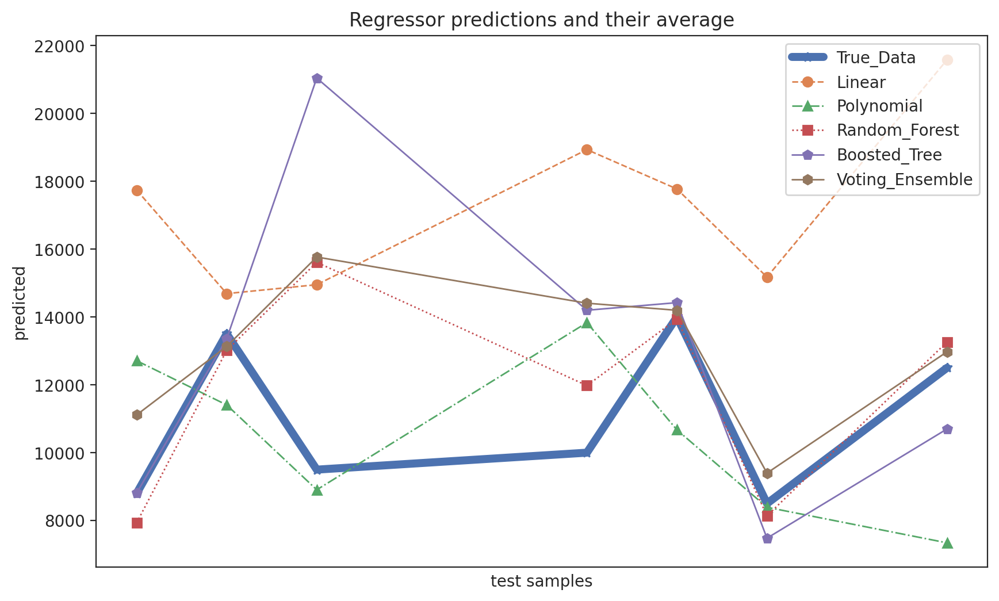

In [ ]:
import matplotlib.pyplot as plt

# Assuming merged_dfSSSS is your DataFrame
markers = ['*', 'o', '^', 's', 'p', 'h']  # List of markers
linestyles = ['-', '--', '-.', ':', '-', '-']  # List of line styles
linewidths = [5, 1, 1, 1, 1, 1]

# Create a figure and axis
fig, ax = plt.subplots(figsize=(10, 6))

# Plot each column as a separate line with a different marker and line style
for i, col in enumerate(merged_df_test_query_11.columns):
    ax.plot(merged_df_test_query_11.index, merged_df_test_query_11[col], marker=markers[i], linestyle=linestyles[i],linewidth=linewidths[i], label=col)

# Set labels and title
ax.tick_params(axis="x", which="both", bottom=False, top=False, labelbottom=False)
ax.set_ylabel("predicted")
ax.set_xlabel("test samples")
ax.legend(loc="best")
ax.set_title("Regressor predictions and their average")

# Rotate x-axis labels for better visibility
plt.xticks(rotation=45)

# Show the legend
ax.legend()

# Display the plot
plt.show()

In [ ]:
merged_df_test_query_2 = merged_df_test.query("122<=True_Data<=7495") # Min - 25%

In [ ]:
merged_df_test_query_22 = merged_df_test_query_2.head(7)

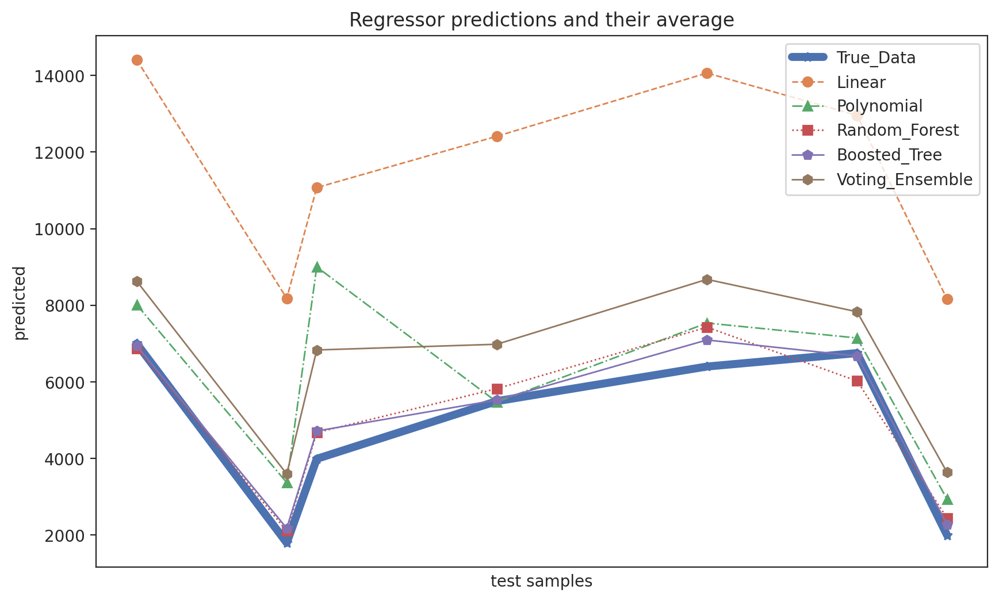

In [ ]:
import matplotlib.pyplot as plt

# Assuming merged_dfSSSS is your DataFrame
markers = ['*', 'o', '^', 's', 'p', 'h']  # List of markers
linestyles = ['-', '--', '-.', ':', '-', '-']  # List of line styles
linewidths = [5, 1, 1, 1, 1, 1]

# Create a figure and axis
fig, ax = plt.subplots(figsize=(10, 6))

# Plot each column as a separate line with a different marker and line style
for i, col in enumerate(merged_df_test_query_22.columns):
    ax.plot(merged_df_test_query_22.index, merged_df_test_query_22[col], marker=markers[i], linestyle=linestyles[i],linewidth=linewidths[i], label=col)

# Set labels and title
ax.tick_params(axis="x", which="both", bottom=False, top=False, labelbottom=False)
ax.set_ylabel("predicted")
ax.set_xlabel("test samples")
ax.legend(loc="best")
ax.set_title("Regressor predictions and their average")

# Rotate x-axis labels for better visibility
plt.xticks(rotation=45)

# Show the legend
ax.legend()

# Display the plot
plt.show()

In [ ]:
merged_df_test_query_4 = merged_df_test.query("20000<=True_Data<=100000") # 75% - 100000

In [ ]:
merged_df_test_query_44 = merged_df_test_query_4.head(7)

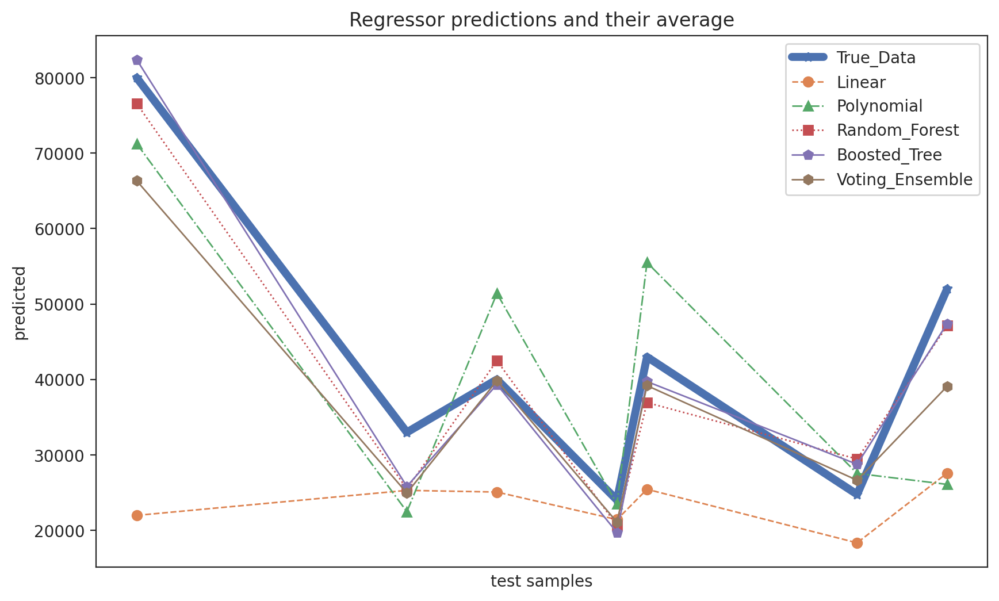

In [ ]:
import matplotlib.pyplot as plt

# Assuming merged_dfSSSS is your DataFrame
markers = ['*', 'o', '^', 's', 'p', 'h']  # List of markers
linestyles = ['-', '--', '-.', ':', '-', '-']  # List of line styles
linewidths = [5, 1, 1, 1, 1, 1]

# Create a figure and axis
fig, ax = plt.subplots(figsize=(10, 6))

# Plot each column as a separate line with a different marker and line style
for i, col in enumerate(merged_df_test_query_44.columns):
    ax.plot(merged_df_test_query_44.index, merged_df_test_query_44[col], marker=markers[i], linestyle=linestyles[i],linewidth=linewidths[i], label=col)

# Set labels and title
ax.tick_params(axis="x", which="both", bottom=False, top=False, labelbottom=False)
ax.set_ylabel("predicted")
ax.set_xlabel("test samples")
ax.legend(loc="best")
ax.set_title("Regressor predictions and their average")

# Rotate x-axis labels for better visibility
plt.xticks(rotation=45)

# Show the legend
ax.legend()

# Display the plot
plt.show()

In [ ]:
merged_df_test_query_5 = merged_df_test.query("200000<=True_Data<=1000000") # 200000 - 1000000

In [ ]:
merged_df_test_query_55 = merged_df_test_query_5.head(7)

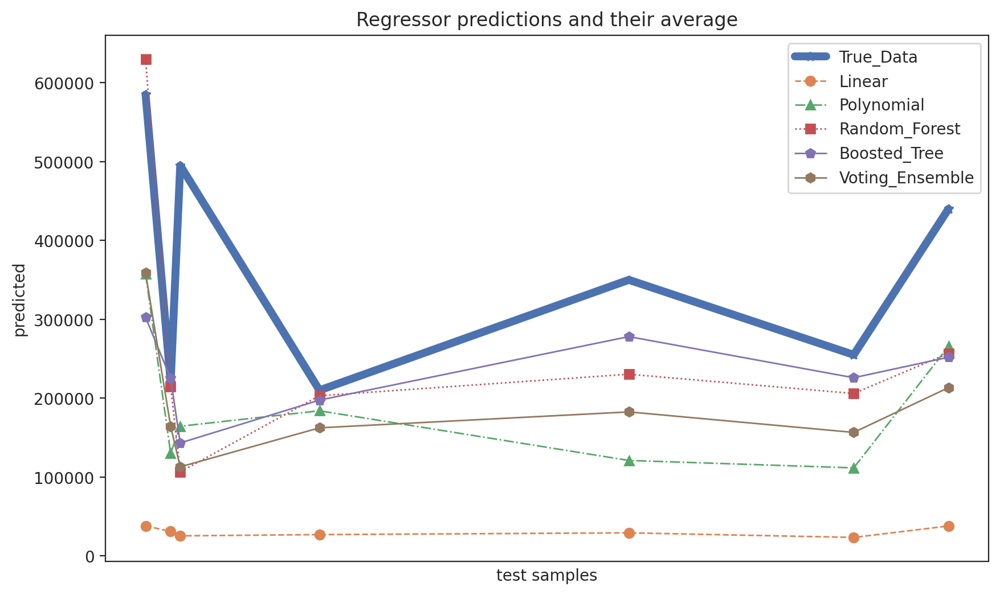

In [ ]:
import matplotlib.pyplot as plt

# Assuming merged_dfSSSS is your DataFrame
markers = ['*', 'o', '^', 's', 'p', 'h']  # List of markers
linestyles = ['-', '--', '-.', ':', '-', '-']  # List of line styles
linewidths = [5, 1, 1, 1, 1, 1]

# Create a figure and axis
fig, ax = plt.subplots(figsize=(10, 6))

# Plot each column as a separate line with a different marker and line style
for i, col in enumerate(merged_df_test_query_55.columns):
    ax.plot(merged_df_test_query_55.index, merged_df_test_query_55[col], marker=markers[i], linestyle=linestyles[i],linewidth=linewidths[i], label=col)

# Set labels and title
ax.tick_params(axis="x", which="both", bottom=False, top=False, labelbottom=False)
ax.set_ylabel("predicted")
ax.set_xlabel("test samples")
ax.legend(loc="best")
ax.set_title("Regressor predictions and their average")

# Rotate x-axis labels for better visibility
plt.xticks(rotation=45)

# Show the legend
ax.legend()

# Display the plot
plt.show()

In [ ]:
merged_df_test_query_6 = merged_df_test.query("1000000<=True_Data<=10000000") # 1000000 - 10000000

In [ ]:
merged_df_test_query_66 = merged_df_test_query_6.head(7)

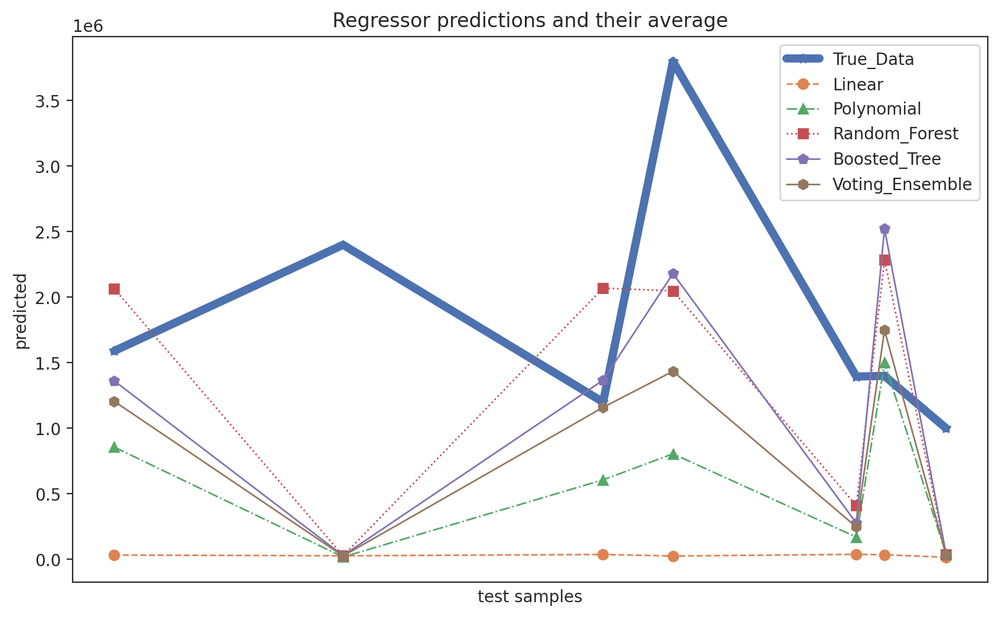

In [ ]:
import matplotlib.pyplot as plt

# Assuming merged_dfSSSS is your DataFrame
markers = ['*', 'o', '^', 's', 'p', 'h']  # List of markers
linestyles = ['-', '--', '-.', ':', '-', '-']  # List of line styles
linewidths = [5, 1, 1, 1, 1, 1]

# Create a figure and axis
fig, ax = plt.subplots(figsize=(10, 6))

# Plot each column as a separate line with a different marker and line style
for i, col in enumerate(merged_df_test_query_66.columns):
    ax.plot(merged_df_test_query_66.index, merged_df_test_query_66[col], marker=markers[i], linestyle=linestyles[i],linewidth=linewidths[i], label=col)

# Set labels and title
ax.tick_params(axis="x", which="both", bottom=False, top=False, labelbottom=False)
ax.set_ylabel("predicted")
ax.set_xlabel("test samples")
ax.legend(loc="best")
ax.set_title("Regressor predictions and their average")

# Rotate x-axis labels for better visibility
plt.xticks(rotation=45)

# Show the legend
ax.legend()

# Display the plot
plt.show()

# **9. MODEL EVALUATION & ANALYSIS (INTERPRETABILITY / EXPLAINABILITY)**

* Global and Local Explanations with SHAP
* Partial Dependency Plots

  * **Important**: If the features (predictors) are not independent, PDPs may not represent the true feature's change effects.

  * **Important**: "Shapley Values" can be sensitive to "correlated features", as it becomes difficult to disentangle the "individual contributions" of each feature to the output of the model.

  * **Important**: It is important to remark, that for the sake of properly working with both "Shapley Values" and "Partial Dependency Plots" we executed in the previous stages the followings techniques to handle and/or spot correlated features:
    * Correlation Coefficients during the Exploratory Data Analysis (EDA): Pearson Correlation Coefficient, and Spearman Correlation Coefficient.
    * Principal Component Analysis (PCA): using the "Loading Plot"
    * Regularization: using Elastic Net (for the Linear Model and Polynomial Model) to retain relevant features while shrinking the coefficients of correlated features, without completely removing them.
    
  * Linear Model
  * Polynomial Model
  * Random Forest
  * Boosted Tree

Information  | Shapley Values | Partial Dependency Plots (PDP) |
----------|-----------|------------|
Main Property | Quantify the contribution of each feature to the model's output for a especific prediction. | Shows how the predicted output changes as the value of a single feature is varied, holding other features. |
Pros | Can handle non-linear relationships. | Provide an intuitive visualization of feature effects. Can identify non-linear and interactive relationships.|
 |  |  Computationally efficient. Less sensitive to outliers as they summarize the average effect of a specific feature.|
Cons | Computationally expensive. Sensitive to correlated features and outliers. | Assume features are independent. |


## **9.1. SHAPLEY VALUES - LINEAR MODEL**

In [ ]:
!pip install --upgrade -q shap
import shap
shap.initjs()

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 540.5/540.5 kB 6.9 MB/s eta 0:00:00


In [ ]:
model_lr_shap = ElasticNet(alpha = 0.1, l1_ratio= 0.5)

#Transformed data of independent features (validation data after cross validation)
model_lr_shap = model_lr_shap.fit(X_transformed_lr_val_df, y_validation_after_fs)

In [ ]:
eval_results = cross_validate(
    model_lr_shap, X_transformed_lr_val_df, y_validation_after_fs, cv=5,
    scoring='neg_mean_absolute_error',
    return_train_score=True
    )
print(-eval_results['test_score'].mean(), eval_results['test_score'].std())
print(-eval_results['train_score'].mean(), eval_results['train_score'].std())

8565.252480494522 288.88628338248725
8565.290756667437 77.93064213904641


In [ ]:
coefs_lr_shap = pd.DataFrame({
    'feature': X_transformed_lr_val_df.columns,
    'coefficient': np.round(model_lr_shap.coef_, 3)
    })
coefs_lr_shap

,feature,coefficient
0,mileage,-3528.441
1,mileage_year,-2749.980
2,reg_code,16801.829
3,standard_make,10713.793
4,body_type,11756.680
5,year_of_registration,186.446
6,doors,-8504.994
7,standard_model,5152.639
8,fuel_type,6073.333


In [ ]:
#Transformed data of independent features (validation data after cross validation)

explainer_lr_shap = shap.LinearExplainer(model_lr_shap, X_transformed_lr_val_df)

In [ ]:
shap_values_lr_shap = explainer_lr_shap(X_transformed_lr_test_df)

In [ ]:
sv_test_lr = shap_values_lr_shap.values
sv_test_lr

array([[ -260.30902692,  -195.83853739, -4156.25797303, ...,
         1084.38669536,    -5.50251822,   -65.10780573],
       [  114.27482168,    95.4881042 ,  3583.72492752, ...,
        -1041.86172692,   139.403625  ,   -65.10780573],
       [   57.41380539,    51.38603053,  3841.66303937, ...,
        -1041.86172692,   -29.14372015,   -57.83172859],
       ...,
       [  -52.51041061,   -34.36650714, -5013.91575386, ...,
        -1041.86172692,   -33.24423188,   -57.83172859],
       [  -20.41297965,    -9.07081351, -1883.13236148, ...,
        -1041.86172692,   -40.57520502,   -57.83172859],
       [ -267.02444687,  -201.3823624 , -5435.53664204, ...,
        -1041.86172692,   -56.49636439,   -57.83172859]])

In [ ]:
#From numpy array to dataframe (Shapley Values)
sv_test_lr_df = pd.DataFrame(sv_test_lr)
sv_test_lr_df

,0,1,2,3,4,5,6,7,8
0,-260.309027,-195.838537,-4156.257973,142.856635,612.117942,-0.708530,1084.386695,-5.502518,-65.107806
1,114.274822,95.488104,3583.724928,399.333522,1489.514167,0.752357,-1041.861727,139.403625,-65.107806
2,57.413805,51.386031,3841.663039,-310.512867,-2024.894769,0.387135,-1041.861727,-29.143720,-57.831729
3,-47.058400,-29.668883,-852.609874,-199.494271,-319.117959,0.204524,-1041.861727,-11.716648,-65.107806
4,38.394370,36.427996,-4043.447014,17.930038,612.117942,-0.525919,1084.386695,9.070089,-57.831729
...,...,...,...,...,...,...,...,...,...
80396,-16.618957,-6.384687,-4156.257973,-223.136528,-2024.894769,-0.708530,-1041.861727,-34.555276,-57.831729
80397,141.462787,116.541302,4958.607662,399.333522,1489.514167,0.752357,-1041.861727,128.883343,-65.107806
80398,-52.510411,-34.366507,-5013.915754,-232.155549,-319.117959,-0.891141,-1041.861727,-33.244232,-57.831729
80399,-20.412980,-9.070814,-1883.132361,-364.133249,-2024.894769,0.021913,-1041.861727,-40.575205,-57.831729


In [ ]:
#Y value for the test set
y_test_after_fs

1          7000
9         79995
11         8795
16        13500
18         9495
          ...  
401983     3995
401986    42480
401995     3795
401996     5000
402001     2000
Name: price, Length: 80401, dtype: int64

In [ ]:
#Y value for the test set (reseting the index)
y_test_after_fs.reset_index(drop = True, inplace=True)

In [ ]:
#Merging the "Y value for the test set" and the "dataframe of Shapley Values"
shapley_test_lr_df = pd.concat([sv_test_lr_df, y_test_after_fs], axis=1)
shapley_test_lr_df

,0,1,2,3,4,5,6,7,8,price
0,-260.309027,-195.838537,-4156.257973,142.856635,612.117942,-0.708530,1084.386695,-5.502518,-65.107806,7000
1,114.274822,95.488104,3583.724928,399.333522,1489.514167,0.752357,-1041.861727,139.403625,-65.107806,79995
2,57.413805,51.386031,3841.663039,-310.512867,-2024.894769,0.387135,-1041.861727,-29.143720,-57.831729,8795
3,-47.058400,-29.668883,-852.609874,-199.494271,-319.117959,0.204524,-1041.861727,-11.716648,-65.107806,13500
4,38.394370,36.427996,-4043.447014,17.930038,612.117942,-0.525919,1084.386695,9.070089,-57.831729,9495
...,...,...,...,...,...,...,...,...,...,...
80396,-16.618957,-6.384687,-4156.257973,-223.136528,-2024.894769,-0.708530,-1041.861727,-34.555276,-57.831729,3995
80397,141.462787,116.541302,4958.607662,399.333522,1489.514167,0.752357,-1041.861727,128.883343,-65.107806,42480
80398,-52.510411,-34.366507,-5013.915754,-232.155549,-319.117959,-0.891141,-1041.861727,-33.244232,-57.831729,3795
80399,-20.412980,-9.070814,-1883.132361,-364.133249,-2024.894769,0.021913,-1041.861727,-40.575205,-57.831729,5000


In [ ]:
#Filter the values of the newly created dataframe in the previous step
shapley_test_lr_df_query_1 = shapley_test_lr_df.query("7495<=price<=20000") # 25% - 75%
shapley_test_lr_df_query_1

,0,1,2,3,4,5,6,7,8,price
2,57.413805,51.386031,3841.663039,-310.512867,-2024.894769,0.387135,-1041.861727,-29.143720,-57.831729,8795
3,-47.058400,-29.668883,-852.609874,-199.494271,-319.117959,0.204524,-1041.861727,-11.716648,-65.107806,13500
4,38.394370,36.427996,-4043.447014,17.930038,612.117942,-0.525919,1084.386695,9.070089,-57.831729,9495
7,100.999537,85.208291,4958.607662,-310.512867,-2024.894769,0.752357,-1041.861727,-29.143720,-57.831729,9995
8,150.318036,29.010708,3841.663039,-340.272418,-2024.894769,0.204524,-1041.861727,-36.032334,-57.831729,13999
...,...,...,...,...,...,...,...,...,...,...
80384,-24.169062,-11.917982,-902.304276,17.930038,-319.117959,0.204524,-1041.861727,13.347176,-65.107806,14100
80386,-161.072573,-118.207806,-1883.132361,-199.494271,612.117942,0.021913,1084.386695,-16.000864,-65.107806,9995
80388,102.574056,86.427532,3583.724928,-364.133249,-2024.894769,0.752357,-1041.861727,-40.575205,-57.831729,9499
80390,-65.595994,-44.128062,-1883.132361,-39.528354,4794.392982,0.021913,5336.883540,9.250087,-65.107806,15000


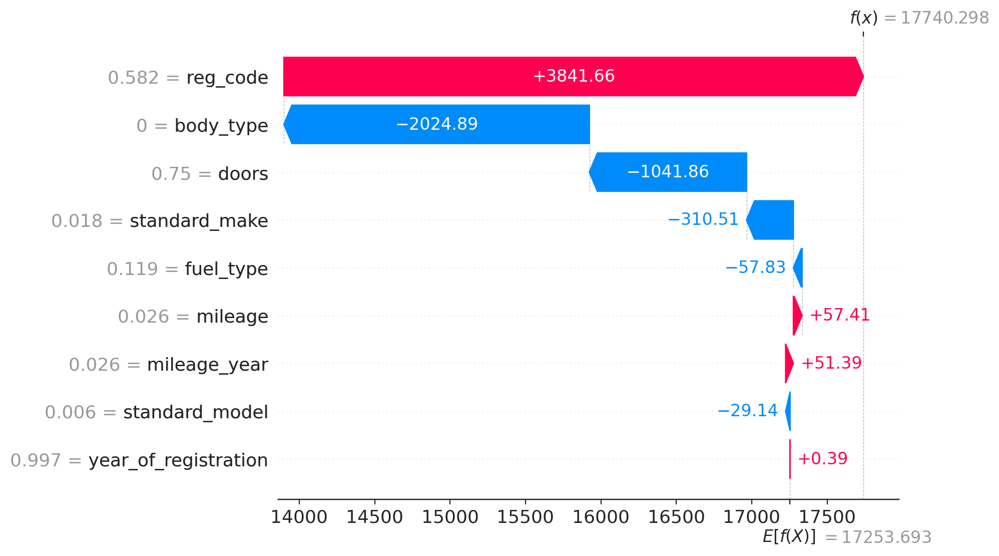

In [ ]:
shap.plots.waterfall(shap_values_lr_shap[2])

In [ ]:
#Filter the values of the newly created dataframe in the previous step
shapley_test_lr_df_query_2 = shapley_test_lr_df.query("122<=price<=7495") # Min - 25%
shapley_test_lr_df_query_2

,0,1,2,3,4,5,6,7,8,price
0,-260.309027,-195.838537,-4156.257973,142.856635,612.117942,-0.708530,1084.386695,-5.502518,-65.107806,7000
5,-191.143995,-142.331310,-5456.016151,-123.684946,-2024.894769,-1.073752,-1041.861727,-35.859583,-57.831729,1795
6,-532.606027,-406.741634,-1878.086794,-215.208241,-2024.894769,-0.160698,-1041.861727,-17.660648,-65.107806,3989
12,40.291382,38.029361,-1393.578993,-358.498695,-2024.894769,0.021913,-1041.861727,-43.758190,-57.831729,5495
19,101.549670,85.596845,96.494557,-310.512867,-2024.894769,0.387135,-1041.861727,-40.035920,-57.831729,6399
...,...,...,...,...,...,...,...,...,...,...
80395,-187.349973,-138.856597,-2957.700968,-199.494271,-2024.894769,-0.343308,-1041.861727,-38.282820,-57.831729,2895
80396,-16.618957,-6.384687,-4156.257973,-223.136528,-2024.894769,-0.708530,-1041.861727,-34.555276,-57.831729,3995
80398,-52.510411,-34.366507,-5013.915754,-232.155549,-319.117959,-0.891141,-1041.861727,-33.244232,-57.831729,3795
80399,-20.412980,-9.070814,-1883.132361,-364.133249,-2024.894769,0.021913,-1041.861727,-40.575205,-57.831729,5000


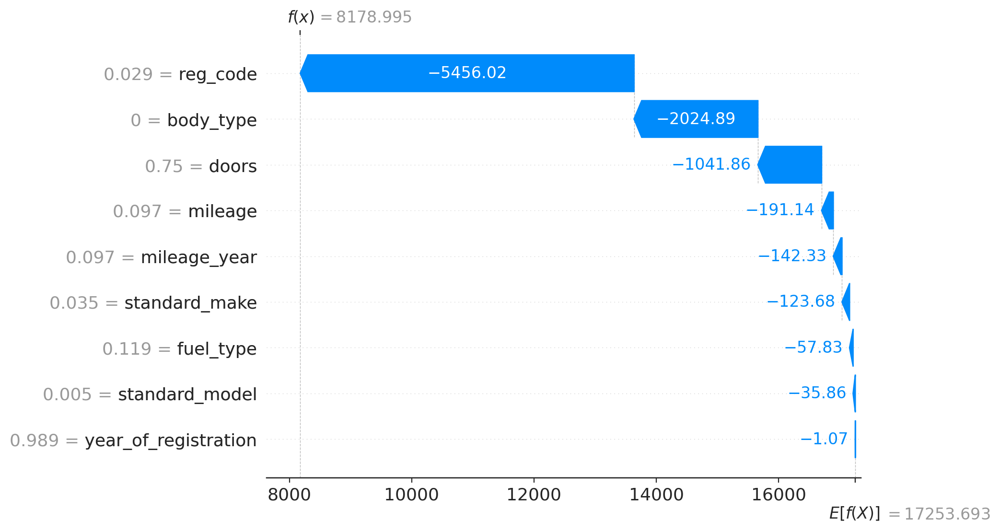

In [ ]:
shap.plots.waterfall(shap_values_lr_shap[5])

In [ ]:
#Filter the values of the newly created dataframe in the previous step
shapley_test_lr_df_query_3 = shapley_test_lr_df.query("20000<=price<=100000") # 75% - 100000
shapley_test_lr_df_query_3

,0,1,2,3,4,5,6,7,8,price
1,114.274822,95.488104,3583.724928,399.333522,1489.514167,0.752357,-1041.861727,139.403625,-65.107806,79995
10,78.231607,67.550119,1149.847823,17.930038,612.117942,0.569746,1084.386695,13.347176,5007.449753,32980
13,-69.735273,-47.679314,-4156.257973,1779.802539,4794.392982,-0.708530,5336.883540,230.370217,-57.831729,39990
17,65.449545,57.614734,3841.663039,-199.494271,1489.514167,0.387135,-1041.861727,9.373007,-65.107806,24000
18,135.141946,111.652530,7461.640649,17.930038,1489.514167,0.934968,-1041.861727,66.957745,-65.107806,42980
...,...,...,...,...,...,...,...,...,...,...
80382,97.201720,82.247043,1946.642080,-18.155295,612.117942,0.569746,1084.386695,4.650465,-65.107806,27990
80385,-12.824935,-2.995113,1149.847823,-39.528354,612.117942,0.569746,1084.386695,50.987764,-65.107806,26290
80393,150.280096,29.010708,3841.663039,-268.166758,-2024.894769,0.204524,-1041.861727,-0.063764,3716.856210,28820
80394,66.269054,58.282239,1149.847823,17.930038,612.117942,0.569746,1084.386695,9.070089,-65.107806,20800


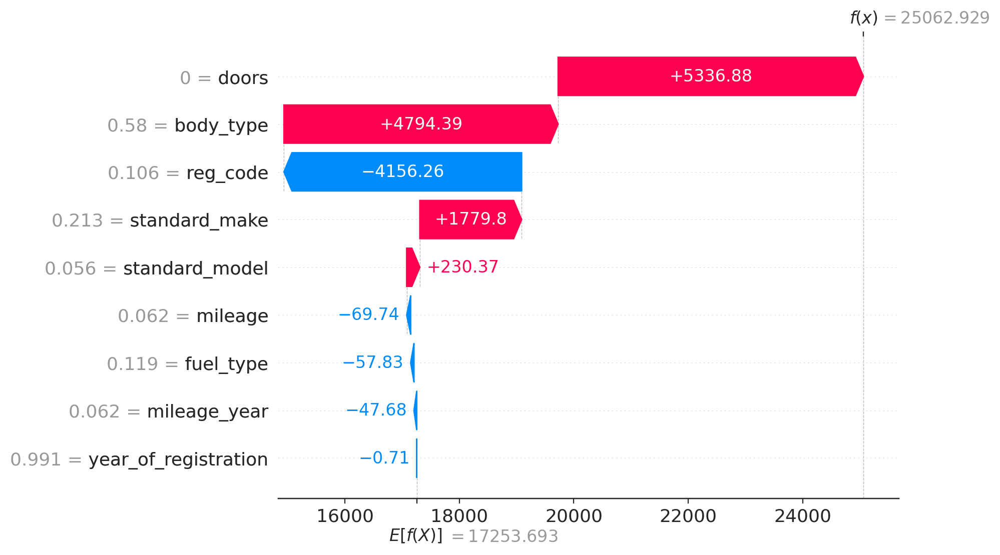

In [ ]:
shap.plots.waterfall(shap_values_lr_shap[13])

In [ ]:
#Filter the values of the newly created dataframe in the previous step
shapley_test_lr_df_query_4 = shapley_test_lr_df.query("200000<=price<=1000000") # 200000 - 1000000
shapley_test_lr_df_query_4

,0,1,2,3,4,5,6,7,8,price
20,144.369009,118.791755,3583.724928,6354.646318,4794.392982,0.752357,5336.883540,492.431079,-57.831729,585000
190,122.799990,102.057921,-852.609874,3963.746099,4794.392982,0.204524,5336.883540,287.117572,-57.831729,219995
255,-138.027679,-99.994807,3841.663039,2632.880301,612.117942,0.569746,1084.386695,253.879793,-57.831729,495000
1200,119.734420,99.715784,4958.607662,3963.746099,1489.514167,0.752357,-1041.861727,182.964774,-57.831729,209990
3299,145.677947,119.799994,-1393.578993,3963.746099,3548.469112,0.204524,5336.883540,287.117572,-57.831729,349990
...,...,...,...,...,...,...,...,...,...,...
79012,150.139717,123.260414,7461.640649,4152.674622,3548.469112,0.934968,5336.883540,210.769770,-57.831729,425850
79484,148.269264,121.811946,4958.607662,1012.932772,3548.469112,0.752357,5336.883540,234.047711,-57.831729,269500
79732,140.772275,116.006599,4958.607662,4152.674622,4794.392982,0.752357,5336.883540,210.769770,-57.831729,298950
79843,150.253538,123.348483,3583.724928,6354.646318,-2024.894769,0.752357,1084.386695,492.431079,-57.831729,799900


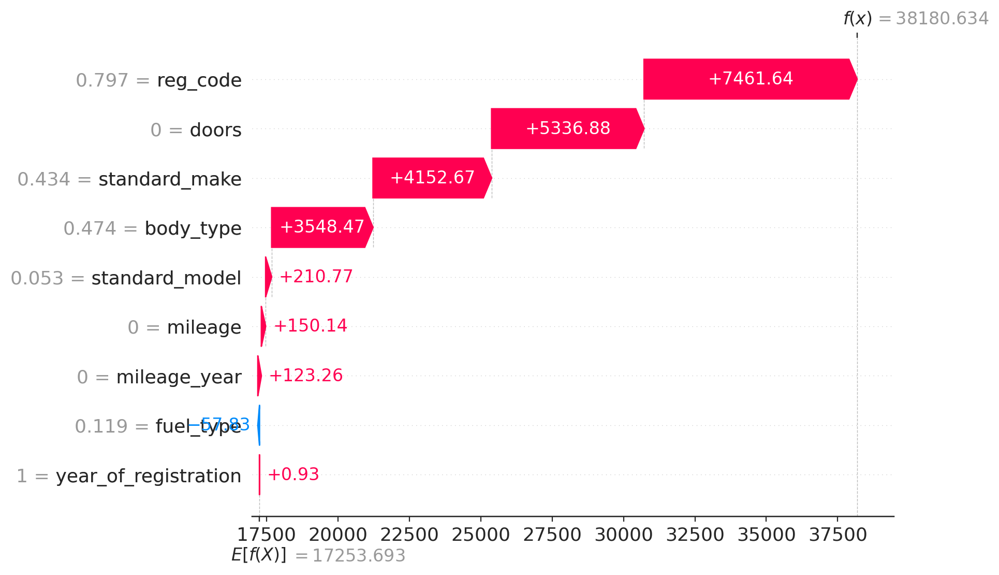

In [ ]:
shap.plots.waterfall(shap_values_lr_shap[79012])

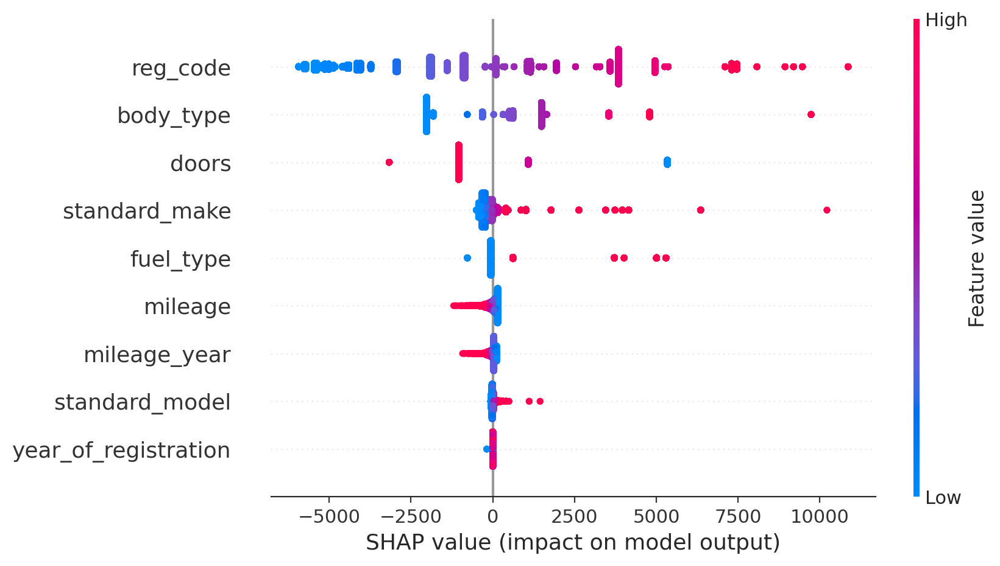

In [ ]:
shap.plots.beeswarm(shap_values_lr_shap)

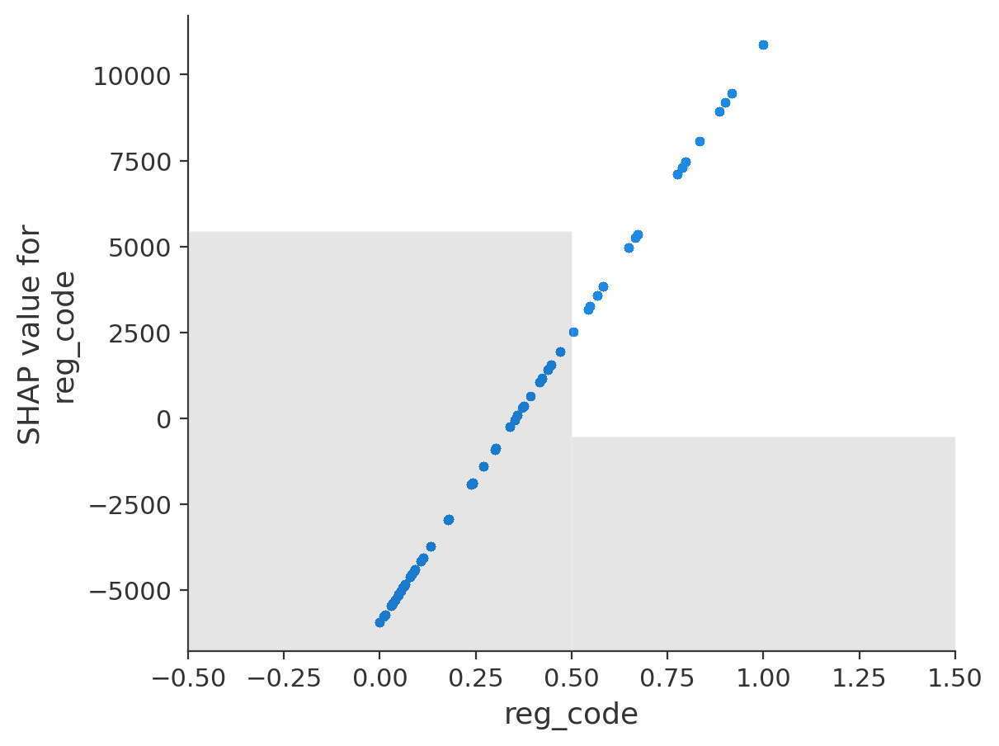

In [ ]:
shap.plots.scatter(shap_values_lr_shap[:, 'reg_code'])

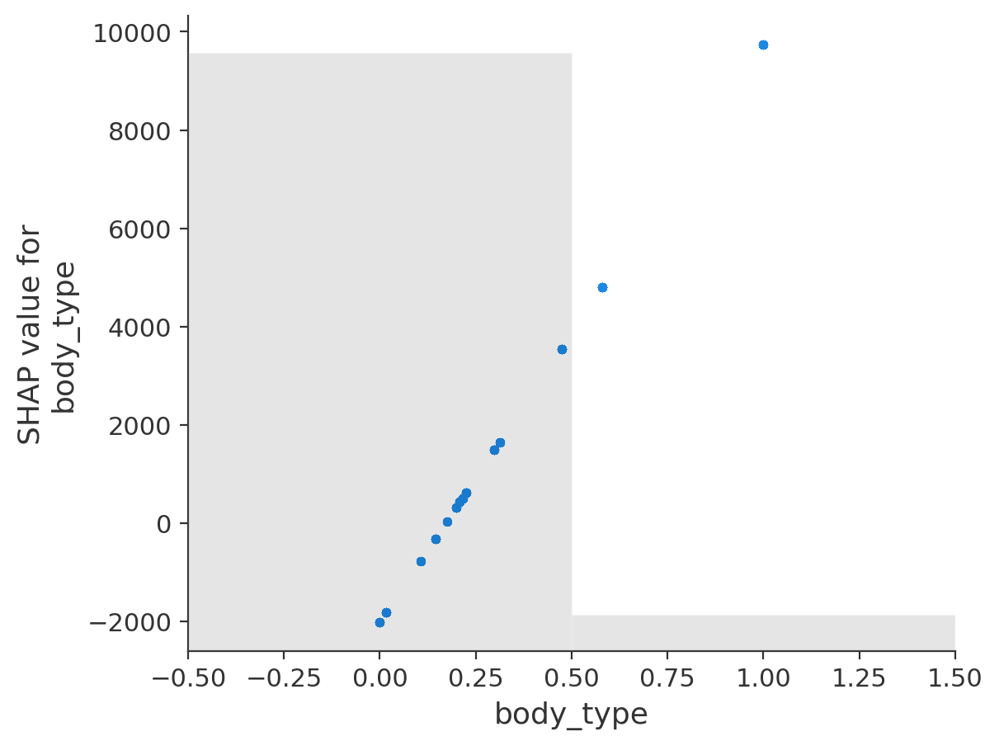

In [ ]:
shap.plots.scatter(shap_values_lr_shap[:, 'body_type'])

## **9.2. SHAPLEY VALUES - POLYNOMIAL MODEL**

In [ ]:
model_poly_lr_shap = LinearRegression(fit_intercept=True,n_jobs=-1)

#Transformed data of independent features (validation data after cross validation)
model_poly_lr_shap = model_poly_lr_shap.fit(X_transformed_poly_lr_val_df2, y_validation_after_fs)

In [ ]:
eval_results = cross_validate(
    model_poly_lr_shap, X_transformed_poly_lr_val_df2, y_validation_after_fs, cv=5,
    scoring='neg_mean_absolute_error',
    return_train_score=True
    )
print(-eval_results['test_score'].mean(), eval_results['test_score'].std())
print(-eval_results['train_score'].mean(), eval_results['train_score'].std())

4991.899857288971 766.0683559840535
4754.056702505242 244.88609642134475


In [ ]:
coefs_poly_lr_shap = pd.DataFrame({
    'feature': X_transformed_poly_lr_val_df2.columns,
    'coefficient': np.round(model_poly_lr_shap.coef_, 3)
    })
coefs_poly_lr_shap

,feature,coefficient
0,reg_code_standard_make,413805.396
1,reg_code_standard_model,1587406.544
2,standard_model^2,9435453.725


In [ ]:
#Transformed data of independent features (validation data after cross validation)

explainer_poly_lr_shap = shap.LinearExplainer(model_poly_lr_shap, X_transformed_poly_lr_val_df2)

In [ ]:
shap_values_poly_lr_shap = explainer_poly_lr_shap(X_transformed_poly_lr_test_df2)

In [ ]:
sv_test_poly_lr = shap_values_poly_lr_shap.values
sv_test_poly_lr

array([[-3231.08022538, -5026.99606576,  -880.2890588 ],
       [13799.30101731, 28062.38880078, 12236.69998536],
       [-1625.61884996, -1214.88340545, -1604.20133199],
       ...,
       [-5292.38510882, -6360.18552901, -1689.3349361 ],
       [-4603.34448923, -5346.06173786, -1811.7554686 ],
       [-5641.25101135, -6784.17663788, -1946.05907478]])

In [ ]:
#From numpy array to dataframe (Shapley Values)
sv_test_poly_lr_df = pd.DataFrame(sv_test_poly_lr)
sv_test_poly_lr_df

,0,1,2
0,-3231.080225,-5026.996066,-880.289059
1,13799.301017,28062.388801,12236.699985
2,-1625.618850,-1214.883405,-1604.201332
3,-2359.826287,-2280.715362,-1109.057093
4,-3608.619348,-4407.330089,-236.157403
...,...,...,...
80396,-4729.731345,-5975.896186,-1714.033035
80397,16637.920039,30997.622392,10781.957735
80398,-5292.385109,-6360.185529,-1689.334936
80399,-4603.344489,-5346.061738,-1811.755469


In [ ]:
#Merging the "Y value for the test set" and the "dataframe of Shapley Values"
shapley_test_poly_lr_df = pd.concat([sv_test_poly_lr_df, y_test_after_fs], axis=1)
shapley_test_poly_lr_df

,0,1,2,price
0,-3231.080225,-5026.996066,-880.289059,7000
1,13799.301017,28062.388801,12236.699985,79995
2,-1625.618850,-1214.883405,-1604.201332,8795
3,-2359.826287,-2280.715362,-1109.057093,13500
4,-3608.619348,-4407.330089,-236.157403,9495
...,...,...,...,...
80396,-4729.731345,-5975.896186,-1714.033035,3995
80397,16637.920039,30997.622392,10781.957735,42480
80398,-5292.385109,-6360.185529,-1689.334936,3795
80399,-4603.344489,-5346.061738,-1811.755469,5000


In [ ]:
#Filter the values of the newly created dataframe in the previous step
shapley_test_poly_lr_df_query_1 = shapley_test_poly_lr_df.query("7495<=price<=20000") # 25% - 75%
shapley_test_poly_lr_df_query_1

,0,1,2,price
2,-1625.618850,-1214.883405,-1604.201332,8795
3,-2359.826287,-2280.715362,-1109.057093,13500
4,-3608.619348,-4407.330089,-236.157403,9495
7,-1142.149818,-574.670838,-1604.201332,9995
8,-2294.618540,-2450.082391,-1740.395026,13999
...,...,...,...,...
80384,122.636455,-11.051067,-18.451478,14100
80386,-3068.883776,-3519.179467,-1250.792596,9995
80388,-2910.868670,-3358.445807,-1811.755469,9499
80390,-1577.976706,-1641.997221,-227.257453,15000


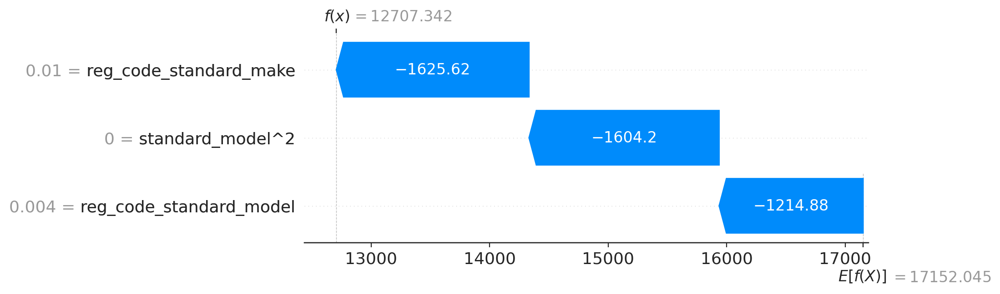

In [ ]:
shap.plots.waterfall(shap_values_poly_lr_shap[2])

In [ ]:
#Filter the values of the newly created dataframe in the previous step
shapley_test_poly_lr_df_query_2 = shapley_test_poly_lr_df.query("122<=price<=7495") # Min - 25%
shapley_test_poly_lr_df_query_2

,0,1,2,price
0,-3231.080225,-5026.996066,-880.289059,7000
5,-5443.315565,-6603.440617,-1737.391910,1795
6,-3212.051028,-3638.615140,-1302.197341,3989
12,-4392.928540,-5433.270281,-1853.015053,5495
19,-3246.713526,-4566.651634,-1804.051575,6399
...,...,...,...,...
80395,-3808.247476,-5611.497623,-1777.579619,2895
80396,-4729.731345,-5975.896186,-1714.033035,3995
80398,-5292.385109,-6360.185529,-1689.334936,3795
80399,-4603.344489,-5346.061738,-1811.755469,5000


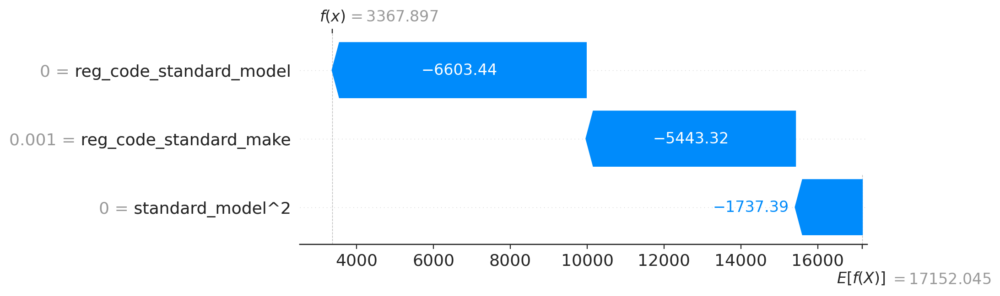

In [ ]:
shap.plots.waterfall(shap_values_poly_lr_shap[5])

In [ ]:
#Filter the values of the newly created dataframe in the previous step
shapley_test_poly_lr_df_query_3 = shapley_test_poly_lr_df.query("20000<=price<=100000") # 75% - 100000
shapley_test_poly_lr_df_query_3

,0,1,2,price
1,13799.301017,28062.388801,12236.699985,79995
10,2560.317601,2764.054259,-18.451478,32980
13,3471.806752,2676.908323,28096.457503,39990
17,870.097764,5691.560606,-221.166511,24000
18,10057.879976,24470.783045,3813.262918,42980
...,...,...,...,...
80382,2852.793720,2584.325558,-447.458703,27990
80385,1624.188720,7655.577719,2458.207609,26290
80393,-673.671228,3999.450727,-657.542316,28820
80394,2560.317601,2208.232042,-236.157403,20800


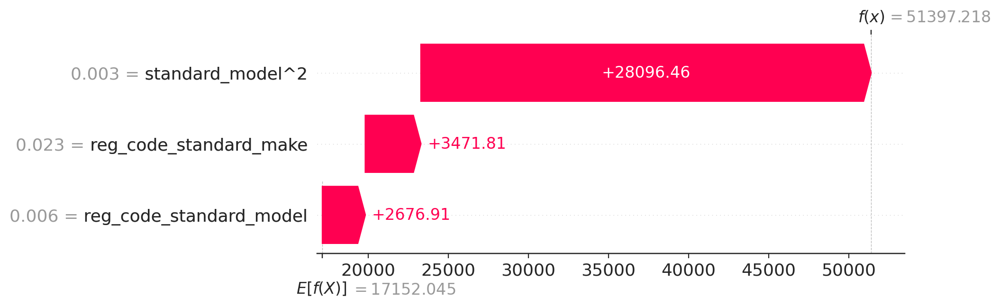

In [ ]:
shap.plots.waterfall(shap_values_poly_lr_shap[13])

In [ ]:
#Filter the values of the newly created dataframe in the previous step
shapley_test_poly_lr_df_query_4 = shapley_test_poly_lr_df.query("200000<=price<=1000000") # 200000 - 1000000
shapley_test_poly_lr_df_query_4

,0,1,2,price
20,144144.577629,89694.177694,106664.654895,585000
190,46304.678514,25581.569038,40969.192023,219995
255,64542.352395,49534.133170,33151.735103,495000
1200,105918.510397,41802.574004,19097.568010,209990
3299,40755.197375,22134.452562,40969.192023,349990
...,...,...,...,...
79012,137414.956067,59803.348017,24182.056813,425850
79484,32007.213600,52008.455497,28861.311842,269500
79732,110650.748789,47357.745903,24182.056813,298950
79843,144144.577629,89694.177694,106664.654895,799900


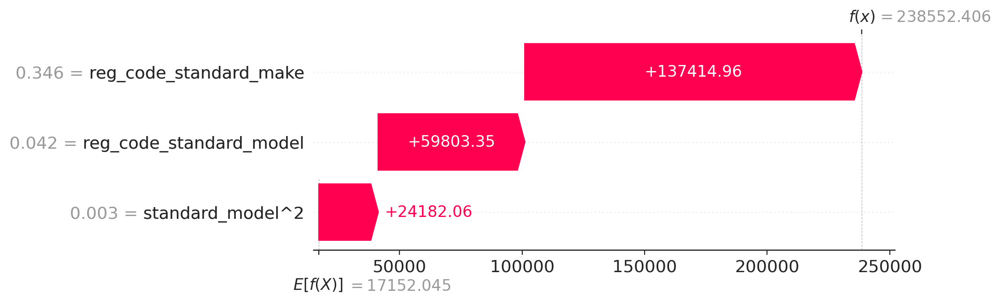

In [ ]:
shap.plots.waterfall(shap_values_poly_lr_shap[79012])

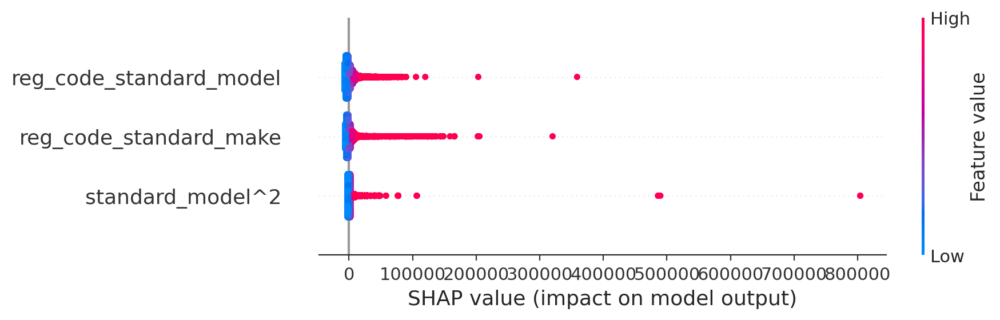

In [ ]:
shap.plots.beeswarm(shap_values_poly_lr_shap)

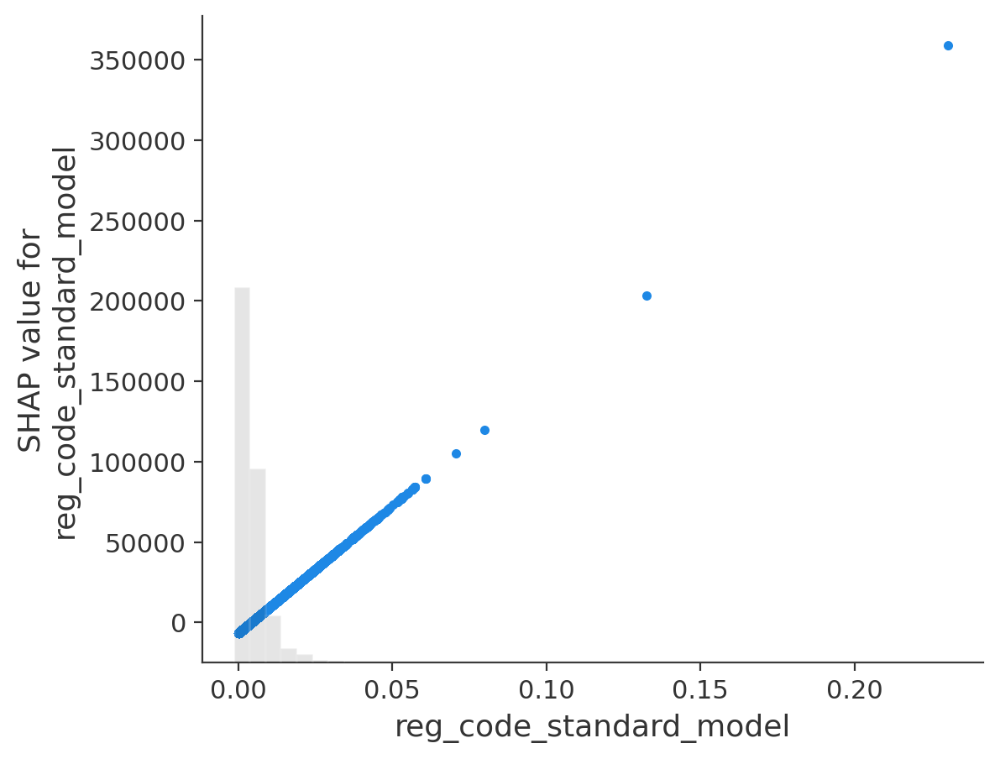

In [ ]:
shap.plots.scatter(shap_values_poly_lr_shap[:, 'reg_code_standard_model'])

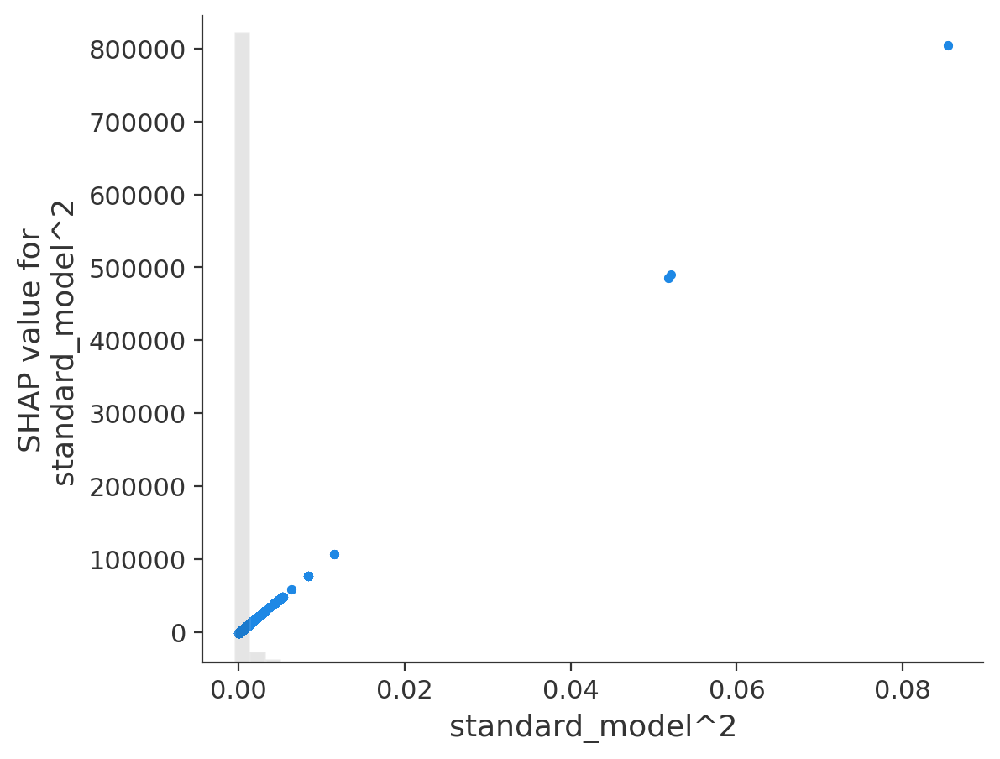

In [ ]:
shap.plots.scatter(shap_values_poly_lr_shap[:, 'standard_model^2'])

## **9.3. PARTIAL DEPENDENCY PLOT - LINEAR MODEL**

In [ ]:
x_test_data_lr_after_fs

,mileage,mileage_year,reg_code,standard_make,body_type,year_of_registration,doors,standard_model,fuel_type
1,108230.0,53.818996,61,Jaguar,Saloon,2011.0,4,XF,Diesel
9,9500.0,4.705300,19,Land Rover,SUV,2019.0,5,Range Rover,Diesel
11,24487.0,12.140307,17,Peugeot,Hatchback,2017.0,5,208,Petrol
16,52023.0,25.805060,66,Volkswagen,Estate,2016.0,5,Golf,Diesel
18,29500.0,14.662028,12,Mercedes-Benz,Saloon,2012.0,4,C Class,Petrol
...,...,...,...,...,...,...,...,...,...
401983,44000.0,21.879662,61,Mazda,Hatchback,2011.0,5,Mazda2,Petrol
401986,2334.0,1.156018,69,Land Rover,SUV,2019.0,5,Range Rover Velar,Diesel
401995,53460.0,26.597015,10,SEAT,Estate,2010.0,5,Ibiza,Petrol
401996,45000.0,22.332506,15,Vauxhall,Hatchback,2015.0,5,Corsa,Petrol


In [ ]:
x_test_data_lr_after_fs2 = x_test_data_lr_after_fs.copy()

In [ ]:
x_test_data_lr_after_fs2.reset_index(drop = True, inplace=True)

In [ ]:
print(x_test_data_lr_after_fs2)

        mileage  mileage_year reg_code  standard_make  body_type  \
0      108230.0     53.818996       61         Jaguar     Saloon   
1        9500.0      4.705300       19     Land Rover        SUV   
2       24487.0     12.140307       17        Peugeot  Hatchback   
3       52023.0     25.805060       66     Volkswagen     Estate   
4       29500.0     14.662028       12  Mercedes-Benz     Saloon   
...         ...           ...      ...            ...        ...   
80396   44000.0     21.879662       61          Mazda  Hatchback   
80397    2334.0      1.156018       69     Land Rover        SUV   
80398   53460.0     26.597015       10           SEAT     Estate   
80399   45000.0     22.332506       15       Vauxhall  Hatchback   
80400  110000.0     54.753609       59        Peugeot  Hatchback   

       year_of_registration  doors     standard_model fuel_type  
0                    2011.0      4                 XF    Diesel  
1                    2019.0      5        Range Rov

In [ ]:
selected_rows11 = x_test_data_lr_after_fs2.loc[[2, 3, 4, 7, 8]]
print(selected_rows11)

   mileage  mileage_year reg_code  standard_make  body_type  \
2  24487.0     12.140307       17        Peugeot  Hatchback   
3  52023.0     25.805060       66     Volkswagen     Estate   
4  29500.0     14.662028       12  Mercedes-Benz     Saloon   
7  12999.0      6.438336       69        Peugeot  Hatchback   
8      0.0           NaN      NaN           Fiat  Hatchback   

   year_of_registration  doors standard_model fuel_type  
2                2017.0      5            208    Petrol  
3                2016.0      5           Golf    Diesel  
4                2012.0      4        C Class    Petrol  
7                2019.0      5            208    Petrol  
8                   NaN      5          Panda    Petrol  


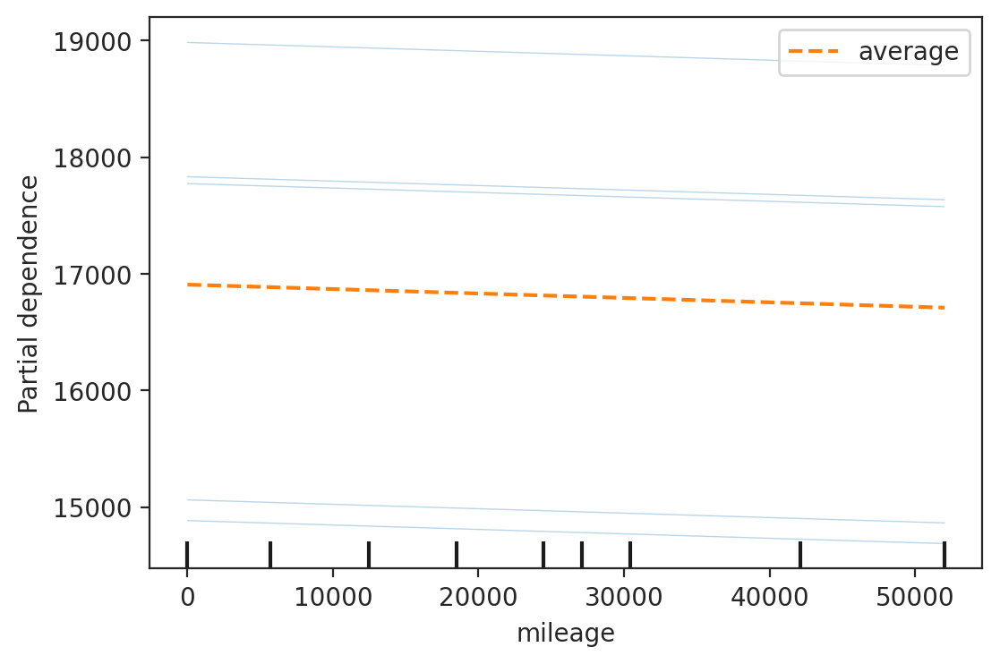

In [ ]:
from sklearn.inspection import PartialDependenceDisplay

PartialDependenceDisplay.from_estimator(best_model_lin_regression, selected_rows11, features=['mileage'], kind='both')

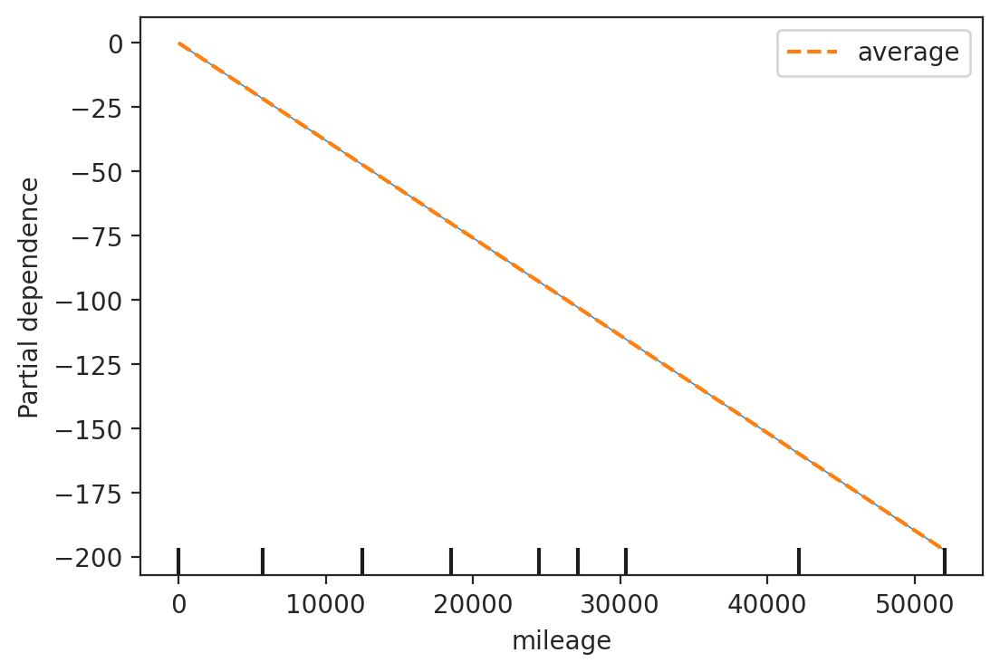

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_lin_regression, selected_rows11, features=['mileage'], kind='both', centered=True)

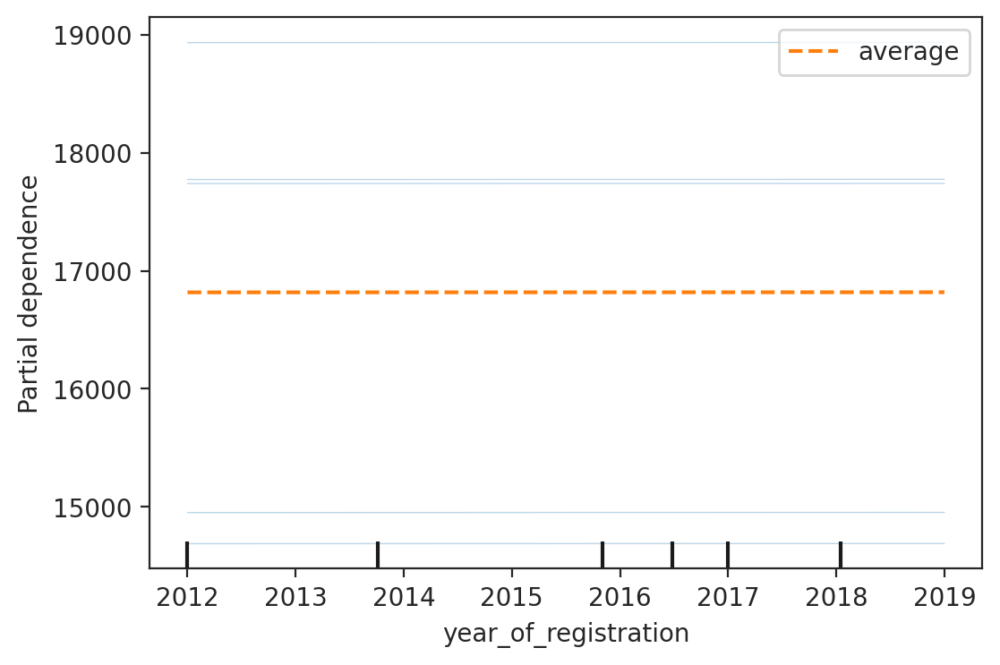

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_lin_regression, selected_rows11, features=['year_of_registration'], kind='both')

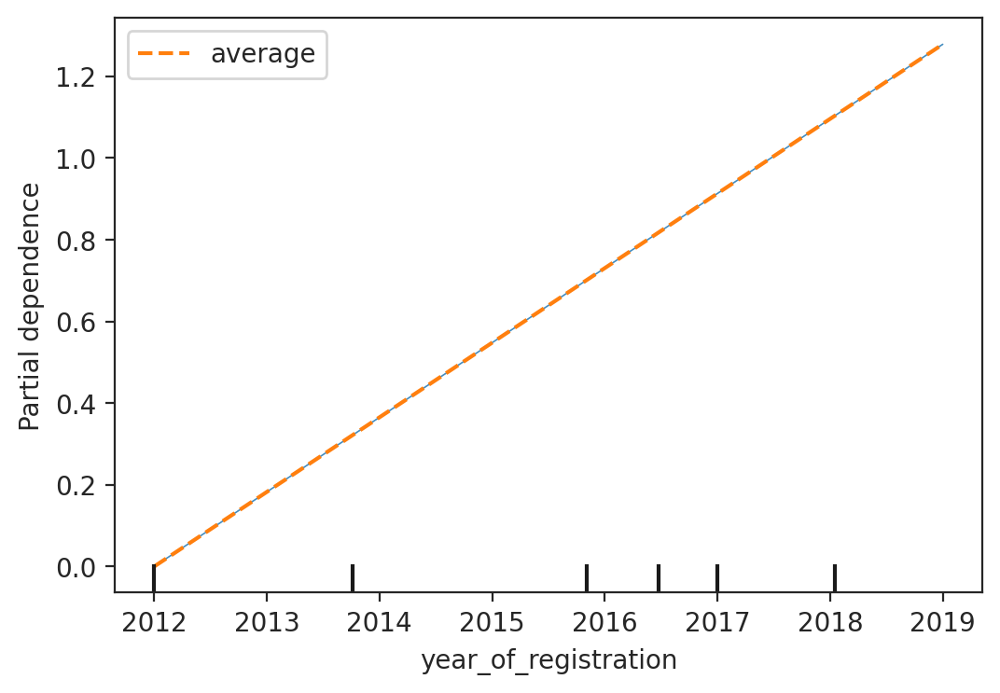

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_lin_regression, selected_rows11, features=['year_of_registration'], kind='both', centered=True)

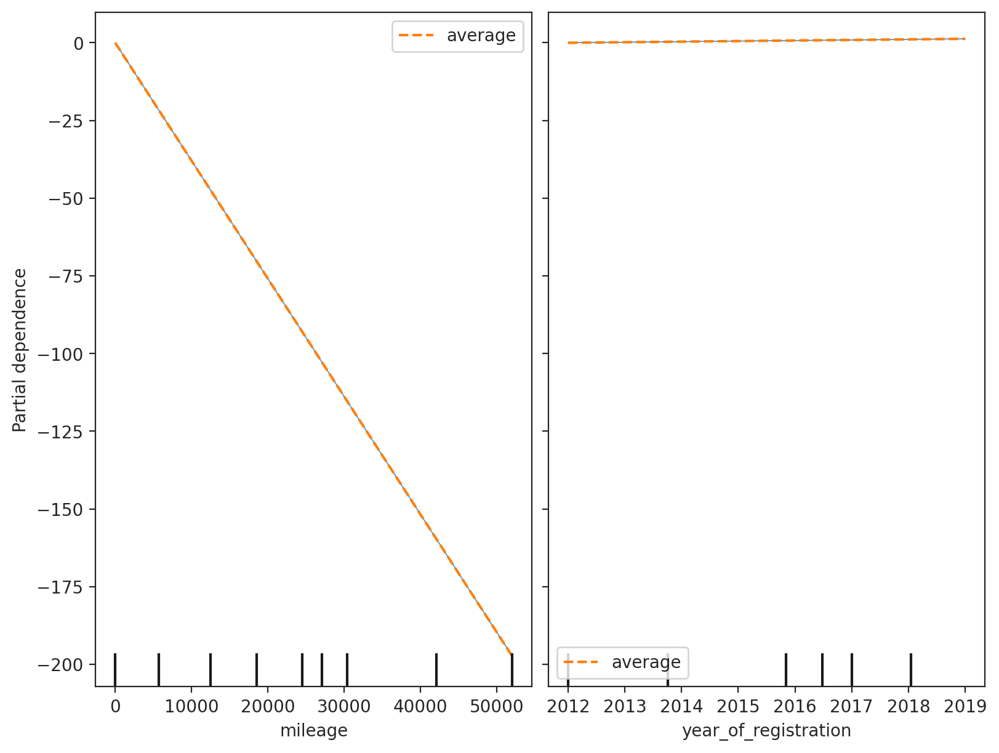

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_lin_regression,
                                        selected_rows11,
                                        features=['mileage', 'year_of_registration'],
                                        kind='both',
                                        centered=True,
                                        subsample=100,
                                        grid_resolution=30,
                                        n_jobs=-1,
                                        random_state=0,ax=ax, n_cols=2);

In [ ]:
selected_rows12 = x_test_data_lr_after_fs2.loc[[5, 6, 12, 19, 5000]]
print(selected_rows12)

       mileage  mileage_year reg_code  standard_make  body_type  \
5      90000.0     44.798407       09     Mitsubishi  Hatchback   
6     180000.0     89.374379       64          SKODA  Hatchback   
12     29000.0     14.392060       65        Citroen  Hatchback   
19     12854.0      6.372831       67        Peugeot  Hatchback   
5000   62552.0     31.135889       59  Mercedes-Benz     Saloon   

      year_of_registration  doors standard_model fuel_type  
5                   2009.0      5           Colt    Petrol  
6                   2014.0      5        Octavia    Diesel  
12                  2015.0      5             C1    Petrol  
19                  2017.0      5            108    Petrol  
5000                2009.0      4        C Class    Diesel  


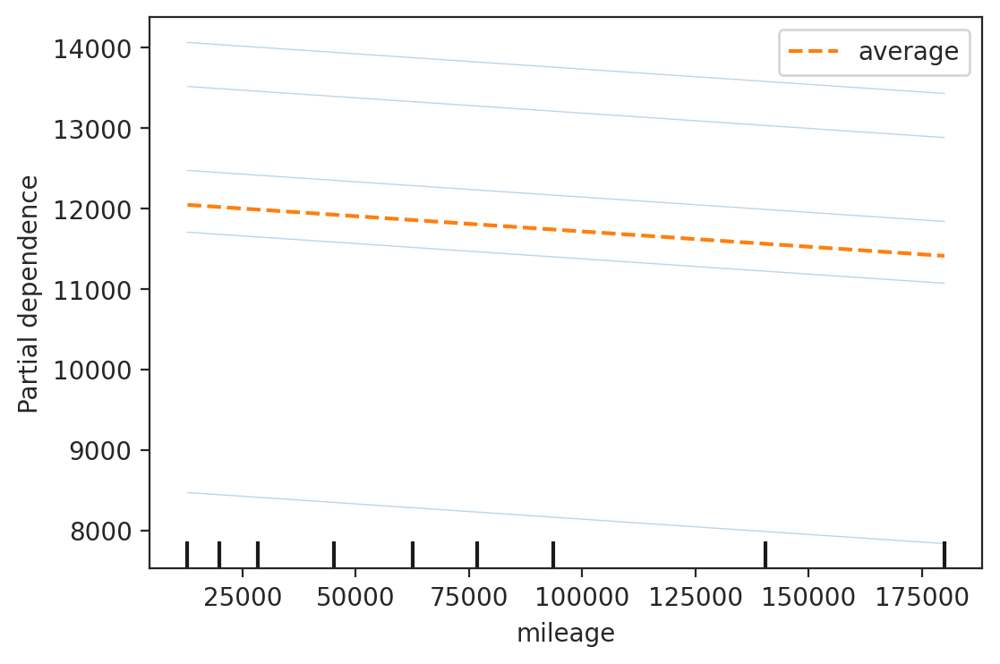

In [ ]:
from sklearn.inspection import PartialDependenceDisplay

PartialDependenceDisplay.from_estimator(best_model_lin_regression, selected_rows12, features=['mileage'], kind='both')

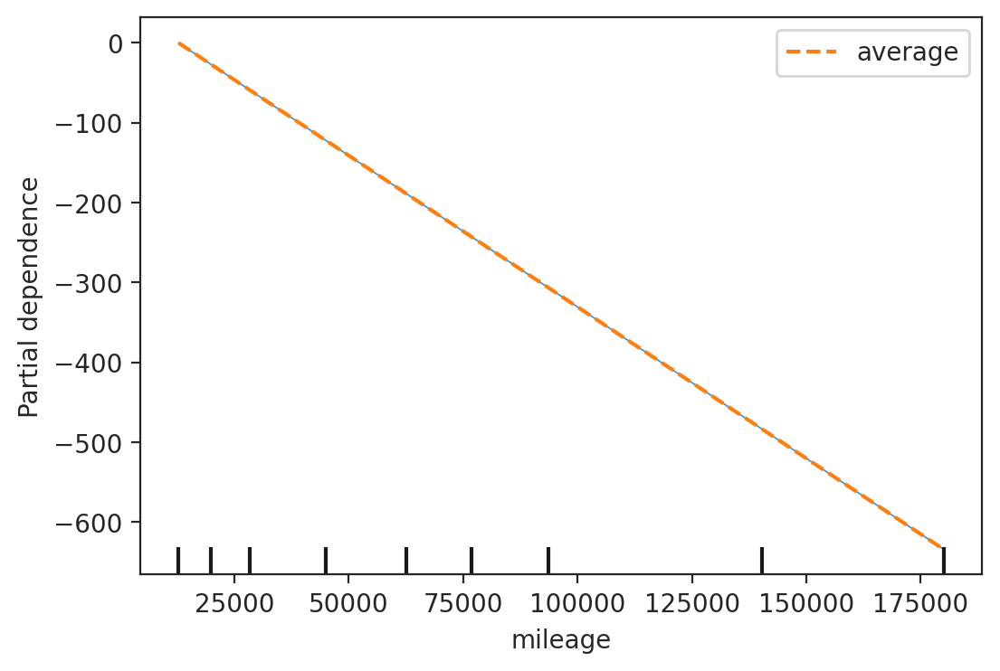

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_lin_regression, selected_rows12, features=['mileage'], kind='both', centered=True)

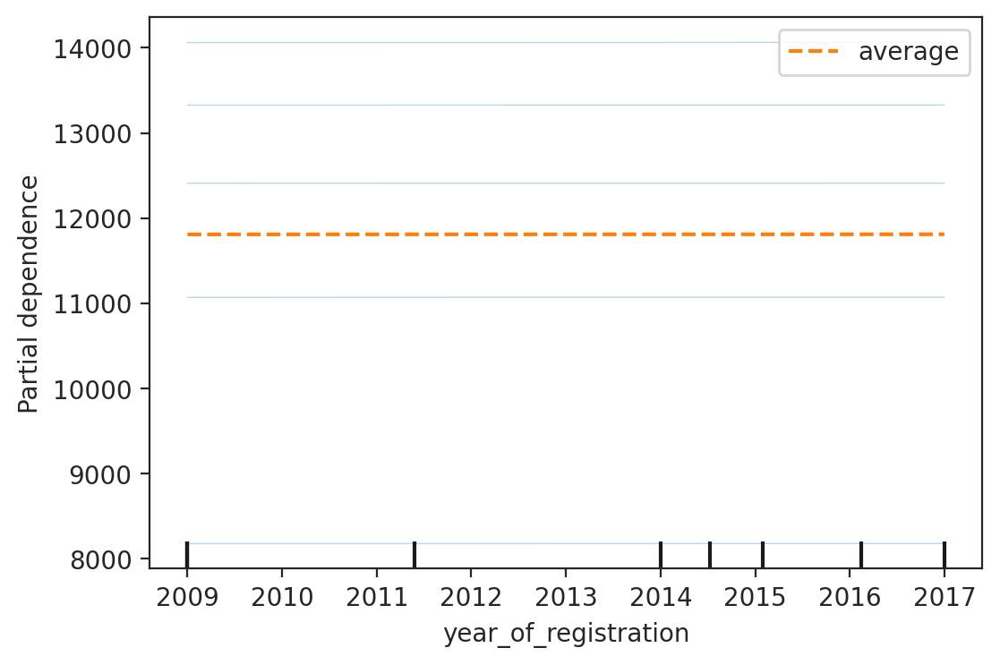

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_lin_regression, selected_rows12, features=['year_of_registration'], kind='both')

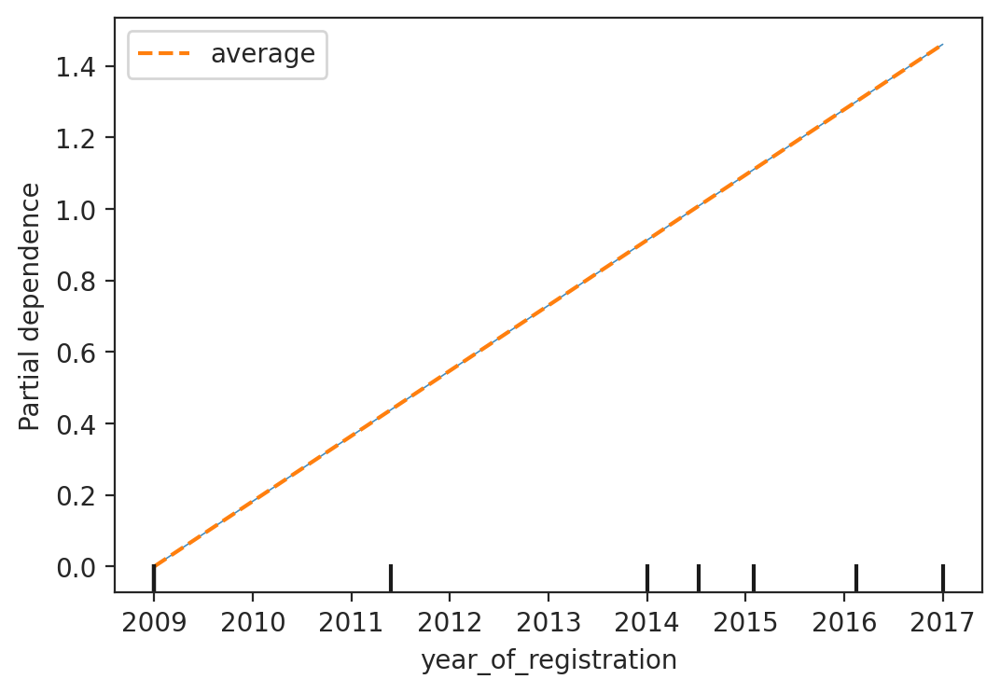

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_lin_regression, selected_rows12, features=['year_of_registration'], kind='both', centered=True)

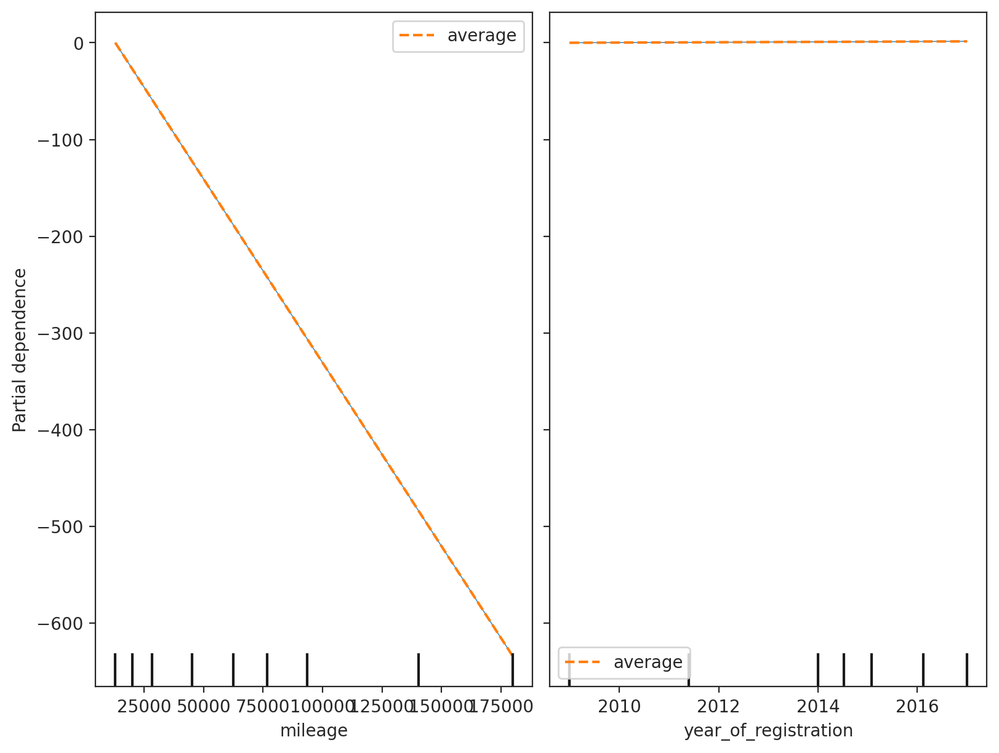

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_lin_regression,
                                        selected_rows12,
                                        features=['mileage', 'year_of_registration'],
                                        kind='both',
                                        centered=True,
                                        subsample=100,
                                        grid_resolution=30,
                                        n_jobs=-1,
                                        random_state=0,ax=ax, n_cols=2);

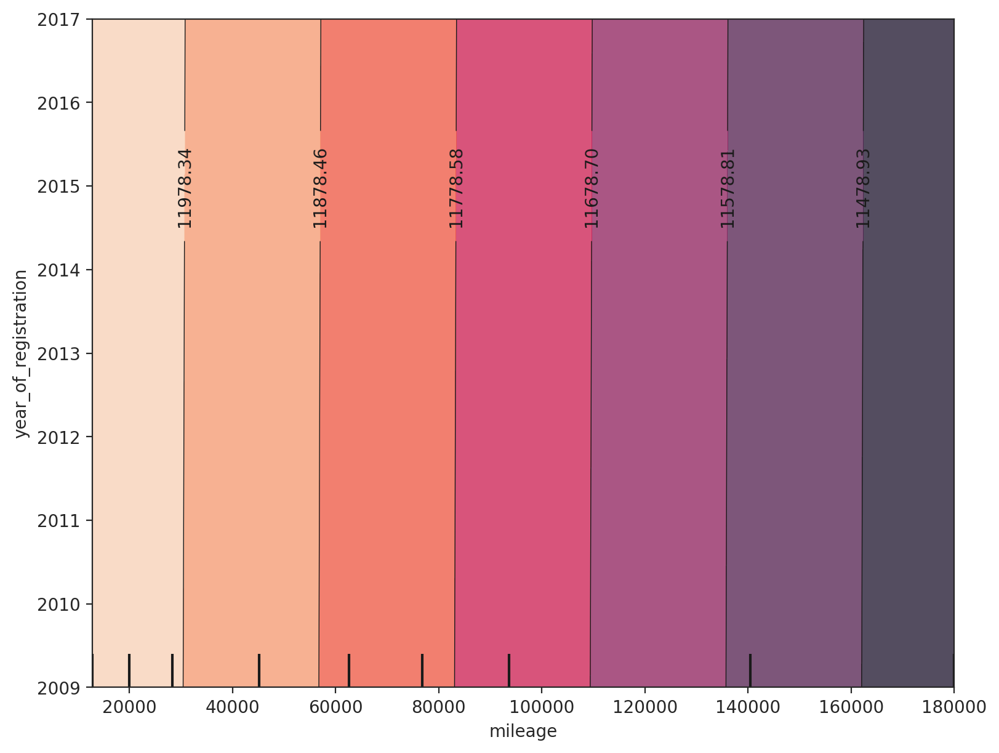

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_lin_regression,
                                        selected_rows12,
                                        features=[('mileage', 'year_of_registration')],
                                        kind='average',
                                        subsample=100,
                                        grid_resolution=30,
                                        random_state=0,
                                        ax=ax, n_cols=2);

In [ ]:
selected_rows13 = x_test_data_lr_after_fs2.loc[[1, 10, 13, 17, 18]]
print(selected_rows13)

    mileage  mileage_year reg_code  standard_make body_type  \
1    9500.0      4.705300       19     Land Rover       SUV   
10  19000.0      9.415263       18  Mercedes-Benz    Saloon   
13  58000.0     28.841372       61        Bentley     Coupe   
17  22369.0     11.090233       17     Volkswagen       SUV   
18   4000.0      1.980198       70  Mercedes-Benz       SUV   

    year_of_registration  doors standard_model              fuel_type  
1                 2019.0      5    Range Rover                 Diesel  
10                2018.0      4        E Class  Petrol Plug-in Hybrid  
13                2011.0      2    Continental                 Petrol  
17                2017.0      5         Tiguan                 Diesel  
18                2020.0      5      GLB Class                 Diesel  


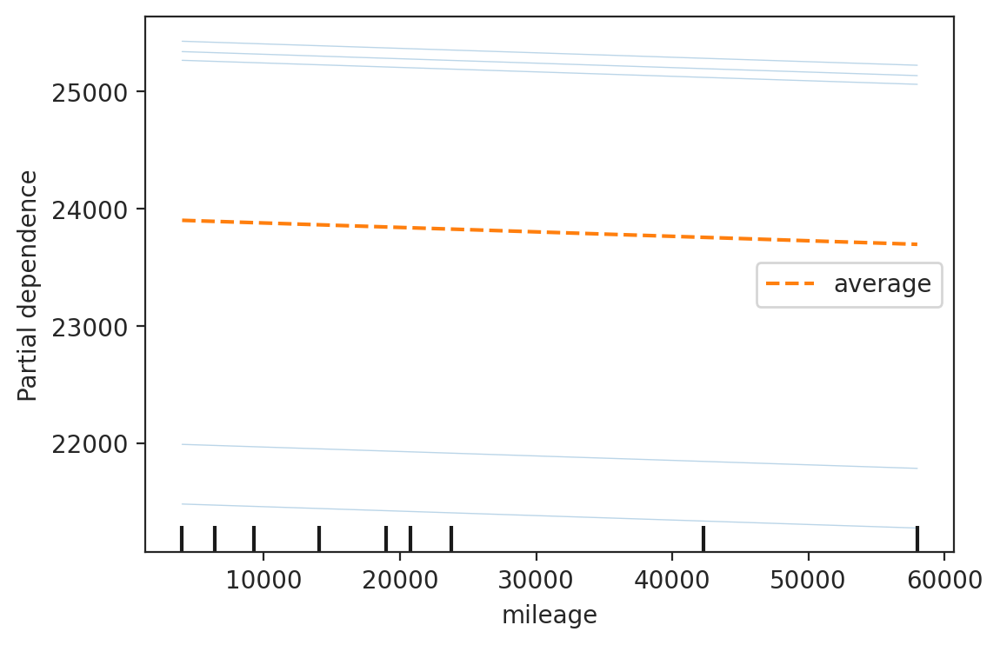

In [ ]:
from sklearn.inspection import PartialDependenceDisplay

PartialDependenceDisplay.from_estimator(best_model_lin_regression, selected_rows13, features=['mileage'], kind='both')

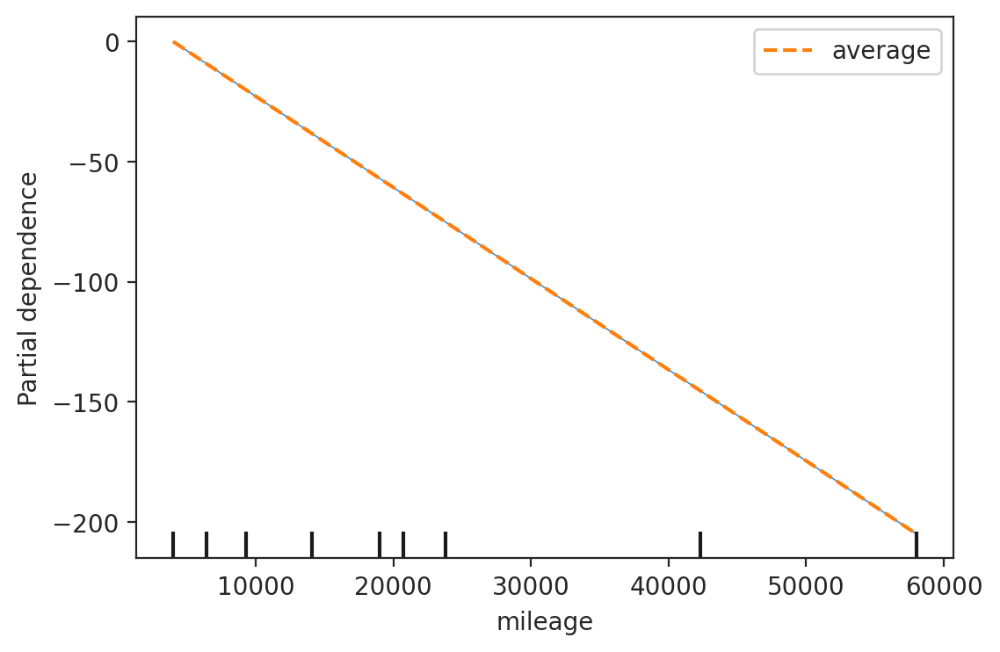

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_lin_regression, selected_rows13, features=['mileage'], kind='both', centered=True)

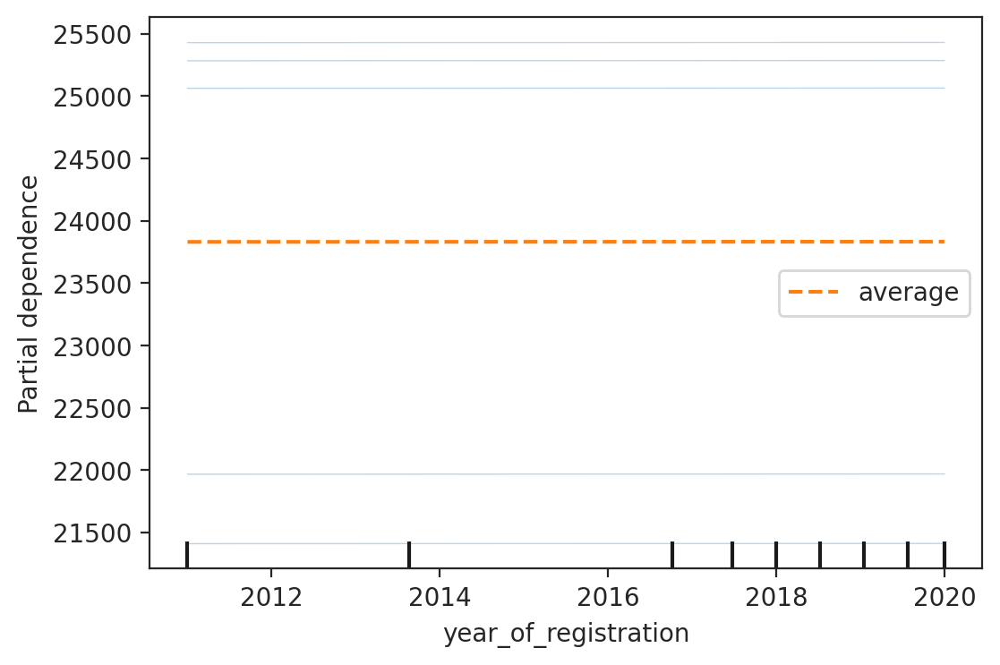

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_lin_regression, selected_rows13, features=['year_of_registration'], kind='both')

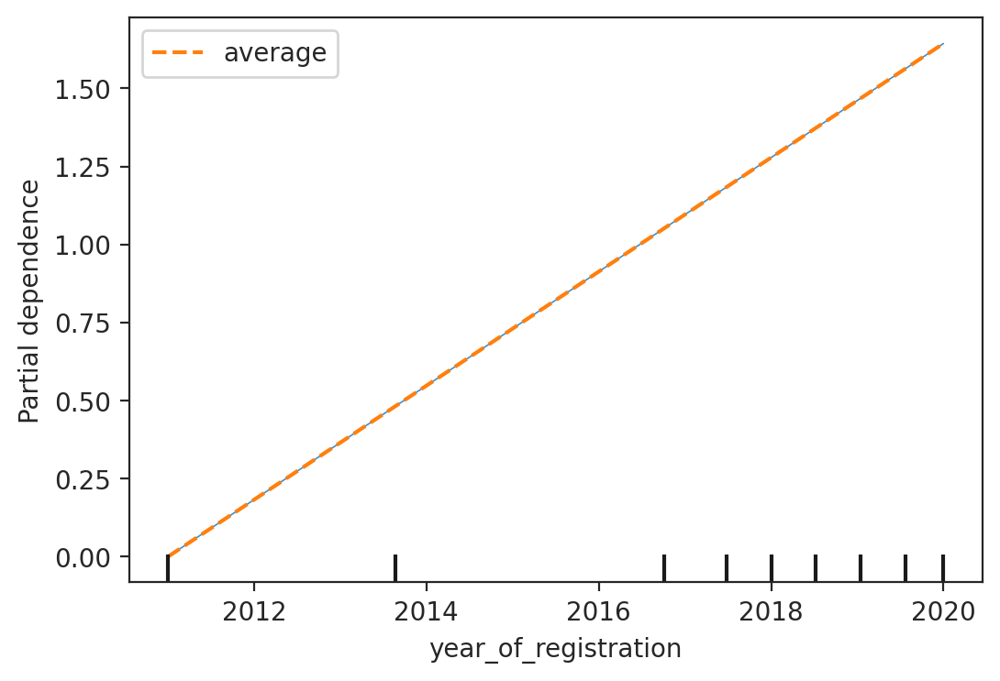

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_lin_regression, selected_rows13, features=['year_of_registration'], kind='both', centered=True)

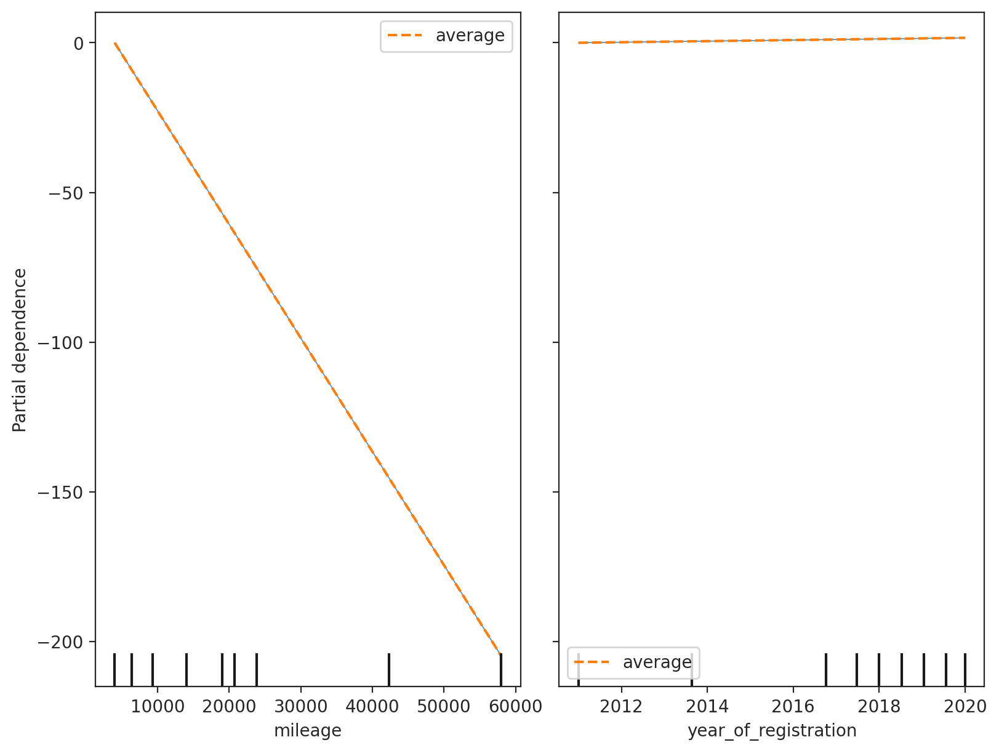

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_lin_regression,
                                        selected_rows13,
                                        features=['mileage', 'year_of_registration'],
                                        kind='both',
                                        centered=True,
                                        subsample=100,
                                        grid_resolution=30,
                                        n_jobs=-1,
                                        random_state=0,ax=ax, n_cols=2);

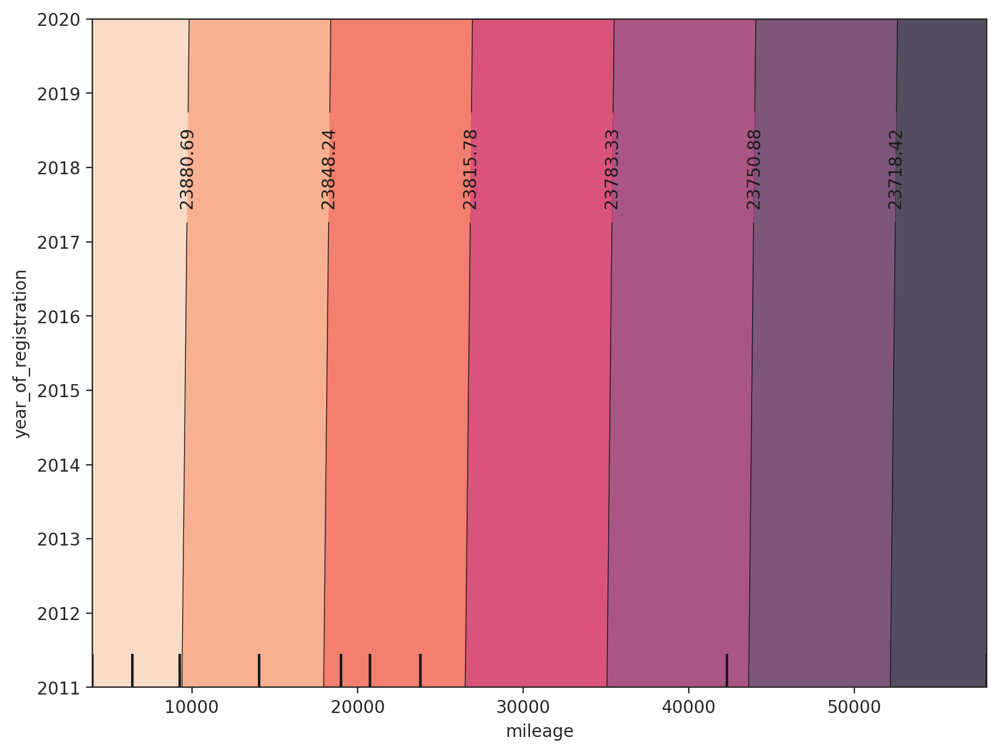

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_lin_regression,
                                        selected_rows13,
                                        features=[('mileage', 'year_of_registration')],
                                        kind='average',
                                        subsample=100,
                                        grid_resolution=30,
                                        random_state=0,
                                        ax=ax, n_cols=2);

In [ ]:
selected_rows14 = x_test_data_lr_after_fs2.loc[[20, 190, 255, 1200, 79012]]
print(selected_rows14)

       mileage  mileage_year reg_code standard_make    body_type  \
20      1568.0      0.776622       19       McLaren        Coupe   
190     7253.0      3.597718       66   Lamborghini        Coupe   
255    76000.0     37.661051      NaN  Aston Martin       Saloon   
1200    8061.0      3.992571       69   Lamborghini          SUV   
79012     47.0      0.023267       70       Ferrari  Convertible   

       year_of_registration  doors standard_model fuel_type  
20                   2019.0      2          Senna    Petrol  
190                  2016.0      2      Aventador    Petrol  
255                  2018.0      4            DB4    Petrol  
1200                 2019.0      5           Urus    Petrol  
79012                2020.0      2      488 Pista    Petrol  


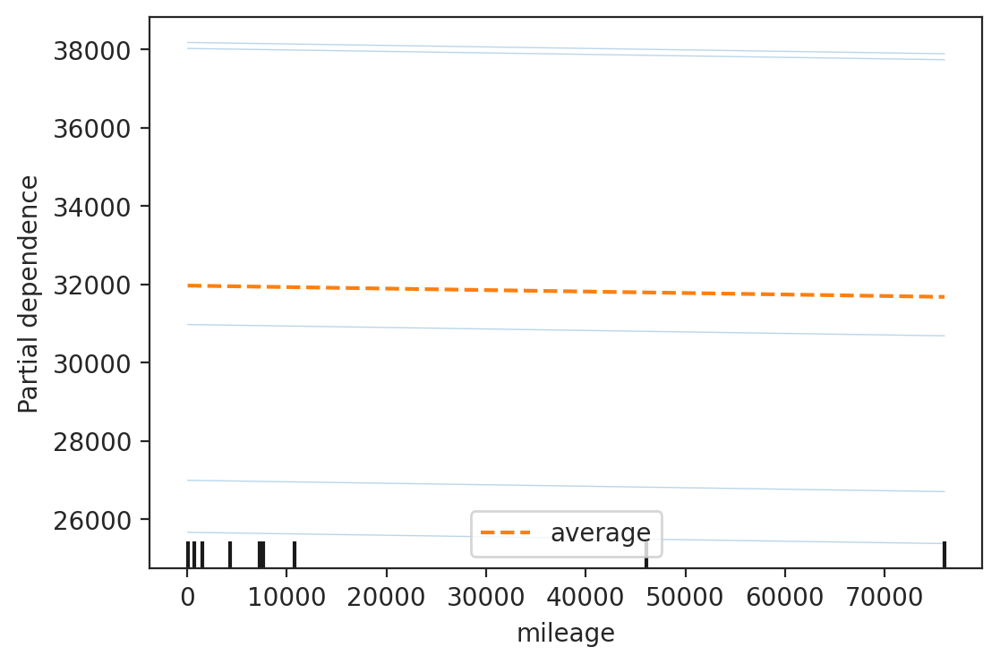

In [ ]:
from sklearn.inspection import PartialDependenceDisplay

PartialDependenceDisplay.from_estimator(best_model_lin_regression, selected_rows14, features=['mileage'], kind='both')

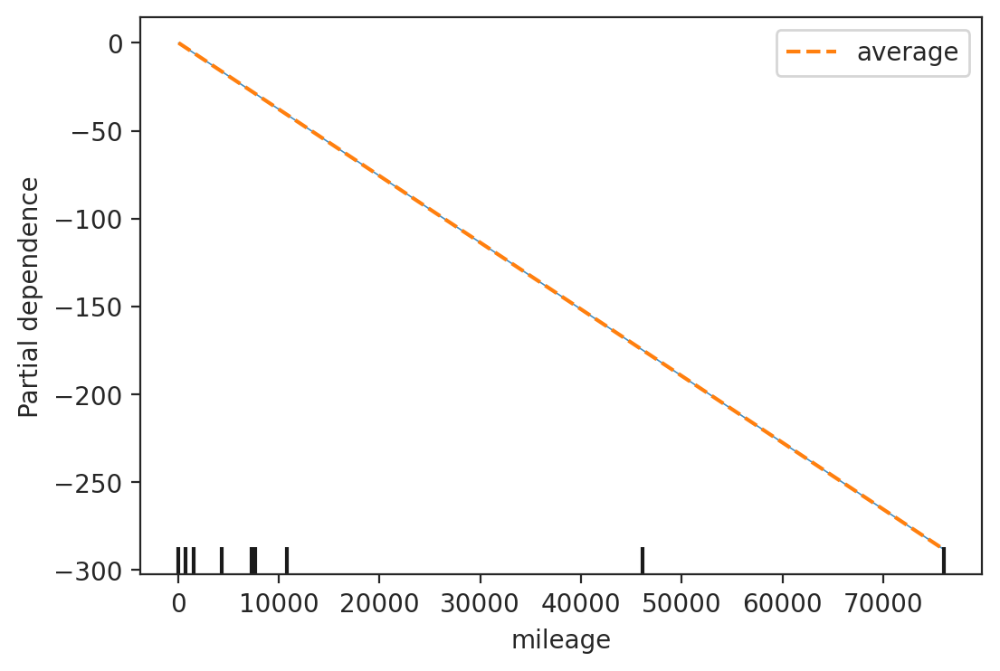

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_lin_regression, selected_rows14, features=['mileage'], kind='both', centered=True)

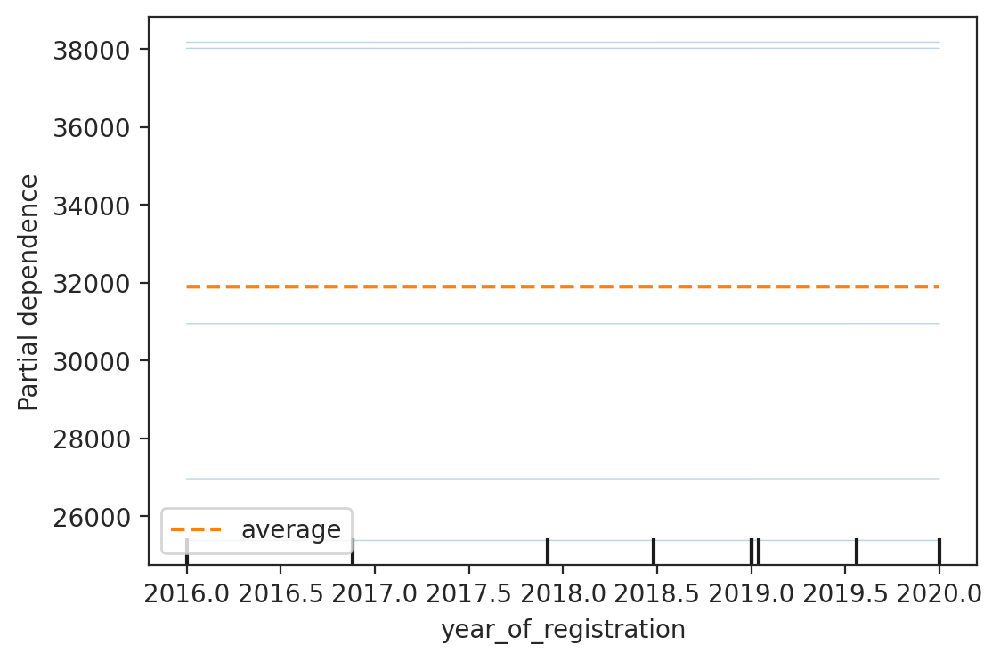

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_lin_regression, selected_rows14, features=['year_of_registration'], kind='both')

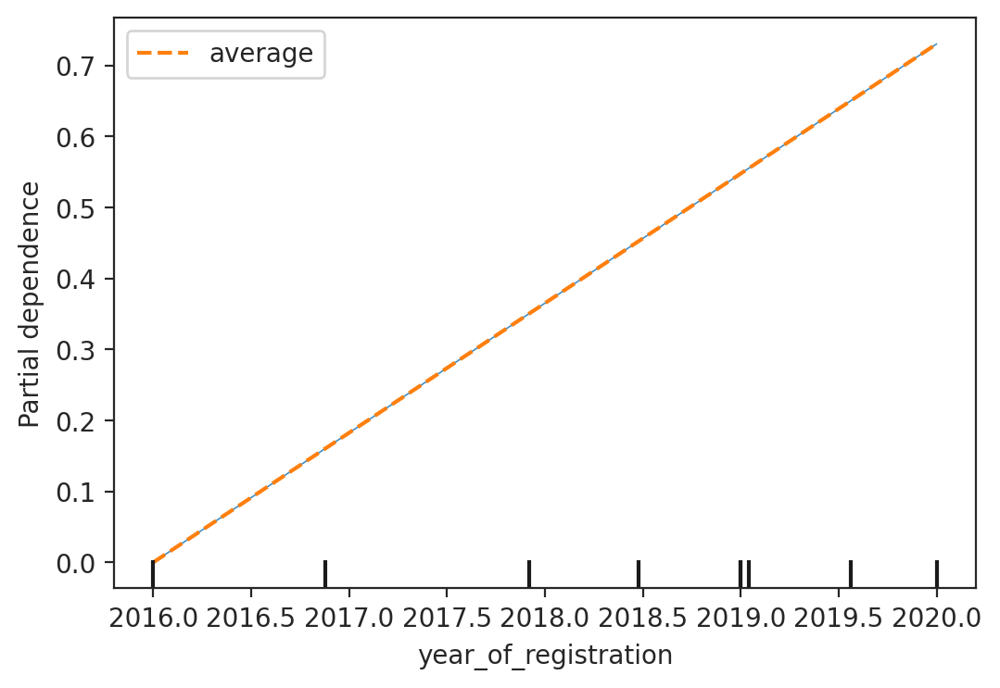

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_lin_regression, selected_rows14, features=['year_of_registration'], kind='both', centered=True)

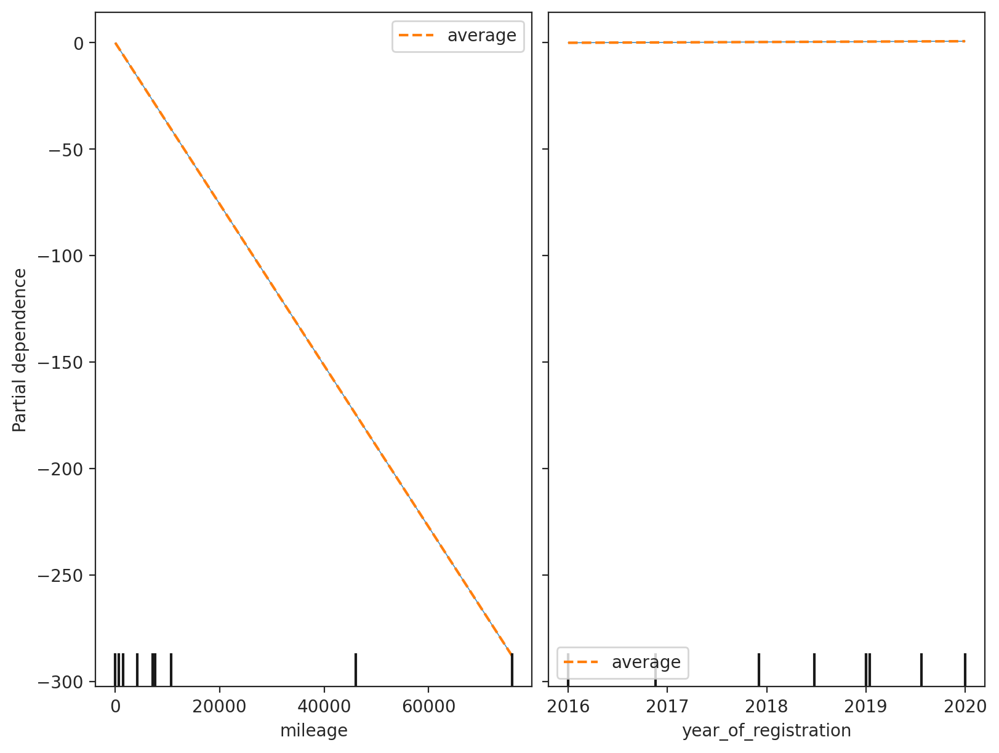

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_lin_regression,
                                        selected_rows14,
                                        features=['mileage', 'year_of_registration'],
                                        kind='both',
                                        centered=True,
                                        subsample=100,
                                        grid_resolution=30,
                                        n_jobs=-1,
                                        random_state=0,ax=ax, n_cols=2);

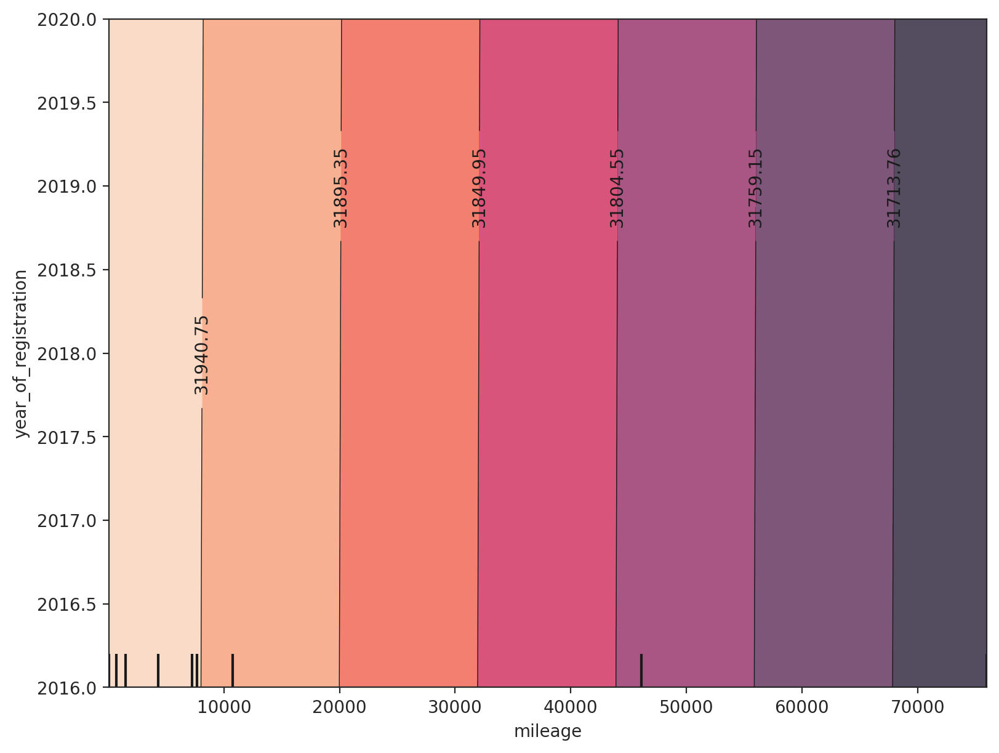

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_lin_regression,
                                        selected_rows14,
                                        features=[('mileage', 'year_of_registration')],
                                        kind='average',
                                        subsample=100,
                                        grid_resolution=30,
                                        random_state=0,
                                        ax=ax, n_cols=2);

## **9.4. PARTIAL DEPENDENCY PLOT - RANDOM FOREST**

In [ ]:
x_test_rf_after_fs2 = x_test_rf_after_fs.copy()

In [ ]:
x_test_rf_after_fs2.reset_index(drop = True, inplace=True)

In [ ]:
print(x_test_rf_after_fs2)

        mileage  mileage_year reg_code  standard_make  body_type  \
0      108230.0     53.818996       61         Jaguar     Saloon   
1        9500.0      4.705300       19     Land Rover        SUV   
2       24487.0     12.140307       17        Peugeot  Hatchback   
3       52023.0     25.805060       66     Volkswagen     Estate   
4       29500.0     14.662028       12  Mercedes-Benz     Saloon   
...         ...           ...      ...            ...        ...   
80396   44000.0     21.879662       61          Mazda  Hatchback   
80397    2334.0      1.156018       69     Land Rover        SUV   
80398   53460.0     26.597015       10           SEAT     Estate   
80399   45000.0     22.332506       15       Vauxhall  Hatchback   
80400  110000.0     54.753609       59        Peugeot  Hatchback   

       year_of_registration  doors     standard_model  
0                    2011.0      4                 XF  
1                    2019.0      5        Range Rover  
2              

In [ ]:
selected_rows21 = x_test_rf_after_fs2.loc[[2, 3, 4, 7, 8]]
print(selected_rows21)

   mileage  mileage_year reg_code  standard_make  body_type  \
2  24487.0     12.140307       17        Peugeot  Hatchback   
3  52023.0     25.805060       66     Volkswagen     Estate   
4  29500.0     14.662028       12  Mercedes-Benz     Saloon   
7  12999.0      6.438336       69        Peugeot  Hatchback   
8      0.0           NaN      NaN           Fiat  Hatchback   

   year_of_registration  doors standard_model  
2                2017.0      5            208  
3                2016.0      5           Golf  
4                2012.0      4        C Class  
7                2019.0      5            208  
8                   NaN      5          Panda  


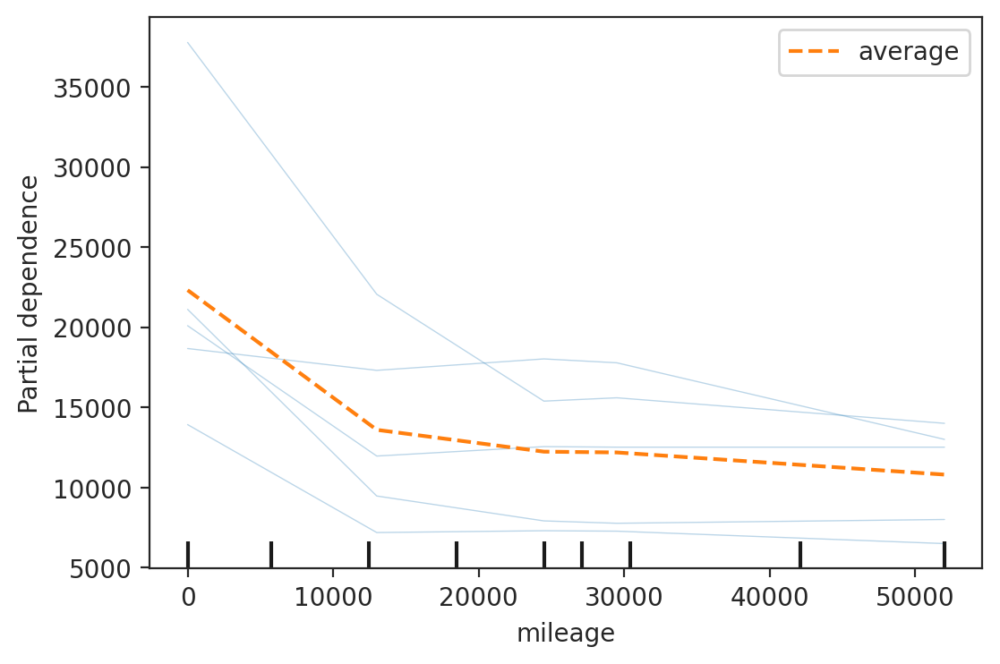

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_rf, selected_rows21, features=['mileage'], kind='both')

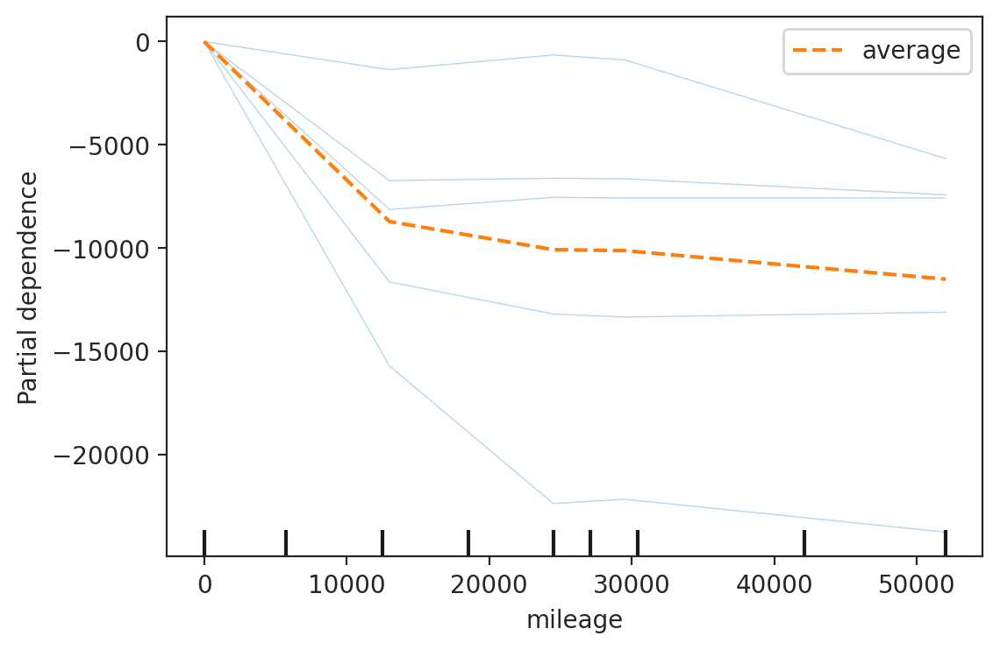

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_rf, selected_rows21, features=['mileage'], kind='both', centered=True)

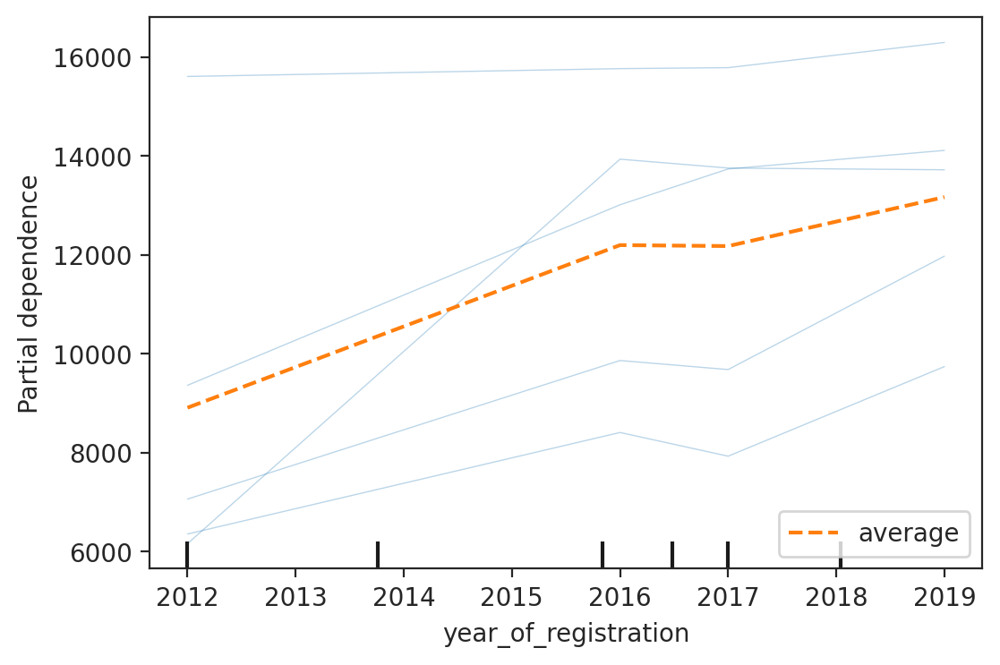

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_rf, selected_rows21, features=['year_of_registration'], kind='both')

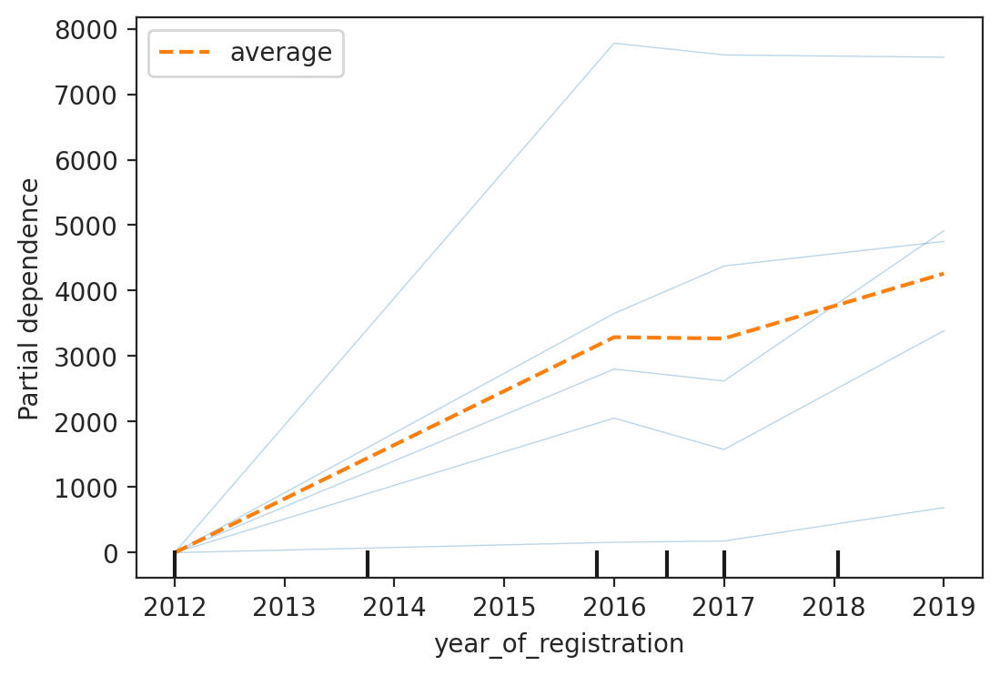

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_rf, selected_rows21, features=['year_of_registration'], kind='both', centered=True)

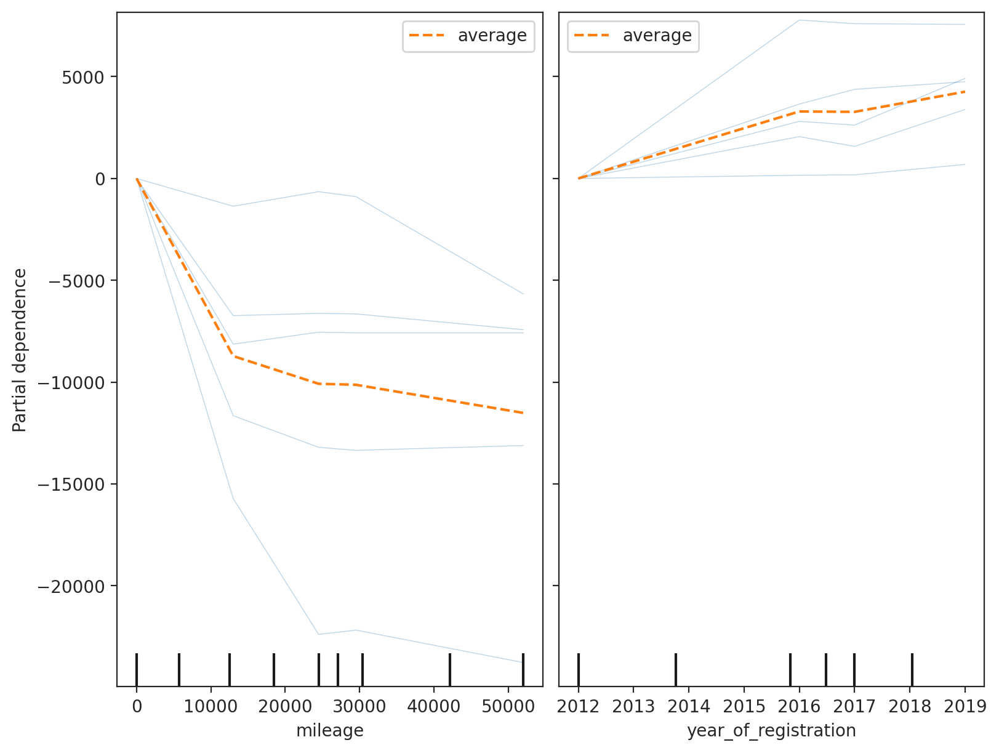

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_rf,
                                        selected_rows21,
                                        features=['mileage', 'year_of_registration'],
                                        kind='both',
                                        centered=True,
                                        subsample=100,
                                        grid_resolution=30,
                                        n_jobs=-1,
                                        random_state=0,ax=ax, n_cols=2);

In [ ]:
selected_rows22 = x_test_rf_after_fs2.loc[[5, 6, 12, 19, 5000]]
print(selected_rows22)

       mileage  mileage_year reg_code  standard_make  body_type  \
5      90000.0     44.798407       09     Mitsubishi  Hatchback   
6     180000.0     89.374379       64          SKODA  Hatchback   
12     29000.0     14.392060       65        Citroen  Hatchback   
19     12854.0      6.372831       67        Peugeot  Hatchback   
5000   62552.0     31.135889       59  Mercedes-Benz     Saloon   

      year_of_registration  doors standard_model  
5                   2009.0      5           Colt  
6                   2014.0      5        Octavia  
12                  2015.0      5             C1  
19                  2017.0      5            108  
5000                2009.0      4        C Class  


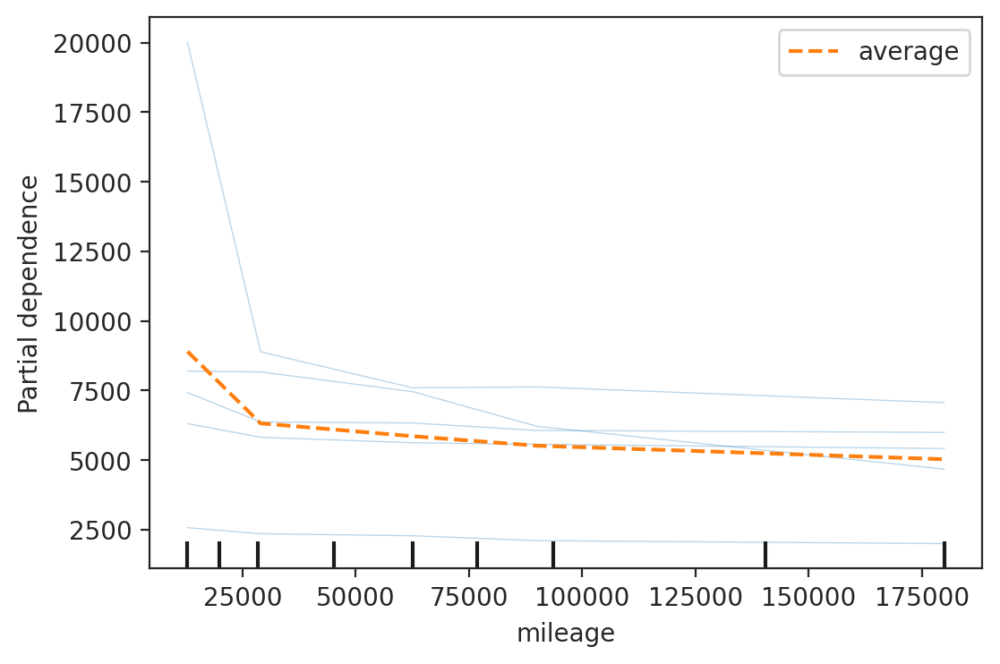

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_rf, selected_rows22, features=['mileage'], kind='both')

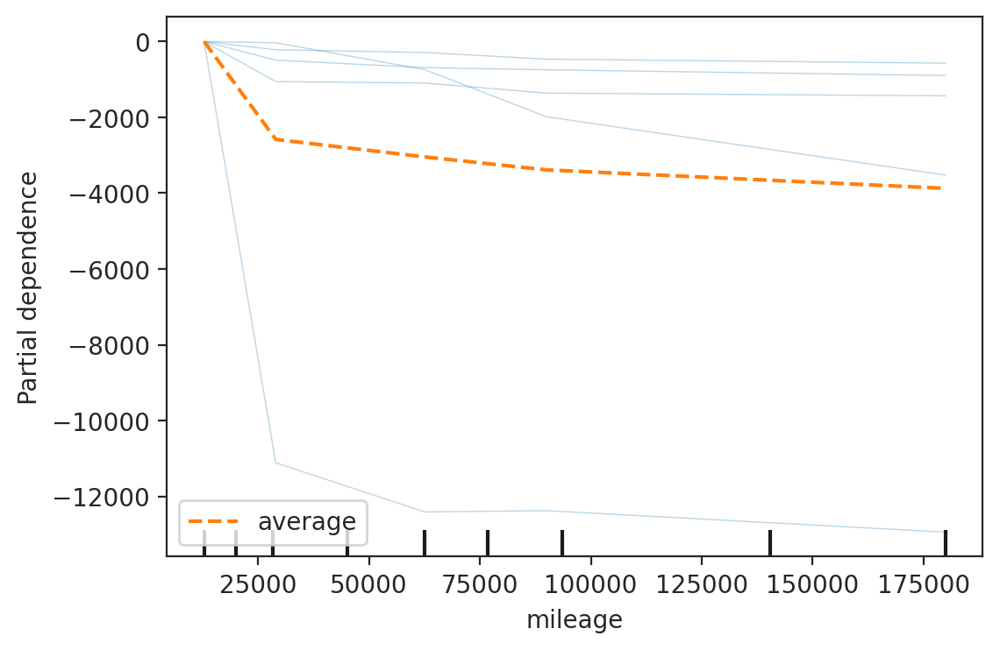

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_rf, selected_rows22, features=['mileage'], kind='both', centered=True)

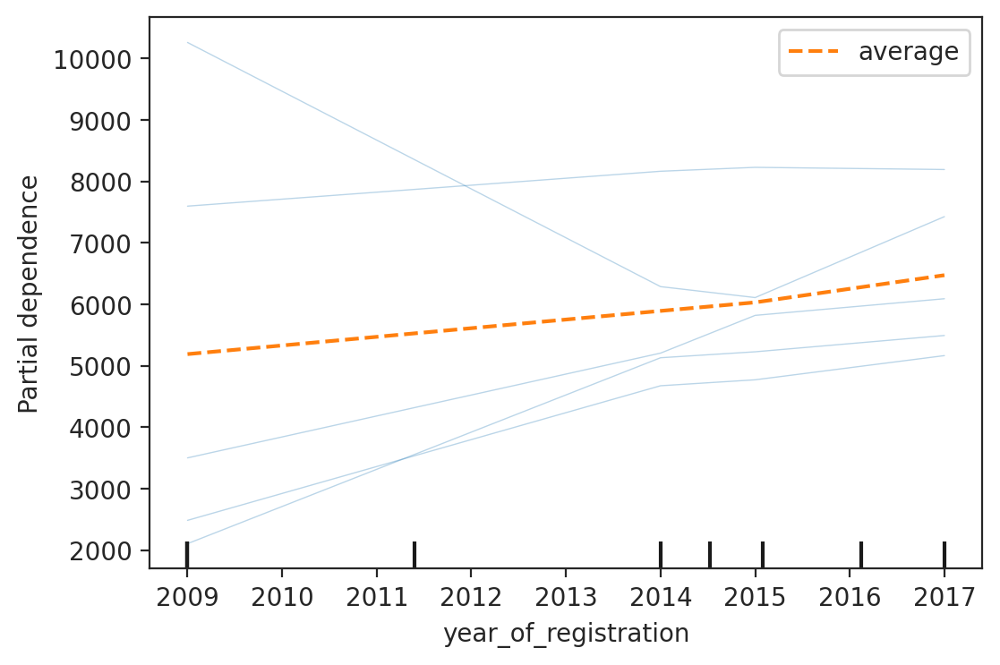

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_rf, selected_rows22, features=['year_of_registration'], kind='both')

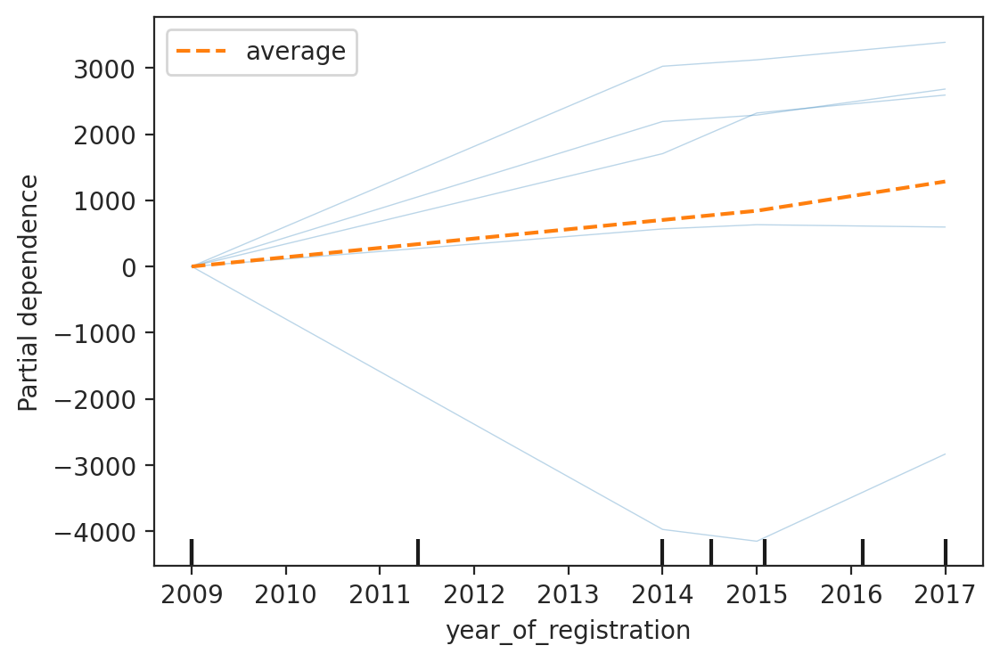

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_rf, selected_rows22, features=['year_of_registration'], kind='both', centered=True)

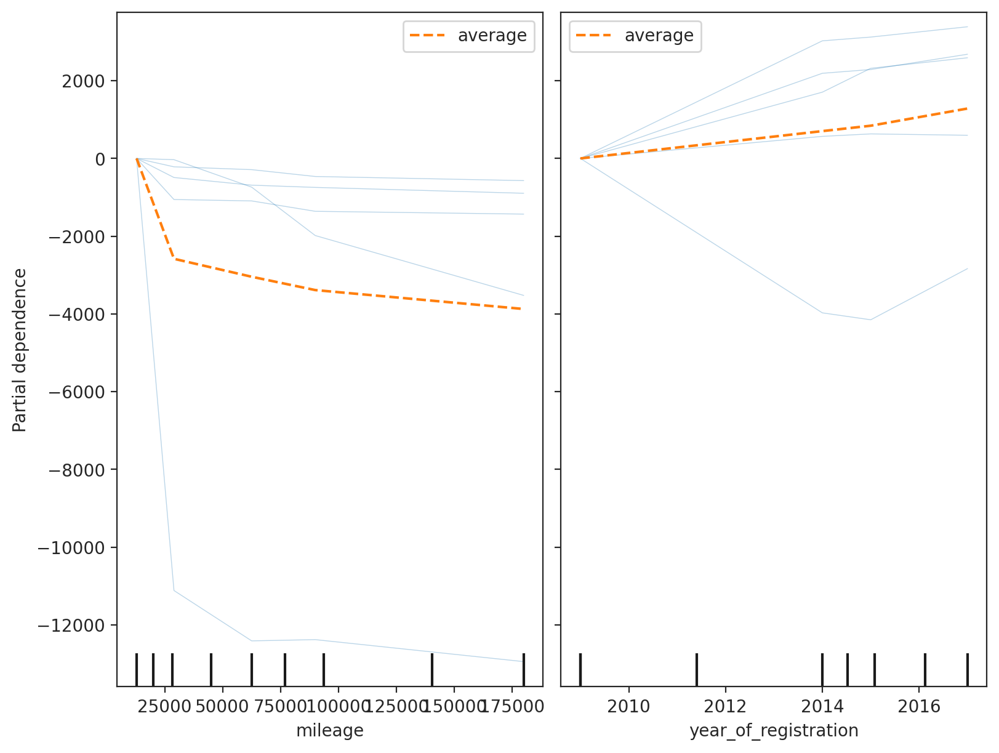

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_rf,
                                        selected_rows22,
                                        features=['mileage', 'year_of_registration'],
                                        kind='both',
                                        centered=True,
                                        subsample=100,
                                        grid_resolution=30,
                                        n_jobs=-1,
                                        random_state=0,ax=ax, n_cols=2);

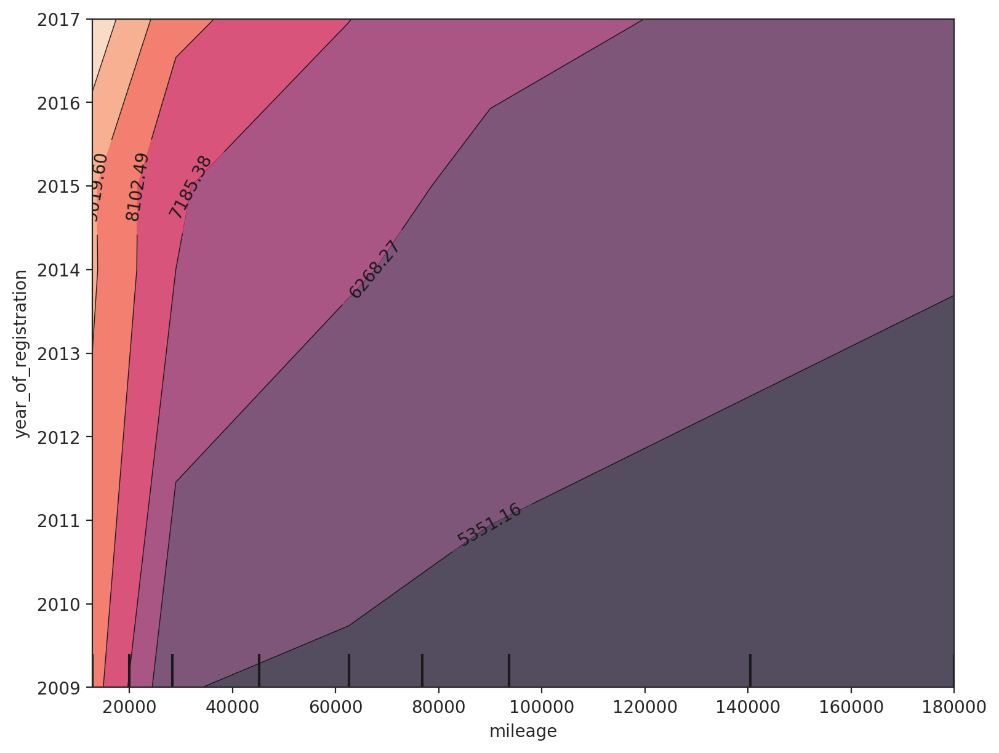

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_rf,
                                        selected_rows22,
                                        features=[('mileage', 'year_of_registration')],
                                        kind='average',
                                        subsample=100,
                                        grid_resolution=30,
                                        random_state=0,
                                        ax=ax, n_cols=2);

In [ ]:
selected_rows23 = x_test_rf_after_fs2.loc[[1, 10, 13, 17, 18]]
print(selected_rows23)

    mileage  mileage_year reg_code  standard_make body_type  \
1    9500.0      4.705300       19     Land Rover       SUV   
10  19000.0      9.415263       18  Mercedes-Benz    Saloon   
13  58000.0     28.841372       61        Bentley     Coupe   
17  22369.0     11.090233       17     Volkswagen       SUV   
18   4000.0      1.980198       70  Mercedes-Benz       SUV   

    year_of_registration  doors standard_model  
1                 2019.0      5    Range Rover  
10                2018.0      4        E Class  
13                2011.0      2    Continental  
17                2017.0      5         Tiguan  
18                2020.0      5      GLB Class  


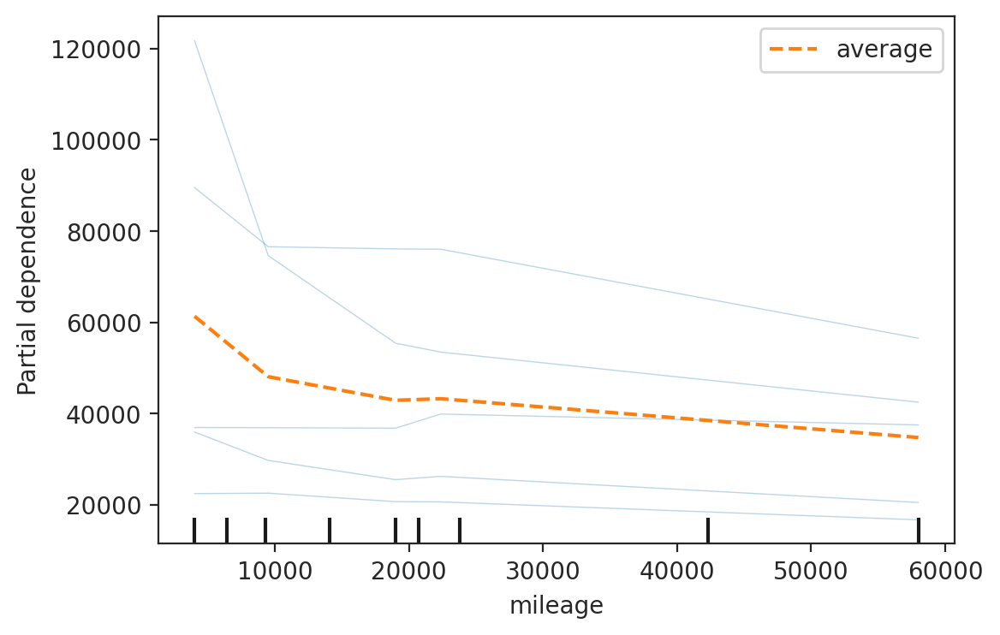

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_rf, selected_rows23, features=['mileage'], kind='both')

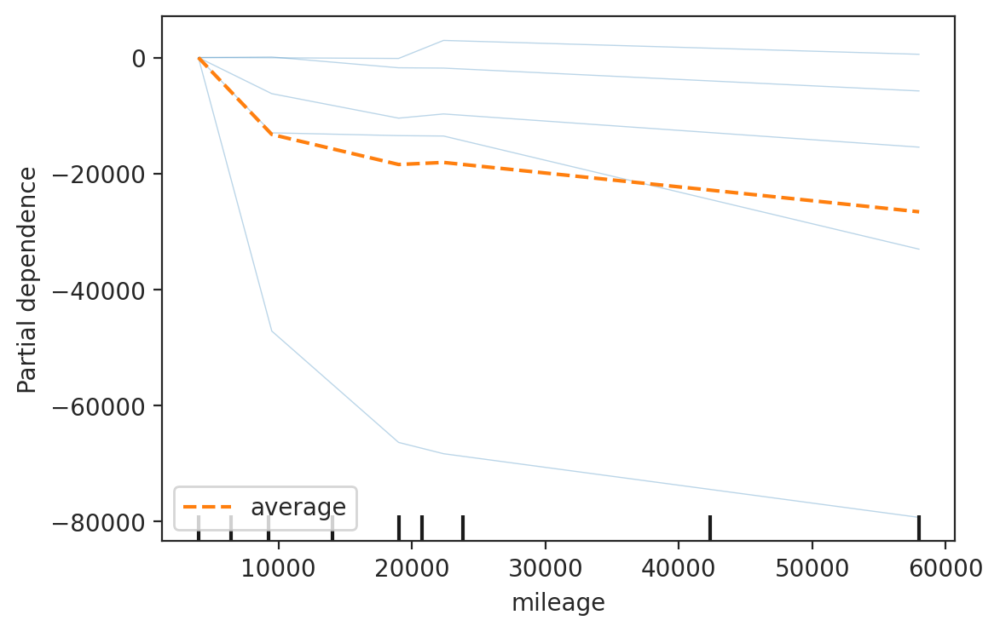

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_rf, selected_rows23, features=['mileage'], kind='both', centered=True)

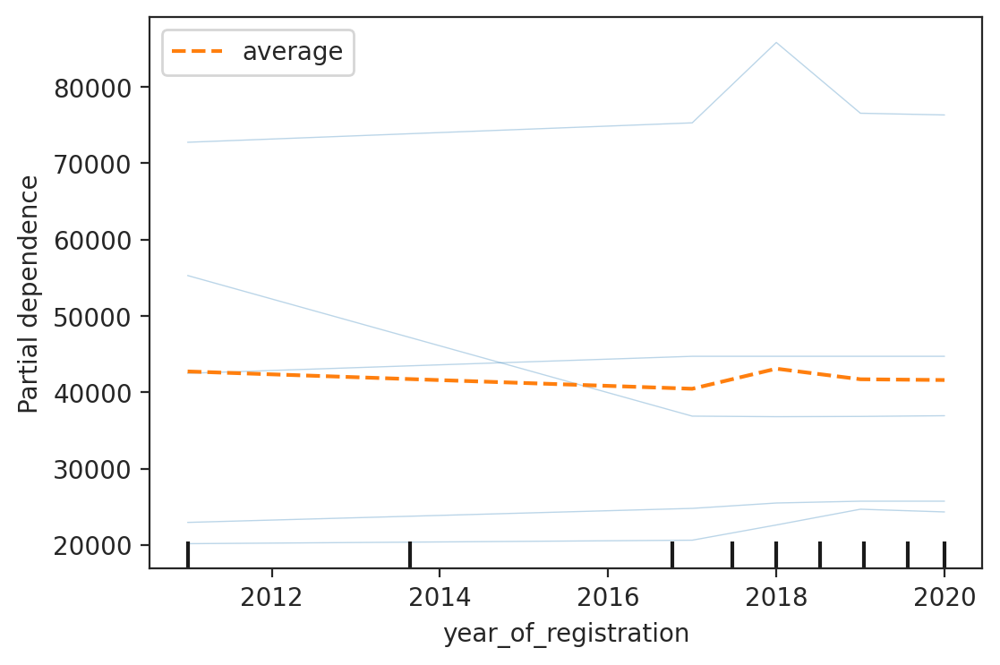

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_rf, selected_rows23, features=['year_of_registration'], kind='both')

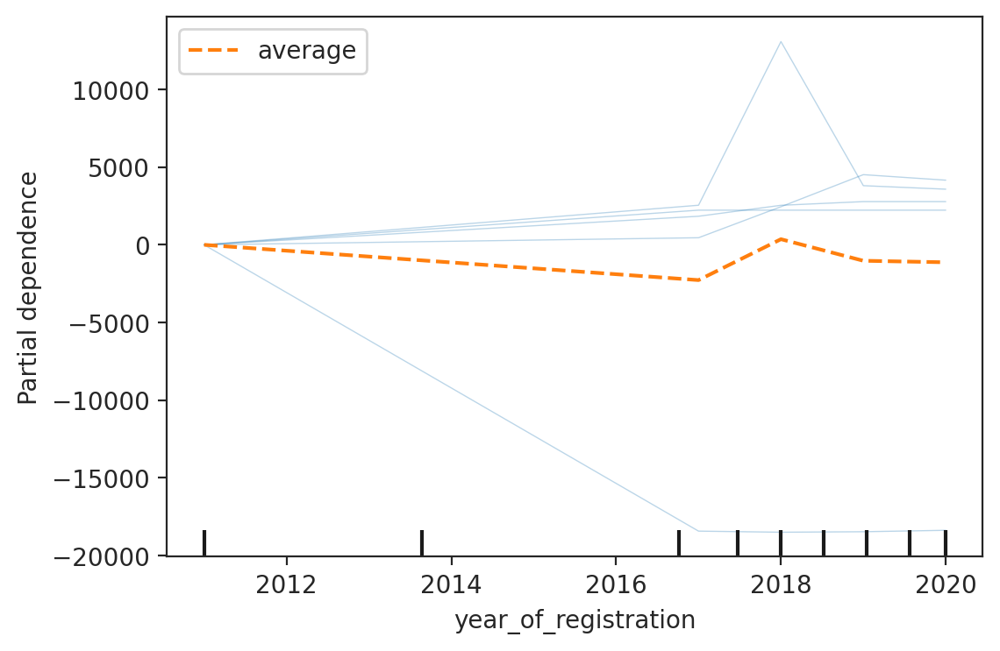

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_rf, selected_rows23, features=['year_of_registration'], kind='both', centered=True)

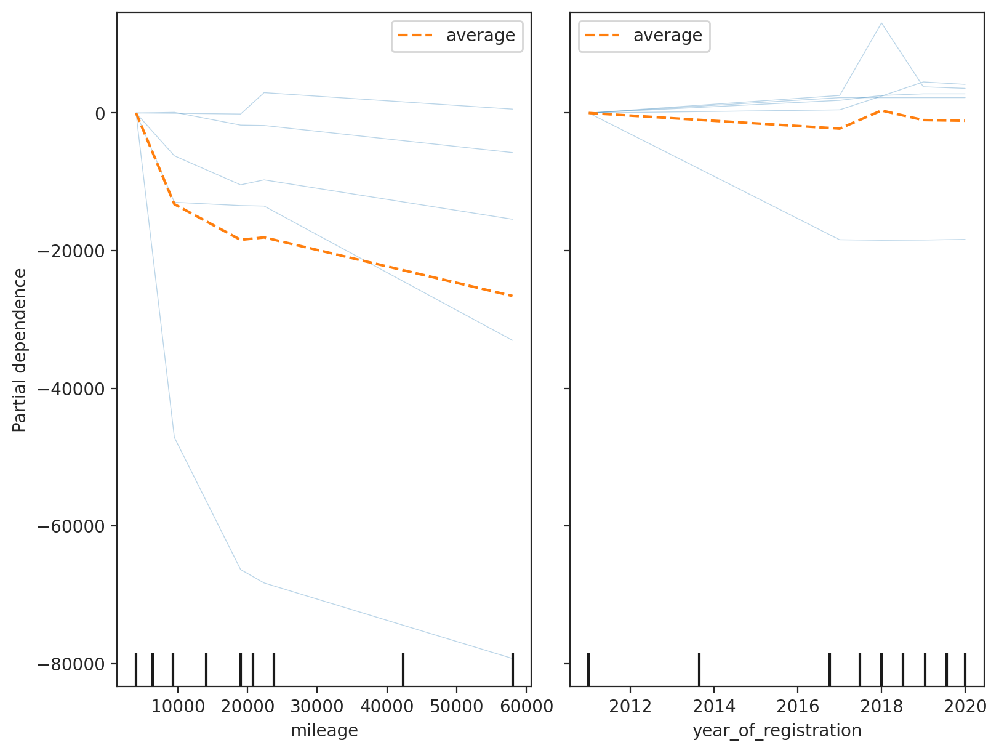

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_rf,
                                        selected_rows23,
                                        features=['mileage', 'year_of_registration'],
                                        kind='both',
                                        centered=True,
                                        subsample=100,
                                        grid_resolution=30,
                                        n_jobs=-1,
                                        random_state=0,ax=ax, n_cols=2);

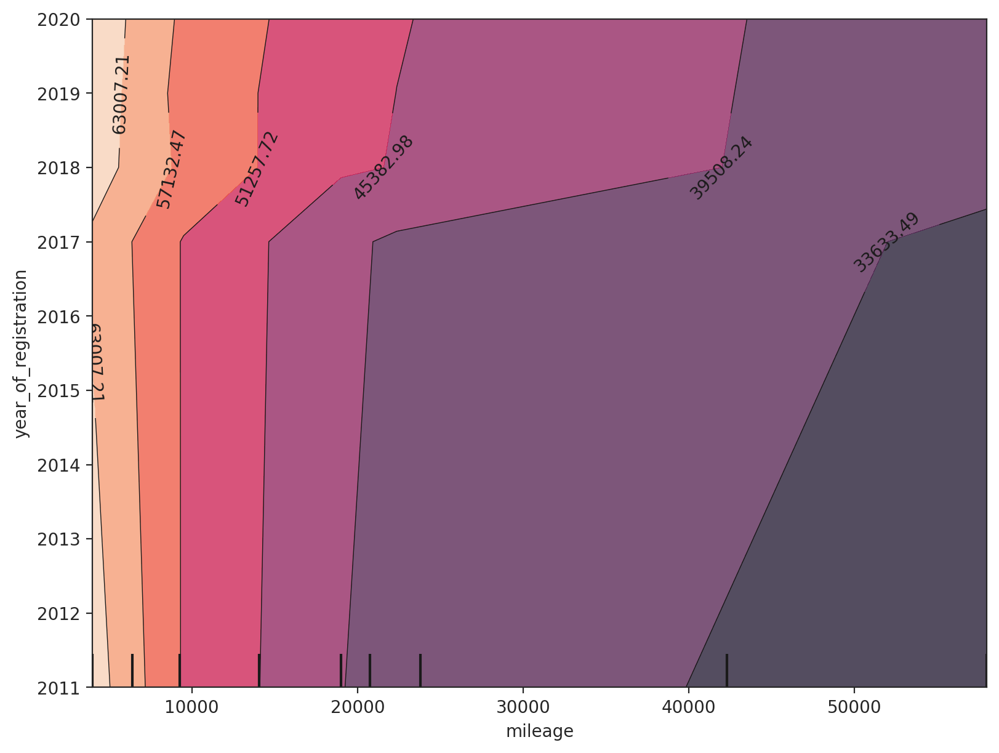

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_rf,
                                        selected_rows23,
                                        features=[('mileage', 'year_of_registration')],
                                        kind='average',
                                        subsample=100,
                                        grid_resolution=30,
                                        random_state=0,
                                        ax=ax, n_cols=2);

In [ ]:
selected_rows24 = x_test_rf_after_fs2.loc[[20, 190, 255, 1200, 79012]]
print(selected_rows24)

       mileage  mileage_year reg_code standard_make    body_type  \
20      1568.0      0.776622       19       McLaren        Coupe   
190     7253.0      3.597718       66   Lamborghini        Coupe   
255    76000.0     37.661051      NaN  Aston Martin       Saloon   
1200    8061.0      3.992571       69   Lamborghini          SUV   
79012     47.0      0.023267       70       Ferrari  Convertible   

       year_of_registration  doors standard_model  
20                   2019.0      2          Senna  
190                  2016.0      2      Aventador  
255                  2018.0      4            DB4  
1200                 2019.0      5           Urus  
79012                2020.0      2      488 Pista  


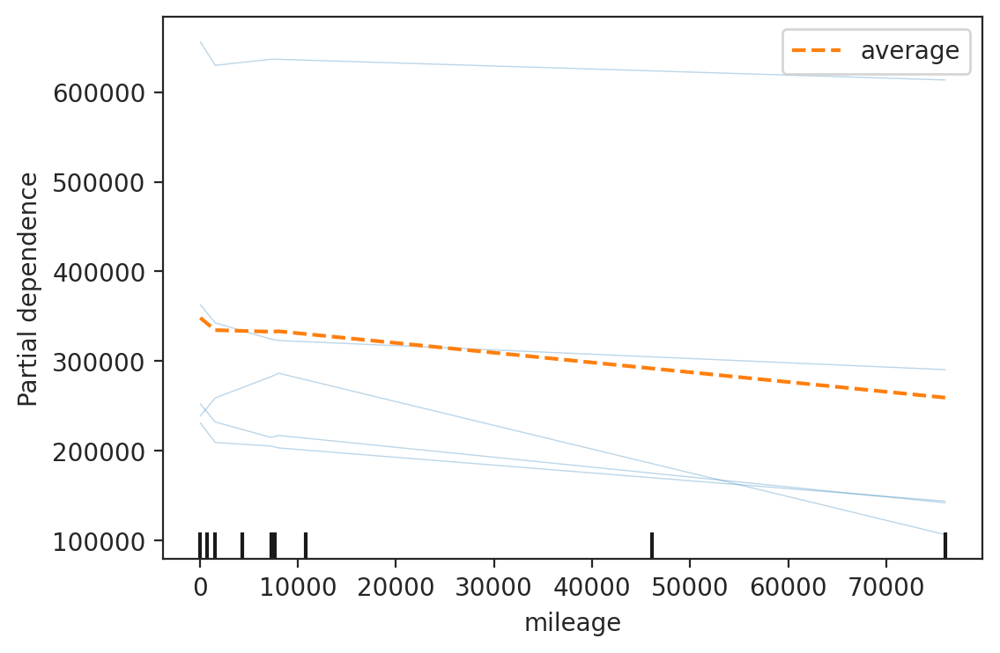

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_rf, selected_rows24, features=['mileage'], kind='both')

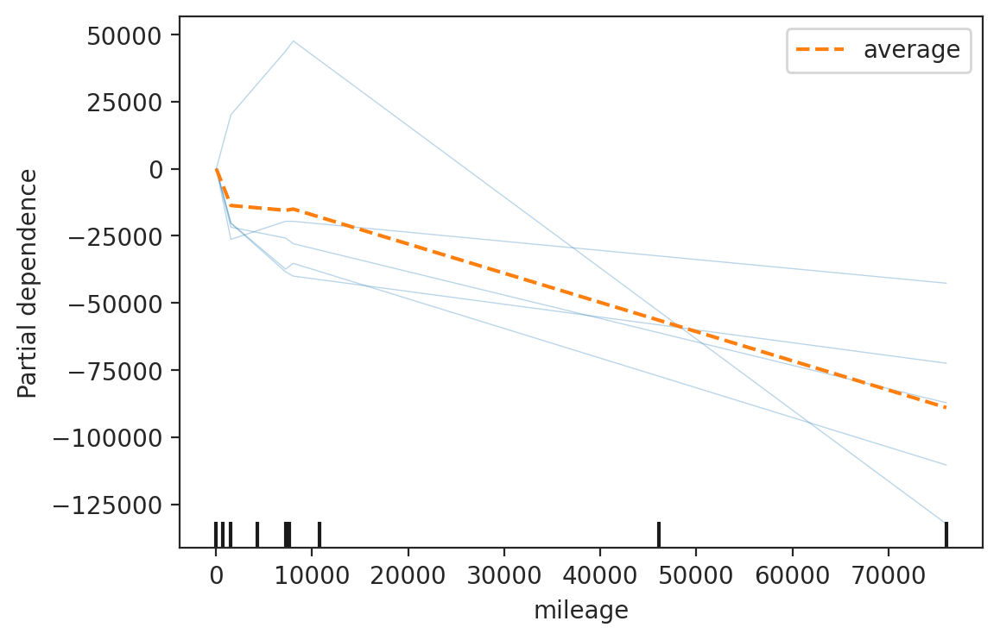

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_rf, selected_rows24, features=['mileage'], kind='both', centered=True)

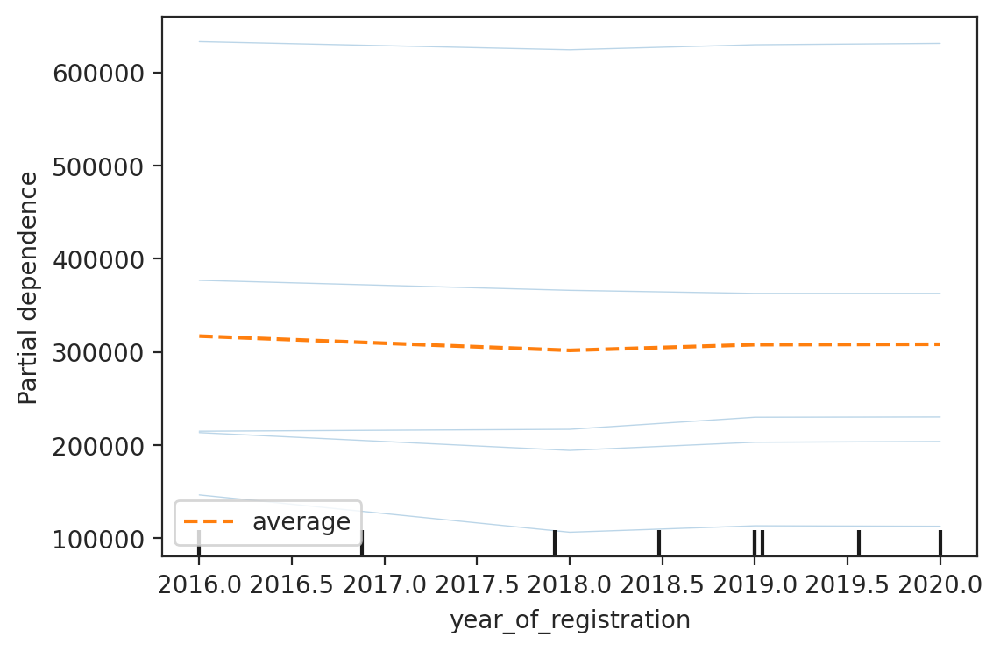

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_rf, selected_rows24, features=['year_of_registration'], kind='both')

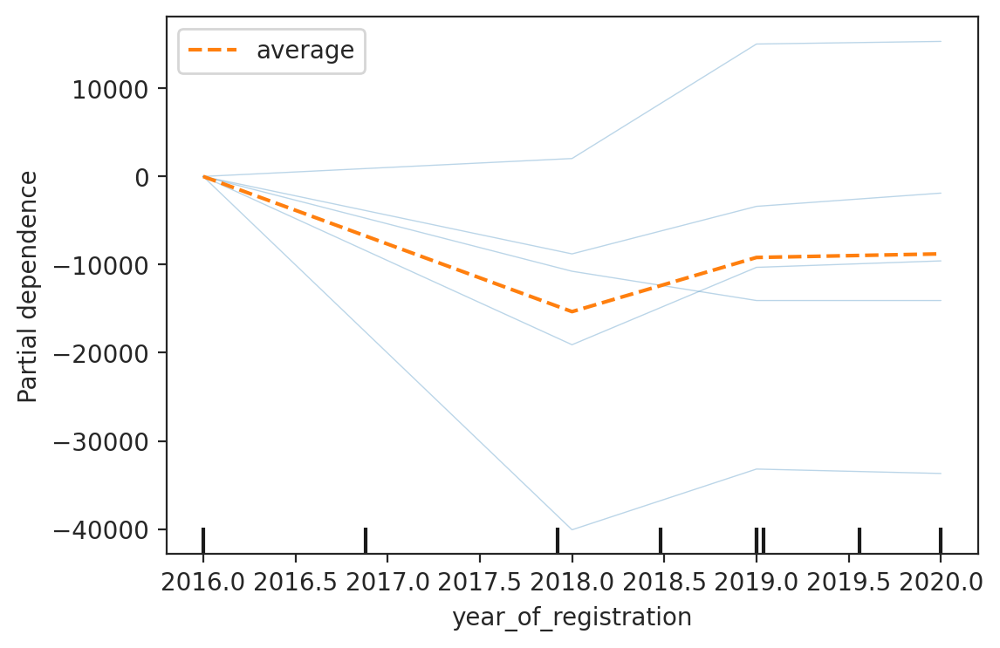

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_rf, selected_rows24, features=['year_of_registration'], kind='both', centered=True)

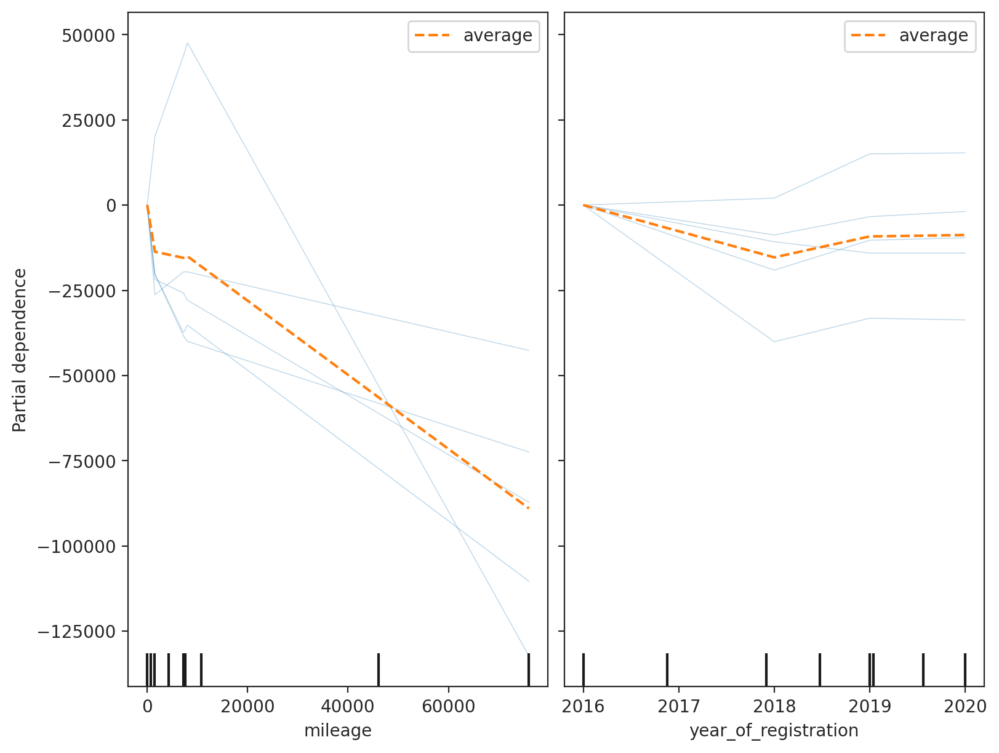

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_rf,
                                        selected_rows24,
                                        features=['mileage', 'year_of_registration'],
                                        kind='both',
                                        centered=True,
                                        subsample=100,
                                        grid_resolution=30,
                                        n_jobs=-1,
                                        random_state=0,ax=ax, n_cols=2);

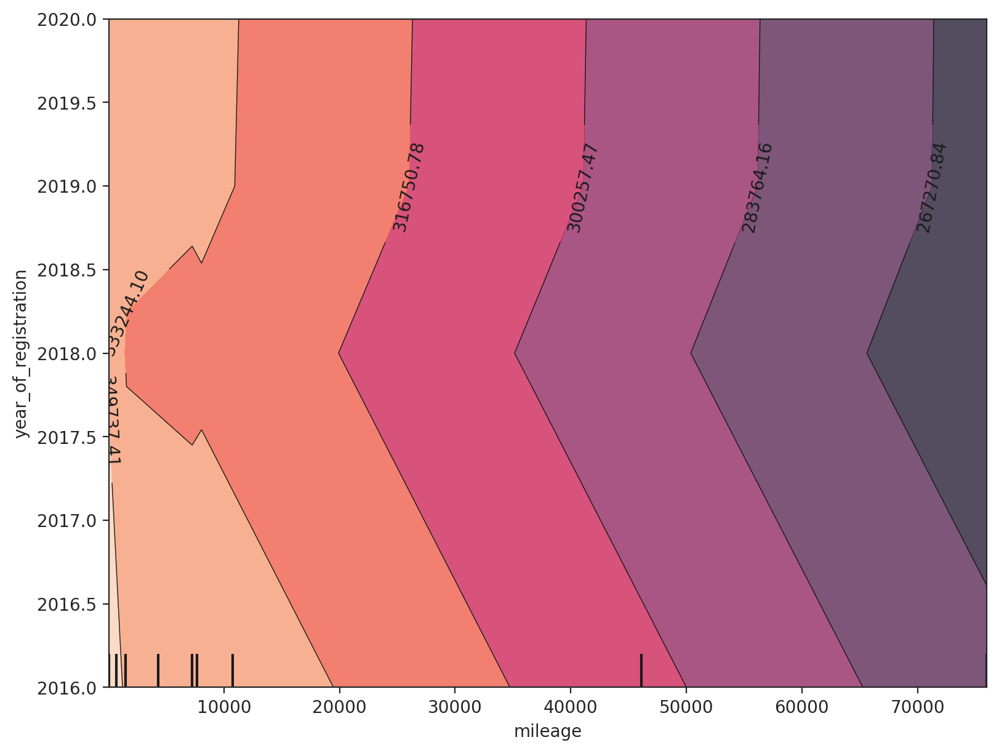

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_rf,
                                        selected_rows24,
                                        features=[('mileage', 'year_of_registration')],
                                        kind='average',
                                        subsample=100,
                                        grid_resolution=30,
                                        random_state=0,
                                        ax=ax, n_cols=2);

## **9.5. PARTIAL DEPENDENCY PLOT - BOOSTED TREE**

In [ ]:
x_test_bt_after_fs

,mileage,mileage_year,reg_code,standard_make,body_type,year_of_registration,doors,standard_model
1,108230.0,53.818996,61,Jaguar,Saloon,2011.0,4,XF
9,9500.0,4.705300,19,Land Rover,SUV,2019.0,5,Range Rover
11,24487.0,12.140307,17,Peugeot,Hatchback,2017.0,5,208
16,52023.0,25.805060,66,Volkswagen,Estate,2016.0,5,Golf
18,29500.0,14.662028,12,Mercedes-Benz,Saloon,2012.0,4,C Class
...,...,...,...,...,...,...,...,...
401983,44000.0,21.879662,61,Mazda,Hatchback,2011.0,5,Mazda2
401986,2334.0,1.156018,69,Land Rover,SUV,2019.0,5,Range Rover Velar
401995,53460.0,26.597015,10,SEAT,Estate,2010.0,5,Ibiza
401996,45000.0,22.332506,15,Vauxhall,Hatchback,2015.0,5,Corsa


In [ ]:
x_test_bt_after_fs2 = x_test_bt_after_fs.copy()

In [ ]:
x_test_bt_after_fs2.reset_index(drop = True, inplace=True)

In [ ]:
print(x_test_bt_after_fs2)

        mileage  mileage_year reg_code  standard_make  body_type  \
0      108230.0     53.818996       61         Jaguar     Saloon   
1        9500.0      4.705300       19     Land Rover        SUV   
2       24487.0     12.140307       17        Peugeot  Hatchback   
3       52023.0     25.805060       66     Volkswagen     Estate   
4       29500.0     14.662028       12  Mercedes-Benz     Saloon   
...         ...           ...      ...            ...        ...   
80396   44000.0     21.879662       61          Mazda  Hatchback   
80397    2334.0      1.156018       69     Land Rover        SUV   
80398   53460.0     26.597015       10           SEAT     Estate   
80399   45000.0     22.332506       15       Vauxhall  Hatchback   
80400  110000.0     54.753609       59        Peugeot  Hatchback   

       year_of_registration  doors     standard_model  
0                    2011.0      4                 XF  
1                    2019.0      5        Range Rover  
2              

In [ ]:
selected_rows31 = x_test_bt_after_fs2.loc[[2, 3, 4, 7, 8]]
print(selected_rows31)

   mileage  mileage_year reg_code  standard_make  body_type  \
2  24487.0     12.140307       17        Peugeot  Hatchback   
3  52023.0     25.805060       66     Volkswagen     Estate   
4  29500.0     14.662028       12  Mercedes-Benz     Saloon   
7  12999.0      6.438336       69        Peugeot  Hatchback   
8      0.0           NaN      NaN           Fiat  Hatchback   

   year_of_registration  doors standard_model  
2                2017.0      5            208  
3                2016.0      5           Golf  
4                2012.0      4        C Class  
7                2019.0      5            208  
8                   NaN      5          Panda  


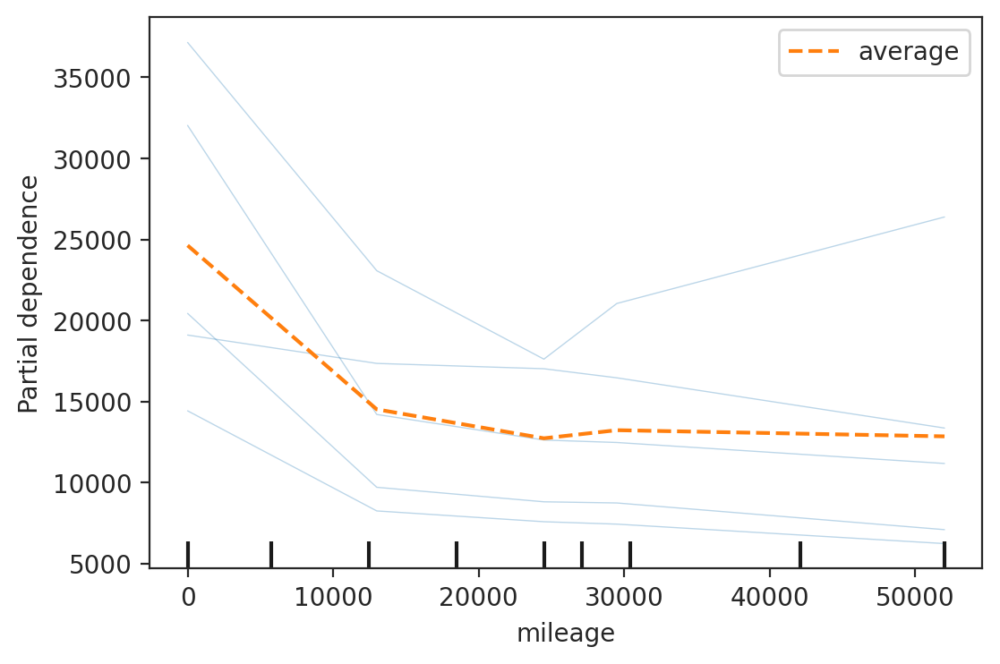

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_bt, selected_rows31, features=['mileage'], kind='both')

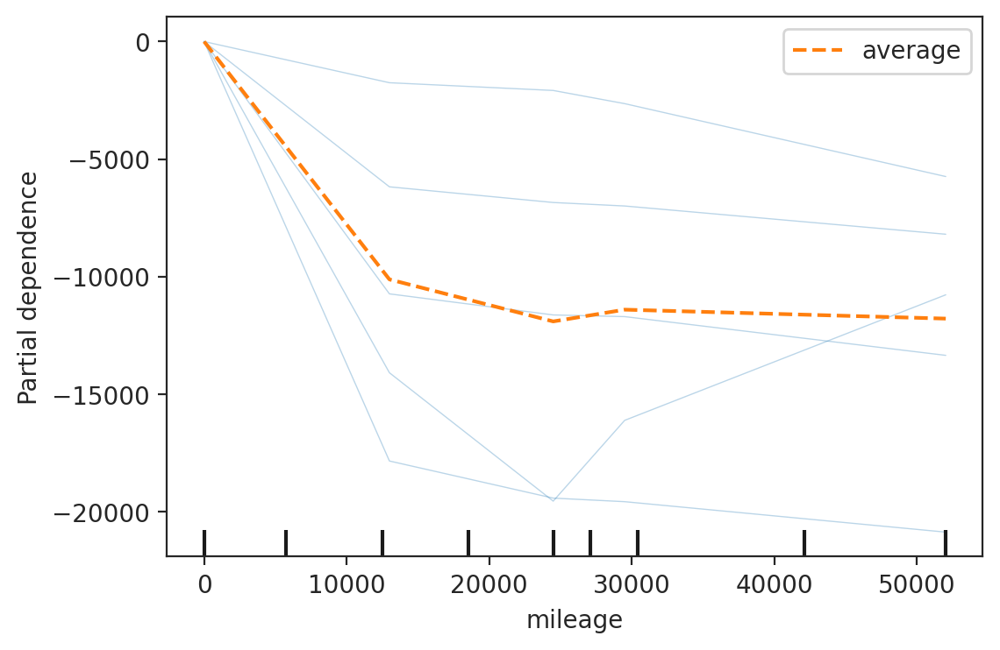

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_bt, selected_rows31, features=['mileage'], kind='both', centered=True)

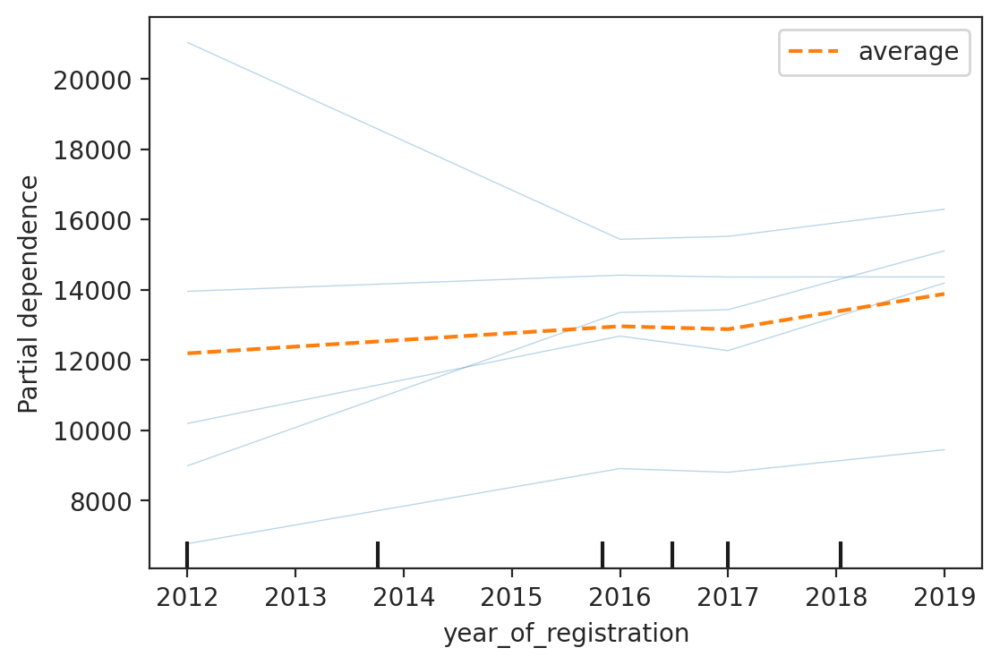

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_bt, selected_rows31, features=['year_of_registration'], kind='both')

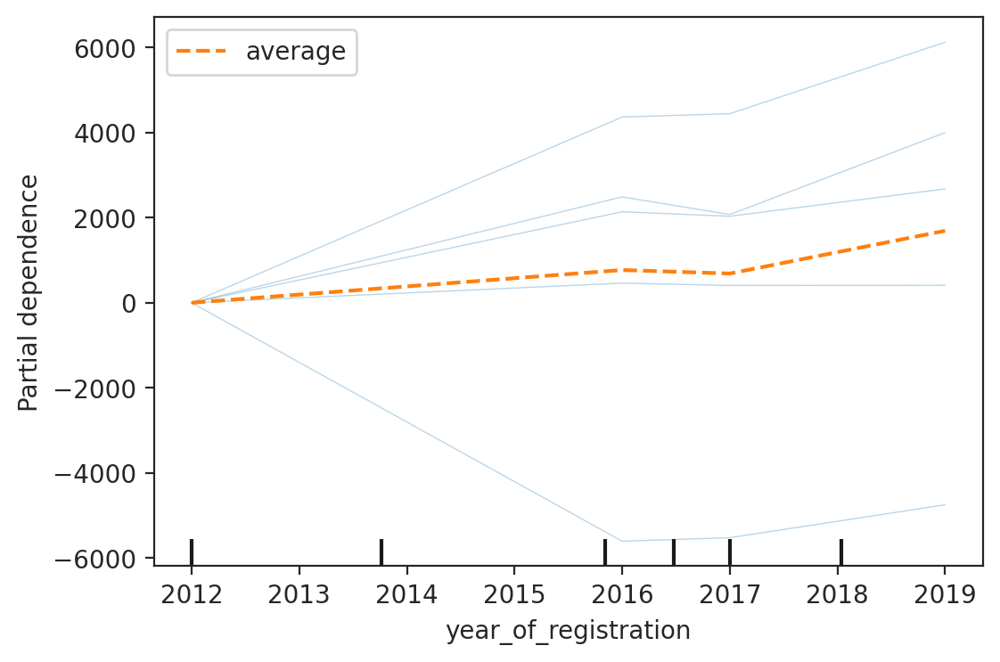

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_bt, selected_rows31, features=['year_of_registration'], kind='both', centered=True)

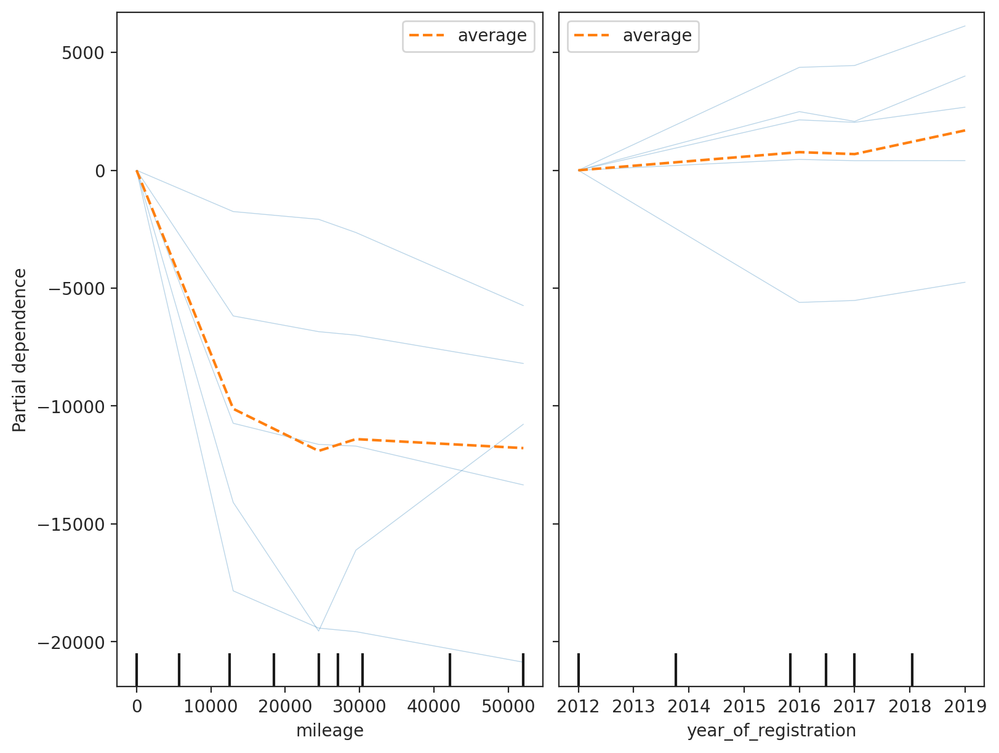

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_bt,
                                        selected_rows31,
                                        features=['mileage', 'year_of_registration'],
                                        kind='both',
                                        centered=True,
                                        subsample=100,
                                        grid_resolution=30,
                                        n_jobs=-1,
                                        random_state=0,ax=ax, n_cols=2);

In [ ]:
selected_rows32 = x_test_bt_after_fs2.loc[[5, 6, 12, 19, 5000]]
print(selected_rows32)

       mileage  mileage_year reg_code  standard_make  body_type  \
5      90000.0     44.798407       09     Mitsubishi  Hatchback   
6     180000.0     89.374379       64          SKODA  Hatchback   
12     29000.0     14.392060       65        Citroen  Hatchback   
19     12854.0      6.372831       67        Peugeot  Hatchback   
5000   62552.0     31.135889       59  Mercedes-Benz     Saloon   

      year_of_registration  doors standard_model  
5                   2009.0      5           Colt  
6                   2014.0      5        Octavia  
12                  2015.0      5             C1  
19                  2017.0      5            108  
5000                2009.0      4        C Class  


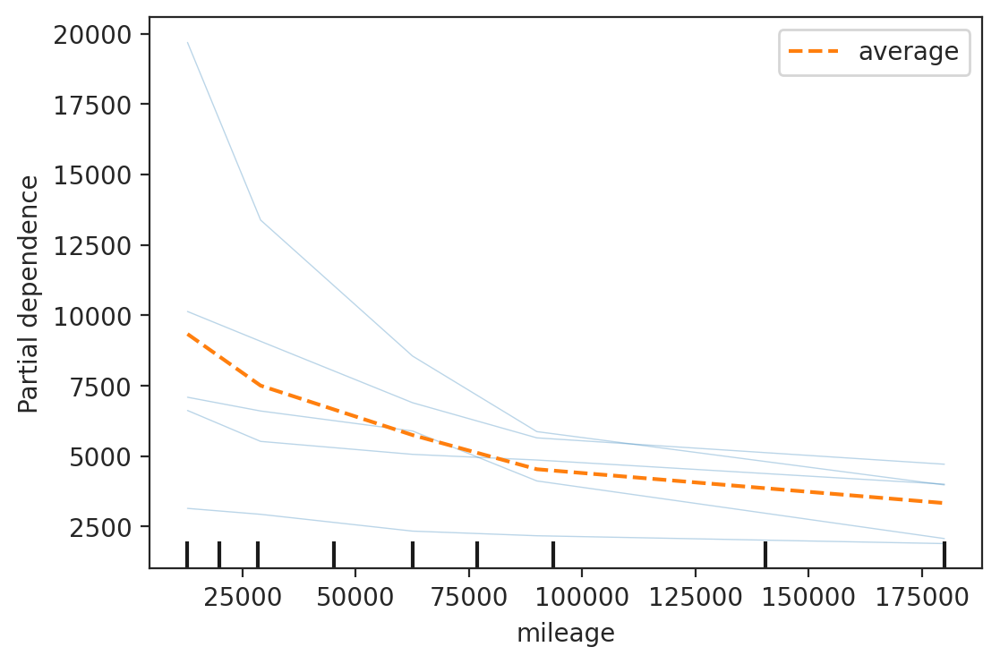

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_bt, selected_rows32, features=['mileage'], kind='both')

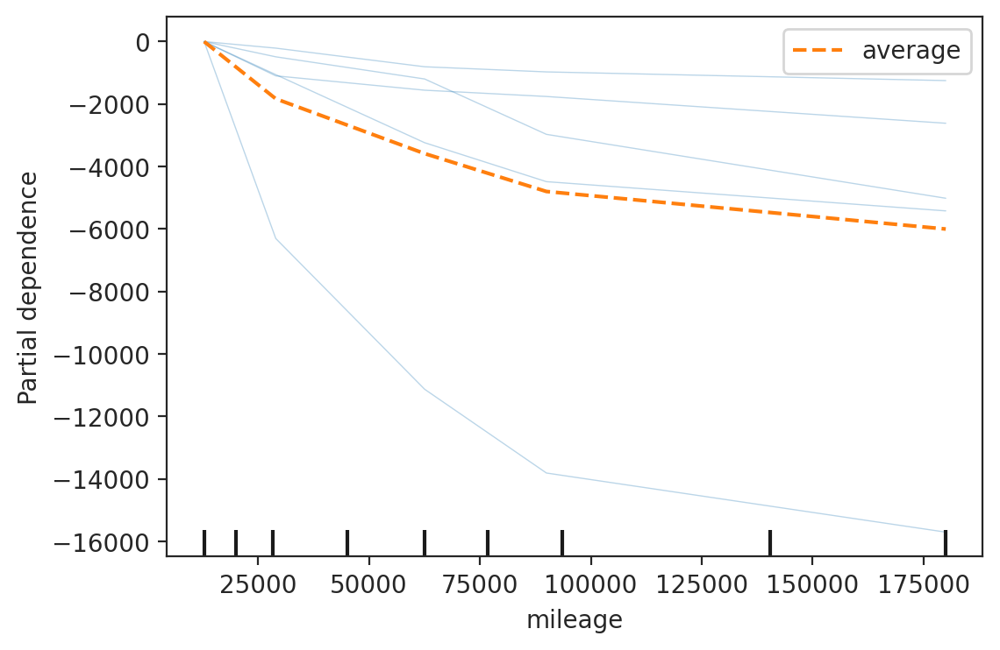

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_bt, selected_rows32, features=['mileage'], kind='both', centered=True)

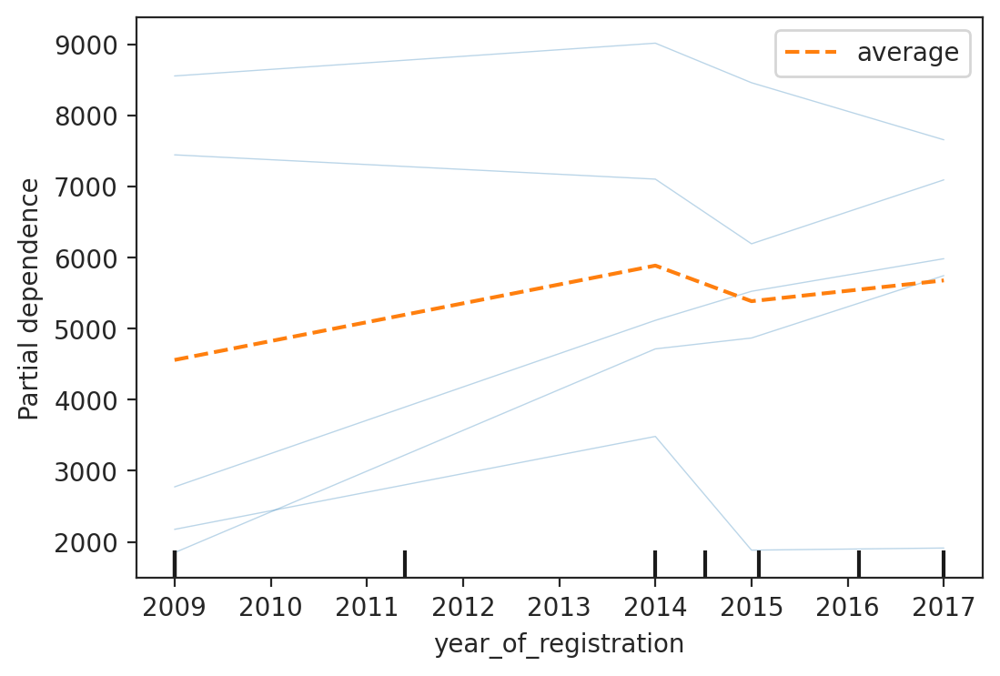

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_bt, selected_rows32, features=['year_of_registration'], kind='both')

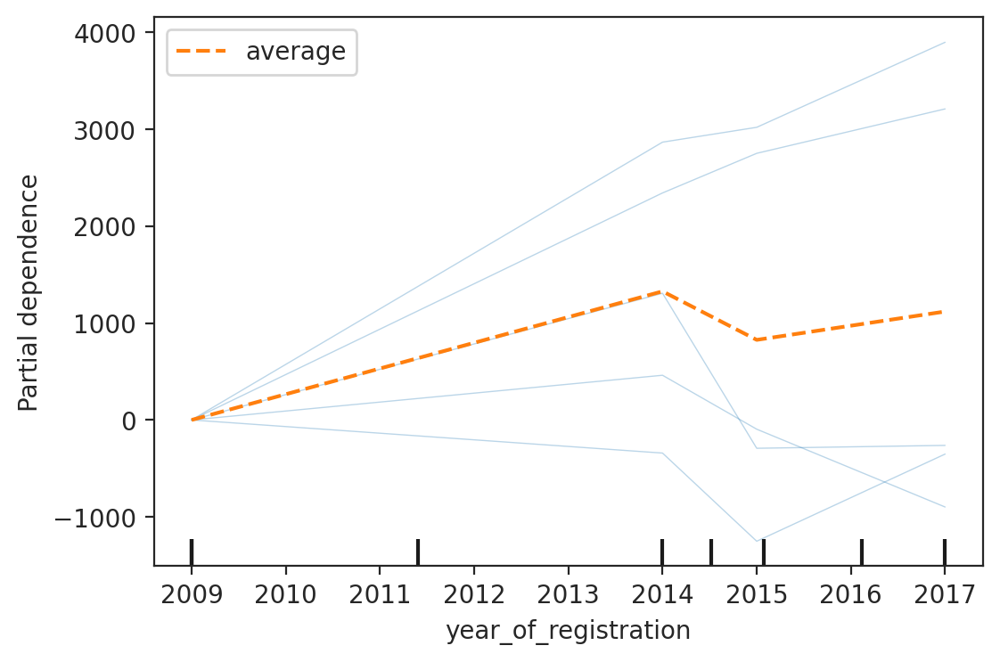

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_bt, selected_rows32, features=['year_of_registration'], kind='both', centered=True)

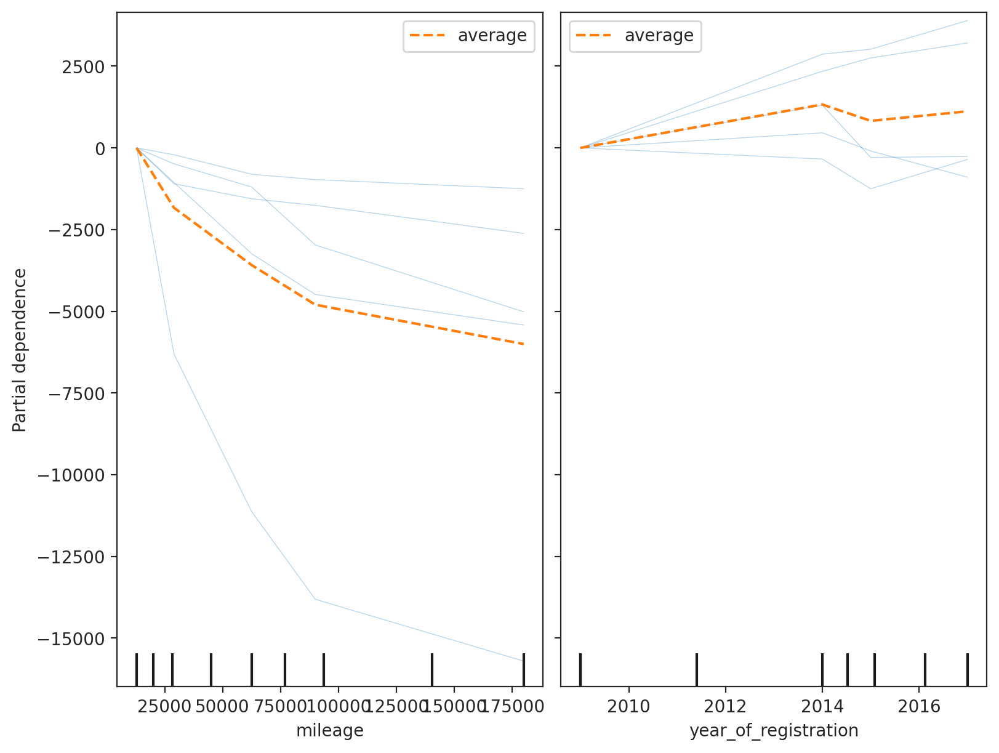

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_bt,
                                        selected_rows32,
                                        features=['mileage', 'year_of_registration'],
                                        kind='both',
                                        centered=True,
                                        subsample=100,
                                        grid_resolution=30,
                                        n_jobs=-1,
                                        random_state=0,ax=ax, n_cols=2);

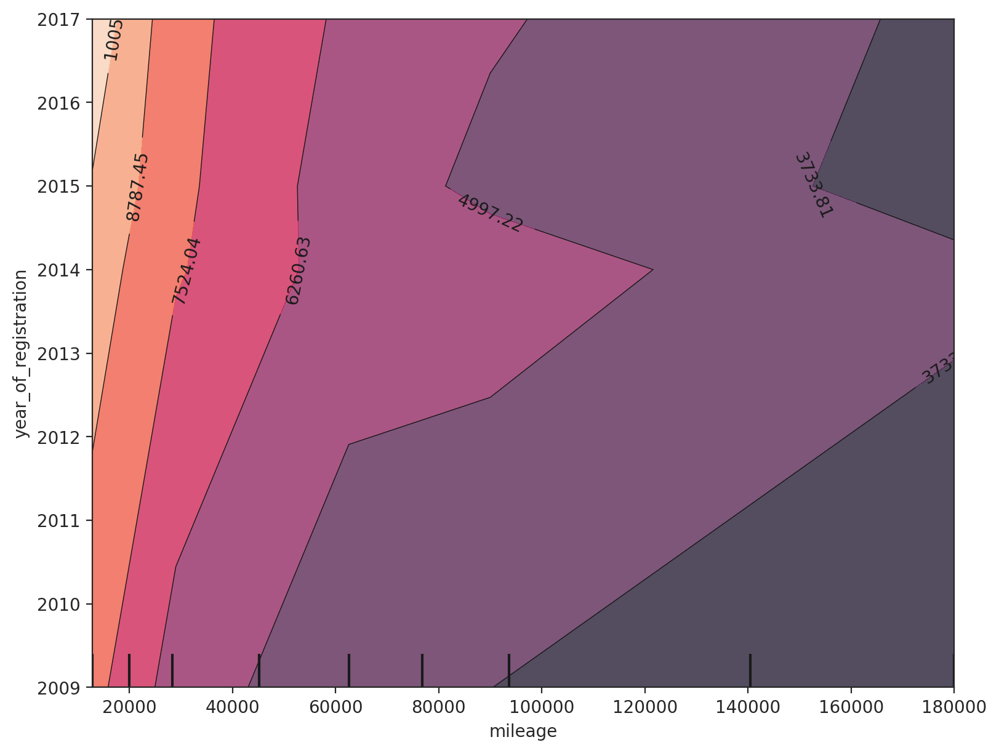

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_bt,
                                        selected_rows32,
                                        features=[('mileage', 'year_of_registration')],
                                        kind='average',
                                        subsample=100,
                                        grid_resolution=30,
                                        random_state=0,
                                        ax=ax, n_cols=2);

In [ ]:
selected_rows33 = x_test_bt_after_fs2.loc[[1, 10, 13, 17, 18]]
print(selected_rows33)

    mileage  mileage_year reg_code  standard_make body_type  \
1    9500.0      4.705300       19     Land Rover       SUV   
10  19000.0      9.415263       18  Mercedes-Benz    Saloon   
13  58000.0     28.841372       61        Bentley     Coupe   
17  22369.0     11.090233       17     Volkswagen       SUV   
18   4000.0      1.980198       70  Mercedes-Benz       SUV   

    year_of_registration  doors standard_model  
1                 2019.0      5    Range Rover  
10                2018.0      4        E Class  
13                2011.0      2    Continental  
17                2017.0      5         Tiguan  
18                2020.0      5      GLB Class  


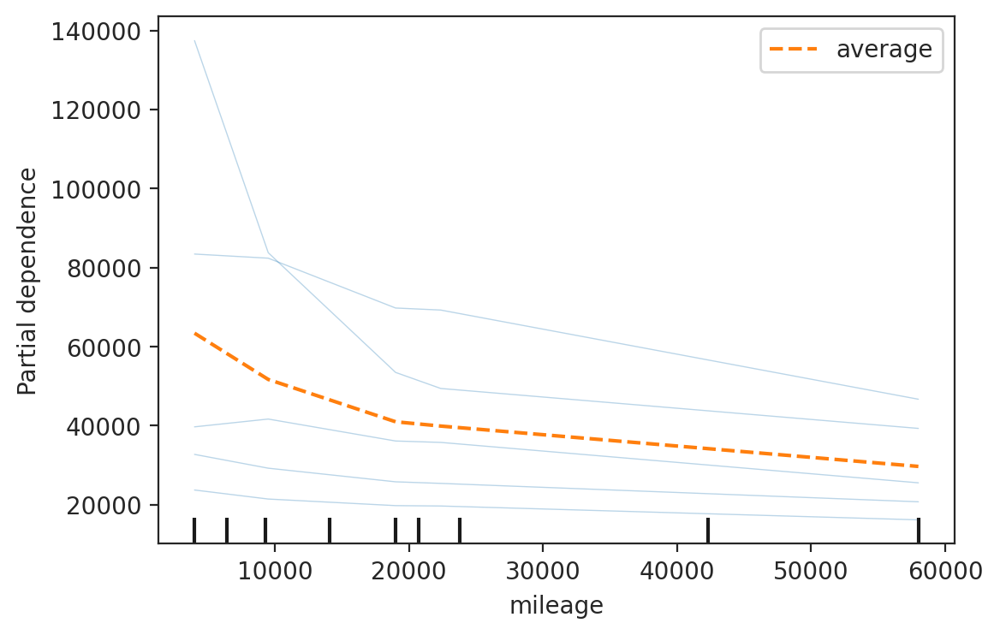

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_bt, selected_rows33, features=['mileage'], kind='both')

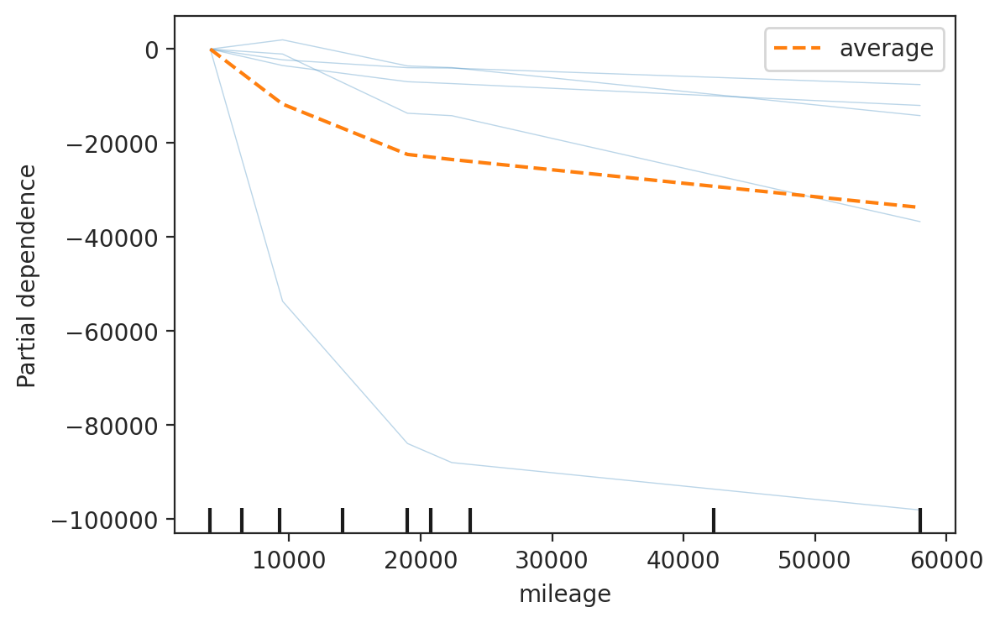

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_bt, selected_rows33, features=['mileage'], kind='both', centered=True)

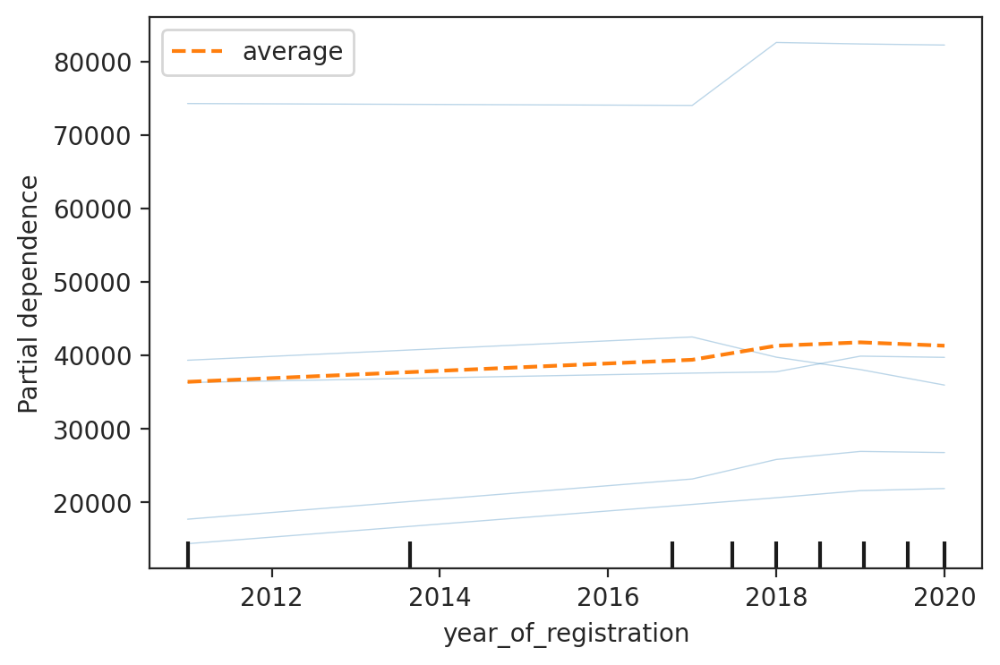

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_bt, selected_rows33, features=['year_of_registration'], kind='both')

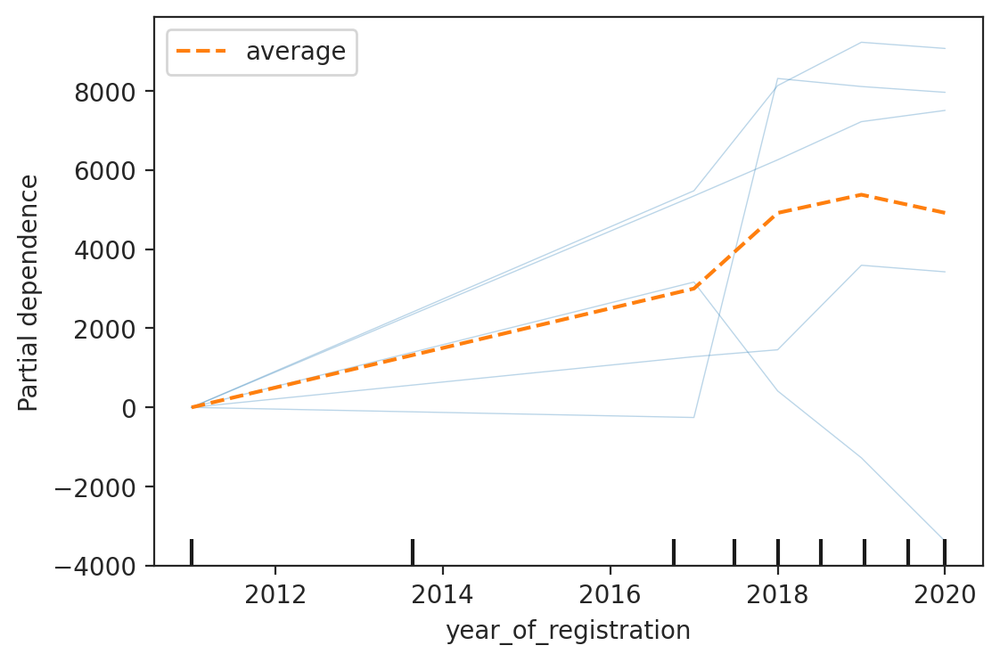

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_bt, selected_rows33, features=['year_of_registration'], kind='both', centered=True)

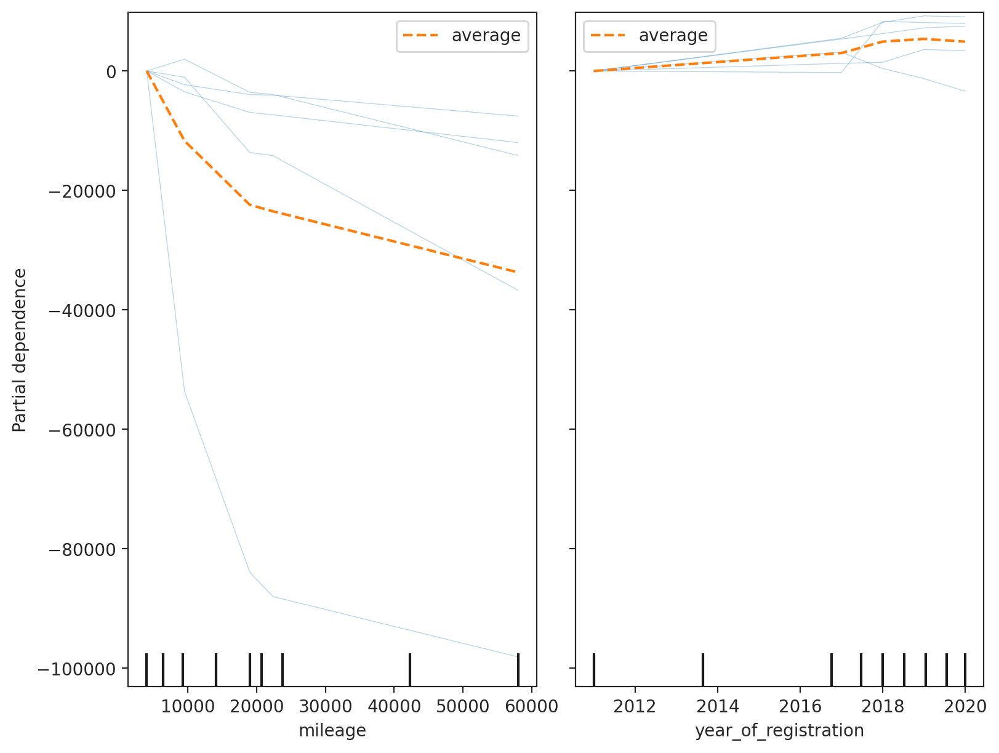

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_bt,
                                        selected_rows33,
                                        features=['mileage', 'year_of_registration'],
                                        kind='both',
                                        centered=True,
                                        subsample=100,
                                        grid_resolution=30,
                                        n_jobs=-1,
                                        random_state=0,ax=ax, n_cols=2);

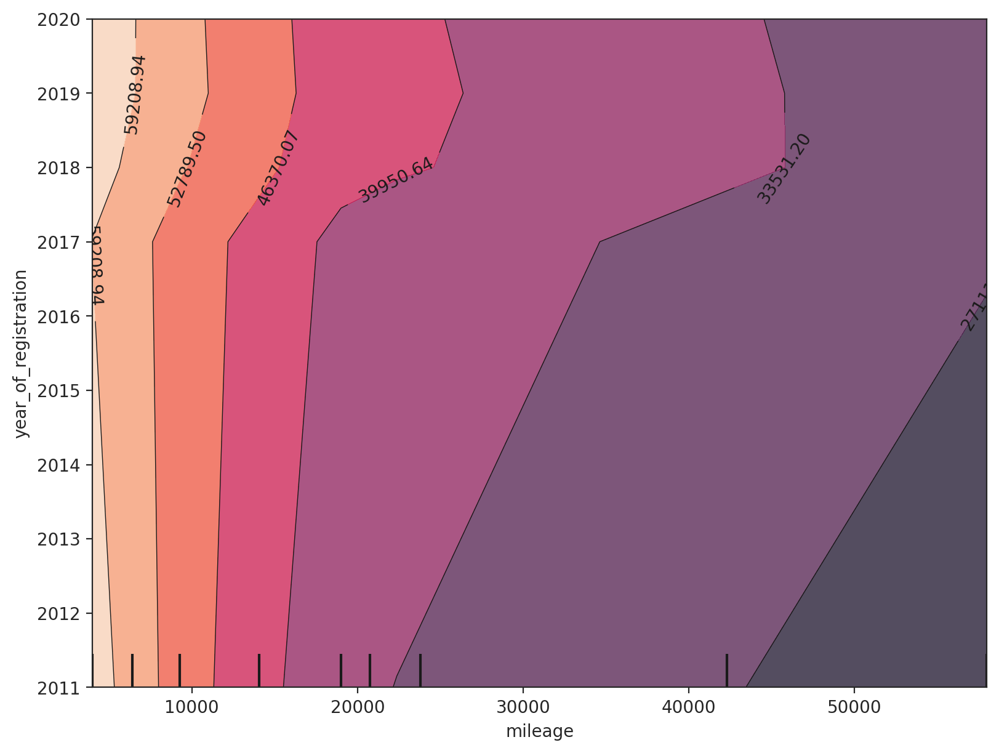

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_bt,
                                        selected_rows33,
                                        features=[('mileage', 'year_of_registration')],
                                        kind='average',
                                        subsample=100,
                                        grid_resolution=30,
                                        random_state=0,
                                        ax=ax, n_cols=2);

In [ ]:
selected_rows34 = x_test_bt_after_fs2.loc[[20, 190, 255, 1200, 79012]]
print(selected_rows34)

       mileage  mileage_year reg_code standard_make    body_type  \
20      1568.0      0.776622       19       McLaren        Coupe   
190     7253.0      3.597718       66   Lamborghini        Coupe   
255    76000.0     37.661051      NaN  Aston Martin       Saloon   
1200    8061.0      3.992571       69   Lamborghini          SUV   
79012     47.0      0.023267       70       Ferrari  Convertible   

       year_of_registration  doors standard_model  
20                   2019.0      2          Senna  
190                  2016.0      2      Aventador  
255                  2018.0      4            DB4  
1200                 2019.0      5           Urus  
79012                2020.0      2      488 Pista  


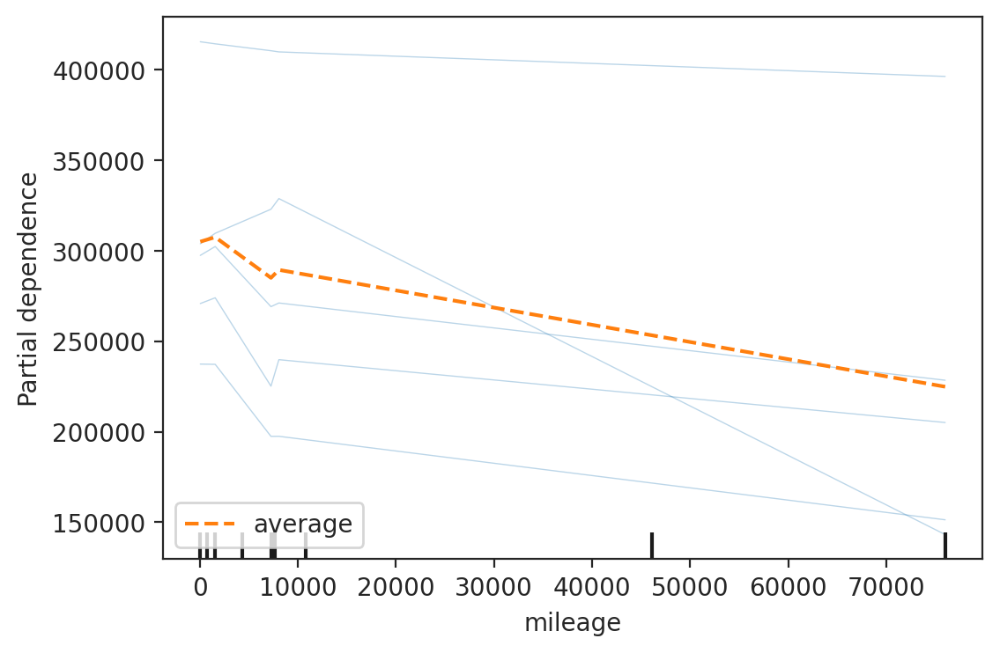

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_bt, selected_rows34, features=['mileage'], kind='both')

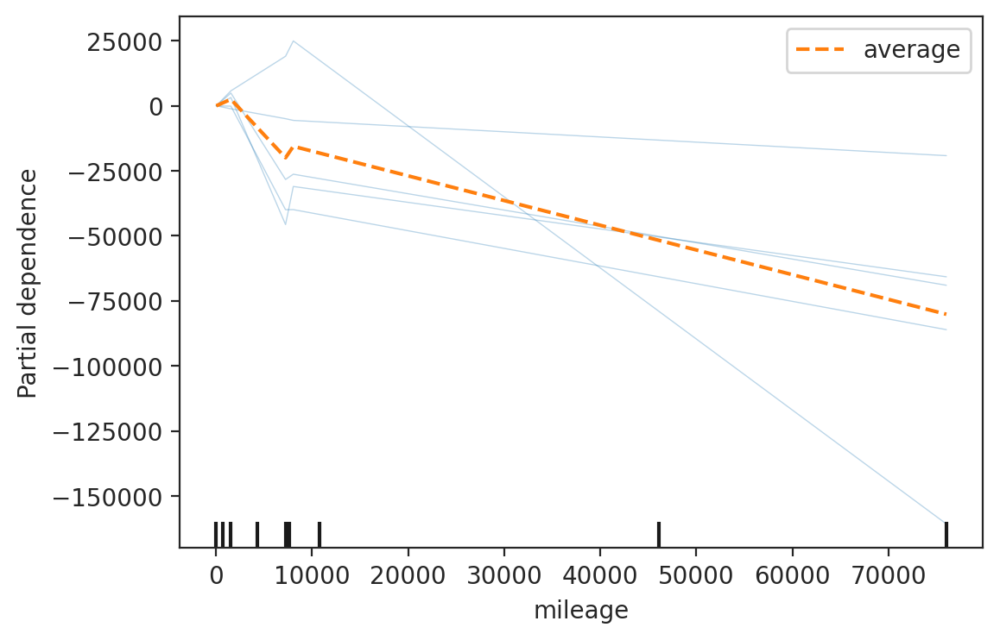

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_bt, selected_rows34, features=['mileage'], kind='both', centered=True)

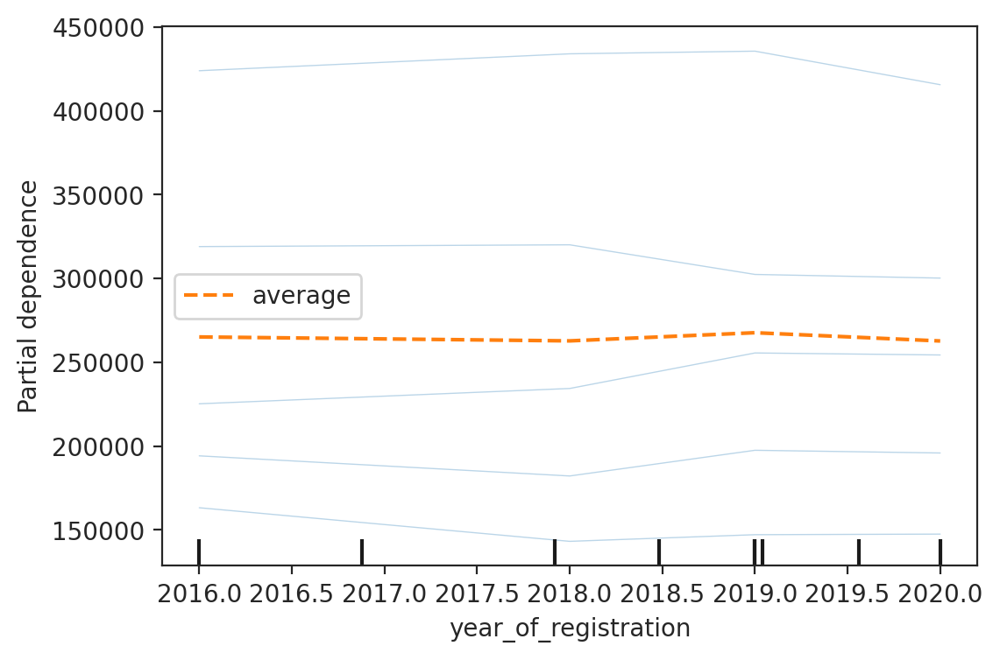

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_bt, selected_rows34, features=['year_of_registration'], kind='both')

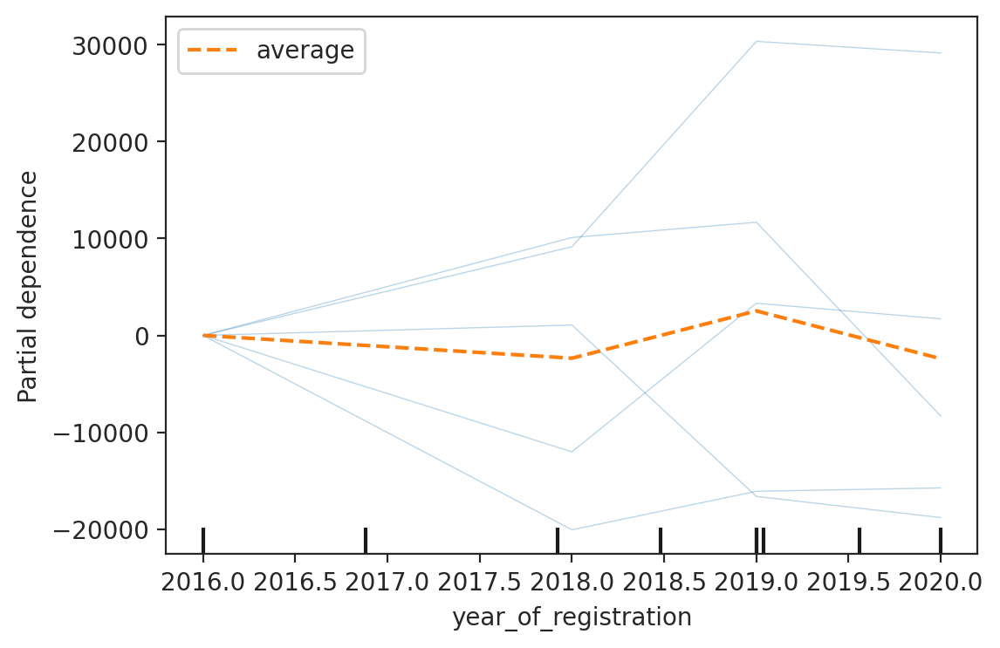

In [ ]:
PartialDependenceDisplay.from_estimator(best_model_bt, selected_rows34, features=['year_of_registration'], kind='both', centered=True)

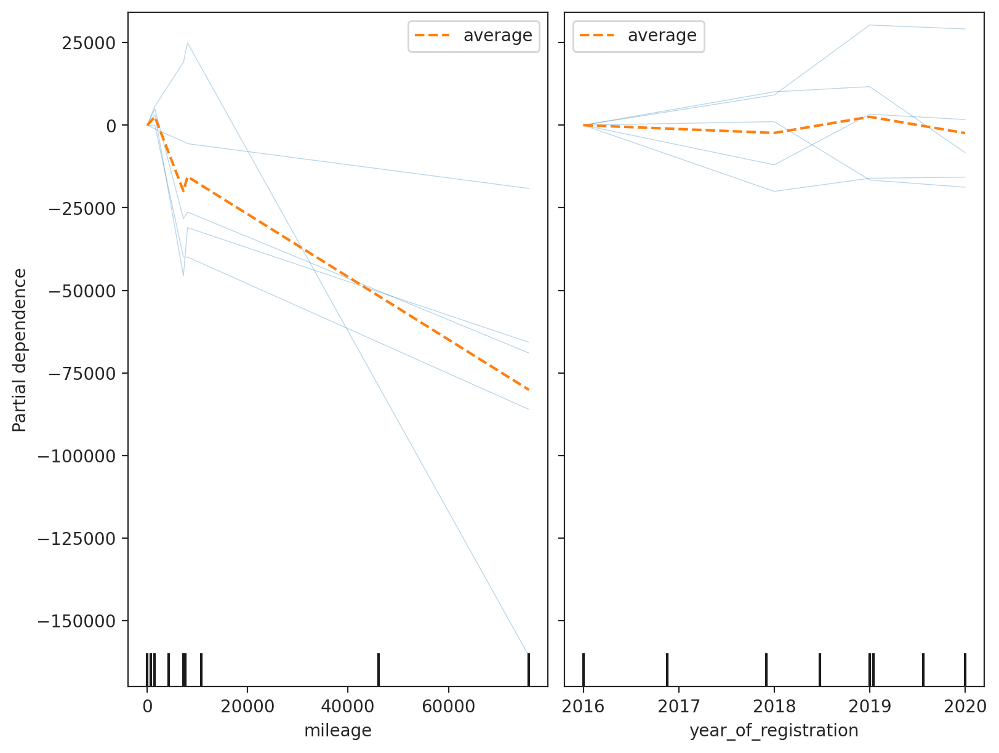

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_bt,
                                        selected_rows34,
                                        features=['mileage', 'year_of_registration'],
                                        kind='both',
                                        centered=True,
                                        subsample=100,
                                        grid_resolution=30,
                                        n_jobs=-1,
                                        random_state=0,ax=ax, n_cols=2);

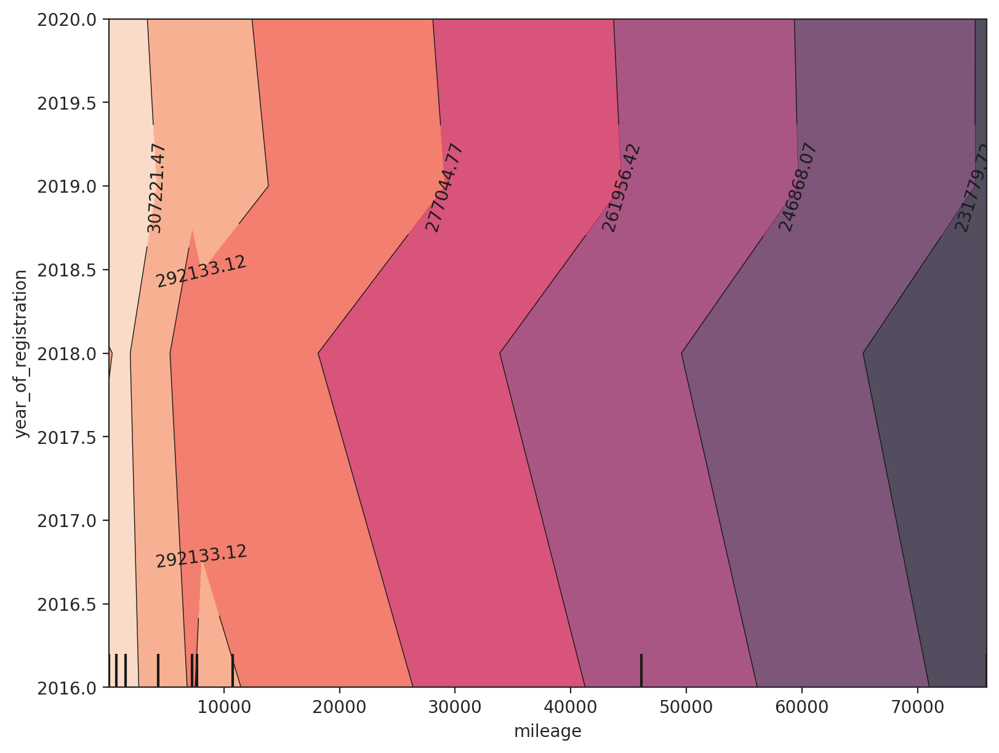

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)

PartialDependenceDisplay.from_estimator(best_model_bt,
                                        selected_rows34,
                                        features=[('mileage', 'year_of_registration')],
                                        kind='average',
                                        subsample=100,
                                        grid_resolution=30,
                                        random_state=0,
                                        ax=ax, n_cols=2);